I worked for about three months on this project for a python's elective course during the doctorate in economics at [PIMES](https://sites.google.com/view/pimes/principal). The project needed to have at least a section on webscraping and data visualization. Many sections on this project were not seen during the course, especially the libraries I used, as other sections on the course are not covered on this project. I chose the project theme to be over Covid-19. The data was web scraped lastly on the day before this project was uploaded on my GitHub's [repository](https://github.com/andreluizcoelho/dataprojects). All data analyzed can be downloaded on the links specified throughout the project. 

## Covid-19 

### 1. Web scraping Covid-19 Total and Death Cases

In [1]:
#importing libraries

In [2]:
from bs4 import BeautifulSoup

In [3]:
import requests

In [4]:
import pandas as pd

In [5]:
#defining the url

In [6]:
#show the website 'https://www.worldometers.info/coronavirus/'

In [7]:
url = 'https://www.worldometers.info/coronavirus/'

In [8]:
url

'https://www.worldometers.info/coronavirus/'

In [9]:
#get request to get the raw html content

In [10]:
html_content = requests.get(url).text

'\n<!DOCTYPE html>\n<!--[if IE 8]> <html lang="en" class="ie8"> <![endif]-->\n<!--[if IE 9]> <html lang="en" class="ie9"> <![endif]-->\n<!--[if !IE]><!-->\n<html lang="en">\n<!--<![endif]-->\n<head>\n<meta charset="utf-8">\n<meta http-equiv="X-UA-Compatible" content="IE=edge">\n<meta name="viewport" content="width=device-width, initial-scale=1">\n<title>COVID Live Update: 197,073,011 Cases and 4,210,030 Deaths from the Coronavirus - Worldometer</title>\n<meta name="description" content="Live statistics and coronavirus news tracking the number of confirmed cases, recovered patients, tests, and death toll due to the COVID-19 coronavirus from Wuhan, China. Coronavirus counter with new cases, deaths, and number of tests per 1 Million population. Historical data and info. Daily charts, graphs, news and updates">\n\n<link rel="shortcut icon" href="/favicon/favicon.ico" type="image/x-icon">\n<link rel="apple-touch-icon" sizes="57x57" href="/favicon/apple-icon-57x57.png">\n<link rel="apple-tou
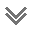

In [11]:
html_content

In [12]:
#parsing the html code for the entire site

In [13]:
soup = BeautifulSoup(html_content, 'lxml')

In [14]:
#print the parsed data of html

<!DOCTYPE html>
<!--[if IE 8]> <html lang="en" class="ie8"> <![endif]-->
<!--[if IE 9]> <html lang="en" class="ie9"> <![endif]-->
<!--[if !IE]><!-->
<html lang="en">
 <!--<![endif]-->
 <head>
  <meta charset="utf-8"/>
  <meta content="IE=edge" http-equiv="X-UA-Compatible"/>
  <meta content="width=device-width, initial-scale=1" name="viewport"/>
  <title>
   COVID Live Update: 197,073,011 Cases and 4,210,030 Deaths from the Coronavirus - Worldometer
  </title>
  <meta content="Live statistics and coronavirus news tracking the number of confirmed cases, recovered patients, tests, and death toll due to the COVID-19 coronavirus from Wuhan, China. Coronavirus counter with new cases, deaths, and number of tests per 1 Million population. Historical data and info. Daily charts, graphs, news and updates" name="description"/>
  <link href="/favicon/favicon.ico" rel="shortcut icon" type="image/x-icon"/>
  <link href="/favicon/apple-icon-57x57.png" rel="apple-touch-icon" sizes="57x57"/>
  <link hr
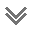

In [15]:
print(soup.prettify())

In [16]:
#picking the id of the table to scrape and extract html for only the specific table

In [17]:
covid_table = soup.find('table', attrs = {'id': 'main_table_countries_today'})

In [18]:
#head will form the columns

In [19]:
head = covid_table.thead.find_all('tr') 
#the <table> tag defines an HTML table 
#each table row is defined with a <tr> tag
#A <tr> element contains one or more <th> or <td> elements
#each table data/cell is defined with a <td> tag
#The <th> tag defines a header cell in an HTML table

In [20]:
head #headers are inside this html code

[<tr>
 <th width="1%">#</th>
 <th width="100">Country,<br/>Other</th>
 <th width="20">Total<br/>Cases</th>
 <th width="30">New<br/>Cases</th>
 <th width="30">Total<br/>Deaths</th>
 <th width="30">New<br/>Deaths</th>
 <th width="30">Total<br/>Recovered</th>
 <th width="30">New<br/>Recovered</th>
 <th width="30">Active<br/>Cases</th>
 <th width="30">Serious,<br/>Critical</th>
 <th width="30">Tot Cases/<br/>1M pop</th>
 <th width="30">Deaths/<br/>1M pop</th>
 <th width="30">Total<br/>Tests</th>
 <th width="30">Tests/<br/>
 <nobr>1M pop</nobr>
 </th>
 <th width="30">Population</th>
 <th style="display:none" width="30">Continent</th>
 <th width="30">1 Case<br/>every X ppl</th><th width="30">1 Death<br/>every X ppl</th><th width="30">1 Test<br/>every X ppl</th>
 <th width="30">New Cases/1M pop</th>
 <th width="30">New Deaths/1M pop</th>
 <th width="30">Active Cases/1M pop</th>
 </tr>]

In [21]:
#extracting headers from html to a list

In [22]:
headings = []
for th in head[0].find_all('th'):
    #removing newlines and extra spaces from left and right
    print(th.text)
    headings.append(th.text.replace('\n','').strip())
print(headings)

#
Country,Other
TotalCases
NewCases
TotalDeaths
NewDeaths
TotalRecovered
NewRecovered
ActiveCases
Serious,Critical
Tot Cases/1M pop
Deaths/1M pop
TotalTests
Tests/
1M pop

Population
Continent
1 Caseevery X ppl
1 Deathevery X ppl
1 Testevery X ppl
New Cases/1M pop
New Deaths/1M pop
Active Cases/1M pop
['#', 'Country,Other', 'TotalCases', 'NewCases', 'TotalDeaths', 'NewDeaths', 'TotalRecovered', 'NewRecovered', 'ActiveCases', 'Serious,Critical', 'Tot\xa0Cases/1M pop', 'Deaths/1M pop', 'TotalTests', 'Tests/1M pop', 'Population', 'Continent', '1 Caseevery X ppl', '1 Deathevery X ppl', '1 Testevery X ppl', 'New Cases/1M pop', 'New Deaths/1M pop', 'Active Cases/1M pop']


In [23]:
#extracting the rest of rows with tbody element

In [24]:
body = covid_table.tbody.find_all('tr')

In [25]:
body

[<tr class="total_row_world row_continent" data-continent="North America" style="display: none">
 <td></td>
 <td style="text-align:left;">
 <nobr>North America</nobr>
 </td>
 <td>42,237,791</td>
 <td>+36,891</td>
 <td>937,849</td>
 <td>+722</td>
 <td>35,225,182</td>
 <td>+24,725</td>
 <td>6,074,760</td>
 <td>16,109</td>
 <td></td>
 <td></td>
 <td></td>
 <td></td>
 <td></td>
 <td data-continent="North America" style="display:none;">North America</td>
 <td>
 </td>
 <td></td>
 <td></td>
 <td></td>
 <td></td>
 <td></td>
 </tr>,
 <tr class="total_row_world row_continent" data-continent="Asia" style="display: none">
 <td></td>
 <td style="text-align:left;">
 <nobr>Asia</nobr>
 </td>
 <td>61,513,133</td>
 <td>+263,287</td>
 <td>887,433</td>
 <td>+4,266</td>
 <td>57,652,678</td>
 <td>+194,550</td>
 <td>2,973,022</td>
 <td>33,134</td>
 <td></td>
 <td></td>
 <td></td>
 <td></td>
 <td></td>
 <td data-continent="Asia" style="display:none;">Asia</td>
 <td>
 </td>
 <td></td>
 <td></td>
 <td></td>
 <

In [26]:
body[0] #the first row for example

<tr class="total_row_world row_continent" data-continent="North America" style="display: none">
<td></td>
<td style="text-align:left;">
<nobr>North America</nobr>
</td>
<td>42,237,791</td>
<td>+36,891</td>
<td>937,849</td>
<td>+722</td>
<td>35,225,182</td>
<td>+24,725</td>
<td>6,074,760</td>
<td>16,109</td>
<td></td>
<td></td>
<td></td>
<td></td>
<td></td>
<td data-continent="North America" style="display:none;">North America</td>
<td>
</td>
<td></td>
<td></td>
<td></td>
<td></td>
<td></td>
</tr>

In [27]:
#appending the values of rows into a list, since there are lists inside a list here
#declaring empty list data that'll hold all rows data

In [28]:
data = []
for r in range(1, len(body)):
    row = [] #empty list to hold one row data
    for tr in body[r].find_all('td'):
        row.append(tr.text.replace('\n','').strip())
        #appending row data to row after removing newlines escape and triming unnecessary spaces
    data.append(row)

In [29]:
data

[['',
  'Asia',
  '61,513,133',
  '+263,287',
  '887,433',
  '+4,266',
  '57,652,678',
  '+194,550',
  '2,973,022',
  '33,134',
  '',
  '',
  '',
  '',
  '',
  'Asia',
  '',
  '',
  '',
  '',
  '',
  ''],
 ['',
  'South America',
  '35,331,762',
  '+2,276',
  '1,083,545',
  '+157',
  '32,870,730',
  '+2,171',
  '1,377,487',
  '25,863',
  '',
  '',
  '',
  '',
  '',
  'South America',
  '',
  '',
  '',
  '',
  '',
  ''],
 ['',
  'Europe',
  '51,211,868',
  '+83,266',
  '1,131,022',
  '+990',
  '46,712,078',
  '+41,898',
  '3,368,768',
  '7,598',
  '',
  '',
  '',
  '',
  '',
  'Europe',
  '',
  '',
  '',
  '',
  '',
  ''],
 ['',
  'Africa',
  '6,675,730',
  '+36,664',
  '168,643',
  '+1,071',
  '5,830,476',
  '+24,804',
  '676,611',
  '4,194',
  '',
  '',
  '',
  '',
  '',
  'Africa',
  '',
  '',
  '',
  '',
  '',
  ''],
 ['',
  'Oceania',
  '102,006',
  '+1,556',
  '1,523',
  '+11',
  '76,507',
  '+245',
  '23,976',
  '109',
  '',
  '',
  '',
  '',
  '',
  'Australia/Oceania',
  '',
  

In [30]:
row

['222',
 'China',
 '92,811',
 '+49',
 '4,636',
 '',
 '87,288',
 '+24',
 '887',
 '23',
 '64',
 '3',
 '160,000,000',
 '111,163',
 '1,439,323,776',
 'Asia',
 '15,508',
 '310,467',
 '9',
 '0.03',
 '',
 '0.6']

In [31]:
#data contains all the rows excluding header
#row contains data for one row

In [32]:
#passing the values on the body as the data and headings as the columns 
#to a DataFrame

In [33]:
#with headings as the columns

In [34]:
df = pd.DataFrame(data, columns = headings)

In [35]:
df

,#,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",...,TotalTests,Tests/1M pop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop
0,,Asia,"61,513,133","+263,287","887,433","+4,266","57,652,678","+194,550","2,973,022","33,134",...,,,,Asia,,,,,,
1,,South America,"35,331,762","+2,276","1,083,545",+157,"32,870,730","+2,171","1,377,487","25,863",...,,,,South America,,,,,,
2,,Europe,"51,211,868","+83,266","1,131,022",+990,"46,712,078","+41,898","3,368,768","7,598",...,,,,Europe,,,,,,
3,,Africa,"6,675,730","+36,664","168,643","+1,071","5,830,476","+24,804","676,611","4,194",...,,,,Africa,,,,,,
4,,Oceania,"102,006","+1,556","1,523",+11,"76,507",+245,"23,976",109,...,,,,Australia/Oceania,,,,,,
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
224,218,Marshall Islands,4,,,,4,,0,,...,,,"59,618",Australia/Oceania,"14,905",,,,,
225,219,Samoa,3,,,,3,,0,,...,,,"199,827",Australia/Oceania,"66,609",,,,,
226,220,Saint Helena,2,,,,2,,0,,...,,,"6,096",Africa,"3,048",,,,,
227,221,Micronesia,1,,,,1,,0,,...,,,"116,314",Australia/Oceania,"116,314",,,,,


In [36]:
df.head()

,#,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",...,TotalTests,Tests/1M pop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop
0,,Asia,"61,513,133","+263,287","887,433","+4,266","57,652,678","+194,550","2,973,022","33,134",...,,,,Asia,,,,,,
1,,South America,"35,331,762","+2,276","1,083,545",+157,"32,870,730","+2,171","1,377,487","25,863",...,,,,South America,,,,,,
2,,Europe,"51,211,868","+83,266","1,131,022",+990,"46,712,078","+41,898","3,368,768","7,598",...,,,,Europe,,,,,,
3,,Africa,"6,675,730","+36,664","168,643","+1,071","5,830,476","+24,804","676,611","4,194",...,,,,Africa,,,,,,
4,,Oceania,"102,006","+1,556","1,523",+11,"76,507",+245,"23,976",109,...,,,,Australia/Oceania,,,,,,


In [37]:
df.head(10)

,#,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",...,TotalTests,Tests/1M pop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop
0,,Asia,"61,513,133","+263,287","887,433","+4,266","57,652,678","+194,550","2,973,022","33,134",...,,,,Asia,,,,,,
1,,South America,"35,331,762","+2,276","1,083,545",+157,"32,870,730","+2,171","1,377,487","25,863",...,,,,South America,,,,,,
2,,Europe,"51,211,868","+83,266","1,131,022",+990,"46,712,078","+41,898","3,368,768","7,598",...,,,,Europe,,,,,,
3,,Africa,"6,675,730","+36,664","168,643","+1,071","5,830,476","+24,804","676,611","4,194",...,,,,Africa,,,,,,
4,,Oceania,"102,006","+1,556","1,523",+11,"76,507",+245,"23,976",109,...,,,,Australia/Oceania,,,,,,
5,,,721,,15,,706,,0,0,...,,,,,,,,,,
6,,World,"197,073,011","+423,940","4,210,030","+7,217","178,368,357","+288,393","14,494,624","87,007",...,,,,All,,,,,,
7,1,USA,"35,494,551","+7,061","628,152",+54,"29,604,525",+567,"5,261,874","9,051",...,"527,202,813","1,582,799","333,082,557",North America,9,530,1,21,0.2,"15,798"
8,2,India,"31,570,904","+44,282","423,243",+548,"30,735,569","+41,447","412,092","8,944",...,"462,629,773","331,746","1,394,531,345",Asia,44,"3,295",3,32,0.4,296
9,3,Brazil,"19,797,516",,"553,272",,"18,530,306",,"713,938","8,318",...,"55,034,721","256,958","214,178,124",South America,11,387,4,,,"3,333"


In [38]:
df.tail()

,#,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",...,TotalTests,Tests/1M pop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop
224,218,Marshall Islands,4,,,,4,,0,,...,,,"59,618",Australia/Oceania,"14,905",,,,,
225,219,Samoa,3,,,,3,,0,,...,,,"199,827",Australia/Oceania,"66,609",,,,,
226,220,Saint Helena,2,,,,2,,0,,...,,,"6,096",Africa,"3,048",,,,,
227,221,Micronesia,1,,,,1,,0,,...,,,"116,314",Australia/Oceania,"116,314",,,,,
228,222,China,"92,811",+49,"4,636",,"87,288",+24,887,23,...,"160,000,000","111,163","1,439,323,776",Asia,"15,508","310,467",9,0.03,,0.6


In [39]:
#to end up with the data only from today, it's needed to remove duplicates, because the data is kept up to three days on the website

In [40]:
data=df[df['#']!=''].reset_index(drop=True)

In [41]:
#the data points with # value are the contries while data points with null values for # columns are features like continents, totals, etc

In [42]:
data

,#,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",...,TotalTests,Tests/1M pop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop
0,1,USA,"35,494,551","+7,061","628,152",+54,"29,604,525",+567,"5,261,874","9,051",...,"527,202,813","1,582,799","333,082,557",North America,9,530,1,21,0.2,"15,798"
1,2,India,"31,570,904","+44,282","423,243",+548,"30,735,569","+41,447","412,092","8,944",...,"462,629,773","331,746","1,394,531,345",Asia,44,"3,295",3,32,0.4,296
2,3,Brazil,"19,797,516",,"553,272",,"18,530,306",,"713,938","8,318",...,"55,034,721","256,958","214,178,124",South America,11,387,4,,,"3,333"
3,4,Russia,"6,218,502","+23,270","156,977",+799,"5,568,363","+20,834","493,162","2,300",...,"164,200,000","1,124,645","146,001,583",Europe,23,930,1,159,5,"3,378"
4,5,France,"6,054,049",,"111,735",,"5,687,372",,"254,942",992,...,"102,910,163","1,572,867","65,428,389",Europe,11,586,1,,,"3,897"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
217,218,Marshall Islands,4,,,,4,,0,,...,,,"59,618",Australia/Oceania,"14,905",,,,,
218,219,Samoa,3,,,,3,,0,,...,,,"199,827",Australia/Oceania,"66,609",,,,,
219,220,Saint Helena,2,,,,2,,0,,...,,,"6,096",Africa,"3,048",,,,,
220,221,Micronesia,1,,,,1,,0,,...,,,"116,314",Australia/Oceania,"116,314",,,,,


In [43]:
data = data.drop_duplicates(subset = ['Country,Other'])

In [44]:
#because the worldmeter reports data for up to three days, counting today to two days back, there's a need to drop duplicates
#when duplicates are removed, the values for the last two days are removed, while today´s values are kept

In [45]:
data.head()

,#,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",...,TotalTests,Tests/1M pop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop
0,1,USA,"35,494,551","+7,061","628,152",+54,"29,604,525",+567,"5,261,874","9,051",...,"527,202,813","1,582,799","333,082,557",North America,9,530,1,21,0.2,"15,798"
1,2,India,"31,570,904","+44,282","423,243",+548,"30,735,569","+41,447","412,092","8,944",...,"462,629,773","331,746","1,394,531,345",Asia,44,"3,295",3,32,0.4,296
2,3,Brazil,"19,797,516",,"553,272",,"18,530,306",,"713,938","8,318",...,"55,034,721","256,958","214,178,124",South America,11,387,4,,,"3,333"
3,4,Russia,"6,218,502","+23,270","156,977",+799,"5,568,363","+20,834","493,162","2,300",...,"164,200,000","1,124,645","146,001,583",Europe,23,930,1,159,5,"3,378"
4,5,France,"6,054,049",,"111,735",,"5,687,372",,"254,942",992,...,"102,910,163","1,572,867","65,428,389",Europe,11,586,1,,,"3,897"


In [46]:
#if some columns are wished to be dropped, as the ones below

In [47]:
cols = ['#', 
        'Tot\xa0Cases/1M pop',
        'Deaths/1M pop',
        'Tests/1M pop', 
        '1 Caseevery X ppl',
        '1 Deathevery X ppl',
        '1 Testevery X ppl']

In [48]:
cols

['#',
 'Tot\xa0Cases/1M pop',
 'Deaths/1M pop',
 'Tests/1M pop',
 '1 Caseevery X ppl',
 '1 Deathevery X ppl',
 '1 Testevery X ppl']

In [49]:
data_final = data.drop(cols, axis=1)

In [50]:
data_final.head()

,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop
0,USA,"35,494,551","+7,061","628,152",+54,"29,604,525",+567,"5,261,874","9,051","527,202,813","333,082,557",North America,21,0.2,"15,798"
1,India,"31,570,904","+44,282","423,243",+548,"30,735,569","+41,447","412,092","8,944","462,629,773","1,394,531,345",Asia,32,0.4,296
2,Brazil,"19,797,516",,"553,272",,"18,530,306",,"713,938","8,318","55,034,721","214,178,124",South America,,,"3,333"
3,Russia,"6,218,502","+23,270","156,977",+799,"5,568,363","+20,834","493,162","2,300","164,200,000","146,001,583",Europe,159,5,"3,378"
4,France,"6,054,049",,"111,735",,"5,687,372",,"254,942",992,"102,910,163","65,428,389",Europe,,,"3,897"


In [51]:
data_final.tail()

,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop
217,Marshall Islands,4,,,,4,,0,,,"59,618",Australia/Oceania,,,
218,Samoa,3,,,,3,,0,,,"199,827",Australia/Oceania,,,
219,Saint Helena,2,,,,2,,0,,,"6,096",Africa,,,
220,Micronesia,1,,,,1,,0,,,"116,314",Australia/Oceania,,,
221,China,"92,811",+49,"4,636",,"87,288",+24,887,23,"160,000,000","1,439,323,776",Asia,0.03,,0.6


In [52]:
data_final

,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop
0,USA,"35,494,551","+7,061","628,152",+54,"29,604,525",+567,"5,261,874","9,051","527,202,813","333,082,557",North America,21,0.2,"15,798"
1,India,"31,570,904","+44,282","423,243",+548,"30,735,569","+41,447","412,092","8,944","462,629,773","1,394,531,345",Asia,32,0.4,296
2,Brazil,"19,797,516",,"553,272",,"18,530,306",,"713,938","8,318","55,034,721","214,178,124",South America,,,"3,333"
3,Russia,"6,218,502","+23,270","156,977",+799,"5,568,363","+20,834","493,162","2,300","164,200,000","146,001,583",Europe,159,5,"3,378"
4,France,"6,054,049",,"111,735",,"5,687,372",,"254,942",992,"102,910,163","65,428,389",Europe,,,"3,897"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
217,Marshall Islands,4,,,,4,,0,,,"59,618",Australia/Oceania,,,
218,Samoa,3,,,,3,,0,,,"199,827",Australia/Oceania,,,
219,Saint Helena,2,,,,2,,0,,,"6,096",Africa,,,
220,Micronesia,1,,,,1,,0,,,"116,314",Australia/Oceania,,,


In [53]:
pd.set_option('display.max_rows', None)

In [54]:
data_final

,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop
0,USA,"35,494,551","+7,061","628,152",+54,"29,604,525",+567,"5,261,874","9,051","527,202,813","333,082,557",North America,21,0.2,"15,798"
1,India,"31,570,904","+44,282","423,243",+548,"30,735,569","+41,447","412,092","8,944","462,629,773","1,394,531,345",Asia,32,0.4,296
2,Brazil,"19,797,516",,"553,272",,"18,530,306",,"713,938","8,318","55,034,721","214,178,124",South America,,,"3,333"
3,Russia,"6,218,502","+23,270","156,977",+799,"5,568,363","+20,834","493,162","2,300","164,200,000","146,001,583",Europe,159,5,"3,378"
4,France,"6,054,049",,"111,735",,"5,687,372",,"254,942",992,"102,910,163","65,428,389",Europe,,,"3,897"
5,UK,"5,801,561","+31,117","129,515",+85,"4,488,894","+8,361","1,183,152",853,"243,170,406","68,268,185",Europe,456,1,"17,331"
6,Turkey,"5,682,630","+22,161","51,184",+60,"5,443,501","+5,463","187,945",543,"67,353,195","85,310,571",Asia,260,0.7,"2,203"
7,Argentina,"4,891,810",,"104,822",,"4,529,259",,"257,729","4,160","19,144,266","45,639,886",South America,,,"5,647"
8,Colombia,"4,757,139",,"119,801",,"4,545,346",,"91,992","8,155","22,282,843","51,463,477",South America,,,"1,788"
9,Spain,"4,395,602",,"81,396",,"3,703,911",,"610,295","1,593","55,855,941","46,774,203",Europe,,,"13,048"


In [55]:
pd.set_option('display.max_rows', 100)

In [56]:
data_final

,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop
0,USA,"35,494,551","+7,061","628,152",+54,"29,604,525",+567,"5,261,874","9,051","527,202,813","333,082,557",North America,21,0.2,"15,798"
1,India,"31,570,904","+44,282","423,243",+548,"30,735,569","+41,447","412,092","8,944","462,629,773","1,394,531,345",Asia,32,0.4,296
2,Brazil,"19,797,516",,"553,272",,"18,530,306",,"713,938","8,318","55,034,721","214,178,124",South America,,,"3,333"
3,Russia,"6,218,502","+23,270","156,977",+799,"5,568,363","+20,834","493,162","2,300","164,200,000","146,001,583",Europe,159,5,"3,378"
4,France,"6,054,049",,"111,735",,"5,687,372",,"254,942",992,"102,910,163","65,428,389",Europe,,,"3,897"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
217,Marshall Islands,4,,,,4,,0,,,"59,618",Australia/Oceania,,,
218,Samoa,3,,,,3,,0,,,"199,827",Australia/Oceania,,,
219,Saint Helena,2,,,,2,,0,,,"6,096",Africa,,,
220,Micronesia,1,,,,1,,0,,,"116,314",Australia/Oceania,,,


In [57]:
data_final.to_excel('covidcasesdeaths.xlsx', index=False) #index=False saves the file without the first "Unnamed: 0" column, otherwise, there's the need to drop this column every time after openning the file

### 2. Covid-19 Vaccines

In [58]:
url = 'https://raw.githubusercontent.com/owid/covid-19-data/master/public/data/vaccinations/vaccinations.csv'

In [59]:
df = pd.read_csv(url)

In [60]:
df

,location,iso_code,date,total_vaccinations,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million
0,Afghanistan,AFG,2021-02-22,0.0,0.0,NaN,NaN,NaN,0.00,0.00,NaN,NaN
1,Afghanistan,AFG,2021-02-23,NaN,NaN,NaN,NaN,1367.0,NaN,NaN,NaN,35.0
2,Afghanistan,AFG,2021-02-24,NaN,NaN,NaN,NaN,1367.0,NaN,NaN,NaN,35.0
3,Afghanistan,AFG,2021-02-25,NaN,NaN,NaN,NaN,1367.0,NaN,NaN,NaN,35.0
4,Afghanistan,AFG,2021-02-26,NaN,NaN,NaN,NaN,1367.0,NaN,NaN,NaN,35.0
...,...,...,...,...,...,...,...,...,...,...,...,...
36506,Zimbabwe,ZWE,2021-07-22,2017101.0,1352514.0,664587.0,67629.0,50034.0,13.57,9.10,4.47,3366.0
36507,Zimbabwe,ZWE,2021-07-23,2072060.0,1400905.0,671155.0,54959.0,48617.0,13.94,9.43,4.52,3271.0
36508,Zimbabwe,ZWE,2021-07-24,2116664.0,1438890.0,677774.0,44604.0,49319.0,14.24,9.68,4.56,3318.0
36509,Zimbabwe,ZWE,2021-07-25,2127402.0,1447342.0,680060.0,10738.0,48838.0,14.31,9.74,4.58,3286.0


In [61]:
df = df.groupby('location')['total_vaccinations', 'iso_code', 'date', 'people_vaccinated', 'people_fully_vaccinated', 'daily_vaccinations_raw', 'daily_vaccinations', 'total_vaccinations_per_hundred', 'people_vaccinated_per_hundred', 'people_fully_vaccinated_per_hundred', 'daily_vaccinations_per_million'].max().reset_index() 

<ipython-input-61-9df48879e174>:1: FutureWarning: Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.
  df = df.groupby('location')['total_vaccinations', 'iso_code', 'date', 'people_vaccinated', 'people_fully_vaccinated', 'daily_vaccinations_raw', 'daily_vaccinations', 'total_vaccinations_per_hundred', 'people_vaccinated_per_hundred', 'people_fully_vaccinated_per_hundred', 'daily_vaccinations_per_million'].max().reset_index()


In [62]:
df.head()

,location,total_vaccinations,iso_code,date,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million
0,Afghanistan,1277085.0,AFG,2021-07-27,939835.0,219159.0,4015.0,22461.0,3.28,2.41,0.56,577.0
1,Africa,63784801.0,OWID_AFR,2021-07-28,42983283.0,22007519.0,2027662.0,708725.0,4.76,3.21,1.64,529.0
2,Albania,1138771.0,ALB,2021-07-25,640047.0,498724.0,23655.0,17565.0,39.57,22.24,17.33,6104.0
3,Algeria,75000.0,DZA,2021-02-19,75000.0,NaN,30.0,3748.0,0.17,0.17,NaN,85.0
4,Andorra,82349.0,AND,2021-07-19,48445.0,33904.0,2829.0,1762.0,106.58,62.70,43.88,22805.0


In [63]:
pd.set_option('display.max_rows', None)

In [64]:
df

,location,total_vaccinations,iso_code,date,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million
0,Afghanistan,1.277085e+06,AFG,2021-07-27,9.398350e+05,2.191590e+05,4015.0,22461.0,3.28,2.41,0.56,577.0
1,Africa,6.378480e+07,OWID_AFR,2021-07-28,4.298328e+07,2.200752e+07,2027662.0,708725.0,4.76,3.21,1.64,529.0
2,Albania,1.138771e+06,ALB,2021-07-25,6.400470e+05,4.987240e+05,23655.0,17565.0,39.57,22.24,17.33,6104.0
3,Algeria,7.500000e+04,DZA,2021-02-19,7.500000e+04,NaN,30.0,3748.0,0.17,0.17,NaN,85.0
4,Andorra,8.234900e+04,AND,2021-07-19,4.844500e+04,3.390400e+04,2829.0,1762.0,106.58,62.70,43.88,22805.0
5,Angola,1.592537e+06,AGO,2021-07-19,9.583730e+05,6.341640e+05,NaN,33700.0,4.85,2.92,1.93,1025.0
6,Anguilla,1.800100e+04,AIA,2021-07-23,9.398000e+03,8.603000e+03,1421.0,331.0,119.99,62.64,57.35,22064.0
7,Antigua and Barbuda,6.827100e+04,ATG,2021-07-25,3.784100e+04,3.043000e+04,2221.0,1278.0,69.72,38.64,31.07,13050.0
8,Argentina,3.065527e+07,ARG,2021-07-28,2.430243e+07,6.352840e+06,504015.0,402055.0,67.83,53.77,14.06,8896.0
9,Armenia,1.525290e+05,ARM,2021-07-25,1.086740e+05,4.385500e+04,NaN,3282.0,5.15,3.67,1.48,1108.0


In [65]:
pd.set_option('display.max_rows', 100)

In [66]:
df.to_excel('covidvaccinations.xlsx', index = False)

### 3. Countries Indicators

#### 3.1 Human Development Index

The HDI data can be downloaded [here](http://hdr.undp.org/en/data), and for direct download [here](http://hdr.undp.org/sites/default/files/2020_statistical_annex_all.xlsx)

![](http://hdr.undp.org/sites/default/files/hdi_2020.jpg)

In [68]:
hdiranking2019 = pd.read_excel('C:/Users/andre/Documents/Programming Languages/Python/pimespython/Project/covidwebscraping/actualcovid19project/2020_statistical_annex_all.xlsx', sheet_name='Table 1')

In [69]:
hdiranking2019 

,Back,Table 1. Human Development Index and its components,Unnamed: 2,Unnamed: 3,Unnamed: 4,Unnamed: 5,Unnamed: 6,Unnamed: 7,Unnamed: 8,Unnamed: 9,...,Unnamed: 17,Unnamed: 18,Unnamed: 19,Unnamed: 20,Unnamed: 21,Unnamed: 22,Unnamed: 23,Unnamed: 24,Unnamed: 25,Unnamed: 26
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,NaN,NaN,NaN,NaN,SDG3,NaN,SDG4.3,NaN,SDG4.4,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,NaN,NaN,Human Development Index (HDI),NaN,Life expectancy at birth,NaN,Expected years of schooling,NaN,Mean years of schooling,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,HDI rank,Country,Value,NaN,(years),NaN,(years),NaN,(years),NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
265,NaN,Column 2: UNDESA (2019a).,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
266,NaN,Column 3: UNESCO Institute for Statistics (202...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
267,NaN,Column 4: UNESCO Institute for Statistics (202...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
268,NaN,"Column 5: World Bank (2020a), IMF (2020) and U...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [70]:
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns',None)

In [71]:
hdiranking2019

,Back,Table 1. Human Development Index and its components,Unnamed: 2,Unnamed: 3,Unnamed: 4,Unnamed: 5,Unnamed: 6,Unnamed: 7,Unnamed: 8,Unnamed: 9,Unnamed: 10,Unnamed: 11,Unnamed: 12,Unnamed: 13,Unnamed: 14,Unnamed: 15,Unnamed: 16,Unnamed: 17,Unnamed: 18,Unnamed: 19,Unnamed: 20,Unnamed: 21,Unnamed: 22,Unnamed: 23,Unnamed: 24,Unnamed: 25,Unnamed: 26
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,NaN,NaN,NaN,NaN,SDG3,NaN,SDG4.3,NaN,SDG4.4,NaN,SDG8.5,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,NaN,NaN,Human Development Index (HDI),NaN,Life expectancy at birth,NaN,Expected years of schooling,NaN,Mean years of schooling,NaN,Gross national income (GNI) per capita,NaN,GNI per capita rank minus HDI rank,NaN,HDI rank,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,HDI rank,Country,Value,NaN,(years),NaN,(years),NaN,(years),NaN,(2017 PPP $),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5,NaN,NaN,2019,NaN,2019,NaN,2019,a,2019,a,2019,NaN,2019,NaN,2018,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6,NaN,VERY HIGH HUMAN DEVELOPMENT,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7,1,Norway,0.957,NaN,82.4,NaN,18.06615,b,12.89775,NaN,66494.25217,NaN,7,NaN,1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8,2,Ireland,0.955,NaN,82.31,NaN,18.70529,b,12.666331,NaN,68370.58737,NaN,4,NaN,3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9,2,Switzerland,0.955,NaN,83.78,NaN,16.32844,NaN,13.380812,NaN,69393.52076,NaN,3,NaN,2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [72]:
hdiranking2019.drop(hdiranking2019.index[0:3], inplace = True)

In [73]:
hdiranking2019

,Back,Table 1. Human Development Index and its components,Unnamed: 2,Unnamed: 3,Unnamed: 4,Unnamed: 5,Unnamed: 6,Unnamed: 7,Unnamed: 8,Unnamed: 9,Unnamed: 10,Unnamed: 11,Unnamed: 12,Unnamed: 13,Unnamed: 14,Unnamed: 15,Unnamed: 16,Unnamed: 17,Unnamed: 18,Unnamed: 19,Unnamed: 20,Unnamed: 21,Unnamed: 22,Unnamed: 23,Unnamed: 24,Unnamed: 25,Unnamed: 26
3,NaN,NaN,Human Development Index (HDI),NaN,Life expectancy at birth,NaN,Expected years of schooling,NaN,Mean years of schooling,NaN,Gross national income (GNI) per capita,NaN,GNI per capita rank minus HDI rank,NaN,HDI rank,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,HDI rank,Country,Value,NaN,(years),NaN,(years),NaN,(years),NaN,(2017 PPP $),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5,NaN,NaN,2019,NaN,2019,NaN,2019,a,2019,a,2019,NaN,2019,NaN,2018,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6,NaN,VERY HIGH HUMAN DEVELOPMENT,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7,1,Norway,0.957,NaN,82.4,NaN,18.06615,b,12.89775,NaN,66494.25217,NaN,7,NaN,1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8,2,Ireland,0.955,NaN,82.31,NaN,18.70529,b,12.666331,NaN,68370.58737,NaN,4,NaN,3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9,2,Switzerland,0.955,NaN,83.78,NaN,16.32844,NaN,13.380812,NaN,69393.52076,NaN,3,NaN,2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
10,4,"Hong Kong, China (SAR)",0.949,NaN,84.86,NaN,16.92947,NaN,12.27996,NaN,62984.76553,NaN,7,NaN,4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
11,4,Iceland,0.949,NaN,82.99,NaN,19.08309,b,12.772787,c,54682.38057,NaN,14,NaN,4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
12,6,Germany,0.947,NaN,81.33,NaN,16.97719,NaN,14.15168,NaN,55314.35355,NaN,11,NaN,4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [74]:
hdiranking2019.drop(hdiranking2019.index[196:], inplace = True)

In [75]:
hdiranking2019

,Back,Table 1. Human Development Index and its components,Unnamed: 2,Unnamed: 3,Unnamed: 4,Unnamed: 5,Unnamed: 6,Unnamed: 7,Unnamed: 8,Unnamed: 9,Unnamed: 10,Unnamed: 11,Unnamed: 12,Unnamed: 13,Unnamed: 14,Unnamed: 15,Unnamed: 16,Unnamed: 17,Unnamed: 18,Unnamed: 19,Unnamed: 20,Unnamed: 21,Unnamed: 22,Unnamed: 23,Unnamed: 24,Unnamed: 25,Unnamed: 26
3,NaN,NaN,Human Development Index (HDI),NaN,Life expectancy at birth,NaN,Expected years of schooling,NaN,Mean years of schooling,NaN,Gross national income (GNI) per capita,NaN,GNI per capita rank minus HDI rank,NaN,HDI rank,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,HDI rank,Country,Value,NaN,(years),NaN,(years),NaN,(years),NaN,(2017 PPP $),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5,NaN,NaN,2019,NaN,2019,NaN,2019,a,2019,a,2019,NaN,2019,NaN,2018,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6,NaN,VERY HIGH HUMAN DEVELOPMENT,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7,1,Norway,0.957,NaN,82.4,NaN,18.06615,b,12.89775,NaN,66494.25217,NaN,7,NaN,1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8,2,Ireland,0.955,NaN,82.31,NaN,18.70529,b,12.666331,NaN,68370.58737,NaN,4,NaN,3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9,2,Switzerland,0.955,NaN,83.78,NaN,16.32844,NaN,13.380812,NaN,69393.52076,NaN,3,NaN,2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
10,4,"Hong Kong, China (SAR)",0.949,NaN,84.86,NaN,16.92947,NaN,12.27996,NaN,62984.76553,NaN,7,NaN,4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
11,4,Iceland,0.949,NaN,82.99,NaN,19.08309,b,12.772787,c,54682.38057,NaN,14,NaN,4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
12,6,Germany,0.947,NaN,81.33,NaN,16.97719,NaN,14.15168,NaN,55314.35355,NaN,11,NaN,4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [76]:
hdiranking2019.drop(['Unnamed: 3','Unnamed: 5','Unnamed: 7','Unnamed: 9'], axis=1, inplace = True) 

In [77]:
hdiranking2019

,Back,Table 1. Human Development Index and its components,Unnamed: 2,Unnamed: 4,Unnamed: 6,Unnamed: 8,Unnamed: 10,Unnamed: 11,Unnamed: 12,Unnamed: 13,Unnamed: 14,Unnamed: 15,Unnamed: 16,Unnamed: 17,Unnamed: 18,Unnamed: 19,Unnamed: 20,Unnamed: 21,Unnamed: 22,Unnamed: 23,Unnamed: 24,Unnamed: 25,Unnamed: 26
3,NaN,NaN,Human Development Index (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,NaN,GNI per capita rank minus HDI rank,NaN,HDI rank,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,HDI rank,Country,Value,(years),(years),(years),(2017 PPP $),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5,NaN,NaN,2019,2019,2019,2019,2019,NaN,2019,NaN,2018,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6,NaN,VERY HIGH HUMAN DEVELOPMENT,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7,1,Norway,0.957,82.4,18.06615,12.89775,66494.25217,NaN,7,NaN,1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8,2,Ireland,0.955,82.31,18.70529,12.666331,68370.58737,NaN,4,NaN,3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9,2,Switzerland,0.955,83.78,16.32844,13.380812,69393.52076,NaN,3,NaN,2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
10,4,"Hong Kong, China (SAR)",0.949,84.86,16.92947,12.27996,62984.76553,NaN,7,NaN,4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
11,4,Iceland,0.949,82.99,19.08309,12.772787,54682.38057,NaN,14,NaN,4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
12,6,Germany,0.947,81.33,16.97719,14.15168,55314.35355,NaN,11,NaN,4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [78]:
hdiranking2019.drop(hdiranking2019.columns[7:],axis=1, inplace = True)

In [79]:
hdiranking2019

,Back,Table 1. Human Development Index and its components,Unnamed: 2,Unnamed: 4,Unnamed: 6,Unnamed: 8,Unnamed: 10
3,NaN,NaN,Human Development Index (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita
4,HDI rank,Country,Value,(years),(years),(years),(2017 PPP $)
5,NaN,NaN,2019,2019,2019,2019,2019
6,NaN,VERY HIGH HUMAN DEVELOPMENT,NaN,NaN,NaN,NaN,NaN
7,1,Norway,0.957,82.4,18.06615,12.89775,66494.25217
8,2,Ireland,0.955,82.31,18.70529,12.666331,68370.58737
9,2,Switzerland,0.955,83.78,16.32844,13.380812,69393.52076
10,4,"Hong Kong, China (SAR)",0.949,84.86,16.92947,12.27996,62984.76553
11,4,Iceland,0.949,82.99,19.08309,12.772787,54682.38057
12,6,Germany,0.947,81.33,16.97719,14.15168,55314.35355


In [80]:
hdiranking2019.reset_index(drop=True, inplace=True)

In [81]:
hdiranking2019

,Back,Table 1. Human Development Index and its components,Unnamed: 2,Unnamed: 4,Unnamed: 6,Unnamed: 8,Unnamed: 10
0,NaN,NaN,Human Development Index (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita
1,HDI rank,Country,Value,(years),(years),(years),(2017 PPP $)
2,NaN,NaN,2019,2019,2019,2019,2019
3,NaN,VERY HIGH HUMAN DEVELOPMENT,NaN,NaN,NaN,NaN,NaN
4,1,Norway,0.957,82.4,18.06615,12.89775,66494.25217
5,2,Ireland,0.955,82.31,18.70529,12.666331,68370.58737
6,2,Switzerland,0.955,83.78,16.32844,13.380812,69393.52076
7,4,"Hong Kong, China (SAR)",0.949,84.86,16.92947,12.27996,62984.76553
8,4,Iceland,0.949,82.99,19.08309,12.772787,54682.38057
9,6,Germany,0.947,81.33,16.97719,14.15168,55314.35355


In [82]:
hdiranking2019.drop(hdiranking2019.index[[3,70,124,162]], axis=0, inplace = True)

In [83]:
hdiranking2019

,Back,Table 1. Human Development Index and its components,Unnamed: 2,Unnamed: 4,Unnamed: 6,Unnamed: 8,Unnamed: 10
0,NaN,NaN,Human Development Index (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita
1,HDI rank,Country,Value,(years),(years),(years),(2017 PPP $)
2,NaN,NaN,2019,2019,2019,2019,2019
4,1,Norway,0.957,82.4,18.06615,12.89775,66494.25217
5,2,Ireland,0.955,82.31,18.70529,12.666331,68370.58737
6,2,Switzerland,0.955,83.78,16.32844,13.380812,69393.52076
7,4,"Hong Kong, China (SAR)",0.949,84.86,16.92947,12.27996,62984.76553
8,4,Iceland,0.949,82.99,19.08309,12.772787,54682.38057
9,6,Germany,0.947,81.33,16.97719,14.15168,55314.35355
10,7,Sweden,0.945,82.8,19.48234,12.54847,54507.80504


In [84]:
hdiranking2019.reset_index(drop=True, inplace=True)

In [85]:
hdiranking2019

,Back,Table 1. Human Development Index and its components,Unnamed: 2,Unnamed: 4,Unnamed: 6,Unnamed: 8,Unnamed: 10
0,NaN,NaN,Human Development Index (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita
1,HDI rank,Country,Value,(years),(years),(years),(2017 PPP $)
2,NaN,NaN,2019,2019,2019,2019,2019
3,1,Norway,0.957,82.4,18.06615,12.89775,66494.25217
4,2,Ireland,0.955,82.31,18.70529,12.666331,68370.58737
5,2,Switzerland,0.955,83.78,16.32844,13.380812,69393.52076
6,4,"Hong Kong, China (SAR)",0.949,84.86,16.92947,12.27996,62984.76553
7,4,Iceland,0.949,82.99,19.08309,12.772787,54682.38057
8,6,Germany,0.947,81.33,16.97719,14.15168,55314.35355
9,7,Sweden,0.945,82.8,19.48234,12.54847,54507.80504


In [86]:
hdiranking2019.rename(columns=hdiranking2019.iloc[0], inplace = True)

In [87]:
hdiranking2019

,NaN,NaN,Human Development Index (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita
0,NaN,NaN,Human Development Index (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita
1,HDI rank,Country,Value,(years),(years),(years),(2017 PPP $)
2,NaN,NaN,2019,2019,2019,2019,2019
3,1,Norway,0.957,82.4,18.06615,12.89775,66494.25217
4,2,Ireland,0.955,82.31,18.70529,12.666331,68370.58737
5,2,Switzerland,0.955,83.78,16.32844,13.380812,69393.52076
6,4,"Hong Kong, China (SAR)",0.949,84.86,16.92947,12.27996,62984.76553
7,4,Iceland,0.949,82.99,19.08309,12.772787,54682.38057
8,6,Germany,0.947,81.33,16.97719,14.15168,55314.35355
9,7,Sweden,0.945,82.8,19.48234,12.54847,54507.80504


In [88]:
hdiranking2019.drop(hdiranking2019.index[0:3], inplace = True)

In [89]:
hdiranking2019

,NaN,NaN,Human Development Index (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita
3,1,Norway,0.957,82.4,18.06615,12.89775,66494.25217
4,2,Ireland,0.955,82.31,18.70529,12.666331,68370.58737
5,2,Switzerland,0.955,83.78,16.32844,13.380812,69393.52076
6,4,"Hong Kong, China (SAR)",0.949,84.86,16.92947,12.27996,62984.76553
7,4,Iceland,0.949,82.99,19.08309,12.772787,54682.38057
8,6,Germany,0.947,81.33,16.97719,14.15168,55314.35355
9,7,Sweden,0.945,82.8,19.48234,12.54847,54507.80504
10,8,Australia,0.944,83.44,21.95433,12.724691,48084.84207
11,8,Netherlands,0.944,82.28,18.48513,12.4148,57707.06867
12,10,Denmark,0.94,80.9,18.89342,12.613803,58661.87084


In [90]:
hdiranking2019.reset_index(drop=True, inplace=True)

In [91]:
hdiranking2019

,NaN,NaN,Human Development Index (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita
0,1,Norway,0.957,82.4,18.06615,12.89775,66494.25217
1,2,Ireland,0.955,82.31,18.70529,12.666331,68370.58737
2,2,Switzerland,0.955,83.78,16.32844,13.380812,69393.52076
3,4,"Hong Kong, China (SAR)",0.949,84.86,16.92947,12.27996,62984.76553
4,4,Iceland,0.949,82.99,19.08309,12.772787,54682.38057
5,6,Germany,0.947,81.33,16.97719,14.15168,55314.35355
6,7,Sweden,0.945,82.8,19.48234,12.54847,54507.80504
7,8,Australia,0.944,83.44,21.95433,12.724691,48084.84207
8,8,Netherlands,0.944,82.28,18.48513,12.4148,57707.06867
9,10,Denmark,0.94,80.9,18.89342,12.613803,58661.87084


In [92]:
hdiranking2019.set_axis(['HDI rank', 'Country', 'Human Development Index (HDI)','Life expectancy at birth','Expected years of schooling','Mean years of schooling', 'Gross national income (GNI) per capita'], axis=1, inplace = True)

In [93]:
hdiranking2019

,HDI rank,Country,Human Development Index (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita
0,1,Norway,0.957,82.4,18.06615,12.89775,66494.25217
1,2,Ireland,0.955,82.31,18.70529,12.666331,68370.58737
2,2,Switzerland,0.955,83.78,16.32844,13.380812,69393.52076
3,4,"Hong Kong, China (SAR)",0.949,84.86,16.92947,12.27996,62984.76553
4,4,Iceland,0.949,82.99,19.08309,12.772787,54682.38057
5,6,Germany,0.947,81.33,16.97719,14.15168,55314.35355
6,7,Sweden,0.945,82.8,19.48234,12.54847,54507.80504
7,8,Australia,0.944,83.44,21.95433,12.724691,48084.84207
8,8,Netherlands,0.944,82.28,18.48513,12.4148,57707.06867
9,10,Denmark,0.94,80.9,18.89342,12.613803,58661.87084


In [94]:
pd.set_option('display.max_rows', 100)
pd.set_option('display.max_columns', 100)

In [95]:
hdiranking2019

,HDI rank,Country,Human Development Index (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita
0,1,Norway,0.957,82.4,18.06615,12.89775,66494.25217
1,2,Ireland,0.955,82.31,18.70529,12.666331,68370.58737
2,2,Switzerland,0.955,83.78,16.32844,13.380812,69393.52076
3,4,"Hong Kong, China (SAR)",0.949,84.86,16.92947,12.27996,62984.76553
4,4,Iceland,0.949,82.99,19.08309,12.772787,54682.38057
...,...,...,...,...,...,...,...
184,185,Burundi,0.433,61.58,11.06933,3.287983,753.908748
185,185,South Sudan,0.433,57.85,5.296258,4.8,2003.318894
186,187,Chad,0.398,54.24,7.34935,2.52368,1555.373575
187,188,Central African Republic,0.397,53.28,7.56836,4.282,993.008842


I need the country's iso code 3 to merge with the other data, if merging by Country name many information will be lost 

In [96]:
print(hdiranking2019['Country'].tolist())

['Norway', 'Ireland', 'Switzerland', 'Hong Kong, China (SAR)', 'Iceland', 'Germany', 'Sweden', 'Australia', 'Netherlands', 'Denmark', 'Finland', 'Singapore', 'United Kingdom', 'Belgium', 'New Zealand', 'Canada', 'United States', 'Austria', 'Israel', 'Japan', 'Liechtenstein', 'Slovenia', 'Korea (Republic of)', 'Luxembourg', 'Spain', 'France', 'Czechia', 'Malta', 'Estonia', 'Italy', 'United Arab Emirates', 'Greece', 'Cyprus', 'Lithuania', 'Poland', 'Andorra', 'Latvia', 'Portugal', 'Slovakia', 'Hungary', 'Saudi Arabia', 'Bahrain', 'Chile', 'Croatia', 'Qatar', 'Argentina', 'Brunei Darussalam', 'Montenegro', 'Romania', 'Palau', 'Kazakhstan', 'Russian Federation', 'Belarus', 'Turkey', 'Uruguay', 'Bulgaria', 'Panama', 'Bahamas', 'Barbados', 'Oman', 'Georgia', 'Costa Rica', 'Malaysia', 'Kuwait', 'Serbia', 'Mauritius', 'Seychelles', 'Trinidad and Tobago', 'Albania', 'Cuba', 'Iran (Islamic Republic of)', 'Sri Lanka', 'Bosnia and Herzegovina', 'Grenada', 'Mexico', 'Saint Kitts and Nevis', 'Ukrain

In [97]:
import country_converter as coco
some_names = ['Norway', 'Ireland', 'Switzerland', 'Hong Kong, China (SAR)', 'Iceland', 'Germany', 'Sweden', 'Australia', 'Netherlands', 'Denmark', 'Finland', 'Singapore', 'United Kingdom', 'Belgium', 'New Zealand', 'Canada', 'United States', 'Austria', 'Israel', 'Japan', 'Liechtenstein', 'Slovenia', 'Korea (Republic of)', 'Luxembourg', 'Spain', 'France', 'Czechia', 'Malta', 'Estonia', 'Italy', 'United Arab Emirates', 'Greece', 'Cyprus', 'Lithuania', 'Poland', 'Andorra', 'Latvia', 'Portugal', 'Slovakia', 'Hungary', 'Saudi Arabia', 'Bahrain', 'Chile', 'Croatia', 'Qatar', 'Argentina', 'Brunei Darussalam', 'Montenegro', 'Romania', 'Palau', 'Kazakhstan', 'Russian Federation', 'Belarus', 'Turkey', 'Uruguay', 'Bulgaria', 'Panama', 'Bahamas', 'Barbados', 'Oman', 'Georgia', 'Costa Rica', 'Malaysia', 'Kuwait', 'Serbia', 'Mauritius', 'Seychelles', 'Trinidad and Tobago', 'Albania', 'Cuba', 'Iran (Islamic Republic of)', 'Sri Lanka', 'Bosnia and Herzegovina', 'Grenada', 'Mexico', 'Saint Kitts and Nevis', 'Ukraine', 'Antigua and Barbuda', 'Peru', 'Thailand', 'Armenia', 'North Macedonia', 'Colombia', 'Brazil', 'China', 'Ecuador', 'Saint Lucia', 'Azerbaijan', 'Dominican Republic', 'Moldova (Republic of)', 'Algeria', 'Lebanon', 'Fiji', 'Dominica', 'Maldives', 'Tunisia', 'Saint Vincent and the Grenadines', 'Suriname', 'Mongolia', 'Botswana', 'Jamaica', 'Jordan', 'Paraguay', 'Tonga', 'Libya', 'Uzbekistan', 'Bolivia (Plurinational State of)', 'Indonesia', 'Philippines', 'Belize', 'Samoa', 'Turkmenistan', 'Venezuela (Bolivarian Republic of)', 'South Africa', 'Palestine, State of', 'Egypt', 'Marshall Islands', 'Viet Nam', 'Gabon', 'Kyrgyzstan', 'Morocco', 'Guyana', 'Iraq', 'El Salvador', 'Tajikistan', 'Cabo Verde', 'Guatemala', 'Nicaragua', 'Bhutan', 'Namibia', 'India', 'Honduras', 'Bangladesh', 'Kiribati', 'Sao Tome and Principe', 'Micronesia (Federated States of)', "Lao People's Democratic Republic", 'Eswatini (Kingdom of)', 'Ghana', 'Vanuatu', 'Timor-Leste', 'Nepal', 'Kenya', 'Cambodia', 'Equatorial Guinea', 'Zambia', 'Myanmar', 'Angola', 'Congo', 'Zimbabwe', 'Solomon Islands', 'Syrian Arab Republic', 'Cameroon', 'Pakistan', 'Papua New Guinea', 'Comoros', 'Mauritania', 'Benin', 'Uganda', 'Rwanda', 'Nigeria', "Côte d'Ivoire", 'Tanzania (United Republic of)', 'Madagascar', 'Lesotho', 'Djibouti', 'Togo', 'Senegal', 'Afghanistan', 'Haiti', 'Sudan', 'Gambia', 'Ethiopia', 'Malawi', 'Congo (Democratic Republic of the)', 'Guinea-Bissau', 'Liberia', 'Guinea', 'Yemen', 'Eritrea', 'Mozambique', 'Burkina Faso', 'Sierra Leone', 'Mali', 'Burundi', 'South Sudan', 'Chad', 'Central African Republic', 'Niger']
standard_names = coco.convert(names=some_names, to='ISO3')
print(standard_names)

['NOR', 'IRL', 'CHE', 'HKG', 'ISL', 'DEU', 'SWE', 'AUS', 'NLD', 'DNK', 'FIN', 'SGP', 'GBR', 'BEL', 'NZL', 'CAN', 'USA', 'AUT', 'ISR', 'JPN', 'LIE', 'SVN', 'KOR', 'LUX', 'ESP', 'FRA', 'CZE', 'MLT', 'EST', 'ITA', 'ARE', 'GRC', 'CYP', 'LTU', 'POL', 'AND', 'LVA', 'PRT', 'SVK', 'HUN', 'SAU', 'BHR', 'CHL', 'HRV', 'QAT', 'ARG', 'BRN', 'MNE', 'ROU', 'PLW', 'KAZ', 'RUS', 'BLR', 'TUR', 'URY', 'BGR', 'PAN', 'BHS', 'BRB', 'OMN', 'GEO', 'CRI', 'MYS', 'KWT', 'SRB', 'MUS', 'SYC', 'TTO', 'ALB', 'CUB', 'IRN', 'LKA', 'BIH', 'GRD', 'MEX', 'KNA', 'UKR', 'ATG', 'PER', 'THA', 'ARM', 'MKD', 'COL', 'BRA', 'CHN', 'ECU', 'LCA', 'AZE', 'DOM', 'MDA', 'DZA', 'LBN', 'FJI', 'DMA', 'MDV', 'TUN', 'VCT', 'SUR', 'MNG', 'BWA', 'JAM', 'JOR', 'PRY', 'TON', 'LBY', 'UZB', 'BOL', 'IDN', 'PHL', 'BLZ', 'WSM', 'TKM', 'VEN', 'ZAF', 'PSE', 'EGY', 'MHL', 'VNM', 'GAB', 'KGZ', 'MAR', 'GUY', 'IRQ', 'SLV', 'TJK', 'CPV', 'GTM', 'NIC', 'BTN', 'NAM', 'IND', 'HND', 'BGD', 'KIR', 'STP', 'FSM', 'LAO', 'SWZ', 'GHA', 'VUT', 'TLS', 'NPL', 'KEN'

In [98]:
isocode3 = ['NOR', 'IRL', 'CHE', 'HKG', 'ISL', 'DEU', 'SWE', 'AUS', 'NLD', 'DNK', 'FIN', 'SGP', 'GBR', 'BEL', 'NZL', 'CAN', 'USA', 'AUT', 'ISR', 'JPN', 'LIE', 'SVN', 'KOR', 'LUX', 'ESP', 'FRA', 'CZE', 'MLT', 'EST', 'ITA', 'ARE', 'GRC', 'CYP', 'LTU', 'POL', 'AND', 'LVA', 'PRT', 'SVK', 'HUN', 'SAU', 'BHR', 'CHL', 'HRV', 'QAT', 'ARG', 'BRN', 'MNE', 'ROU', 'PLW', 'KAZ', 'RUS', 'BLR', 'TUR', 'URY', 'BGR', 'PAN', 'BHS', 'BRB', 'OMN', 'GEO', 'CRI', 'MYS', 'KWT', 'SRB', 'MUS', 'SYC', 'TTO', 'ALB', 'CUB', 'IRN', 'LKA', 'BIH', 'GRD', 'MEX', 'KNA', 'UKR', 'ATG', 'PER', 'THA', 'ARM', 'MKD', 'COL', 'BRA', 'CHN', 'ECU', 'LCA', 'AZE', 'DOM', 'MDA', 'DZA', 'LBN', 'FJI', 'DMA', 'MDV', 'TUN', 'VCT', 'SUR', 'MNG', 'BWA', 'JAM', 'JOR', 'PRY', 'TON', 'LBY', 'UZB', 'BOL', 'IDN', 'PHL', 'BLZ', 'WSM', 'TKM', 'VEN', 'ZAF', 'PSE', 'EGY', 'MHL', 'VNM', 'GAB', 'KGZ', 'MAR', 'GUY', 'IRQ', 'SLV', 'TJK', 'CPV', 'GTM', 'NIC', 'BTN', 'NAM', 'IND', 'HND', 'BGD', 'KIR', 'STP', 'FSM', 'LAO', 'SWZ', 'GHA', 'VUT', 'TLS', 'NPL', 'KEN', 'KHM', 'GNQ', 'ZMB', 'MMR', 'AGO', 'COG', 'ZWE', 'SLB', 'SYR', 'CMR', 'PAK', 'PNG', 'COM', 'MRT', 'BEN', 'UGA', 'RWA', 'NGA', 'CIV', 'TZA', 'MDG', 'LSO', 'DJI', 'TGO', 'SEN', 'AFG', 'HTI', 'SDN', 'GMB', 'ETH', 'MWI', 'COD', 'GNB', 'LBR', 'GIN', 'YEM', 'ERI', 'MOZ', 'BFA', 'SLE', 'MLI', 'BDI', 'SSD', 'TCD', 'CAF', 'NER']

In [99]:
isocode3

['NOR',
 'IRL',
 'CHE',
 'HKG',
 'ISL',
 'DEU',
 'SWE',
 'AUS',
 'NLD',
 'DNK',
 'FIN',
 'SGP',
 'GBR',
 'BEL',
 'NZL',
 'CAN',
 'USA',
 'AUT',
 'ISR',
 'JPN',
 'LIE',
 'SVN',
 'KOR',
 'LUX',
 'ESP',
 'FRA',
 'CZE',
 'MLT',
 'EST',
 'ITA',
 'ARE',
 'GRC',
 'CYP',
 'LTU',
 'POL',
 'AND',
 'LVA',
 'PRT',
 'SVK',
 'HUN',
 'SAU',
 'BHR',
 'CHL',
 'HRV',
 'QAT',
 'ARG',
 'BRN',
 'MNE',
 'ROU',
 'PLW',
 'KAZ',
 'RUS',
 'BLR',
 'TUR',
 'URY',
 'BGR',
 'PAN',
 'BHS',
 'BRB',
 'OMN',
 'GEO',
 'CRI',
 'MYS',
 'KWT',
 'SRB',
 'MUS',
 'SYC',
 'TTO',
 'ALB',
 'CUB',
 'IRN',
 'LKA',
 'BIH',
 'GRD',
 'MEX',
 'KNA',
 'UKR',
 'ATG',
 'PER',
 'THA',
 'ARM',
 'MKD',
 'COL',
 'BRA',
 'CHN',
 'ECU',
 'LCA',
 'AZE',
 'DOM',
 'MDA',
 'DZA',
 'LBN',
 'FJI',
 'DMA',
 'MDV',
 'TUN',
 'VCT',
 'SUR',
 'MNG',
 'BWA',
 'JAM',
 'JOR',
 'PRY',
 'TON',
 'LBY',
 'UZB',
 'BOL',
 'IDN',
 'PHL',
 'BLZ',
 'WSM',
 'TKM',
 'VEN',
 'ZAF',
 'PSE',
 'EGY',
 'MHL',
 'VNM',
 'GAB',
 'KGZ',
 'MAR',
 'GUY',
 'IRQ',
 'SLV',
 'TJK',


In [100]:
dfisocode3 = pd.DataFrame(isocode3)

In [101]:
dfisocode3

,0
0,NOR
1,IRL
2,CHE
3,HKG
4,ISL
...,...
184,BDI
185,SSD
186,TCD
187,CAF


In [102]:
dfisocode3.rename({0:"Country Code"}, axis = 'columns', inplace=True)  

In [103]:
dfisocode3

,Country Code
0,NOR
1,IRL
2,CHE
3,HKG
4,ISL
...,...
184,BDI
185,SSD
186,TCD
187,CAF


In [104]:
dfisocode3.join(hdiranking2019)

,Country Code,HDI rank,Country,Human Development Index (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita
0,NOR,1,Norway,0.957,82.4,18.06615,12.89775,66494.25217
1,IRL,2,Ireland,0.955,82.31,18.70529,12.666331,68370.58737
2,CHE,2,Switzerland,0.955,83.78,16.32844,13.380812,69393.52076
3,HKG,4,"Hong Kong, China (SAR)",0.949,84.86,16.92947,12.27996,62984.76553
4,ISL,4,Iceland,0.949,82.99,19.08309,12.772787,54682.38057
...,...,...,...,...,...,...,...,...
184,BDI,185,Burundi,0.433,61.58,11.06933,3.287983,753.908748
185,SSD,185,South Sudan,0.433,57.85,5.296258,4.8,2003.318894
186,TCD,187,Chad,0.398,54.24,7.34935,2.52368,1555.373575
187,CAF,188,Central African Republic,0.397,53.28,7.56836,4.282,993.008842


In [105]:
pd.set_option('display.max_rows', None)

In [106]:
dfisocode3.join(hdiranking2019)

,Country Code,HDI rank,Country,Human Development Index (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita
0,NOR,1,Norway,0.957,82.4,18.06615,12.89775,66494.25217
1,IRL,2,Ireland,0.955,82.31,18.70529,12.666331,68370.58737
2,CHE,2,Switzerland,0.955,83.78,16.32844,13.380812,69393.52076
3,HKG,4,"Hong Kong, China (SAR)",0.949,84.86,16.92947,12.27996,62984.76553
4,ISL,4,Iceland,0.949,82.99,19.08309,12.772787,54682.38057
5,DEU,6,Germany,0.947,81.33,16.97719,14.15168,55314.35355
6,SWE,7,Sweden,0.945,82.8,19.48234,12.54847,54507.80504
7,AUS,8,Australia,0.944,83.44,21.95433,12.724691,48084.84207
8,NLD,8,Netherlands,0.944,82.28,18.48513,12.4148,57707.06867
9,DNK,10,Denmark,0.94,80.9,18.89342,12.613803,58661.87084


In [107]:
hdiranking2019 = dfisocode3.join(hdiranking2019)

In [108]:
hdiranking2019

,Country Code,HDI rank,Country,Human Development Index (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita
0,NOR,1,Norway,0.957,82.4,18.06615,12.89775,66494.25217
1,IRL,2,Ireland,0.955,82.31,18.70529,12.666331,68370.58737
2,CHE,2,Switzerland,0.955,83.78,16.32844,13.380812,69393.52076
3,HKG,4,"Hong Kong, China (SAR)",0.949,84.86,16.92947,12.27996,62984.76553
4,ISL,4,Iceland,0.949,82.99,19.08309,12.772787,54682.38057
5,DEU,6,Germany,0.947,81.33,16.97719,14.15168,55314.35355
6,SWE,7,Sweden,0.945,82.8,19.48234,12.54847,54507.80504
7,AUS,8,Australia,0.944,83.44,21.95433,12.724691,48084.84207
8,NLD,8,Netherlands,0.944,82.28,18.48513,12.4148,57707.06867
9,DNK,10,Denmark,0.94,80.9,18.89342,12.613803,58661.87084


In [109]:
pd.set_option('display.max_rows', 100)

In [110]:
hdiranking2019

,Country Code,HDI rank,Country,Human Development Index (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita
0,NOR,1,Norway,0.957,82.4,18.06615,12.89775,66494.25217
1,IRL,2,Ireland,0.955,82.31,18.70529,12.666331,68370.58737
2,CHE,2,Switzerland,0.955,83.78,16.32844,13.380812,69393.52076
3,HKG,4,"Hong Kong, China (SAR)",0.949,84.86,16.92947,12.27996,62984.76553
4,ISL,4,Iceland,0.949,82.99,19.08309,12.772787,54682.38057
...,...,...,...,...,...,...,...,...
184,BDI,185,Burundi,0.433,61.58,11.06933,3.287983,753.908748
185,SSD,185,South Sudan,0.433,57.85,5.296258,4.8,2003.318894
186,TCD,187,Chad,0.398,54.24,7.34935,2.52368,1555.373575
187,CAF,188,Central African Republic,0.397,53.28,7.56836,4.282,993.008842


In [111]:
hdiranking2019.rename({'Human Development Index (HDI)':'Human Development Index 2019 (HDI)'}, axis = 'columns', inplace = True)

In [112]:
hdiranking2019

,Country Code,HDI rank,Country,Human Development Index 2019 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita
0,NOR,1,Norway,0.957,82.4,18.06615,12.89775,66494.25217
1,IRL,2,Ireland,0.955,82.31,18.70529,12.666331,68370.58737
2,CHE,2,Switzerland,0.955,83.78,16.32844,13.380812,69393.52076
3,HKG,4,"Hong Kong, China (SAR)",0.949,84.86,16.92947,12.27996,62984.76553
4,ISL,4,Iceland,0.949,82.99,19.08309,12.772787,54682.38057
...,...,...,...,...,...,...,...,...
184,BDI,185,Burundi,0.433,61.58,11.06933,3.287983,753.908748
185,SSD,185,South Sudan,0.433,57.85,5.296258,4.8,2003.318894
186,TCD,187,Chad,0.398,54.24,7.34935,2.52368,1555.373575
187,CAF,188,Central African Republic,0.397,53.28,7.56836,4.282,993.008842


In [113]:
hdiranking2019.to_excel('hdiranking2019.xlsx', index = False)

#### 3.2 World Bank Data

##### 3.2.1 GDP per capita

The GDP per capita data can be downloaded [here](https://data.worldbank.org/indicator/NY.GDP.PCAP.CD), and for direct [download](https://api.worldbank.org/v2/en/indicator/NY.GDP.PCAP.CD?downloadformat=excel)

In [114]:
gdppercapita2019 = pd.read_excel('C:/Users/andre/Documents/Programming Languages/Python/pimespython/Project/covidwebscraping/actualcovid19project/API_NY.GDP.PCAP.CD_DS2_en_excel_v2_2252897.xls', sheet_name = 'Data')

In [115]:
gdppercapita2019.head(3)

,Data Source,World Development Indicators,Unnamed: 2,Unnamed: 3,Unnamed: 4,Unnamed: 5,Unnamed: 6,Unnamed: 7,Unnamed: 8,Unnamed: 9,Unnamed: 10,Unnamed: 11,Unnamed: 12,Unnamed: 13,Unnamed: 14,Unnamed: 15,Unnamed: 16,Unnamed: 17,Unnamed: 18,Unnamed: 19,Unnamed: 20,Unnamed: 21,Unnamed: 22,Unnamed: 23,Unnamed: 24,Unnamed: 25,Unnamed: 26,Unnamed: 27,Unnamed: 28,Unnamed: 29,Unnamed: 30,Unnamed: 31,Unnamed: 32,Unnamed: 33,Unnamed: 34,Unnamed: 35,Unnamed: 36,Unnamed: 37,Unnamed: 38,Unnamed: 39,Unnamed: 40,Unnamed: 41,Unnamed: 42,Unnamed: 43,Unnamed: 44,Unnamed: 45,Unnamed: 46,Unnamed: 47,Unnamed: 48,Unnamed: 49,Unnamed: 50,Unnamed: 51,Unnamed: 52,Unnamed: 53,Unnamed: 54,Unnamed: 55,Unnamed: 56,Unnamed: 57,Unnamed: 58,Unnamed: 59,Unnamed: 60,Unnamed: 61,Unnamed: 62,Unnamed: 63,Unnamed: 64
0,Last Updated Date,2021-03-19 00:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,Country Name,Country Code,Indicator Name,Indicator Code,1960.0,1961.0,1962.0,1963.0,1964.0,1965.0,1966.0,1967.0,1968.0,1969.0,1970.0,1971.0,1972.0,1973.0,1974.0,1975.0,1976.0,1977.0,1978.0,1979.0,1980.0,1981.0,1982.0,1983.0,1984.0,1985.0,1986.0,1987.0,1988.0,1989.0,1990.0,1991.0,1992.0,1993.0,1994.0,1995.0,1996.0,1997.0,1998.0,1999.0,2000.0,2001.0,2002.0,2003.0,2004.0,2005.0,2006.0,2007.0,2008.0,2009.0,2010.0,2011.0,2012.0,2013.0,2014.0,2015.0,2016.0,2017.0,2018.0,2019.0,2020.0


In [116]:
gdppercapita2019regiongroup = pd.read_excel('C:/Users/andre/Documents/Programming Languages/Python/pimespython/Project/covidwebscraping/actualcovid19project/API_NY.GDP.PCAP.CD_DS2_en_excel_v2_2252897.xls', sheet_name = 'Metadata - Countries')

In [117]:
gdppercapita2019regiongroup

,Country Code,Region,IncomeGroup,SpecialNotes,TableName
0,ABW,Latin America & Caribbean,High income,NaN,Aruba
1,AFG,South Asia,Low income,NaN,Afghanistan
2,AGO,Sub-Saharan Africa,Lower middle income,NaN,Angola
3,ALB,Europe & Central Asia,Upper middle income,NaN,Albania
4,AND,Europe & Central Asia,High income,NaN,Andorra
...,...,...,...,...,...
258,XKX,Europe & Central Asia,Upper middle income,NaN,Kosovo
259,YEM,Middle East & North Africa,Low income,NaN,"Yemen, Rep."
260,ZAF,Sub-Saharan Africa,Upper middle income,Fiscal year end: March 31; reporting period fo...,South Africa
261,ZMB,Sub-Saharan Africa,Lower middle income,National accounts data were rebased to reflect...,Zambia


In [118]:
gdppercapita2019.head()

,Data Source,World Development Indicators,Unnamed: 2,Unnamed: 3,Unnamed: 4,Unnamed: 5,Unnamed: 6,Unnamed: 7,Unnamed: 8,Unnamed: 9,Unnamed: 10,Unnamed: 11,Unnamed: 12,Unnamed: 13,Unnamed: 14,Unnamed: 15,Unnamed: 16,Unnamed: 17,Unnamed: 18,Unnamed: 19,Unnamed: 20,Unnamed: 21,Unnamed: 22,Unnamed: 23,Unnamed: 24,Unnamed: 25,Unnamed: 26,Unnamed: 27,Unnamed: 28,Unnamed: 29,Unnamed: 30,Unnamed: 31,Unnamed: 32,Unnamed: 33,Unnamed: 34,Unnamed: 35,Unnamed: 36,Unnamed: 37,Unnamed: 38,Unnamed: 39,Unnamed: 40,Unnamed: 41,Unnamed: 42,Unnamed: 43,Unnamed: 44,Unnamed: 45,Unnamed: 46,Unnamed: 47,Unnamed: 48,Unnamed: 49,Unnamed: 50,Unnamed: 51,Unnamed: 52,Unnamed: 53,Unnamed: 54,Unnamed: 55,Unnamed: 56,Unnamed: 57,Unnamed: 58,Unnamed: 59,Unnamed: 60,Unnamed: 61,Unnamed: 62,Unnamed: 63,Unnamed: 64
0,Last Updated Date,2021-03-19 00:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,Country Name,Country Code,Indicator Name,Indicator Code,1960.000000,1961.000000,1962.000000,1963.000000,1964.000000,1965.000000,1966.000000,1967.000000,1968.000000,1969.000000,1970.000000,1971.000000,1972.000000,1973.00000,1974.000000,1975.000000,1976.000000,1977.000000,1978.000000,1979.000000,1980.000000,1981.000000,1982.0,1983.0,1984.0,1985.0,1986.000000,1987.000000,1988.000000,1989.000000,1990.000000,1991.000000,1992.000000,1993.000000,1994.000000,1995.000000,1996.000000,1997.000000,1998.000000,1999.000000,2000.000000,2001.000000,2002.000000,2003.000000,2004.000000,2005.000000,2006.000000,2007.000000,2008.000000,2009.000000,2010.000000,2011.000000,2012.000000,2013.000000,2014.000000,2015.000000,2016.000000,2017.000000,2018.000000,2019.000000,2020.0
3,Aruba,ABW,GDP per capita (current US$),NY.GDP.PCAP.CD,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,6472.502029,7885.796545,9764.789979,11392.455811,12307.311738,13496.003143,14046.503764,14936.827219,16241.046521,16439.356361,16586.068436,17927.749635,19078.343191,19356.203389,20620.700626,20669.031969,20436.887129,20833.761612,22569.974985,23300.039558,24045.272483,25835.132668,27084.703690,24630.453714,23512.602596,24985.993281,24713.698045,26189.435509,26647.938101,27980.880695,28281.350482,29007.693003,NaN,NaN,NaN
4,Afghanistan,AFG,GDP per capita (current US$),NY.GDP.PCAP.CD,59.773194,59.860874,58.458015,78.706388,82.095231,101.108305,137.594352,160.898589,129.108323,129.329713,156.518939,159.567579,135.317308,143.14465,173.653765,186.510897,197.445508,224.224797,247.354106,275.738198,272.655286,264.111317,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,179.426611,190.683814,211.382117,242.031285,263.733692,359.693238,364.660745,438.076034,543.303042,591.162759,641.871479,637.165523,613.856689,578.466353,509.218661,519.884773,493.750418,507.103432,NaN


In [119]:
gdppercapita2019.drop(gdppercapita2019.columns[2:63],axis=1, inplace = True)

In [120]:
gdppercapita2019.drop('Unnamed: 64', axis = 1, inplace = True)

In [121]:
gdppercapita2019.drop(gdppercapita2019.index[0:2], inplace = True)

In [122]:
gdppercapita2019.rename(columns=gdppercapita2019.iloc[0], inplace = True)

In [123]:
gdppercapita2019

,Country Name,Country Code,2019.0
2,Country Name,Country Code,2019.000000
3,Aruba,ABW,NaN
4,Afghanistan,AFG,507.103432
5,Angola,AGO,2790.726615
6,Albania,ALB,5353.244856
...,...,...,...
262,Kosovo,XKX,4417.524062
263,"Yemen, Rep.",YEM,774.334490
264,South Africa,ZAF,6001.400814
265,Zambia,ZMB,1305.063254


In [124]:
gdppercapita2019.rename({2019.0:'GDP per capita 2019 (US$)'}, axis = 'columns', inplace=True)

In [125]:
gdppercapita2019

,Country Name,Country Code,GDP per capita 2019 (US$)
2,Country Name,Country Code,2019.000000
3,Aruba,ABW,NaN
4,Afghanistan,AFG,507.103432
5,Angola,AGO,2790.726615
6,Albania,ALB,5353.244856
...,...,...,...
262,Kosovo,XKX,4417.524062
263,"Yemen, Rep.",YEM,774.334490
264,South Africa,ZAF,6001.400814
265,Zambia,ZMB,1305.063254


In [126]:
gdppercapita2019.reset_index(drop=True, inplace=True)

In [127]:
pd.set_option('display.max_rows', None)

In [128]:
gdppercapita2019

,Country Name,Country Code,GDP per capita 2019 (US$)
0,Country Name,Country Code,2019.000000
1,Aruba,ABW,NaN
2,Afghanistan,AFG,507.103432
3,Angola,AGO,2790.726615
4,Albania,ALB,5353.244856
5,Andorra,AND,40886.391165
6,Arab World,ARB,6584.740241
7,United Arab Emirates,ARE,43103.323058
8,Argentina,ARG,9912.281809
9,Armenia,ARM,4622.733493


In [129]:
gdppercapita2019 = gdppercapita2019.dropna()

In [130]:
gdppercapita2019 = gdppercapita2019[1:]

In [131]:
gdppercapita2019

,Country Name,Country Code,GDP per capita 2019 (US$)
2,Afghanistan,AFG,507.103432
3,Angola,AGO,2790.726615
4,Albania,ALB,5353.244856
5,Andorra,AND,40886.391165
6,Arab World,ARB,6584.740241
7,United Arab Emirates,ARE,43103.323058
8,Argentina,ARG,9912.281809
9,Armenia,ARM,4622.733493
11,Antigua and Barbuda,ATG,17112.821135
12,Australia,AUS,55060.326101


In [132]:
gdppercapita2019.reset_index(drop=True, inplace=True)

In [133]:
gdppercapita2019

,Country Name,Country Code,GDP per capita 2019 (US$)
0,Afghanistan,AFG,507.103432
1,Angola,AGO,2790.726615
2,Albania,ALB,5353.244856
3,Andorra,AND,40886.391165
4,Arab World,ARB,6584.740241
5,United Arab Emirates,ARE,43103.323058
6,Argentina,ARG,9912.281809
7,Armenia,ARM,4622.733493
8,Antigua and Barbuda,ATG,17112.821135
9,Australia,AUS,55060.326101


In [134]:
gdppercapita2019regiongroup

,Country Code,Region,IncomeGroup,SpecialNotes,TableName
0,ABW,Latin America & Caribbean,High income,NaN,Aruba
1,AFG,South Asia,Low income,NaN,Afghanistan
2,AGO,Sub-Saharan Africa,Lower middle income,NaN,Angola
3,ALB,Europe & Central Asia,Upper middle income,NaN,Albania
4,AND,Europe & Central Asia,High income,NaN,Andorra
5,ARB,NaN,NaN,Arab World aggregate. Arab World is composed o...,Arab World
6,ARE,Middle East & North Africa,High income,NaN,United Arab Emirates
7,ARG,Latin America & Caribbean,Upper middle income,NaN,Argentina
8,ARM,Europe & Central Asia,Upper middle income,NaN,Armenia
9,ASM,East Asia & Pacific,Upper middle income,NaN,American Samoa


In [135]:
gdppercapita2019 = gdppercapita2019.merge(gdppercapita2019regiongroup, how = 'inner', on = 'Country Code', indicator = True)

In [136]:
gdppercapita2019

,Country Name,Country Code,GDP per capita 2019 (US$),Region,IncomeGroup,SpecialNotes,TableName,_merge
0,Afghanistan,AFG,507.103432,South Asia,Low income,NaN,Afghanistan,both
1,Angola,AGO,2790.726615,Sub-Saharan Africa,Lower middle income,NaN,Angola,both
2,Albania,ALB,5353.244856,Europe & Central Asia,Upper middle income,NaN,Albania,both
3,Andorra,AND,40886.391165,Europe & Central Asia,High income,NaN,Andorra,both
4,Arab World,ARB,6584.740241,NaN,NaN,Arab World aggregate. Arab World is composed o...,Arab World,both
5,United Arab Emirates,ARE,43103.323058,Middle East & North Africa,High income,NaN,United Arab Emirates,both
6,Argentina,ARG,9912.281809,Latin America & Caribbean,Upper middle income,NaN,Argentina,both
7,Armenia,ARM,4622.733493,Europe & Central Asia,Upper middle income,NaN,Armenia,both
8,Antigua and Barbuda,ATG,17112.821135,Latin America & Caribbean,High income,NaN,Antigua and Barbuda,both
9,Australia,AUS,55060.326101,East Asia & Pacific,High income,Fiscal year end: June 30; reporting period for...,Australia,both


In [137]:
gdppercapita2019.drop(['SpecialNotes', 'TableName', '_merge'], axis = 1, inplace = True)

In [138]:
gdppercapita2019 = gdppercapita2019.dropna()

In [139]:
gdppercapita2019.reset_index(drop=True, inplace=True)

In [140]:
gdppercapita2019

,Country Name,Country Code,GDP per capita 2019 (US$),Region,IncomeGroup
0,Afghanistan,AFG,507.103432,South Asia,Low income
1,Angola,AGO,2790.726615,Sub-Saharan Africa,Lower middle income
2,Albania,ALB,5353.244856,Europe & Central Asia,Upper middle income
3,Andorra,AND,40886.391165,Europe & Central Asia,High income
4,United Arab Emirates,ARE,43103.323058,Middle East & North Africa,High income
5,Argentina,ARG,9912.281809,Latin America & Caribbean,Upper middle income
6,Armenia,ARM,4622.733493,Europe & Central Asia,Upper middle income
7,Antigua and Barbuda,ATG,17112.821135,Latin America & Caribbean,High income
8,Australia,AUS,55060.326101,East Asia & Pacific,High income
9,Austria,AUT,50137.662776,Europe & Central Asia,High income


In [141]:
gdppercapita2019.to_excel('gdppercapita2019.xlsx', index = False)

In [142]:
pd.set_option('display.max_rows', 100)

#### 3.2.2 GDP

The GDP data can be downloaded [here](https://data.worldbank.org/indicator/NY.GDP.MKTP.CD), and for direct [download](https://api.worldbank.org/v2/en/indicator/NY.GDP.MKTP.CD?downloadformat=excel)

In [143]:
gdp2019 = pd.read_excel('C:/Users/andre/Documents/Programming Languages/Python/pimespython/Project/covidwebscraping/actualcovid19project/API_NY.GDP.MKTP.CD_DS2_en_excel_v2_2356993.xls', sheet_name = 'Data')

In [144]:
gdp2019

,Data Source,World Development Indicators,Unnamed: 2,Unnamed: 3,Unnamed: 4,Unnamed: 5,Unnamed: 6,Unnamed: 7,Unnamed: 8,Unnamed: 9,Unnamed: 10,Unnamed: 11,Unnamed: 12,Unnamed: 13,Unnamed: 14,Unnamed: 15,Unnamed: 16,Unnamed: 17,Unnamed: 18,Unnamed: 19,Unnamed: 20,Unnamed: 21,Unnamed: 22,Unnamed: 23,Unnamed: 24,Unnamed: 25,Unnamed: 26,Unnamed: 27,Unnamed: 28,Unnamed: 29,Unnamed: 30,Unnamed: 31,Unnamed: 32,Unnamed: 33,Unnamed: 34,Unnamed: 35,Unnamed: 36,Unnamed: 37,Unnamed: 38,Unnamed: 39,Unnamed: 40,Unnamed: 41,Unnamed: 42,Unnamed: 43,Unnamed: 44,Unnamed: 45,Unnamed: 46,Unnamed: 47,Unnamed: 48,Unnamed: 49,Unnamed: 50,Unnamed: 51,Unnamed: 52,Unnamed: 53,Unnamed: 54,Unnamed: 55,Unnamed: 56,Unnamed: 57,Unnamed: 58,Unnamed: 59,Unnamed: 60,Unnamed: 61,Unnamed: 62,Unnamed: 63,Unnamed: 64
0,Last Updated Date,2021-04-26 00:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,Country Name,Country Code,Indicator Name,Indicator Code,1.960000e+03,1.961000e+03,1.962000e+03,1.963000e+03,1.964000e+03,1.965000e+03,1.966000e+03,1.967000e+03,1.968000e+03,1.969000e+03,1.970000e+03,1.971000e+03,1.972000e+03,1.973000e+03,1.974000e+03,1.975000e+03,1.976000e+03,1.977000e+03,1.978000e+03,1.979000e+03,1.980000e+03,1.981000e+03,1.982000e+03,1.983000e+03,1.984000e+03,1.985000e+03,1.986000e+03,1.987000e+03,1.988000e+03,1.989000e+03,1.990000e+03,1.991000e+03,1.992000e+03,1.993000e+03,1.994000e+03,1.995000e+03,1.996000e+03,1.997000e+03,1.998000e+03,1.999000e+03,2.000000e+03,2.001000e+03,2.002000e+03,2.003000e+03,2.004000e+03,2.005000e+03,2.006000e+03,2.007000e+03,2.008000e+03,2.009000e+03,2.010000e+03,2.011000e+03,2.012000e+03,2.013000e+03,2.014000e+03,2.015000e+03,2.016000e+03,2.017000e+03,2.018000e+03,2.019000e+03,2020.0
3,Aruba,ABW,GDP (current US$),NY.GDP.MKTP.CD,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4.054634e+08,4.876025e+08,5.964236e+08,6.953044e+08,7.648871e+08,8.721387e+08,9.584632e+08,1.082980e+09,1.245688e+09,1.320475e+09,1.379961e+09,1.531944e+09,1.665101e+09,1.722799e+09,1.873453e+09,1.920112e+09,1.941341e+09,2.021229e+09,2.228492e+09,2.330726e+09,2.424581e+09,2.615084e+09,2.745251e+09,2.498883e+09,2.390503e+09,2.549721e+09,2.534637e+09,2.701676e+09,2.765363e+09,2.919553e+09,2.965922e+09,3.056425e+09,NaN,NaN,NaN
4,Afghanistan,AFG,GDP (current US$),NY.GDP.MKTP.CD,5.377778e+08,5.488889e+08,5.466667e+08,7.511112e+08,8.000000e+08,1.006667e+09,1.400000e+09,1.673333e+09,1.373333e+09,1.408889e+09,1.748887e+09,1.831109e+09,1.595555e+09,1.733333e+09,2.155555e+09,2.366667e+09,2.555556e+09,2.953333e+09,3.300000e+09,3.697940e+09,3.641723e+09,3.478788e+09,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4.055180e+09,4.515559e+09,5.226779e+09,6.209138e+09,6.971286e+09,9.747880e+09,1.010923e+10,1.243909e+10,1.585657e+10,1.780429e+10,2.000160e+10,2.056107e+10,2.048489e+10,1.990711e+10,1.801775e+10,1.886995e+10,1.835388e+10,1.929110e+10,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
262,Kosovo,XKX,GDP (current US$),NY.GDP.MKTP.CD,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.849196e+09,2.535334e+09,2.406271e+09,2.790456e+09,3.556757e+09,3.663102e+09,3.846820e+09,4.655899e+09,5.6

In [145]:
gdp2019regiongroup = pd.read_excel('C:/Users/andre/Documents/Programming Languages/Python/pimespython/Project/covidwebscraping/actualcovid19project/API_NY.GDP.MKTP.CD_DS2_en_excel_v2_2356993.xls', sheet_name = 'Metadata - Countries')

In [146]:
gdp2019regiongroup

,Country Code,Region,IncomeGroup,SpecialNotes,TableName
0,ABW,Latin America & Caribbean,High income,NaN,Aruba
1,AFG,South Asia,Low income,NaN,Afghanistan
2,AGO,Sub-Saharan Africa,Lower middle income,NaN,Angola
3,ALB,Europe & Central Asia,Upper middle income,NaN,Albania
4,AND,Europe & Central Asia,High income,NaN,Andorra
...,...,...,...,...,...
258,XKX,Europe & Central Asia,Upper middle income,NaN,Kosovo
259,YEM,Middle East & North Africa,Low income,NaN,"Yemen, Rep."
260,ZAF,Sub-Saharan Africa,Upper middle income,Fiscal year end: March 31; reporting period fo...,South Africa
261,ZMB,Sub-Saharan Africa,Lower middle income,National accounts data were rebased to reflect...,Zambia


In [147]:
gdp2019.head()

,Data Source,World Development Indicators,Unnamed: 2,Unnamed: 3,Unnamed: 4,Unnamed: 5,Unnamed: 6,Unnamed: 7,Unnamed: 8,Unnamed: 9,Unnamed: 10,Unnamed: 11,Unnamed: 12,Unnamed: 13,Unnamed: 14,Unnamed: 15,Unnamed: 16,Unnamed: 17,Unnamed: 18,Unnamed: 19,Unnamed: 20,Unnamed: 21,Unnamed: 22,Unnamed: 23,Unnamed: 24,Unnamed: 25,Unnamed: 26,Unnamed: 27,Unnamed: 28,Unnamed: 29,Unnamed: 30,Unnamed: 31,Unnamed: 32,Unnamed: 33,Unnamed: 34,Unnamed: 35,Unnamed: 36,Unnamed: 37,Unnamed: 38,Unnamed: 39,Unnamed: 40,Unnamed: 41,Unnamed: 42,Unnamed: 43,Unnamed: 44,Unnamed: 45,Unnamed: 46,Unnamed: 47,Unnamed: 48,Unnamed: 49,Unnamed: 50,Unnamed: 51,Unnamed: 52,Unnamed: 53,Unnamed: 54,Unnamed: 55,Unnamed: 56,Unnamed: 57,Unnamed: 58,Unnamed: 59,Unnamed: 60,Unnamed: 61,Unnamed: 62,Unnamed: 63,Unnamed: 64
0,Last Updated Date,2021-04-26 00:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,Country Name,Country Code,Indicator Name,Indicator Code,1.960000e+03,1.961000e+03,1.962000e+03,1.963000e+03,1.964000e+03,1.965000e+03,1.966000e+03,1.967000e+03,1.968000e+03,1.969000e+03,1.970000e+03,1.971000e+03,1.972000e+03,1.973000e+03,1.974000e+03,1.975000e+03,1.976000e+03,1.977000e+03,1.978000e+03,1.979000e+03,1.980000e+03,1.981000e+03,1982.0,1983.0,1984.0,1985.0,1.986000e+03,1.987000e+03,1.988000e+03,1.989000e+03,1.990000e+03,1.991000e+03,1.992000e+03,1.993000e+03,1.994000e+03,1.995000e+03,1.996000e+03,1.997000e+03,1.998000e+03,1.999000e+03,2.000000e+03,2.001000e+03,2.002000e+03,2.003000e+03,2.004000e+03,2.005000e+03,2.006000e+03,2.007000e+03,2.008000e+03,2.009000e+03,2.010000e+03,2.011000e+03,2.012000e+03,2.013000e+03,2.014000e+03,2.015000e+03,2.016000e+03,2.017000e+03,2.018000e+03,2.019000e+03,2020.0
3,Aruba,ABW,GDP (current US$),NY.GDP.MKTP.CD,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4.054634e+08,4.876025e+08,5.964236e+08,6.953044e+08,7.648871e+08,8.721387e+08,9.584632e+08,1.082980e+09,1.245688e+09,1.320475e+09,1.379961e+09,1.531944e+09,1.665101e+09,1.722799e+09,1.873453e+09,1.920112e+09,1.941341e+09,2.021229e+09,2.228492e+09,2.330726e+09,2.424581e+09,2.615084e+09,2.745251e+09,2.498883e+09,2.390503e+09,2.549721e+09,2.534637e+09,2.701676e+09,2.765363e+09,2.919553e+09,2.965922e+09,3.056425e+09,NaN,NaN,NaN
4,Afghanistan,AFG,GDP (current US$),NY.GDP.MKTP.CD,5.377778e+08,5.488889e+08,5.466667e+08,7.511112e+08,8.000000e+08,1.006667e+09,1.400000e+09,1.673333e+09,1.373333e+09,1.408889e+09,1.748887e+09,1.831109e+09,1.595555e+09,1.733333e+09,2.155555e+09,2.366667e+09,2.555556e+09,2.953333e+09,3.300000e+09,3.697940e+09,3.641723e+09,3.478788e+09,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4.055180e+09,4.515559e+09,5.226779e+09,6.209138e+09,6.971286e+09,9.747880e+09,1.010923e+10,1.243909e+10,1.585657e+10,1.780429e+10,2.000160e+10,2.056107e+10,2.048489e+10,1.990711e+10,1.801775e+10,1.886995e+10,1.835388e+10,1.929110e+10,NaN


In [148]:
gdp2019.drop(gdp2019.columns[2:63],axis=1, inplace = True)

In [149]:
gdp2019.drop('Unnamed: 64', axis = 1, inplace = True)

In [150]:
gdp2019.drop(gdp2019.index[0:2], inplace = True)

In [151]:
gdp2019.rename(columns=gdp2019.iloc[0], inplace = True)

In [152]:
gdp2019

,Country Name,Country Code,2019.0
2,Country Name,Country Code,2.019000e+03
3,Aruba,ABW,NaN
4,Afghanistan,AFG,1.929110e+10
5,Angola,AGO,8.881570e+10
6,Albania,ALB,1.527918e+10
...,...,...,...
262,Kosovo,XKX,7.926134e+09
263,"Yemen, Rep.",YEM,2.258108e+10
264,South Africa,ZAF,3.514316e+11
265,Zambia,ZMB,2.330977e+10


In [153]:
gdp2019.rename({2019.0:'GDP 2019 (US$)'}, axis = 'columns', inplace=True)

In [154]:
gdp2019

,Country Name,Country Code,GDP 2019 (US$)
2,Country Name,Country Code,2.019000e+03
3,Aruba,ABW,NaN
4,Afghanistan,AFG,1.929110e+10
5,Angola,AGO,8.881570e+10
6,Albania,ALB,1.527918e+10
...,...,...,...
262,Kosovo,XKX,7.926134e+09
263,"Yemen, Rep.",YEM,2.258108e+10
264,South Africa,ZAF,3.514316e+11
265,Zambia,ZMB,2.330977e+10


In [155]:
gdp2019.reset_index(drop=True, inplace=True)

In [156]:
pd.set_option('display.max_rows', None)

In [157]:
gdp2019

,Country Name,Country Code,GDP 2019 (US$)
0,Country Name,Country Code,2.019000e+03
1,Aruba,ABW,NaN
2,Afghanistan,AFG,1.929110e+10
3,Angola,AGO,8.881570e+10
4,Albania,ALB,1.527918e+10
5,Andorra,AND,3.154058e+09
6,Arab World,ARB,2.817415e+12
7,United Arab Emirates,ARE,4.211423e+11
8,Argentina,ARG,4.454452e+11
9,Armenia,ARM,1.367280e+10


In [158]:
gdp2019 = gdp2019.dropna()

In [159]:
gdp2019 = gdp2019[1:]

In [160]:
gdp2019

,Country Name,Country Code,GDP 2019 (US$)
2,Afghanistan,AFG,1.929110e+10
3,Angola,AGO,8.881570e+10
4,Albania,ALB,1.527918e+10
5,Andorra,AND,3.154058e+09
6,Arab World,ARB,2.817415e+12
7,United Arab Emirates,ARE,4.211423e+11
8,Argentina,ARG,4.454452e+11
9,Armenia,ARM,1.367280e+10
11,Antigua and Barbuda,ATG,1.661963e+09
12,Australia,AUS,1.396567e+12


In [161]:
gdp2019.reset_index(drop=True, inplace = True)

In [162]:
gdp2019

,Country Name,Country Code,GDP 2019 (US$)
0,Afghanistan,AFG,1.929110e+10
1,Angola,AGO,8.881570e+10
2,Albania,ALB,1.527918e+10
3,Andorra,AND,3.154058e+09
4,Arab World,ARB,2.817415e+12
5,United Arab Emirates,ARE,4.211423e+11
6,Argentina,ARG,4.454452e+11
7,Armenia,ARM,1.367280e+10
8,Antigua and Barbuda,ATG,1.661963e+09
9,Australia,AUS,1.396567e+12


In [163]:
gdp2019regiongroup

,Country Code,Region,IncomeGroup,SpecialNotes,TableName
0,ABW,Latin America & Caribbean,High income,NaN,Aruba
1,AFG,South Asia,Low income,NaN,Afghanistan
2,AGO,Sub-Saharan Africa,Lower middle income,NaN,Angola
3,ALB,Europe & Central Asia,Upper middle income,NaN,Albania
4,AND,Europe & Central Asia,High income,NaN,Andorra
5,ARB,NaN,NaN,Arab World aggregate. Arab World is composed o...,Arab World
6,ARE,Middle East & North Africa,High income,NaN,United Arab Emirates
7,ARG,Latin America & Caribbean,Upper middle income,NaN,Argentina
8,ARM,Europe & Central Asia,Upper middle income,NaN,Armenia
9,ASM,East Asia & Pacific,Upper middle income,NaN,American Samoa


In [164]:
gdp2019 = gdp2019.merge(gdp2019regiongroup, how = 'inner', on = 'Country Code', indicator = True)

In [165]:
gdp2019

,Country Name,Country Code,GDP 2019 (US$),Region,IncomeGroup,SpecialNotes,TableName,_merge
0,Afghanistan,AFG,1.929110e+10,South Asia,Low income,NaN,Afghanistan,both
1,Angola,AGO,8.881570e+10,Sub-Saharan Africa,Lower middle income,NaN,Angola,both
2,Albania,ALB,1.527918e+10,Europe & Central Asia,Upper middle income,NaN,Albania,both
3,Andorra,AND,3.154058e+09,Europe & Central Asia,High income,NaN,Andorra,both
4,Arab World,ARB,2.817415e+12,NaN,NaN,Arab World aggregate. Arab World is composed o...,Arab World,both
5,United Arab Emirates,ARE,4.211423e+11,Middle East & North Africa,High income,NaN,United Arab Emirates,both
6,Argentina,ARG,4.454452e+11,Latin America & Caribbean,Upper middle income,NaN,Argentina,both
7,Armenia,ARM,1.367280e+10,Europe & Central Asia,Upper middle income,NaN,Armenia,both
8,Antigua and Barbuda,ATG,1.661963e+09,Latin America & Caribbean,High income,NaN,Antigua and Barbuda,both
9,Australia,AUS,1.396567e+12,East Asia & Pacific,High income,Fiscal year end: June 30; reporting period for...,Australia,both


In [166]:
gdp2019.drop(['SpecialNotes', 'TableName', '_merge'], axis = 1, inplace = True)

In [167]:
gdp2019 = gdp2019.dropna()

In [168]:
gdp2019.reset_index(drop=True, inplace=True)

In [169]:
gdp2019

,Country Name,Country Code,GDP 2019 (US$),Region,IncomeGroup
0,Afghanistan,AFG,1.929110e+10,South Asia,Low income
1,Angola,AGO,8.881570e+10,Sub-Saharan Africa,Lower middle income
2,Albania,ALB,1.527918e+10,Europe & Central Asia,Upper middle income
3,Andorra,AND,3.154058e+09,Europe & Central Asia,High income
4,United Arab Emirates,ARE,4.211423e+11,Middle East & North Africa,High income
5,Argentina,ARG,4.454452e+11,Latin America & Caribbean,Upper middle income
6,Armenia,ARM,1.367280e+10,Europe & Central Asia,Upper middle income
7,Antigua and Barbuda,ATG,1.661963e+09,Latin America & Caribbean,High income
8,Australia,AUS,1.396567e+12,East Asia & Pacific,High income
9,Austria,AUT,4.450754e+11,Europe & Central Asia,High income


In [170]:
gdp2019.to_excel('gdp2019.xlsx', index = False)

In [171]:
pd.set_option('display.max_rows', 100)

#### 3.2.3 Unemployment Rate

The Unemployment Rate data can be downloaded [here](https://data.worldbank.org/indicator/SL.UEM.TOTL.ZS), and for direct [download](https://api.worldbank.org/v2/en/indicator/SL.UEM.TOTL.ZS?downloadformat=excel)

In [172]:
unemploymentrate2020 = pd.read_excel('C:/Users/andre/Documents/Programming Languages/Python/pimespython/Project/covidwebscraping/actualcovid19project/API_SL.UEM.TOTL.ZS_DS2_en_excel_v2_2357075.xls', sheet_name = 'Data')

In [173]:
unemploymentrate2020

,Data Source,World Development Indicators,Unnamed: 2,Unnamed: 3,Unnamed: 4,Unnamed: 5,Unnamed: 6,Unnamed: 7,Unnamed: 8,Unnamed: 9,Unnamed: 10,Unnamed: 11,Unnamed: 12,Unnamed: 13,Unnamed: 14,Unnamed: 15,Unnamed: 16,Unnamed: 17,Unnamed: 18,Unnamed: 19,Unnamed: 20,Unnamed: 21,Unnamed: 22,Unnamed: 23,Unnamed: 24,Unnamed: 25,Unnamed: 26,Unnamed: 27,Unnamed: 28,Unnamed: 29,Unnamed: 30,Unnamed: 31,Unnamed: 32,Unnamed: 33,Unnamed: 34,Unnamed: 35,Unnamed: 36,Unnamed: 37,Unnamed: 38,Unnamed: 39,Unnamed: 40,Unnamed: 41,Unnamed: 42,Unnamed: 43,Unnamed: 44,Unnamed: 45,Unnamed: 46,Unnamed: 47,Unnamed: 48,Unnamed: 49,Unnamed: 50,Unnamed: 51,Unnamed: 52,Unnamed: 53,Unnamed: 54,Unnamed: 55,Unnamed: 56,Unnamed: 57,Unnamed: 58,Unnamed: 59,Unnamed: 60,Unnamed: 61,Unnamed: 62,Unnamed: 63,Unnamed: 64
0,Last Updated Date,2021-04-26 00:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,Country Name,Country Code,Indicator Name,Indicator Code,1960.0,1961.0,1962.0,1963.0,1964.0,1965.0,1966.0,1967.0,1968.0,1969.0,1970.0,1971.0,1972.0,1973.0,1974.0,1975.0,1976.0,1977.0,1978.0,1979.0,1980.0,1981.0,1982.0,1983.0,1984.0,1985.0,1986.0,1987.0,1988.0,1989.0,1990.0,1991.000000,1992.00,1993.000000,1994.000000,1995.000000,1996.000000,1997.00,1998.00,1999.000000,2000.000000,2001.000000,2002.000000,2003.000000,2004.000000,2005.000000,2006.00,2007.000000,2008.00,2009.00,2010.00,2011.000000,2012.00,2013.000000,2014.000000,2015.00,2016.000000,2017.000000,2018.00,2019.000000,2020.00
3,Aruba,ABW,"Unemployment, total (% of total labor force) (...",SL.UEM.TOTL.ZS,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,Afghanistan,AFG,"Unemployment, total (% of total labor force) (...",SL.UEM.TOTL.ZS,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,11.380000,11.46,11.610000,11.650000,11.650000,11.650000,11.64,11.64,11.690000,11.650000,11.630000,11.680000,11.680000,11.610000,11.520000,11.34,11.180000,11.11,11.46,11.52,11.510000,11.52,11.540000,11.450000,11.39,11.310000,11.180000,11.06,10.980000,11.73
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
262,Kosovo,XKX,"Unemployment, total (% of total labor force) (...",SL.UEM.TOTL.ZS,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
263,"Yemen, Rep.",YEM,"Unemployment, total (% of total labor force) (...",SL.UEM.TOTL.ZS,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,8.150000,8.21,8.310000,8.340000,8.910000,9.510000,10.12,10.75,11.460000,11.570000,11.690000,11.890000,12.040000,12.120000,12.170000,12.13,12.100000,12.17,12.71,12.93,13.080000,13.24,13.410000,13.470000,13.40,13.310000,13.150000,13.01,12.900000,13.42
264,South Africa,ZAF,"Unemployment, total (% of total labor force) (...",SL.UEM.TOTL.ZS,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,29.440001,29

In [174]:
unemploymentrate2020regiongroup = pd.read_excel('C:/Users/andre/Documents/Programming Languages/Python/pimespython/Project/covidwebscraping/actualcovid19project/API_SL.UEM.TOTL.ZS_DS2_en_excel_v2_2357075.xls', sheet_name = 'Metadata - Countries')

In [175]:
unemploymentrate2020regiongroup

,Country Code,Region,IncomeGroup,SpecialNotes,TableName
0,ABW,Latin America & Caribbean,High income,NaN,Aruba
1,AFG,South Asia,Low income,NaN,Afghanistan
2,AGO,Sub-Saharan Africa,Lower middle income,NaN,Angola
3,ALB,Europe & Central Asia,Upper middle income,NaN,Albania
4,AND,Europe & Central Asia,High income,NaN,Andorra
...,...,...,...,...,...
258,XKX,Europe & Central Asia,Upper middle income,NaN,Kosovo
259,YEM,Middle East & North Africa,Low income,NaN,"Yemen, Rep."
260,ZAF,Sub-Saharan Africa,Upper middle income,Fiscal year end: March 31; reporting period fo...,South Africa
261,ZMB,Sub-Saharan Africa,Lower middle income,National accounts data were rebased to reflect...,Zambia


In [176]:
unemploymentrate2020.head()

,Data Source,World Development Indicators,Unnamed: 2,Unnamed: 3,Unnamed: 4,Unnamed: 5,Unnamed: 6,Unnamed: 7,Unnamed: 8,Unnamed: 9,Unnamed: 10,Unnamed: 11,Unnamed: 12,Unnamed: 13,Unnamed: 14,Unnamed: 15,Unnamed: 16,Unnamed: 17,Unnamed: 18,Unnamed: 19,Unnamed: 20,Unnamed: 21,Unnamed: 22,Unnamed: 23,Unnamed: 24,Unnamed: 25,Unnamed: 26,Unnamed: 27,Unnamed: 28,Unnamed: 29,Unnamed: 30,Unnamed: 31,Unnamed: 32,Unnamed: 33,Unnamed: 34,Unnamed: 35,Unnamed: 36,Unnamed: 37,Unnamed: 38,Unnamed: 39,Unnamed: 40,Unnamed: 41,Unnamed: 42,Unnamed: 43,Unnamed: 44,Unnamed: 45,Unnamed: 46,Unnamed: 47,Unnamed: 48,Unnamed: 49,Unnamed: 50,Unnamed: 51,Unnamed: 52,Unnamed: 53,Unnamed: 54,Unnamed: 55,Unnamed: 56,Unnamed: 57,Unnamed: 58,Unnamed: 59,Unnamed: 60,Unnamed: 61,Unnamed: 62,Unnamed: 63,Unnamed: 64
0,Last Updated Date,2021-04-26 00:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,Country Name,Country Code,Indicator Name,Indicator Code,1960.0,1961.0,1962.0,1963.0,1964.0,1965.0,1966.0,1967.0,1968.0,1969.0,1970.0,1971.0,1972.0,1973.0,1974.0,1975.0,1976.0,1977.0,1978.0,1979.0,1980.0,1981.0,1982.0,1983.0,1984.0,1985.0,1986.0,1987.0,1988.0,1989.0,1990.0,1991.00,1992.00,1993.00,1994.00,1995.00,1996.00,1997.00,1998.00,1999.00,2000.00,2001.00,2002.00,2003.00,2004.00,2005.00,2006.00,2007.00,2008.00,2009.00,2010.00,2011.00,2012.00,2013.00,2014.00,2015.00,2016.00,2017.00,2018.00,2019.00,2020.00
3,Aruba,ABW,"Unemployment, total (% of total labor force) (...",SL.UEM.TOTL.ZS,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,Afghanistan,AFG,"Unemployment, total (% of total labor force) (...",SL.UEM.TOTL.ZS,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,11.38,11.46,11.61,11.65,11.65,11.65,11.64,11.64,11.69,11.65,11.63,11.68,11.68,11.61,11.52,11.34,11.18,11.11,11.46,11.52,11.51,11.52,11.54,11.45,11.39,11.31,11.18,11.06,10.98,11.73


In [177]:
unemploymentrate2020.drop(unemploymentrate2020.columns[2:64],axis=1, inplace = True)

In [178]:
unemploymentrate2020

,Data Source,World Development Indicators,Unnamed: 64
0,Last Updated Date,2021-04-26 00:00:00,NaN
1,NaN,NaN,NaN
2,Country Name,Country Code,2020.00
3,Aruba,ABW,NaN
4,Afghanistan,AFG,11.73
...,...,...,...
262,Kosovo,XKX,NaN
263,"Yemen, Rep.",YEM,13.42
264,South Africa,ZAF,28.74
265,Zambia,ZMB,12.17


In [179]:
unemploymentrate2020.drop(unemploymentrate2020.index[0:2], inplace = True)

In [180]:
unemploymentrate2020.rename(columns = unemploymentrate2020.iloc[0], inplace = True)

In [181]:
unemploymentrate2020

,Country Name,Country Code,2020.0
2,Country Name,Country Code,2020.00
3,Aruba,ABW,NaN
4,Afghanistan,AFG,11.73
5,Angola,AGO,7.70
6,Albania,ALB,11.70
...,...,...,...
262,Kosovo,XKX,NaN
263,"Yemen, Rep.",YEM,13.42
264,South Africa,ZAF,28.74
265,Zambia,ZMB,12.17


In [182]:
unemploymentrate2020 = unemploymentrate2020[1:]

In [183]:
unemploymentrate2020

,Country Name,Country Code,2020.0
3,Aruba,ABW,NaN
4,Afghanistan,AFG,11.73
5,Angola,AGO,7.70
6,Albania,ALB,11.70
7,Andorra,AND,NaN
...,...,...,...
262,Kosovo,XKX,NaN
263,"Yemen, Rep.",YEM,13.42
264,South Africa,ZAF,28.74
265,Zambia,ZMB,12.17


In [184]:
unemploymentrate2020 = unemploymentrate2020.dropna()

In [185]:
unemploymentrate2020

,Country Name,Country Code,2020.0
4,Afghanistan,AFG,11.730000
5,Angola,AGO,7.700000
6,Albania,ALB,11.700000
8,Arab World,ARB,11.481468
9,United Arab Emirates,ARE,5.000000
...,...,...,...
261,Samoa,WSM,8.870000
263,"Yemen, Rep.",YEM,13.420000
264,South Africa,ZAF,28.740000
265,Zambia,ZMB,12.170000


In [186]:
unemploymentrate2020.reset_index(drop=True, inplace=True)

In [187]:
unemploymentrate2020

,Country Name,Country Code,2020.0
0,Afghanistan,AFG,11.730000
1,Angola,AGO,7.700000
2,Albania,ALB,11.700000
3,Arab World,ARB,11.481468
4,United Arab Emirates,ARE,5.000000
...,...,...,...
228,Samoa,WSM,8.870000
229,"Yemen, Rep.",YEM,13.420000
230,South Africa,ZAF,28.740000
231,Zambia,ZMB,12.170000


In [188]:
unemploymentrate2020.rename({2020.0:'Unemployment Rate 2020 (%)'}, axis = 'columns', inplace=True)

C:\Users\andre\Anaconda3\lib\site-packages\pandas\core\frame.py:4441: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return super().rename(


In [189]:
unemploymentrate2020

,Country Name,Country Code,Unemployment Rate 2020 (%)
0,Afghanistan,AFG,11.730000
1,Angola,AGO,7.700000
2,Albania,ALB,11.700000
3,Arab World,ARB,11.481468
4,United Arab Emirates,ARE,5.000000
...,...,...,...
228,Samoa,WSM,8.870000
229,"Yemen, Rep.",YEM,13.420000
230,South Africa,ZAF,28.740000
231,Zambia,ZMB,12.170000


In [190]:
unemploymentrate2020regiongroup

,Country Code,Region,IncomeGroup,SpecialNotes,TableName
0,ABW,Latin America & Caribbean,High income,NaN,Aruba
1,AFG,South Asia,Low income,NaN,Afghanistan
2,AGO,Sub-Saharan Africa,Lower middle income,NaN,Angola
3,ALB,Europe & Central Asia,Upper middle income,NaN,Albania
4,AND,Europe & Central Asia,High income,NaN,Andorra
...,...,...,...,...,...
258,XKX,Europe & Central Asia,Upper middle income,NaN,Kosovo
259,YEM,Middle East & North Africa,Low income,NaN,"Yemen, Rep."
260,ZAF,Sub-Saharan Africa,Upper middle income,Fiscal year end: March 31; reporting period fo...,South Africa
261,ZMB,Sub-Saharan Africa,Lower middle income,National accounts data were rebased to reflect...,Zambia


In [191]:
unemploymentrate2020 = unemploymentrate2020.merge(unemploymentrate2020regiongroup, how='inner', on = 'Country Code', indicator = True)

In [192]:
unemploymentrate2020 

,Country Name,Country Code,Unemployment Rate 2020 (%),Region,IncomeGroup,SpecialNotes,TableName,_merge
0,Afghanistan,AFG,11.730000,South Asia,Low income,NaN,Afghanistan,both
1,Angola,AGO,7.700000,Sub-Saharan Africa,Lower middle income,NaN,Angola,both
2,Albania,ALB,11.700000,Europe & Central Asia,Upper middle income,NaN,Albania,both
3,Arab World,ARB,11.481468,NaN,NaN,Arab World aggregate. Arab World is composed o...,Arab World,both
4,United Arab Emirates,ARE,5.000000,Middle East & North Africa,High income,NaN,United Arab Emirates,both
...,...,...,...,...,...,...,...,...
228,Samoa,WSM,8.870000,East Asia & Pacific,Upper middle income,Fiscal year ends on June 30; reporting period ...,Samoa,both
229,"Yemen, Rep.",YEM,13.420000,Middle East & North Africa,Low income,NaN,"Yemen, Rep.",both
230,South Africa,ZAF,28.740000,Sub-Saharan Africa,Upper middle income,Fiscal year end: March 31; reporting period fo...,South Africa,both
231,Zambia,ZMB,12.170000,Sub-Saharan Africa,Lower middle income,National accounts data were rebased to reflect...,Zambia,both


In [193]:
unemploymentrate2020.drop(['SpecialNotes','TableName','_merge'], axis = 1, inplace = True)

In [194]:
unemploymentrate2020

,Country Name,Country Code,Unemployment Rate 2020 (%),Region,IncomeGroup
0,Afghanistan,AFG,11.730000,South Asia,Low income
1,Angola,AGO,7.700000,Sub-Saharan Africa,Lower middle income
2,Albania,ALB,11.700000,Europe & Central Asia,Upper middle income
3,Arab World,ARB,11.481468,NaN,NaN
4,United Arab Emirates,ARE,5.000000,Middle East & North Africa,High income
...,...,...,...,...,...
228,Samoa,WSM,8.870000,East Asia & Pacific,Upper middle income
229,"Yemen, Rep.",YEM,13.420000,Middle East & North Africa,Low income
230,South Africa,ZAF,28.740000,Sub-Saharan Africa,Upper middle income
231,Zambia,ZMB,12.170000,Sub-Saharan Africa,Lower middle income


In [195]:
unemploymentrate2020 = unemploymentrate2020.dropna()

In [196]:
unemploymentrate2020

,Country Name,Country Code,Unemployment Rate 2020 (%),Region,IncomeGroup
0,Afghanistan,AFG,11.73,South Asia,Low income
1,Angola,AGO,7.70,Sub-Saharan Africa,Lower middle income
2,Albania,ALB,11.70,Europe & Central Asia,Upper middle income
4,United Arab Emirates,ARE,5.00,Middle East & North Africa,High income
5,Argentina,ARG,11.67,Latin America & Caribbean,Upper middle income
...,...,...,...,...,...
228,Samoa,WSM,8.87,East Asia & Pacific,Upper middle income
229,"Yemen, Rep.",YEM,13.42,Middle East & North Africa,Low income
230,South Africa,ZAF,28.74,Sub-Saharan Africa,Upper middle income
231,Zambia,ZMB,12.17,Sub-Saharan Africa,Lower middle income


In [197]:
unemploymentrate2020.reset_index(drop=True, inplace=True)

In [198]:
unemploymentrate2020

,Country Name,Country Code,Unemployment Rate 2020 (%),Region,IncomeGroup
0,Afghanistan,AFG,11.73,South Asia,Low income
1,Angola,AGO,7.70,Sub-Saharan Africa,Lower middle income
2,Albania,ALB,11.70,Europe & Central Asia,Upper middle income
3,United Arab Emirates,ARE,5.00,Middle East & North Africa,High income
4,Argentina,ARG,11.67,Latin America & Caribbean,Upper middle income
...,...,...,...,...,...
182,Samoa,WSM,8.87,East Asia & Pacific,Upper middle income
183,"Yemen, Rep.",YEM,13.42,Middle East & North Africa,Low income
184,South Africa,ZAF,28.74,Sub-Saharan Africa,Upper middle income
185,Zambia,ZMB,12.17,Sub-Saharan Africa,Lower middle income


In [199]:
unemploymentrate2020.to_excel('unemploymentrate2020.xlsx', index = False)

#### 3.2.4 Inflation Rate

The Inflation Rate data can be downloaded [here](https://data.worldbank.org/indicator/FP.CPI.TOTL.ZG), and for direct [download](https://api.worldbank.org/v2/en/indicator/FP.CPI.TOTL.ZG?downloadformat=excel)

In [200]:
inflationrate2019 = pd.read_excel('C:/Users/andre/Documents/Programming Languages/Python/pimespython/Project/covidwebscraping/actualcovid19project/API_FP.CPI.TOTL.ZG_DS2_en_excel_v2_2252550.xls', sheet_name = 'Data')

In [201]:
inflationrate2019

,Data Source,World Development Indicators,Unnamed: 2,Unnamed: 3,Unnamed: 4,Unnamed: 5,Unnamed: 6,Unnamed: 7,Unnamed: 8,Unnamed: 9,Unnamed: 10,Unnamed: 11,Unnamed: 12,Unnamed: 13,Unnamed: 14,Unnamed: 15,Unnamed: 16,Unnamed: 17,Unnamed: 18,Unnamed: 19,Unnamed: 20,Unnamed: 21,Unnamed: 22,Unnamed: 23,Unnamed: 24,Unnamed: 25,Unnamed: 26,Unnamed: 27,Unnamed: 28,Unnamed: 29,Unnamed: 30,Unnamed: 31,Unnamed: 32,Unnamed: 33,Unnamed: 34,Unnamed: 35,Unnamed: 36,Unnamed: 37,Unnamed: 38,Unnamed: 39,Unnamed: 40,Unnamed: 41,Unnamed: 42,Unnamed: 43,Unnamed: 44,Unnamed: 45,Unnamed: 46,Unnamed: 47,Unnamed: 48,Unnamed: 49,Unnamed: 50,Unnamed: 51,Unnamed: 52,Unnamed: 53,Unnamed: 54,Unnamed: 55,Unnamed: 56,Unnamed: 57,Unnamed: 58,Unnamed: 59,Unnamed: 60,Unnamed: 61,Unnamed: 62,Unnamed: 63,Unnamed: 64
0,Last Updated Date,2021-03-19 00:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,Country Name,Country Code,Indicator Name,Indicator Code,1960.000000,1961.000000,1962.00000,1963.000000,1964.00000,1965.000000,1966.00000,1967.000000,1968.000000,1969.000000,1970.00000,1971.000000,1972.000000,1973.000000,1974.000000,1975.000000,1976.000000,1977.000000,1978.000000,1979.000000,1980.000000,1981.000000,1982.000000,1983.000000,1984.00000,1985.000000,1986.000000,1987.000000,1988.000000,1989.000000,1990.000000,1991.000000,1992.000000,1993.000000,1994.000000,1995.000000,1996.000000,1997.000000,1998.000000,1999.000000,2000.000000,2001.000000,2002.000000,2003.000000,2004.000000,2005.000000,2006.000000,2007.000000,2008.000000,2009.000000,2010.000000,2011.000000,2012.000000,2013.000000,2014.000000,2015.000000,2016.000000,2017.000000,2018.000000,2019.000000,2020.0
3,Aruba,ABW,"Inflation, consumer prices (annual %)",FP.CPI.TOTL.ZG,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4.032258,1.073966,3.643045,3.121868,3.991628,5.836688,5.555556,3.873375,5.215560,6.311080,3.361391,3.225288,2.999948,1.869489,2.280372,4.044021,2.883604,3.315247,3.656365,2.529129,3.397787,3.608024,5.392568,8.955987,-2.135429,2.078141,4.316297,0.627472,-2.372065,0.421441,0.474764,-0.931196,-1.028282,3.626041,4.257462,NaN
4,Afghanistan,AFG,"Inflation, consumer prices (annual %)",FP.CPI.TOTL.ZG,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,12.686269,6.784597,8.680571,26.418664,-6.811161,2.178538,11.804186,6.441213,7.385772,4.673996,-0.661709,4.383892,4.975952,0.626149,2.302373,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
262,Kosovo,XKX,"Inflation, consumer prices (annual %)",FP.CPI.TOTL.ZG,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-1.084813,-1.064727,-1.385189,0.621647,4.358497,9.350418,-2.410264,3.480508,7.336418,2.476738,1.767324,0.428958,-0.536929,0.273169,1.488234,1.053798,2.675992,NaN
263,"Yemen, Rep.",YEM,"Inflation, consumer prices (annual %)",FP.CPI.TOTL.ZG,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,36.000000,29.411765,35.752298,49.394155,55.081107,30.733733,2.176727,5.976509,8.660219,4.590000,11.911591,12.238534,10.8

In [202]:
inflationrate2019regiongroup = pd.read_excel('C:/Users/andre/Documents/Programming Languages/Python/pimespython/Project/covidwebscraping/actualcovid19project/API_FP.CPI.TOTL.ZG_DS2_en_excel_v2_2252550.xls', sheet_name = 'Metadata - Countries')

In [203]:
inflationrate2019regiongroup

,Country Code,Region,IncomeGroup,SpecialNotes,TableName
0,ABW,Latin America & Caribbean,High income,NaN,Aruba
1,AFG,South Asia,Low income,NaN,Afghanistan
2,AGO,Sub-Saharan Africa,Lower middle income,NaN,Angola
3,ALB,Europe & Central Asia,Upper middle income,NaN,Albania
4,AND,Europe & Central Asia,High income,NaN,Andorra
...,...,...,...,...,...
258,XKX,Europe & Central Asia,Upper middle income,NaN,Kosovo
259,YEM,Middle East & North Africa,Low income,NaN,"Yemen, Rep."
260,ZAF,Sub-Saharan Africa,Upper middle income,Fiscal year end: March 31; reporting period fo...,South Africa
261,ZMB,Sub-Saharan Africa,Lower middle income,National accounts data were rebased to reflect...,Zambia


In [204]:
inflationrate2019.drop(inflationrate2019.columns[2:63], axis = 1, inplace = True)

In [205]:
inflationrate2019

,Data Source,World Development Indicators,Unnamed: 63,Unnamed: 64
0,Last Updated Date,2021-03-19 00:00:00,NaN,NaN
1,NaN,NaN,NaN,NaN
2,Country Name,Country Code,2019.000000,2020.0
3,Aruba,ABW,4.257462,NaN
4,Afghanistan,AFG,2.302373,NaN
...,...,...,...,...
262,Kosovo,XKX,2.675992,NaN
263,"Yemen, Rep.",YEM,NaN,NaN
264,South Africa,ZAF,4.124351,NaN
265,Zambia,ZMB,9.150316,NaN


In [206]:
inflationrate2019.drop('Unnamed: 64', axis = 1, inplace = True)

In [207]:
inflationrate2019

,Data Source,World Development Indicators,Unnamed: 63
0,Last Updated Date,2021-03-19 00:00:00,NaN
1,NaN,NaN,NaN
2,Country Name,Country Code,2019.000000
3,Aruba,ABW,4.257462
4,Afghanistan,AFG,2.302373
...,...,...,...
262,Kosovo,XKX,2.675992
263,"Yemen, Rep.",YEM,NaN
264,South Africa,ZAF,4.124351
265,Zambia,ZMB,9.150316


In [208]:
inflationrate2019.drop(inflationrate2019.index[0:2], inplace = True)

In [209]:
inflationrate2019

,Data Source,World Development Indicators,Unnamed: 63
2,Country Name,Country Code,2019.000000
3,Aruba,ABW,4.257462
4,Afghanistan,AFG,2.302373
5,Angola,AGO,17.081215
6,Albania,ALB,1.411091
...,...,...,...
262,Kosovo,XKX,2.675992
263,"Yemen, Rep.",YEM,NaN
264,South Africa,ZAF,4.124351
265,Zambia,ZMB,9.150316


In [210]:
inflationrate2019.rename(columns = inflationrate2019.iloc[0], inplace = True)

In [211]:
inflationrate2019

,Country Name,Country Code,2019.0
2,Country Name,Country Code,2019.000000
3,Aruba,ABW,4.257462
4,Afghanistan,AFG,2.302373
5,Angola,AGO,17.081215
6,Albania,ALB,1.411091
...,...,...,...
262,Kosovo,XKX,2.675992
263,"Yemen, Rep.",YEM,NaN
264,South Africa,ZAF,4.124351
265,Zambia,ZMB,9.150316


In [212]:
inflationrate2019.rename({2019.0:'Inflation Rate 2019 (%)'}, axis = 'columns', inplace = True)

In [213]:
inflationrate2019

,Country Name,Country Code,Inflation Rate 2019 (%)
2,Country Name,Country Code,2019.000000
3,Aruba,ABW,4.257462
4,Afghanistan,AFG,2.302373
5,Angola,AGO,17.081215
6,Albania,ALB,1.411091
...,...,...,...
262,Kosovo,XKX,2.675992
263,"Yemen, Rep.",YEM,NaN
264,South Africa,ZAF,4.124351
265,Zambia,ZMB,9.150316


In [214]:
inflationrate2019 = inflationrate2019.dropna()

In [215]:
inflationrate2019 = inflationrate2019[1:]

In [216]:
inflationrate2019

,Country Name,Country Code,Inflation Rate 2019 (%)
3,Aruba,ABW,4.257462
4,Afghanistan,AFG,2.302373
5,Angola,AGO,17.081215
6,Albania,ALB,1.411091
8,Arab World,ARB,1.048834
...,...,...,...
260,World,WLD,2.137153
261,Samoa,WSM,0.982327
262,Kosovo,XKX,2.675992
264,South Africa,ZAF,4.124351


In [217]:
inflationrate2019.reset_index(drop=True, inplace = True)

In [218]:
inflationrate2019

,Country Name,Country Code,Inflation Rate 2019 (%)
0,Aruba,ABW,4.257462
1,Afghanistan,AFG,2.302373
2,Angola,AGO,17.081215
3,Albania,ALB,1.411091
4,Arab World,ARB,1.048834
...,...,...,...
201,World,WLD,2.137153
202,Samoa,WSM,0.982327
203,Kosovo,XKX,2.675992
204,South Africa,ZAF,4.124351


In [219]:
inflationrate2019regiongroup

,Country Code,Region,IncomeGroup,SpecialNotes,TableName
0,ABW,Latin America & Caribbean,High income,NaN,Aruba
1,AFG,South Asia,Low income,NaN,Afghanistan
2,AGO,Sub-Saharan Africa,Lower middle income,NaN,Angola
3,ALB,Europe & Central Asia,Upper middle income,NaN,Albania
4,AND,Europe & Central Asia,High income,NaN,Andorra
...,...,...,...,...,...
258,XKX,Europe & Central Asia,Upper middle income,NaN,Kosovo
259,YEM,Middle East & North Africa,Low income,NaN,"Yemen, Rep."
260,ZAF,Sub-Saharan Africa,Upper middle income,Fiscal year end: March 31; reporting period fo...,South Africa
261,ZMB,Sub-Saharan Africa,Lower middle income,National accounts data were rebased to reflect...,Zambia


In [220]:
inflationrate2019 = inflationrate2019.merge(inflationrate2019regiongroup, how = 'inner', on = 'Country Code', indicator = True)

In [221]:
inflationrate2019

,Country Name,Country Code,Inflation Rate 2019 (%),Region,IncomeGroup,SpecialNotes,TableName,_merge
0,Aruba,ABW,4.257462,Latin America & Caribbean,High income,NaN,Aruba,both
1,Afghanistan,AFG,2.302373,South Asia,Low income,NaN,Afghanistan,both
2,Angola,AGO,17.081215,Sub-Saharan Africa,Lower middle income,NaN,Angola,both
3,Albania,ALB,1.411091,Europe & Central Asia,Upper middle income,NaN,Albania,both
4,Arab World,ARB,1.048834,NaN,NaN,Arab World aggregate. Arab World is composed o...,Arab World,both
...,...,...,...,...,...,...,...,...
201,World,WLD,2.137153,NaN,NaN,World aggregate.,World,both
202,Samoa,WSM,0.982327,East Asia & Pacific,Upper middle income,Fiscal year ends on June 30; reporting period ...,Samoa,both
203,Kosovo,XKX,2.675992,Europe & Central Asia,Upper middle income,NaN,Kosovo,both
204,South Africa,ZAF,4.124351,Sub-Saharan Africa,Upper middle income,Fiscal year end: March 31; reporting period fo...,South Africa,both


In [222]:
inflationrate2019 = inflationrate2019.iloc[:, [0,1,2,3,4]]

In [223]:
inflationrate2019 = inflationrate2019.dropna()

In [224]:
inflationrate2019.reset_index(drop = True, inplace = True)

In [225]:
inflationrate2019

,Country Name,Country Code,Inflation Rate 2019 (%),Region,IncomeGroup
0,Aruba,ABW,4.257462,Latin America & Caribbean,High income
1,Afghanistan,AFG,2.302373,South Asia,Low income
2,Angola,AGO,17.081215,Sub-Saharan Africa,Lower middle income
3,Albania,ALB,1.411091,Europe & Central Asia,Upper middle income
4,United Arab Emirates,ARE,-1.931081,Middle East & North Africa,High income
...,...,...,...,...,...
156,Vanuatu,VUT,2.762520,East Asia & Pacific,Lower middle income
157,Samoa,WSM,0.982327,East Asia & Pacific,Upper middle income
158,Kosovo,XKX,2.675992,Europe & Central Asia,Upper middle income
159,South Africa,ZAF,4.124351,Sub-Saharan Africa,Upper middle income


In [226]:
inflationrate2019.to_excel('inflationrate2019.xlsx', index = False)

#### 3.2.5 GDP growth (annual %)

The GDP growth data can be downloaded [here](https://data.worldbank.org/indicator/NY.GDP.MKTP.KD.ZG), for direct [download](https://api.worldbank.org/v2/en/indicator/NY.GDP.MKTP.KD.ZG?downloadformat=excel)

In [228]:
gdpgrowth2019 = pd.read_excel('C:/Users/andre/Documents/Programming Languages/Python/pimespython/Project/covidwebscraping/actualcovid19project/API_NY.GDP.MKTP.KD.ZG_DS2_en_excel_v2_2252047.xls') #by default it load the first tab on the excel file

In [229]:
gdpgrowth2019

,Data Source,World Development Indicators,Unnamed: 2,Unnamed: 3,Unnamed: 4,Unnamed: 5,Unnamed: 6,Unnamed: 7,Unnamed: 8,Unnamed: 9,Unnamed: 10,Unnamed: 11,Unnamed: 12,Unnamed: 13,Unnamed: 14,Unnamed: 15,Unnamed: 16,Unnamed: 17,Unnamed: 18,Unnamed: 19,Unnamed: 20,Unnamed: 21,Unnamed: 22,Unnamed: 23,Unnamed: 24,Unnamed: 25,Unnamed: 26,Unnamed: 27,Unnamed: 28,Unnamed: 29,Unnamed: 30,Unnamed: 31,Unnamed: 32,Unnamed: 33,Unnamed: 34,Unnamed: 35,Unnamed: 36,Unnamed: 37,Unnamed: 38,Unnamed: 39,Unnamed: 40,Unnamed: 41,Unnamed: 42,Unnamed: 43,Unnamed: 44,Unnamed: 45,Unnamed: 46,Unnamed: 47,Unnamed: 48,Unnamed: 49,Unnamed: 50,Unnamed: 51,Unnamed: 52,Unnamed: 53,Unnamed: 54,Unnamed: 55,Unnamed: 56,Unnamed: 57,Unnamed: 58,Unnamed: 59,Unnamed: 60,Unnamed: 61,Unnamed: 62,Unnamed: 63,Unnamed: 64
0,Last Updated Date,2021-03-19 00:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,Country Name,Country Code,Indicator Name,Indicator Code,1960.0,1961.000000,1962.000000,1963.000000,1964.000000,1965.000000,1966.000000,1967.000000,1968.000000,1969.000000,1970.000000,1971.000000,1972.000000,1973.000000,1974.000000,1975.000000,1976.000000,1977.000000,1978.000000,1979.000000,1980.000000,1981.000000,1982.000000,1983.000000,1984.000000,1985.000000,1986.000000,1987.000000,1988.000000,1989.000000,1990.000000,1991.000000,1992.000000,1993.000000,1994.000000,1995.000000,1996.000000,1997.000000,1998.000000,1999.000000,2000.000000,2001.000000,2002.000000,2003.000000,2004.000000,2005.000000,2006.000000,2007.000000,2008.000000,2009.000000,2010.000000,2011.000000,2012.000000,2013.000000,2014.000000,2015.000000,2016.000000,2017.000000,2018.000000,2019.000000,2020.0
3,Aruba,ABW,GDP growth (annual %),NY.GDP.MKTP.KD.ZG,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,16.078431,18.648649,12.129841,3.961402,7.962872,5.882353,7.307692,8.203903,2.547144,1.185788,7.046874,1.991986,1.238042,7.616588,-2.971257,-3.273646,1.975547,7.911563,1.214349,1.050608,1.800226,-0.090708,-10.519749,-3.685029,3.446055,-1.369863,4.198232,0.300000,5.700001,2.100000,1.999999,NaN,NaN,NaN
4,Afghanistan,AFG,GDP growth (annual %),NY.GDP.MKTP.KD.ZG,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,8.832278,1.414118,11.229715,5.357403,13.826320,3.924984,21.390528,14.362441,0.426355,12.752287,5.600745,2.724543,1.451315,2.260314,2.647003,1.189228,3.911603,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
262,Kosovo,XKX,GDP growth (annual %),NY.GDP.MKTP.KD.ZG,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,26.973915,-0.700947,5.980145,2.612126,6.033231,4.503033,7.286082,6.305855,3.595344,3.309907,4.375285,2.810262,3.439551,1.222168,4.095194,4.070950,4.225630,3.815620,4.171659,NaN
263,"Yemen, Rep.",YEM,GDP growth (annual %),NY.GDP.MKTP.KD.ZG,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,6.293494,8.207598,4.001966,6.721949,5.669371,4.634967,5.231112,6.006695,3.775530,6.181916,3.803646,3.935232,3.747398,3.972696,5.591748,3.170409,3.338428,3.647569,3.866230,7.7023

In [230]:
gdpgrowth2019regiongroup = pd.read_excel('C:/Users/andre/Documents/Programming Languages/Python/pimespython/Project/covidwebscraping/actualcovid19project/API_NY.GDP.MKTP.KD.ZG_DS2_en_excel_v2_2252047.xls', sheet_name = 'Metadata - Countries')

In [231]:
gdpgrowth2019regiongroup

,Country Code,Region,IncomeGroup,SpecialNotes,TableName
0,ABW,Latin America & Caribbean,High income,NaN,Aruba
1,AFG,South Asia,Low income,NaN,Afghanistan
2,AGO,Sub-Saharan Africa,Lower middle income,NaN,Angola
3,ALB,Europe & Central Asia,Upper middle income,NaN,Albania
4,AND,Europe & Central Asia,High income,NaN,Andorra
...,...,...,...,...,...
258,XKX,Europe & Central Asia,Upper middle income,NaN,Kosovo
259,YEM,Middle East & North Africa,Low income,NaN,"Yemen, Rep."
260,ZAF,Sub-Saharan Africa,Upper middle income,Fiscal year end: March 31; reporting period fo...,South Africa
261,ZMB,Sub-Saharan Africa,Lower middle income,National accounts data were rebased to reflect...,Zambia


In [232]:
gdpgrowth2019.head()

,Data Source,World Development Indicators,Unnamed: 2,Unnamed: 3,Unnamed: 4,Unnamed: 5,Unnamed: 6,Unnamed: 7,Unnamed: 8,Unnamed: 9,Unnamed: 10,Unnamed: 11,Unnamed: 12,Unnamed: 13,Unnamed: 14,Unnamed: 15,Unnamed: 16,Unnamed: 17,Unnamed: 18,Unnamed: 19,Unnamed: 20,Unnamed: 21,Unnamed: 22,Unnamed: 23,Unnamed: 24,Unnamed: 25,Unnamed: 26,Unnamed: 27,Unnamed: 28,Unnamed: 29,Unnamed: 30,Unnamed: 31,Unnamed: 32,Unnamed: 33,Unnamed: 34,Unnamed: 35,Unnamed: 36,Unnamed: 37,Unnamed: 38,Unnamed: 39,Unnamed: 40,Unnamed: 41,Unnamed: 42,Unnamed: 43,Unnamed: 44,Unnamed: 45,Unnamed: 46,Unnamed: 47,Unnamed: 48,Unnamed: 49,Unnamed: 50,Unnamed: 51,Unnamed: 52,Unnamed: 53,Unnamed: 54,Unnamed: 55,Unnamed: 56,Unnamed: 57,Unnamed: 58,Unnamed: 59,Unnamed: 60,Unnamed: 61,Unnamed: 62,Unnamed: 63,Unnamed: 64
0,Last Updated Date,2021-03-19 00:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,Country Name,Country Code,Indicator Name,Indicator Code,1960.0,1961.0,1962.0,1963.0,1964.0,1965.0,1966.0,1967.0,1968.0,1969.0,1970.0,1971.0,1972.0,1973.0,1974.0,1975.0,1976.0,1977.0,1978.0,1979.0,1980.0,1981.0,1982.0,1983.0,1984.0,1985.0,1986.0,1987.000000,1988.000000,1989.000000,1990.000000,1991.000000,1992.000000,1993.000000,1994.000000,1995.000000,1996.000000,1997.000000,1998.000000,1999.000000,2000.000000,2001.000000,2002.000000,2003.000000,2004.000000,2005.000000,2006.000000,2007.000000,2008.000000,2009.000000,2010.000000,2011.000000,2012.000000,2013.000000,2014.000000,2015.000000,2016.000000,2017.000000,2018.000000,2019.000000,2020.0
3,Aruba,ABW,GDP growth (annual %),NY.GDP.MKTP.KD.ZG,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,16.078431,18.648649,12.129841,3.961402,7.962872,5.882353,7.307692,8.203903,2.547144,1.185788,7.046874,1.991986,1.238042,7.616588,-2.971257,-3.273646,1.975547,7.911563,1.214349,1.050608,1.800226,-0.090708,-10.519749,-3.685029,3.446055,-1.369863,4.198232,0.300000,5.700001,2.100000,1.999999,NaN,NaN,NaN
4,Afghanistan,AFG,GDP growth (annual %),NY.GDP.MKTP.KD.ZG,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,8.832278,1.414118,11.229715,5.357403,13.826320,3.924984,21.390528,14.362441,0.426355,12.752287,5.600745,2.724543,1.451315,2.260314,2.647003,1.189228,3.911603,NaN


In [233]:
gdpgrowth2019 = gdpgrowth2019.iloc[:,[0,1,63]]

In [234]:
gdpgrowth2019.drop(gdpgrowth2019.index[0:2], inplace = True)

C:\Users\andre\Anaconda3\lib\site-packages\pandas\core\frame.py:4308: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return super().drop(


In [235]:
gdpgrowth2019

,Data Source,World Development Indicators,Unnamed: 63
2,Country Name,Country Code,2019.000000
3,Aruba,ABW,NaN
4,Afghanistan,AFG,3.911603
5,Angola,AGO,-0.624644
6,Albania,ALB,2.240070
...,...,...,...
262,Kosovo,XKX,4.171659
263,"Yemen, Rep.",YEM,2.097414
264,South Africa,ZAF,0.152583
265,Zambia,ZMB,1.441785


In [236]:
gdpgrowth2019.rename(columns = gdpgrowth2019.iloc[0], inplace = True)

C:\Users\andre\Anaconda3\lib\site-packages\pandas\core\frame.py:4441: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return super().rename(


In [237]:
gdpgrowth2019

,Country Name,Country Code,2019.0
2,Country Name,Country Code,2019.000000
3,Aruba,ABW,NaN
4,Afghanistan,AFG,3.911603
5,Angola,AGO,-0.624644
6,Albania,ALB,2.240070
...,...,...,...
262,Kosovo,XKX,4.171659
263,"Yemen, Rep.",YEM,2.097414
264,South Africa,ZAF,0.152583
265,Zambia,ZMB,1.441785


In [238]:
gdpgrowth2019.rename({2019.0:'GDP growth 2019 (annual %)'}, axis = 'columns', inplace = True)

C:\Users\andre\Anaconda3\lib\site-packages\pandas\core\frame.py:4441: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return super().rename(


In [239]:
gdpgrowth2019

,Country Name,Country Code,GDP growth 2019 (annual %)
2,Country Name,Country Code,2019.000000
3,Aruba,ABW,NaN
4,Afghanistan,AFG,3.911603
5,Angola,AGO,-0.624644
6,Albania,ALB,2.240070
...,...,...,...
262,Kosovo,XKX,4.171659
263,"Yemen, Rep.",YEM,2.097414
264,South Africa,ZAF,0.152583
265,Zambia,ZMB,1.441785


In [240]:
gdpgrowth2019 = gdpgrowth2019.dropna()

In [241]:
gdpgrowth2019 = gdpgrowth2019[1:]

In [242]:
gdpgrowth2019.reset_index(drop = True, inplace = True)

In [243]:
gdpgrowth2019

,Country Name,Country Code,GDP growth 2019 (annual %)
0,Afghanistan,AFG,3.911603
1,Angola,AGO,-0.624644
2,Albania,ALB,2.240070
3,Andorra,AND,1.849238
4,Arab World,ARB,1.487633
...,...,...,...
229,Kosovo,XKX,4.171659
230,"Yemen, Rep.",YEM,2.097414
231,South Africa,ZAF,0.152583
232,Zambia,ZMB,1.441785


In [244]:
gdpgrowth2019regiongroup

,Country Code,Region,IncomeGroup,SpecialNotes,TableName
0,ABW,Latin America & Caribbean,High income,NaN,Aruba
1,AFG,South Asia,Low income,NaN,Afghanistan
2,AGO,Sub-Saharan Africa,Lower middle income,NaN,Angola
3,ALB,Europe & Central Asia,Upper middle income,NaN,Albania
4,AND,Europe & Central Asia,High income,NaN,Andorra
...,...,...,...,...,...
258,XKX,Europe & Central Asia,Upper middle income,NaN,Kosovo
259,YEM,Middle East & North Africa,Low income,NaN,"Yemen, Rep."
260,ZAF,Sub-Saharan Africa,Upper middle income,Fiscal year end: March 31; reporting period fo...,South Africa
261,ZMB,Sub-Saharan Africa,Lower middle income,National accounts data were rebased to reflect...,Zambia


In [245]:
gdpgrowth2019 = gdpgrowth2019.merge(gdpgrowth2019regiongroup, how = 'inner', on = 'Country Code', indicator = True)

In [246]:
gdpgrowth2019

,Country Name,Country Code,GDP growth 2019 (annual %),Region,IncomeGroup,SpecialNotes,TableName,_merge
0,Afghanistan,AFG,3.911603,South Asia,Low income,NaN,Afghanistan,both
1,Angola,AGO,-0.624644,Sub-Saharan Africa,Lower middle income,NaN,Angola,both
2,Albania,ALB,2.240070,Europe & Central Asia,Upper middle income,NaN,Albania,both
3,Andorra,AND,1.849238,Europe & Central Asia,High income,NaN,Andorra,both
4,Arab World,ARB,1.487633,NaN,NaN,Arab World aggregate. Arab World is composed o...,Arab World,both
...,...,...,...,...,...,...,...,...
229,Kosovo,XKX,4.171659,Europe & Central Asia,Upper middle income,NaN,Kosovo,both
230,"Yemen, Rep.",YEM,2.097414,Middle East & North Africa,Low income,NaN,"Yemen, Rep.",both
231,South Africa,ZAF,0.152583,Sub-Saharan Africa,Upper middle income,Fiscal year end: March 31; reporting period fo...,South Africa,both
232,Zambia,ZMB,1.441785,Sub-Saharan Africa,Lower middle income,National accounts data were rebased to reflect...,Zambia,both


In [247]:
gdpgrowth2019 = gdpgrowth2019.iloc[:,[0,1,2,3,4]]

In [248]:
gdpgrowth2019

,Country Name,Country Code,GDP growth 2019 (annual %),Region,IncomeGroup
0,Afghanistan,AFG,3.911603,South Asia,Low income
1,Angola,AGO,-0.624644,Sub-Saharan Africa,Lower middle income
2,Albania,ALB,2.240070,Europe & Central Asia,Upper middle income
3,Andorra,AND,1.849238,Europe & Central Asia,High income
4,Arab World,ARB,1.487633,NaN,NaN
...,...,...,...,...,...
229,Kosovo,XKX,4.171659,Europe & Central Asia,Upper middle income
230,"Yemen, Rep.",YEM,2.097414,Middle East & North Africa,Low income
231,South Africa,ZAF,0.152583,Sub-Saharan Africa,Upper middle income
232,Zambia,ZMB,1.441785,Sub-Saharan Africa,Lower middle income


In [249]:
gdpgrowth2019 = gdpgrowth2019.dropna()

In [250]:
gdpgrowth2019

,Country Name,Country Code,GDP growth 2019 (annual %),Region,IncomeGroup
0,Afghanistan,AFG,3.911603,South Asia,Low income
1,Angola,AGO,-0.624644,Sub-Saharan Africa,Lower middle income
2,Albania,ALB,2.240070,Europe & Central Asia,Upper middle income
3,Andorra,AND,1.849238,Europe & Central Asia,High income
5,United Arab Emirates,ARE,1.677720,Middle East & North Africa,High income
...,...,...,...,...,...
229,Kosovo,XKX,4.171659,Europe & Central Asia,Upper middle income
230,"Yemen, Rep.",YEM,2.097414,Middle East & North Africa,Low income
231,South Africa,ZAF,0.152583,Sub-Saharan Africa,Upper middle income
232,Zambia,ZMB,1.441785,Sub-Saharan Africa,Lower middle income


In [251]:
gdpgrowth2019.reset_index(drop = True, inplace = True)

In [252]:
gdpgrowth2019

,Country Name,Country Code,GDP growth 2019 (annual %),Region,IncomeGroup
0,Afghanistan,AFG,3.911603,South Asia,Low income
1,Angola,AGO,-0.624644,Sub-Saharan Africa,Lower middle income
2,Albania,ALB,2.240070,Europe & Central Asia,Upper middle income
3,Andorra,AND,1.849238,Europe & Central Asia,High income
4,United Arab Emirates,ARE,1.677720,Middle East & North Africa,High income
...,...,...,...,...,...
183,Kosovo,XKX,4.171659,Europe & Central Asia,Upper middle income
184,"Yemen, Rep.",YEM,2.097414,Middle East & North Africa,Low income
185,South Africa,ZAF,0.152583,Sub-Saharan Africa,Upper middle income
186,Zambia,ZMB,1.441785,Sub-Saharan Africa,Lower middle income


In [253]:
gdpgrowth2019.to_excel('gdpgrowth2019.xlsx', index = False)

### 4. Merging the datas

Merging World Indicators Data (World Bank (GDP, GDP per capita, GDP growth, unemployment rate, inflation rate) & United Nations (HDI)) with Covid Vaccines and then with Covid Cases/Deaths

#### 4.1 Merging World Bank Data (GDP, GDP per capita, GDP growth, unemployment rate, inflation rate)
#### 4.2 Merging World Bank Data (GDP, GDP per capita, GDP growth, unemployment rate, inflation rate) & United Nations (HDI)
#### 4.3 Merging Economic Indicators (World Bank Data with United Nations (HDI)) with Covid Vaccines
#### 4.4 Merging the (Economic Indicators and Covid Vaccines) with Covid Cases/Deaths

#### 4.1 Merging World Bank Data (GDP, GDP per capita, GDP growth, unemployment rate, inflation rate)

##### 4.1.1 Merging GDP with GDP per capita

In [254]:
gdp2019

,Country Name,Country Code,GDP 2019 (US$),Region,IncomeGroup
0,Afghanistan,AFG,1.929110e+10,South Asia,Low income
1,Angola,AGO,8.881570e+10,Sub-Saharan Africa,Lower middle income
2,Albania,ALB,1.527918e+10,Europe & Central Asia,Upper middle income
3,Andorra,AND,3.154058e+09,Europe & Central Asia,High income
4,United Arab Emirates,ARE,4.211423e+11,Middle East & North Africa,High income
...,...,...,...,...,...
182,Kosovo,XKX,7.926134e+09,Europe & Central Asia,Upper middle income
183,"Yemen, Rep.",YEM,2.258108e+10,Middle East & North Africa,Low income
184,South Africa,ZAF,3.514316e+11,Sub-Saharan Africa,Upper middle income
185,Zambia,ZMB,2.330977e+10,Sub-Saharan Africa,Lower middle income


In [255]:
gdppercapita2019

,Country Name,Country Code,GDP per capita 2019 (US$),Region,IncomeGroup
0,Afghanistan,AFG,507.103432,South Asia,Low income
1,Angola,AGO,2790.726615,Sub-Saharan Africa,Lower middle income
2,Albania,ALB,5353.244856,Europe & Central Asia,Upper middle income
3,Andorra,AND,40886.391165,Europe & Central Asia,High income
4,United Arab Emirates,ARE,43103.323058,Middle East & North Africa,High income
...,...,...,...,...,...
181,Kosovo,XKX,4417.524062,Europe & Central Asia,Upper middle income
182,"Yemen, Rep.",YEM,774.334490,Middle East & North Africa,Low income
183,South Africa,ZAF,6001.400814,Sub-Saharan Africa,Upper middle income
184,Zambia,ZMB,1305.063254,Sub-Saharan Africa,Lower middle income


In [256]:
gdppercapitagdp = gdp2019.merge(gdppercapita2019, on = ['Country Name','Country Code'], how='inner', indicator = True)

In [257]:
gdppercapitagdp

,Country Name,Country Code,GDP 2019 (US$),Region_x,IncomeGroup_x,GDP per capita 2019 (US$),Region_y,IncomeGroup_y,_merge
0,Afghanistan,AFG,1.929110e+10,South Asia,Low income,507.103432,South Asia,Low income,both
1,Angola,AGO,8.881570e+10,Sub-Saharan Africa,Lower middle income,2790.726615,Sub-Saharan Africa,Lower middle income,both
2,Albania,ALB,1.527918e+10,Europe & Central Asia,Upper middle income,5353.244856,Europe & Central Asia,Upper middle income,both
3,Andorra,AND,3.154058e+09,Europe & Central Asia,High income,40886.391165,Europe & Central Asia,High income,both
4,United Arab Emirates,ARE,4.211423e+11,Middle East & North Africa,High income,43103.323058,Middle East & North Africa,High income,both
...,...,...,...,...,...,...,...,...,...
181,Kosovo,XKX,7.926134e+09,Europe & Central Asia,Upper middle income,4417.524062,Europe & Central Asia,Upper middle income,both
182,"Yemen, Rep.",YEM,2.258108e+10,Middle East & North Africa,Low income,774.334490,Middle East & North Africa,Low income,both
183,South Africa,ZAF,3.514316e+11,Sub-Saharan Africa,Upper middle income,6001.400814,Sub-Saharan Africa,Upper middle income,both
184,Zambia,ZMB,2.330977e+10,Sub-Saharan Africa,Lower middle income,1305.063254,Sub-Saharan Africa,Lower middle income,both


In [258]:
gdppercapitagdp = gdppercapitagdp.iloc[:,[0,1,2,3,4,5]]

In [259]:
gdppercapitagdp

,Country Name,Country Code,GDP 2019 (US$),Region_x,IncomeGroup_x,GDP per capita 2019 (US$)
0,Afghanistan,AFG,1.929110e+10,South Asia,Low income,507.103432
1,Angola,AGO,8.881570e+10,Sub-Saharan Africa,Lower middle income,2790.726615
2,Albania,ALB,1.527918e+10,Europe & Central Asia,Upper middle income,5353.244856
3,Andorra,AND,3.154058e+09,Europe & Central Asia,High income,40886.391165
4,United Arab Emirates,ARE,4.211423e+11,Middle East & North Africa,High income,43103.323058
...,...,...,...,...,...,...
181,Kosovo,XKX,7.926134e+09,Europe & Central Asia,Upper middle income,4417.524062
182,"Yemen, Rep.",YEM,2.258108e+10,Middle East & North Africa,Low income,774.334490
183,South Africa,ZAF,3.514316e+11,Sub-Saharan Africa,Upper middle income,6001.400814
184,Zambia,ZMB,2.330977e+10,Sub-Saharan Africa,Lower middle income,1305.063254


In [260]:
gdppercapitagdp = gdppercapitagdp[gdppercapitagdp.columns[[0,1,2,5,3,4]]]

In [261]:
gdppercapitagdp

,Country Name,Country Code,GDP 2019 (US$),GDP per capita 2019 (US$),Region_x,IncomeGroup_x
0,Afghanistan,AFG,1.929110e+10,507.103432,South Asia,Low income
1,Angola,AGO,8.881570e+10,2790.726615,Sub-Saharan Africa,Lower middle income
2,Albania,ALB,1.527918e+10,5353.244856,Europe & Central Asia,Upper middle income
3,Andorra,AND,3.154058e+09,40886.391165,Europe & Central Asia,High income
4,United Arab Emirates,ARE,4.211423e+11,43103.323058,Middle East & North Africa,High income
...,...,...,...,...,...,...
181,Kosovo,XKX,7.926134e+09,4417.524062,Europe & Central Asia,Upper middle income
182,"Yemen, Rep.",YEM,2.258108e+10,774.334490,Middle East & North Africa,Low income
183,South Africa,ZAF,3.514316e+11,6001.400814,Sub-Saharan Africa,Upper middle income
184,Zambia,ZMB,2.330977e+10,1305.063254,Sub-Saharan Africa,Lower middle income


In [262]:
gdppercapitagdp.rename({'Region_x':'Region','IncomeGroup_x':'IncomeGroup'}, axis = 'columns', inplace = True)

In [263]:
gdppercapitagdp

,Country Name,Country Code,GDP 2019 (US$),GDP per capita 2019 (US$),Region,IncomeGroup
0,Afghanistan,AFG,1.929110e+10,507.103432,South Asia,Low income
1,Angola,AGO,8.881570e+10,2790.726615,Sub-Saharan Africa,Lower middle income
2,Albania,ALB,1.527918e+10,5353.244856,Europe & Central Asia,Upper middle income
3,Andorra,AND,3.154058e+09,40886.391165,Europe & Central Asia,High income
4,United Arab Emirates,ARE,4.211423e+11,43103.323058,Middle East & North Africa,High income
...,...,...,...,...,...,...
181,Kosovo,XKX,7.926134e+09,4417.524062,Europe & Central Asia,Upper middle income
182,"Yemen, Rep.",YEM,2.258108e+10,774.334490,Middle East & North Africa,Low income
183,South Africa,ZAF,3.514316e+11,6001.400814,Sub-Saharan Africa,Upper middle income
184,Zambia,ZMB,2.330977e+10,1305.063254,Sub-Saharan Africa,Lower middle income


##### 4.1.2 Merging GDP growth with gdppercapitagdp (the merge between GDP with GDP per capita)

In [264]:
GDPs = gdpgrowth2019.merge(gdppercapitagdp, on = ['Country Code', 'Country Name'], how='inner', indicator = '_merge1')

In [265]:
GDPs

,Country Name,Country Code,GDP growth 2019 (annual %),Region_x,IncomeGroup_x,GDP 2019 (US$),GDP per capita 2019 (US$),Region_y,IncomeGroup_y,_merge1
0,Afghanistan,AFG,3.911603,South Asia,Low income,1.929110e+10,507.103432,South Asia,Low income,both
1,Angola,AGO,-0.624644,Sub-Saharan Africa,Lower middle income,8.881570e+10,2790.726615,Sub-Saharan Africa,Lower middle income,both
2,Albania,ALB,2.240070,Europe & Central Asia,Upper middle income,1.527918e+10,5353.244856,Europe & Central Asia,Upper middle income,both
3,Andorra,AND,1.849238,Europe & Central Asia,High income,3.154058e+09,40886.391165,Europe & Central Asia,High income,both
4,United Arab Emirates,ARE,1.677720,Middle East & North Africa,High income,4.211423e+11,43103.323058,Middle East & North Africa,High income,both
...,...,...,...,...,...,...,...,...,...,...
181,Kosovo,XKX,4.171659,Europe & Central Asia,Upper middle income,7.926134e+09,4417.524062,Europe & Central Asia,Upper middle income,both
182,"Yemen, Rep.",YEM,2.097414,Middle East & North Africa,Low income,2.258108e+10,774.334490,Middle East & North Africa,Low income,both
183,South Africa,ZAF,0.152583,Sub-Saharan Africa,Upper middle income,3.514316e+11,6001.400814,Sub-Saharan Africa,Upper middle income,both
184,Zambia,ZMB,1.441785,Sub-Saharan Africa,Lower middle income,2.330977e+10,1305.063254,Sub-Saharan Africa,Lower middle income,both


In [266]:
GDPs = GDPs.iloc[:, [0,1,2,3,4,5,6]]

In [267]:
GDPs.rename({'Region_x':'Region', 'IncomeGroup_x': 'IncomeGroup'}, axis = 1, inplace = True)

C:\Users\andre\Anaconda3\lib\site-packages\pandas\core\frame.py:4441: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return super().rename(


In [268]:
GDPs

,Country Name,Country Code,GDP growth 2019 (annual %),Region,IncomeGroup,GDP 2019 (US$),GDP per capita 2019 (US$)
0,Afghanistan,AFG,3.911603,South Asia,Low income,1.929110e+10,507.103432
1,Angola,AGO,-0.624644,Sub-Saharan Africa,Lower middle income,8.881570e+10,2790.726615
2,Albania,ALB,2.240070,Europe & Central Asia,Upper middle income,1.527918e+10,5353.244856
3,Andorra,AND,1.849238,Europe & Central Asia,High income,3.154058e+09,40886.391165
4,United Arab Emirates,ARE,1.677720,Middle East & North Africa,High income,4.211423e+11,43103.323058
...,...,...,...,...,...,...,...
181,Kosovo,XKX,4.171659,Europe & Central Asia,Upper middle income,7.926134e+09,4417.524062
182,"Yemen, Rep.",YEM,2.097414,Middle East & North Africa,Low income,2.258108e+10,774.334490
183,South Africa,ZAF,0.152583,Sub-Saharan Africa,Upper middle income,3.514316e+11,6001.400814
184,Zambia,ZMB,1.441785,Sub-Saharan Africa,Lower middle income,2.330977e+10,1305.063254


In [269]:
GDPs = GDPs[GDPs.columns[[0,1,5,6,2,3,4]]]

In [270]:
GDPs

,Country Name,Country Code,GDP 2019 (US$),GDP per capita 2019 (US$),GDP growth 2019 (annual %),Region,IncomeGroup
0,Afghanistan,AFG,1.929110e+10,507.103432,3.911603,South Asia,Low income
1,Angola,AGO,8.881570e+10,2790.726615,-0.624644,Sub-Saharan Africa,Lower middle income
2,Albania,ALB,1.527918e+10,5353.244856,2.240070,Europe & Central Asia,Upper middle income
3,Andorra,AND,3.154058e+09,40886.391165,1.849238,Europe & Central Asia,High income
4,United Arab Emirates,ARE,4.211423e+11,43103.323058,1.677720,Middle East & North Africa,High income
...,...,...,...,...,...,...,...
181,Kosovo,XKX,7.926134e+09,4417.524062,4.171659,Europe & Central Asia,Upper middle income
182,"Yemen, Rep.",YEM,2.258108e+10,774.334490,2.097414,Middle East & North Africa,Low income
183,South Africa,ZAF,3.514316e+11,6001.400814,0.152583,Sub-Saharan Africa,Upper middle income
184,Zambia,ZMB,2.330977e+10,1305.063254,1.441785,Sub-Saharan Africa,Lower middle income


##### 4.1.3 Merging between Unemployment rate and Inflation Rate

In [271]:
unemploymentinflationrate = inflationrate2019.merge(unemploymentrate2020, on = ['Country Code', 'Country Name'], how='inner', indicator = '_merge2')

In [272]:
unemploymentinflationrate.head()

,Country Name,Country Code,Inflation Rate 2019 (%),Region_x,IncomeGroup_x,Unemployment Rate 2020 (%),Region_y,IncomeGroup_y,_merge2
0,Afghanistan,AFG,2.302373,South Asia,Low income,11.730000,South Asia,Low income,both
1,Angola,AGO,17.081215,Sub-Saharan Africa,Lower middle income,7.700000,Sub-Saharan Africa,Lower middle income,both
2,Albania,ALB,1.411091,Europe & Central Asia,Upper middle income,11.700000,Europe & Central Asia,Upper middle income,both
3,United Arab Emirates,ARE,-1.931081,Middle East & North Africa,High income,5.000000,Middle East & North Africa,High income,both
4,Armenia,ARM,1.443447,Europe & Central Asia,Upper middle income,20.209999,Europe & Central Asia,Upper middle income,both


In [273]:
unemploymentinflationrate = unemploymentinflationrate.iloc[:, [0,1,2,3,4,5]]

In [274]:
unemploymentinflationrate.rename({'Region_x':'Region','IncomeGroup_x':'IncomeGroup'}, axis = 'columns', inplace = True)

In [275]:
unemploymentinflationrate = unemploymentinflationrate[unemploymentinflationrate.columns[[0,1,2,5,3,4]]]

In [276]:
unemploymentinflationrate

,Country Name,Country Code,Inflation Rate 2019 (%),Unemployment Rate 2020 (%),Region,IncomeGroup
0,Afghanistan,AFG,2.302373,11.730000,South Asia,Low income
1,Angola,AGO,17.081215,7.700000,Sub-Saharan Africa,Lower middle income
2,Albania,ALB,1.411091,11.700000,Europe & Central Asia,Upper middle income
3,United Arab Emirates,ARE,-1.931081,5.000000,Middle East & North Africa,High income
4,Armenia,ARM,1.443447,20.209999,Europe & Central Asia,Upper middle income
...,...,...,...,...,...,...
147,Vietnam,VNM,2.795824,2.270000,East Asia & Pacific,Lower middle income
148,Vanuatu,VUT,2.762520,1.950000,East Asia & Pacific,Lower middle income
149,Samoa,WSM,0.982327,8.870000,East Asia & Pacific,Upper middle income
150,South Africa,ZAF,4.124351,28.740000,Sub-Saharan Africa,Upper middle income


##### 4.1.4 Merging between GDPs (gdp, gdp per capita and gdp growth) with unemploymentinflationrate (unemployment rate and inflation rate)

In [277]:
worldbankeconomicindicators = GDPs.merge(unemploymentinflationrate, on = ['Country Code', 'Country Name'], how='inner', indicator = '_merge3')

In [278]:
worldbankeconomicindicators.head(3)

,Country Name,Country Code,GDP 2019 (US$),GDP per capita 2019 (US$),GDP growth 2019 (annual %),Region_x,IncomeGroup_x,Inflation Rate 2019 (%),Unemployment Rate 2020 (%),Region_y,IncomeGroup_y,_merge3
0,Afghanistan,AFG,1.929110e+10,507.103432,3.911603,South Asia,Low income,2.302373,11.73,South Asia,Low income,both
1,Angola,AGO,8.881570e+10,2790.726615,-0.624644,Sub-Saharan Africa,Lower middle income,17.081215,7.70,Sub-Saharan Africa,Lower middle income,both
2,Albania,ALB,1.527918e+10,5353.244856,2.240070,Europe & Central Asia,Upper middle income,1.411091,11.70,Europe & Central Asia,Upper middle income,both


In [279]:
worldbankeconomicindicators.drop(['Region_y','IncomeGroup_y','_merge3'], axis = 1, inplace = True)

In [280]:
worldbankeconomicindicators.head()

,Country Name,Country Code,GDP 2019 (US$),GDP per capita 2019 (US$),GDP growth 2019 (annual %),Region_x,IncomeGroup_x,Inflation Rate 2019 (%),Unemployment Rate 2020 (%)
0,Afghanistan,AFG,1.929110e+10,507.103432,3.911603,South Asia,Low income,2.302373,11.730000
1,Angola,AGO,8.881570e+10,2790.726615,-0.624644,Sub-Saharan Africa,Lower middle income,17.081215,7.700000
2,Albania,ALB,1.527918e+10,5353.244856,2.240070,Europe & Central Asia,Upper middle income,1.411091,11.700000
3,United Arab Emirates,ARE,4.211423e+11,43103.323058,1.677720,Middle East & North Africa,High income,-1.931081,5.000000
4,Armenia,ARM,1.367280e+10,4622.733493,7.600000,Europe & Central Asia,Upper middle income,1.443447,20.209999


In [281]:
worldbankeconomicindicators.rename({'Region_x':'Region', 'IncomeGroup_x':'IncomeGroup'}, axis = 'columns', inplace = True)

In [282]:
worldbankeconomicindicators.head(3)

,Country Name,Country Code,GDP 2019 (US$),GDP per capita 2019 (US$),GDP growth 2019 (annual %),Region,IncomeGroup,Inflation Rate 2019 (%),Unemployment Rate 2020 (%)
0,Afghanistan,AFG,1.929110e+10,507.103432,3.911603,South Asia,Low income,2.302373,11.73
1,Angola,AGO,8.881570e+10,2790.726615,-0.624644,Sub-Saharan Africa,Lower middle income,17.081215,7.70
2,Albania,ALB,1.527918e+10,5353.244856,2.240070,Europe & Central Asia,Upper middle income,1.411091,11.70


In [283]:
worldbankeconomicindicators = worldbankeconomicindicators[worldbankeconomicindicators.columns[[0,1,2,3,4,7,8,5,6]]]

In [284]:
worldbankeconomicindicators.head(3)

,Country Name,Country Code,GDP 2019 (US$),GDP per capita 2019 (US$),GDP growth 2019 (annual %),Inflation Rate 2019 (%),Unemployment Rate 2020 (%),Region,IncomeGroup
0,Afghanistan,AFG,1.929110e+10,507.103432,3.911603,2.302373,11.73,South Asia,Low income
1,Angola,AGO,8.881570e+10,2790.726615,-0.624644,17.081215,7.70,Sub-Saharan Africa,Lower middle income
2,Albania,ALB,1.527918e+10,5353.244856,2.240070,1.411091,11.70,Europe & Central Asia,Upper middle income


#### 4.2 Merging World Bank Data (GDP, GDP per capita, GDP growth, unemployment rate, inflation rate) & United Nations (HDI)

In [285]:
economicindicators = hdiranking2019.merge(worldbankeconomicindicators, on = ['Country Code'], how='inner', indicator = '_merge4')

In [286]:
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)

In [287]:
economicindicators

,Country Code,HDI rank,Country,Human Development Index 2019 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,Country Name,GDP 2019 (US$),GDP per capita 2019 (US$),GDP growth 2019 (annual %),Inflation Rate 2019 (%),Unemployment Rate 2020 (%),Region,IncomeGroup,_merge4
0,NOR,1,Norway,0.957,82.4,18.06615,12.89775,66494.25217,Norway,4.033364e+11,75419.634869,1.154722,2.167730,4.620000,Europe & Central Asia,High income,both
1,IRL,2,Ireland,0.955,82.31,18.70529,12.666331,68370.58737,Ireland,3.886987e+11,78660.956463,5.549767,0.939044,5.920000,Europe & Central Asia,High income,both
2,CHE,2,Switzerland,0.955,83.78,16.32844,13.380812,69393.52076,Switzerland,7.030824e+11,81993.727126,0.928832,0.362916,4.940000,Europe & Central Asia,High income,both
3,HKG,4,"Hong Kong, China (SAR)",0.949,84.86,16.92947,12.27996,62984.76553,"Hong Kong SAR, China",3.657115e+11,48713.473748,-1.249488,2.864928,5.800000,East Asia & Pacific,High income,both
4,ISL,4,Iceland,0.949,82.99,19.08309,12.772787,54682.38057,Iceland,2.418804e+10,66944.833077,1.918677,3.013972,5.010000,Europe & Central Asia,High income,both
5,DEU,6,Germany,0.947,81.33,16.97719,14.15168,55314.35355,Germany,3.861124e+12,46445.249101,0.555451,1.445667,4.310000,Europe & Central Asia,High income,both
6,SWE,7,Sweden,0.945,82.8,19.48234,12.54847,54507.80504,Sweden,5.308839e+11,51615.020651,1.260980,1.784151,8.450000,Europe & Central Asia,High income,both
7,AUS,8,Australia,0.944,83.44,21.95433,12.724691,48084.84207,Australia,1.396567e+12,55060.326101,2.160956,1.610768,6.610000,East Asia & Pacific,High income,both
8,NLD,8,Netherlands,0.944,82.28,18.48513,12.4148,57707.06867,Netherlands,9.070509e+11,52331.316728,1.677418,2.633699,4.090000,Europe & Central Asia,High income,both
9,DNK,10,Denmark,0.94,80.9,18.89342,12.613803,58661.87084,Denmark,3.501043e+11,60170.342637,2.849514,0.758132,5.660000,Europe & Central Asia,High income,both


In [288]:
economicindicators.drop({'Country Name', '_merge4'}, axis = 'columns', inplace = True)

In [289]:
economicindicators.head(3)

,Country Code,HDI rank,Country,Human Development Index 2019 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,GDP 2019 (US$),GDP per capita 2019 (US$),GDP growth 2019 (annual %),Inflation Rate 2019 (%),Unemployment Rate 2020 (%),Region,IncomeGroup
0,NOR,1,Norway,0.957,82.4,18.06615,12.89775,66494.25217,4.033364e+11,75419.634869,1.154722,2.167730,4.62,Europe & Central Asia,High income
1,IRL,2,Ireland,0.955,82.31,18.70529,12.666331,68370.58737,3.886987e+11,78660.956463,5.549767,0.939044,5.92,Europe & Central Asia,High income
2,CHE,2,Switzerland,0.955,83.78,16.32844,13.380812,69393.52076,7.030824e+11,81993.727126,0.928832,0.362916,4.94,Europe & Central Asia,High income


In [290]:
economicindicators = economicindicators[economicindicators.columns[[0,2,1,3,4,5,6,7,8,9,10,11,12,13,14]]]

In [291]:
economicindicators

,Country Code,Country,HDI rank,Human Development Index 2019 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,GDP 2019 (US$),GDP per capita 2019 (US$),GDP growth 2019 (annual %),Inflation Rate 2019 (%),Unemployment Rate 2020 (%),Region,IncomeGroup
0,NOR,Norway,1,0.957,82.4,18.06615,12.89775,66494.25217,4.033364e+11,75419.634869,1.154722,2.167730,4.620000,Europe & Central Asia,High income
1,IRL,Ireland,2,0.955,82.31,18.70529,12.666331,68370.58737,3.886987e+11,78660.956463,5.549767,0.939044,5.920000,Europe & Central Asia,High income
2,CHE,Switzerland,2,0.955,83.78,16.32844,13.380812,69393.52076,7.030824e+11,81993.727126,0.928832,0.362916,4.940000,Europe & Central Asia,High income
3,HKG,"Hong Kong, China (SAR)",4,0.949,84.86,16.92947,12.27996,62984.76553,3.657115e+11,48713.473748,-1.249488,2.864928,5.800000,East Asia & Pacific,High income
4,ISL,Iceland,4,0.949,82.99,19.08309,12.772787,54682.38057,2.418804e+10,66944.833077,1.918677,3.013972,5.010000,Europe & Central Asia,High income
5,DEU,Germany,6,0.947,81.33,16.97719,14.15168,55314.35355,3.861124e+12,46445.249101,0.555451,1.445667,4.310000,Europe & Central Asia,High income
6,SWE,Sweden,7,0.945,82.8,19.48234,12.54847,54507.80504,5.308839e+11,51615.020651,1.260980,1.784151,8.450000,Europe & Central Asia,High income
7,AUS,Australia,8,0.944,83.44,21.95433,12.724691,48084.84207,1.396567e+12,55060.326101,2.160956,1.610768,6.610000,East Asia & Pacific,High income
8,NLD,Netherlands,8,0.944,82.28,18.48513,12.4148,57707.06867,9.070509e+11,52331.316728,1.677418,2.633699,4.090000,Europe & Central Asia,High income
9,DNK,Denmark,10,0.94,80.9,18.89342,12.613803,58661.87084,3.501043e+11,60170.342637,2.849514,0.758132,5.660000,Europe & Central Asia,High income


In [292]:
economicindicators.to_excel('economicindicators.xlsx', index = False)

#### 4.3 Merging Economic Indicator (World Bank Data with United Nations (HDI)) with Covid Vaccines

In [293]:
#merging economicindicators with covid19vaccinations first because it has isocode, then do the final merge with covid cases/deaths

In [294]:
covidvaccinations = pd.read_excel('C:/Users/andre/Documents/Programming Languages/Python/pimespython/Project/covidwebscraping/actualcovid19project/covidvaccinations.xlsx')

In [295]:
covidvaccinations

,location,total_vaccinations,iso_code,date,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million
0,Afghanistan,1277085,AFG,2021-07-27,939835,2.191590e+05,4015.0,22461.0,3.28,2.41,0.56,577.0
1,Africa,63784801,OWID_AFR,2021-07-28,42983283,2.200752e+07,2027662.0,708725.0,4.76,3.21,1.64,529.0
2,Albania,1138771,ALB,2021-07-25,640047,4.987240e+05,23655.0,17565.0,39.57,22.24,17.33,6104.0
3,Algeria,75000,DZA,2021-02-19,75000,NaN,30.0,3748.0,0.17,0.17,NaN,85.0
4,Andorra,82349,AND,2021-07-19,48445,3.390400e+04,2829.0,1762.0,106.58,62.70,43.88,22805.0
5,Angola,1592537,AGO,2021-07-19,958373,6.341640e+05,NaN,33700.0,4.85,2.92,1.93,1025.0
6,Anguilla,18001,AIA,2021-07-23,9398,8.603000e+03,1421.0,331.0,119.99,62.64,57.35,22064.0
7,Antigua and Barbuda,68271,ATG,2021-07-25,37841,3.043000e+04,2221.0,1278.0,69.72,38.64,31.07,13050.0
8,Argentina,30655272,ARG,2021-07-28,24302432,6.352840e+06,504015.0,402055.0,67.83,53.77,14.06,8896.0
9,Armenia,152529,ARM,2021-07-25,108674,4.385500e+04,NaN,3282.0,5.15,3.67,1.48,1108.0


In [296]:
economicindicatorsvaccines = economicindicators.merge(covidvaccinations, left_on = ['Country Code'], right_on = ['iso_code'], how='inner', indicator = True)

In [297]:
economicindicatorsvaccines

,Country Code,Country,HDI rank,Human Development Index 2019 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,GDP 2019 (US$),GDP per capita 2019 (US$),GDP growth 2019 (annual %),Inflation Rate 2019 (%),Unemployment Rate 2020 (%),Region,IncomeGroup,location,total_vaccinations,iso_code,date,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million,_merge
0,NOR,Norway,1,0.957,82.4,18.06615,12.89775,66494.25217,4.033364e+11,75419.634869,1.154722,2.167730,4.620000,Europe & Central Asia,High income,Norway,5183188,NOR,2021-07-27,3433640,1749548.0,123595.0,54198.0,95.61,63.34,32.27,9997.0,both
1,IRL,Ireland,2,0.955,82.31,18.70529,12.666331,68370.58737,3.886987e+11,78660.956463,5.549767,0.939044,5.920000,Europe & Central Asia,High income,Ireland,5726222,IRL,2021-07-28,3248996,2686260.0,110673.0,71265.0,115.97,65.80,54.40,14433.0,both
2,CHE,Switzerland,2,0.955,83.78,16.32844,13.380812,69393.52076,7.030824e+11,81993.727126,0.928832,0.362916,4.940000,Europe & Central Asia,High income,Switzerland,8875854,CHE,2021-07-27,4631104,4081767.0,113111.0,92323.0,102.56,53.51,47.16,10667.0,both
3,HKG,"Hong Kong, China (SAR)",4,0.949,84.86,16.92947,12.27996,62984.76553,3.657115e+11,48713.473748,-1.249488,2.864928,5.800000,East Asia & Pacific,High income,Hong Kong,5464797,HKG,2021-07-28,3132660,2332137.0,70783.0,64331.0,72.89,41.79,31.11,8581.0,both
4,ISL,Iceland,4,0.949,82.99,19.08309,12.772787,54682.38057,2.418804e+10,66944.833077,1.918677,3.013972,5.010000,Europe & Central Asia,High income,Iceland,468416,ISL,2021-07-23,267830,253666.0,21266.0,7546.0,137.26,78.48,74.33,22113.0,both
5,DEU,Germany,6,0.947,81.33,16.97719,14.15168,55314.35355,3.861124e+12,46445.249101,0.555451,1.445667,4.310000,Europe & Central Asia,High income,Germany,90998253,DEU,2021-07-28,51007130,42362788.0,1417840.0,868959.0,108.61,60.88,50.56,10371.0,both
6,SWE,Sweden,7,0.945,82.8,19.48234,12.54847,54507.80504,5.308839e+11,51615.020651,1.260980,1.784151,8.450000,Europe & Central Asia,High income,Sweden,10399256,SWE,2021-07-28,6330448,4068808.0,123779.0,109894.0,102.97,62.68,40.29,10881.0,both
7,AUS,Australia,8,0.944,83.44,21.95433,12.724691,48084.84207,1.396567e+12,55060.326101,2.160956,1.610768,6.610000,East Asia & Pacific,High income,Australia,11593766,AUS,2021-07-28,8048704,3545062.0,196982.0,160533.0,45.47,31.56,13.90,6295.0,both
8,NLD,Netherlands,8,0.944,82.28,18.48513,12.4148,57707.06867,9.070509e+11,52331.316728,1.677418,2.633699,4.090000,Europe & Central Asia,High income,Netherlands,19751575,NLD,2021-07-25,11855109,8657328.0,NaN,240410.0,115.27,69.19,50.52,14030.0,both
9,DNK,Denmark,10,0.94,80.9,18.89342,12.613803,58661.87084,3.501043e+11,60170.342637,2.849514,0.758132,5.660000,Europe & Central Asia,High income,Denmark,7157842,DNK,2021-07-28,4146424,3057911.0,178071.0,89141.0,123.58,71.59,52.79,15390.0,both


In [298]:
pd.set_option('display.max_columns', 100)
pd.set_option('display.max_rows', 100)

In [299]:
economicindicatorsvaccines.drop({'location', 'iso_code','_merge'}, axis = 'columns', inplace = True)

In [300]:
economicindicatorsvaccines.head(3)

,Country Code,Country,HDI rank,Human Development Index 2019 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,GDP 2019 (US$),GDP per capita 2019 (US$),GDP growth 2019 (annual %),Inflation Rate 2019 (%),Unemployment Rate 2020 (%),Region,IncomeGroup,total_vaccinations,date,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million
0,NOR,Norway,1,0.957,82.4,18.06615,12.89775,66494.25217,4.033364e+11,75419.634869,1.154722,2.167730,4.62,Europe & Central Asia,High income,5183188,2021-07-27,3433640,1749548.0,123595.0,54198.0,95.61,63.34,32.27,9997.0
1,IRL,Ireland,2,0.955,82.31,18.70529,12.666331,68370.58737,3.886987e+11,78660.956463,5.549767,0.939044,5.92,Europe & Central Asia,High income,5726222,2021-07-28,3248996,2686260.0,110673.0,71265.0,115.97,65.80,54.40,14433.0
2,CHE,Switzerland,2,0.955,83.78,16.32844,13.380812,69393.52076,7.030824e+11,81993.727126,0.928832,0.362916,4.94,Europe & Central Asia,High income,8875854,2021-07-27,4631104,4081767.0,113111.0,92323.0,102.56,53.51,47.16,10667.0


In [301]:
#finding the iso code 3 first for covid cases/deaths before the merge

In [302]:
covidcasesdeaths = pd.read_excel('C:/Users/andre/Documents/Programming Languages/Python/pimespython/Project/covidwebscraping/actualcovid19project/covidcasesdeaths.xlsx')

In [303]:
covidcasesdeaths

,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop
0,USA,"35,494,551","+7,061","628,152",+54,"29,604,525",+567,"5,261,874","9,051","527,202,813","333,082,557",North America,21,0.2,"15,798"
1,India,"31,570,904","+44,282","423,243",+548,"30,735,569","+41,447","412,092","8,944","462,629,773","1,394,531,345",Asia,32,0.4,296
2,Brazil,"19,797,516",NaN,"553,272",NaN,"18,530,306",NaN,"713,938","8,318","55,034,721","214,178,124",South America,NaN,NaN,"3,333"
3,Russia,"6,218,502","+23,270","156,977",+799,"5,568,363","+20,834","493,162","2,300","164,200,000","146,001,583",Europe,159,5.0,"3,378"
4,France,"6,054,049",NaN,"111,735",NaN,"5,687,372",NaN,"254,942",992,"102,910,163","65,428,389",Europe,NaN,NaN,"3,897"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
217,Marshall Islands,4,NaN,NaN,NaN,4,NaN,0,NaN,NaN,"59,618",Australia/Oceania,NaN,NaN,NaN
218,Samoa,3,NaN,NaN,NaN,3,NaN,0,NaN,NaN,"199,827",Australia/Oceania,NaN,NaN,NaN
219,Saint Helena,2,NaN,NaN,NaN,2,NaN,0,NaN,NaN,"6,096",Africa,NaN,NaN,NaN
220,Micronesia,1,NaN,NaN,NaN,1,NaN,0,NaN,NaN,"116,314",Australia/Oceania,NaN,NaN,NaN


In [304]:
#if the merge were to be done by country name, a lot of information would be lost; that's why finding the iso code 3 is so important to do the merge 

In [305]:
print(covidcasesdeaths['Country,Other'].tolist()) 

['USA', 'India', 'Brazil', 'Russia', 'France', 'UK', 'Turkey', 'Argentina', 'Colombia', 'Spain', 'Italy', 'Iran', 'Germany', 'Indonesia', 'Poland', 'Mexico', 'South Africa', 'Ukraine', 'Peru', 'Netherlands', 'Czechia', 'Chile', 'Iraq', 'Philippines', 'Canada', 'Bangladesh', 'Belgium', 'Sweden', 'Romania', 'Malaysia', 'Pakistan', 'Portugal', 'Japan', 'Israel', 'Hungary', 'Jordan', 'Serbia', 'Switzerland', 'Nepal', 'UAE', 'Austria', 'Morocco', 'Tunisia', 'Thailand', 'Lebanon', 'Kazakhstan', 'Saudi Arabia', 'Greece', 'Ecuador', 'Bolivia', 'Paraguay', 'Belarus', 'Panama', 'Bulgaria', 'Georgia', 'Costa Rica', 'Kuwait', 'Slovakia', 'Uruguay', 'Cuba', 'Croatia', 'Guatemala', 'Azerbaijan', 'Dominican Republic', 'Palestine', 'Denmark', 'Sri Lanka', 'Venezuela', 'Ireland', 'Oman', 'Honduras', 'Myanmar', 'Egypt', 'Lithuania', 'Ethiopia', 'Bahrain', 'Moldova', 'Slovenia', 'Libya', 'Armenia', 'Qatar', 'Bosnia and Herzegovina', 'Kenya', 'S. Korea', 'Zambia', 'Nigeria', 'Algeria', 'Mongolia', 'Kyrgyz

In [306]:
import country_converter as coco
some_names = ['USA', 'India', 'Brazil', 'France', 'Turkey', 'Russia', 'UK', 'Italy', 'Germany', 'Spain', 'Argentina', 'Colombia', 'Poland', 'Iran', 'Mexico', 'Ukraine', 'Peru', 'Indonesia', 'Czechia', 'South Africa', 'Netherlands', 'Canada', 'Chile', 'Philippines', 'Iraq', 'Romania', 'Sweden', 'Belgium', 'Pakistan', 'Portugal', 'Israel', 'Hungary', 'Bangladesh', 'Jordan', 'Japan', 'Serbia', 'Switzerland', 'Austria', 'UAE', 'Lebanon', 'Nepal', 'Malaysia', 'Morocco', 'Saudi Arabia', 'Ecuador', 'Bulgaria', 'Greece', 'Slovakia', 'Belarus', 'Kazakhstan', 'Panama', 'Croatia', 'Bolivia', 'Georgia', 'Tunisia', 'Paraguay', 'Azerbaijan', 'Costa Rica', 'Palestine', 'Kuwait', 'Dominican Republic', 'Denmark', 'Lithuania', 'Ethiopia', 'Uruguay', 'Ireland', 'Egypt', 'Moldova', 'Slovenia', 'Guatemala', 'Honduras', 'Venezuela', 'Bahrain', 'Armenia', 'Qatar', 'Oman', 'Bosnia and Herzegovina', 'Libya', 'Sri Lanka', 'Kenya', 'Nigeria', 'North Macedonia', 'Myanmar', 'S. Korea', 'Cuba', 'Thailand', 'Albania', 'Latvia', 'Estonia', 'Algeria', 'Norway', 'Kyrgyzstan', 'Montenegro', 'Uzbekistan', 'Ghana', 'Zambia', 'Finland', 'Cameroon', 'El Salvador', 'Cyprus', 'Mozambique', 'Luxembourg', 'Afghanistan', 'Singapore', 'Maldives', 'Mongolia', 'Namibia', 'Botswana', 'Jamaica', 'Ivory Coast', 'Uganda', 'Senegal', 'Madagascar', 'Zimbabwe', 'Sudan', 'Malawi', 'Angola', 'DRC', 'Malta', 'Australia', 'Cabo Verde', 'Rwanda', 'Cambodia', 'Réunion', 'Syria', 'Gabon', 'French Guiana', 'Guinea', 'Trinidad and Tobago', 'Mayotte', 'Mauritania', 'French Polynesia', 'Eswatini', 'Guadeloupe', 'Guyana', 'Papua New Guinea', 'Somalia', 'Mali', 'Haiti', 'Andorra', 'Burkina Faso', 'Togo', 'Tajikistan', 'Suriname', 'Belize', 'Curaçao', 'Martinique', 'Hong Kong', 'Congo', 'Djibouti', 'Bahamas', 'Aruba', 'Lesotho', 'Seychelles', 'South Sudan', 'Equatorial Guinea', 'Benin', 'Nicaragua', 'CAR', 'Yemen', 'Iceland', 'Gambia', 'Timor-Leste', 'Vietnam', 'Taiwan', 'Niger', 'San Marino', 'Saint Lucia', 'Chad', 'Burundi', 'Gibraltar', 'Sierra Leone', 'Channel Islands', 'Barbados', 'Eritrea', 'Comoros', 'Guinea-Bissau', 'Liechtenstein', 'New Zealand', 'Monaco', 'Bermuda', 'Turks and Caicos', 'Sint Maarten', 'Sao Tome and Principe', 'Liberia', 'St. Vincent Grenadines', 'Saint Martin', 'Laos', 'Caribbean Netherlands', 'Isle of Man', 'Bhutan', 'Mauritius', 'Antigua and Barbuda', 'St. Barth', 'Diamond Princess', 'Faeroe Islands', 'Cayman Islands', 'Tanzania', 'Wallis and Futuna', 'Fiji', 'British Virgin Islands', 'Brunei', 'Dominica', 'Grenada', 'New Caledonia', 'Anguilla', 'Falkland Islands', 'Saint Kitts and Nevis', 'Macao', 'Greenland', 'Vatican City', 'Saint Pierre Miquelon', 'Montserrat', 'Solomon Islands', 'Western Sahara', 'MS Zaandam', 'Vanuatu', 'Marshall Islands', 'Samoa', 'Saint Helena', 'Micronesia', 'China']
standard_names = coco.convert(names=some_names, to='ISO3')
print(standard_names)

C:\Users\andre\Anaconda3\lib\site-packages\country_converter\country_converter.py:578: FutureWarning: The default value of regex will change from True to False in a future version.
  _match_col = self.data[src_format].astype(str).str.replace("\\..*", "")
UK not found in ISO2
UAE not found in ISO3
DRC not found in ISO3
CAR not found in ISO3
Channel Islands not found in regex
Diamond Princess not found in regex
MS Zaandam not found in regex


['USA', 'IND', 'BRA', 'FRA', 'TUR', 'RUS', 'not found', 'ITA', 'DEU', 'ESP', 'ARG', 'COL', 'POL', 'IRN', 'MEX', 'UKR', 'PER', 'IDN', 'CZE', 'ZAF', 'NLD', 'CAN', 'CHL', 'PHL', 'IRQ', 'ROU', 'SWE', 'BEL', 'PAK', 'PRT', 'ISR', 'HUN', 'BGD', 'JOR', 'JPN', 'SRB', 'CHE', 'AUT', 'not found', 'LBN', 'NPL', 'MYS', 'MAR', 'SAU', 'ECU', 'BGR', 'GRC', 'SVK', 'BLR', 'KAZ', 'PAN', 'HRV', 'BOL', 'GEO', 'TUN', 'PRY', 'AZE', 'CRI', 'PSE', 'KWT', 'DOM', 'DNK', 'LTU', 'ETH', 'URY', 'IRL', 'EGY', 'MDA', 'SVN', 'GTM', 'HND', 'VEN', 'BHR', 'ARM', 'QAT', 'OMN', 'BIH', 'LBY', 'LKA', 'KEN', 'NGA', 'MKD', 'MMR', 'KOR', 'CUB', 'THA', 'ALB', 'LVA', 'EST', 'DZA', 'NOR', 'KGZ', 'MNE', 'UZB', 'GHA', 'ZMB', 'FIN', 'CMR', 'SLV', 'CYP', 'MOZ', 'LUX', 'AFG', 'SGP', 'MDV', 'MNG', 'NAM', 'BWA', 'JAM', 'CIV', 'UGA', 'SEN', 'MDG', 'ZWE', 'SDN', 'MWI', 'AGO', 'not found', 'MLT', 'AUS', 'CPV', 'RWA', 'KHM', 'REU', 'SYR', 'GAB', 'GUF', 'GIN', 'TTO', 'MYT', 'MRT', 'PYF', 'SWZ', 'GLP', 'GUY', 'PNG', 'SOM', 'MLI', 'HTI', 'AND', '

In [313]:
pd.set_option('display.max_rows', None)

In [314]:
covidcasesdeaths['Country,Other'].str.replace('UK','United Kingdom')

0                         USA
1                       India
2                      Brazil
3                      Russia
4                      France
5              United Kingdom
6                      Turkey
7                   Argentina
8                    Colombia
9                       Spain
10                      Italy
11                       Iran
12                    Germany
13                  Indonesia
14                     Poland
15                     Mexico
16               South Africa
17                    Ukraine
18                       Peru
19                Netherlands
20                    Czechia
21                      Chile
22                       Iraq
23                Philippines
24                     Canada
25                 Bangladesh
26                    Belgium
27                     Sweden
28                    Romania
29                   Malaysia
30                   Pakistan
31                   Portugal
32                      Japan
33        

In [316]:
covidcasesdeaths['Country,Other'] = covidcasesdeaths['Country,Other'].str.replace('UK','United Kingdom')
covidcasesdeaths['Country,Other'] = covidcasesdeaths['Country,Other'].str.replace('UAE','ARE')
covidcasesdeaths['Country,Other'] = covidcasesdeaths['Country,Other'].str.replace('DRC','COD')
covidcasesdeaths['Country,Other'] = covidcasesdeaths['Country,Other'].str.replace('CAR','CAF')

In [317]:
covidcasesdeaths['Country,Other']

0                         USA
1                       India
2                      Brazil
3                      Russia
4                      France
5              United Kingdom
6                      Turkey
7                   Argentina
8                    Colombia
9                       Spain
10                      Italy
11                       Iran
12                    Germany
13                  Indonesia
14                     Poland
15                     Mexico
16               South Africa
17                    Ukraine
18                       Peru
19                Netherlands
20                    Czechia
21                      Chile
22                       Iraq
23                Philippines
24                     Canada
25                 Bangladesh
26                    Belgium
27                     Sweden
28                    Romania
29                   Malaysia
30                   Pakistan
31                   Portugal
32                      Japan
33        

In [318]:
print(covidcasesdeaths['Country,Other'].tolist()) 

['USA', 'India', 'Brazil', 'Russia', 'France', 'United Kingdom', 'Turkey', 'Argentina', 'Colombia', 'Spain', 'Italy', 'Iran', 'Germany', 'Indonesia', 'Poland', 'Mexico', 'South Africa', 'Ukraine', 'Peru', 'Netherlands', 'Czechia', 'Chile', 'Iraq', 'Philippines', 'Canada', 'Bangladesh', 'Belgium', 'Sweden', 'Romania', 'Malaysia', 'Pakistan', 'Portugal', 'Japan', 'Israel', 'Hungary', 'Jordan', 'Serbia', 'Switzerland', 'Nepal', 'ARE', 'Austria', 'Morocco', 'Tunisia', 'Thailand', 'Lebanon', 'Kazakhstan', 'Saudi Arabia', 'Greece', 'Ecuador', 'Bolivia', 'Paraguay', 'Belarus', 'Panama', 'Bulgaria', 'Georgia', 'Costa Rica', 'Kuwait', 'Slovakia', 'Uruguay', 'Cuba', 'Croatia', 'Guatemala', 'Azerbaijan', 'Dominican Republic', 'Palestine', 'Denmark', 'Sri Lanka', 'Venezuela', 'Ireland', 'Oman', 'Honduras', 'Myanmar', 'Egypt', 'Lithuania', 'Ethiopia', 'Bahrain', 'Moldova', 'Slovenia', 'Libya', 'Armenia', 'Qatar', 'Bosnia and Herzegovina', 'Kenya', 'S. Korea', 'Zambia', 'Nigeria', 'Algeria', 'Mongol

In [319]:
import country_converter as coco
some_names = ['USA', 'India', 'Brazil', 'Russia', 'France', 'United Kingdom', 'Turkey', 'Argentina', 'Colombia', 'Spain', 'Italy', 'Iran', 'Germany', 'Indonesia', 'Poland', 'Mexico', 'South Africa', 'Ukraine', 'Peru', 'Netherlands', 'Czechia', 'Chile', 'Iraq', 'Philippines', 'Canada', 'Bangladesh', 'Belgium', 'Sweden', 'Romania', 'Malaysia', 'Pakistan', 'Portugal', 'Japan', 'Israel', 'Hungary', 'Jordan', 'Serbia', 'Switzerland', 'Nepal', 'ARE', 'Austria', 'Morocco', 'Tunisia', 'Thailand', 'Lebanon', 'Kazakhstan', 'Saudi Arabia', 'Greece', 'Ecuador', 'Bolivia', 'Paraguay', 'Belarus', 'Panama', 'Bulgaria', 'Georgia', 'Costa Rica', 'Kuwait', 'Slovakia', 'Uruguay', 'Cuba', 'Croatia', 'Guatemala', 'Azerbaijan', 'Dominican Republic', 'Palestine', 'Denmark', 'Sri Lanka', 'Venezuela', 'Ireland', 'Oman', 'Honduras', 'Myanmar', 'Egypt', 'Lithuania', 'Ethiopia', 'Bahrain', 'Moldova', 'Slovenia', 'Libya', 'Armenia', 'Qatar', 'Bosnia and Herzegovina', 'Kenya', 'S. Korea', 'Zambia', 'Nigeria', 'Algeria', 'Mongolia', 'Kyrgyzstan', 'North Macedonia', 'Afghanistan', 'Latvia', 'Norway', 'Estonia', 'Albania', 'Uzbekistan', 'Vietnam', 'Namibia', 'Mozambique', 'Finland', 'Zimbabwe', 'Ghana', 'Botswana', 'Montenegro', 'Cyprus', 'Uganda', 'El Salvador', 'Cameroon', 'Maldives', 'Cambodia', 'Luxembourg', 'Rwanda', 'Singapore', 'Senegal', 'Jamaica', 'Malawi', 'Ivory Coast', 'COD', 'Madagascar', 'Angola', 'Trinidad and Tobago', 'Réunion', 'Sudan', 'Malta', 'Australia', 'Cabo Verde', 'French Guiana', 'Fiji', 'Syria', 'Guinea', 'Gabon', 'Suriname', 'Mauritania', 'Eswatini', 'Guyana', 'Haiti', 'French Polynesia', 'Mayotte', 'Martinique', 'Seychelles', 'Guadeloupe', 'Papua New Guinea', 'Taiwan', 'Togo', 'Somalia', 'Tajikistan', 'Andorra', 'Mali', 'Bahamas', 'Belize', 'Burkina Faso', 'Curaçao', 'Congo', 'Lesotho', 'Hong Kong', 'Djibouti', 'Aruba', 'South Sudan', 'Timor-Leste', 'Nicaragua', 'Channel Islands', 'Equatorial Guinea', 'Benin', 'Gambia', 'Iceland', 'CAF', 'Yemen', 'Burundi', 'Eritrea', 'Sierra Leone', 'Laos', 'Niger', 'Saint Lucia', 'Liberia', 'San Marino', 'Chad', 'Gibraltar', 'Barbados', 'Guinea-Bissau', 'Isle of Man', 'Comoros', 'Mauritius', 'Liechtenstein', 'New Zealand', 'Monaco', 'Sint Maarten', 'Bermuda', 'Bhutan', 'British Virgin Islands', 'Saint Martin', 'Turks and Caicos', 'Sao Tome and Principe', 'St. Vincent Grenadines', 'Caribbean Netherlands', 'Antigua and Barbuda', 'St. Barth', 'Faeroe Islands', 'Diamond Princess', 'Cayman Islands', 'Saint Kitts and Nevis', 'Tanzania', 'Wallis and Futuna', 'Brunei', 'Dominica', 'Grenada', 'New Caledonia', 'Anguilla', 'Greenland', 'Falkland Islands', 'Macao', 'Saint Pierre Miquelon', 'Vatican City', 'Montserrat', 'Solomon Islands', 'Western Sahara', 'MS Zaandam', 'Vanuatu', 'Marshall Islands', 'Samoa', 'Saint Helena', 'Micronesia', 'China']
standard_names = coco.convert(names=some_names, to='ISO3')
print(standard_names)

C:\Users\andre\Anaconda3\lib\site-packages\country_converter\country_converter.py:578: FutureWarning: The default value of regex will change from True to False in a future version.
  _match_col = self.data[src_format].astype(str).str.replace("\\..*", "")
Channel Islands not found in regex
Diamond Princess not found in regex
MS Zaandam not found in regex


['USA', 'IND', 'BRA', 'RUS', 'FRA', 'GBR', 'TUR', 'ARG', 'COL', 'ESP', 'ITA', 'IRN', 'DEU', 'IDN', 'POL', 'MEX', 'ZAF', 'UKR', 'PER', 'NLD', 'CZE', 'CHL', 'IRQ', 'PHL', 'CAN', 'BGD', 'BEL', 'SWE', 'ROU', 'MYS', 'PAK', 'PRT', 'JPN', 'ISR', 'HUN', 'JOR', 'SRB', 'CHE', 'NPL', 'ARE', 'AUT', 'MAR', 'TUN', 'THA', 'LBN', 'KAZ', 'SAU', 'GRC', 'ECU', 'BOL', 'PRY', 'BLR', 'PAN', 'BGR', 'GEO', 'CRI', 'KWT', 'SVK', 'URY', 'CUB', 'HRV', 'GTM', 'AZE', 'DOM', 'PSE', 'DNK', 'LKA', 'VEN', 'IRL', 'OMN', 'HND', 'MMR', 'EGY', 'LTU', 'ETH', 'BHR', 'MDA', 'SVN', 'LBY', 'ARM', 'QAT', 'BIH', 'KEN', 'KOR', 'ZMB', 'NGA', 'DZA', 'MNG', 'KGZ', 'MKD', 'AFG', 'LVA', 'NOR', 'EST', 'ALB', 'UZB', 'VNM', 'NAM', 'MOZ', 'FIN', 'ZWE', 'GHA', 'BWA', 'MNE', 'CYP', 'UGA', 'SLV', 'CMR', 'MDV', 'KHM', 'LUX', 'RWA', 'SGP', 'SEN', 'JAM', 'MWI', 'CIV', 'COD', 'MDG', 'AGO', 'TTO', 'REU', 'SDN', 'MLT', 'AUS', 'CPV', 'GUF', 'FJI', 'SYR', 'GIN', 'GAB', 'SUR', 'MRT', 'SWZ', 'GUY', 'HTI', 'PYF', 'MYT', 'MTQ', 'SYC', 'GLP', 'PNG', 'TWN'

In [320]:
isocode3 = ['USA', 'IND', 'BRA', 'RUS', 'FRA', 'GBR', 'TUR', 'ARG', 'COL', 'ESP', 'ITA', 'IRN', 'DEU', 'IDN', 'POL', 'MEX', 'ZAF', 'UKR', 'PER', 'NLD', 'CZE', 'CHL', 'IRQ', 'PHL', 'CAN', 'BGD', 'BEL', 'SWE', 'ROU', 'MYS', 'PAK', 'PRT', 'JPN', 'ISR', 'HUN', 'JOR', 'SRB', 'CHE', 'NPL', 'ARE', 'AUT', 'MAR', 'TUN', 'THA', 'LBN', 'KAZ', 'SAU', 'GRC', 'ECU', 'BOL', 'PRY', 'BLR', 'PAN', 'BGR', 'GEO', 'CRI', 'KWT', 'SVK', 'URY', 'CUB', 'HRV', 'GTM', 'AZE', 'DOM', 'PSE', 'DNK', 'LKA', 'VEN', 'IRL', 'OMN', 'HND', 'MMR', 'EGY', 'LTU', 'ETH', 'BHR', 'MDA', 'SVN', 'LBY', 'ARM', 'QAT', 'BIH', 'KEN', 'KOR', 'ZMB', 'NGA', 'DZA', 'MNG', 'KGZ', 'MKD', 'AFG', 'LVA', 'NOR', 'EST', 'ALB', 'UZB', 'VNM', 'NAM', 'MOZ', 'FIN', 'ZWE', 'GHA', 'BWA', 'MNE', 'CYP', 'UGA', 'SLV', 'CMR', 'MDV', 'KHM', 'LUX', 'RWA', 'SGP', 'SEN', 'JAM', 'MWI', 'CIV', 'COD', 'MDG', 'AGO', 'TTO', 'REU', 'SDN', 'MLT', 'AUS', 'CPV', 'GUF', 'FJI', 'SYR', 'GIN', 'GAB', 'SUR', 'MRT', 'SWZ', 'GUY', 'HTI', 'PYF', 'MYT', 'MTQ', 'SYC', 'GLP', 'PNG', 'TWN', 'TGO', 'SOM', 'TJK', 'AND', 'MLI', 'BHS', 'BLZ', 'BFA', 'CUW', 'COG', 'LSO', 'HKG', 'DJI', 'ABW', 'SSD', 'TLS', 'NIC', 'not found', 'GNQ', 'BEN', 'GMB', 'ISL', 'CAF', 'YEM', 'BDI', 'ERI', 'SLE', 'LAO', 'NER', 'LCA', 'LBR', 'SMR', 'TCD', 'GIB', 'BRB', 'GNB', 'IMN', 'COM', 'MUS', 'LIE', 'NZL', 'MCO', 'SXM', 'BMU', 'BTN', 'VGB', 'MAF', 'TCA', 'STP', 'VCT', 'BES', 'ATG', 'BLM', 'FRO', 'not found', 'CYM', 'KNA', 'TZA', 'WLF', 'BRN', 'DMA', 'GRD', 'NCL', 'AIA', 'GRL', 'FLK', 'MAC', 'SPM', 'VAT', 'MSR', 'SLB', 'ESH', 'not found', 'VUT', 'MHL', 'WSM', 'SHN', 'FSM', 'CHN']

In [321]:
isocode3

['USA',
 'IND',
 'BRA',
 'RUS',
 'FRA',
 'GBR',
 'TUR',
 'ARG',
 'COL',
 'ESP',
 'ITA',
 'IRN',
 'DEU',
 'IDN',
 'POL',
 'MEX',
 'ZAF',
 'UKR',
 'PER',
 'NLD',
 'CZE',
 'CHL',
 'IRQ',
 'PHL',
 'CAN',
 'BGD',
 'BEL',
 'SWE',
 'ROU',
 'MYS',
 'PAK',
 'PRT',
 'JPN',
 'ISR',
 'HUN',
 'JOR',
 'SRB',
 'CHE',
 'NPL',
 'ARE',
 'AUT',
 'MAR',
 'TUN',
 'THA',
 'LBN',
 'KAZ',
 'SAU',
 'GRC',
 'ECU',
 'BOL',
 'PRY',
 'BLR',
 'PAN',
 'BGR',
 'GEO',
 'CRI',
 'KWT',
 'SVK',
 'URY',
 'CUB',
 'HRV',
 'GTM',
 'AZE',
 'DOM',
 'PSE',
 'DNK',
 'LKA',
 'VEN',
 'IRL',
 'OMN',
 'HND',
 'MMR',
 'EGY',
 'LTU',
 'ETH',
 'BHR',
 'MDA',
 'SVN',
 'LBY',
 'ARM',
 'QAT',
 'BIH',
 'KEN',
 'KOR',
 'ZMB',
 'NGA',
 'DZA',
 'MNG',
 'KGZ',
 'MKD',
 'AFG',
 'LVA',
 'NOR',
 'EST',
 'ALB',
 'UZB',
 'VNM',
 'NAM',
 'MOZ',
 'FIN',
 'ZWE',
 'GHA',
 'BWA',
 'MNE',
 'CYP',
 'UGA',
 'SLV',
 'CMR',
 'MDV',
 'KHM',
 'LUX',
 'RWA',
 'SGP',
 'SEN',
 'JAM',
 'MWI',
 'CIV',
 'COD',
 'MDG',
 'AGO',
 'TTO',
 'REU',
 'SDN',
 'MLT',
 'AUS',


In [322]:
dfisocode3 = pd.DataFrame(isocode3)

In [323]:
dfisocode3

,0
0,USA
1,IND
2,BRA
3,RUS
4,FRA
5,GBR
6,TUR
7,ARG
8,COL
9,ESP


In [324]:
dfisocode3.rename({0:'Country Code'}, axis = 'columns', inplace=True)   

In [325]:
dfisocode3  

,Country Code
0,USA
1,IND
2,BRA
3,RUS
4,FRA
5,GBR
6,TUR
7,ARG
8,COL
9,ESP


In [326]:
covidcasesdeaths

,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop
0,USA,"35,494,551","+7,061","628,152",+54,"29,604,525",+567,"5,261,874","9,051","527,202,813","333,082,557",North America,21,0.20,"15,798"
1,India,"31,570,904","+44,282","423,243",+548,"30,735,569","+41,447","412,092","8,944","462,629,773","1,394,531,345",Asia,32,0.40,296
2,Brazil,"19,797,516",NaN,"553,272",NaN,"18,530,306",NaN,"713,938","8,318","55,034,721","214,178,124",South America,NaN,NaN,"3,333"
3,Russia,"6,218,502","+23,270","156,977",+799,"5,568,363","+20,834","493,162","2,300","164,200,000","146,001,583",Europe,159,5.00,"3,378"
4,France,"6,054,049",NaN,"111,735",NaN,"5,687,372",NaN,"254,942",992,"102,910,163","65,428,389",Europe,NaN,NaN,"3,897"
5,United Kingdom,"5,801,561","+31,117","129,515",+85,"4,488,894","+8,361","1,183,152",853,"243,170,406","68,268,185",Europe,456,1.00,"17,331"
6,Turkey,"5,682,630","+22,161","51,184",+60,"5,443,501","+5,463","187,945",543,"67,353,195","85,310,571",Asia,260,0.70,"2,203"
7,Argentina,"4,891,810",NaN,"104,822",NaN,"4,529,259",NaN,"257,729","4,160","19,144,266","45,639,886",South America,NaN,NaN,"5,647"
8,Colombia,"4,757,139",NaN,"119,801",NaN,"4,545,346",NaN,"91,992","8,155","22,282,843","51,463,477",South America,NaN,NaN,"1,788"
9,Spain,"4,395,602",NaN,"81,396",NaN,"3,703,911",NaN,"610,295","1,593","55,855,941","46,774,203",Europe,NaN,NaN,"13,048"


In [327]:
dfisocode3.join(covidcasesdeaths)

,Country Code,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop
0,USA,USA,"35,494,551","+7,061","628,152",+54,"29,604,525",+567,"5,261,874","9,051","527,202,813","333,082,557",North America,21,0.20,"15,798"
1,IND,India,"31,570,904","+44,282","423,243",+548,"30,735,569","+41,447","412,092","8,944","462,629,773","1,394,531,345",Asia,32,0.40,296
2,BRA,Brazil,"19,797,516",NaN,"553,272",NaN,"18,530,306",NaN,"713,938","8,318","55,034,721","214,178,124",South America,NaN,NaN,"3,333"
3,RUS,Russia,"6,218,502","+23,270","156,977",+799,"5,568,363","+20,834","493,162","2,300","164,200,000","146,001,583",Europe,159,5.00,"3,378"
4,FRA,France,"6,054,049",NaN,"111,735",NaN,"5,687,372",NaN,"254,942",992,"102,910,163","65,428,389",Europe,NaN,NaN,"3,897"
5,GBR,United Kingdom,"5,801,561","+31,117","129,515",+85,"4,488,894","+8,361","1,183,152",853,"243,170,406","68,268,185",Europe,456,1.00,"17,331"
6,TUR,Turkey,"5,682,630","+22,161","51,184",+60,"5,443,501","+5,463","187,945",543,"67,353,195","85,310,571",Asia,260,0.70,"2,203"
7,ARG,Argentina,"4,891,810",NaN,"104,822",NaN,"4,529,259",NaN,"257,729","4,160","19,144,266","45,639,886",South America,NaN,NaN,"5,647"
8,COL,Colombia,"4,757,139",NaN,"119,801",NaN,"4,545,346",NaN,"91,992","8,155","22,282,843","51,463,477",South America,NaN,NaN,"1,788"
9,ESP,Spain,"4,395,602",NaN,"81,396",NaN,"3,703,911",NaN,"610,295","1,593","55,855,941","46,774,203",Europe,NaN,NaN,"13,048"


In [328]:
covidcasesdeathsisocode = dfisocode3.join(covidcasesdeaths)

In [329]:
covidcasesdeathsisocode

,Country Code,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop
0,USA,USA,"35,494,551","+7,061","628,152",+54,"29,604,525",+567,"5,261,874","9,051","527,202,813","333,082,557",North America,21,0.20,"15,798"
1,IND,India,"31,570,904","+44,282","423,243",+548,"30,735,569","+41,447","412,092","8,944","462,629,773","1,394,531,345",Asia,32,0.40,296
2,BRA,Brazil,"19,797,516",NaN,"553,272",NaN,"18,530,306",NaN,"713,938","8,318","55,034,721","214,178,124",South America,NaN,NaN,"3,333"
3,RUS,Russia,"6,218,502","+23,270","156,977",+799,"5,568,363","+20,834","493,162","2,300","164,200,000","146,001,583",Europe,159,5.00,"3,378"
4,FRA,France,"6,054,049",NaN,"111,735",NaN,"5,687,372",NaN,"254,942",992,"102,910,163","65,428,389",Europe,NaN,NaN,"3,897"
5,GBR,United Kingdom,"5,801,561","+31,117","129,515",+85,"4,488,894","+8,361","1,183,152",853,"243,170,406","68,268,185",Europe,456,1.00,"17,331"
6,TUR,Turkey,"5,682,630","+22,161","51,184",+60,"5,443,501","+5,463","187,945",543,"67,353,195","85,310,571",Asia,260,0.70,"2,203"
7,ARG,Argentina,"4,891,810",NaN,"104,822",NaN,"4,529,259",NaN,"257,729","4,160","19,144,266","45,639,886",South America,NaN,NaN,"5,647"
8,COL,Colombia,"4,757,139",NaN,"119,801",NaN,"4,545,346",NaN,"91,992","8,155","22,282,843","51,463,477",South America,NaN,NaN,"1,788"
9,ESP,Spain,"4,395,602",NaN,"81,396",NaN,"3,703,911",NaN,"610,295","1,593","55,855,941","46,774,203",Europe,NaN,NaN,"13,048"


#### 4.4 Merging the (Economic Indicators and Covid Vaccines) with Covid Cases/Deaths

In [330]:
#final merge covidcasesdeathsisocode with economicindicatorsvaccines

In [331]:
covid = economicindicatorsvaccines.merge(covidcasesdeathsisocode, on = 'Country Code', indicator = '_merge1')

In [332]:
covid

,Country Code,Country,HDI rank,Human Development Index 2019 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,GDP 2019 (US$),GDP per capita 2019 (US$),GDP growth 2019 (annual %),Inflation Rate 2019 (%),Unemployment Rate 2020 (%),Region,IncomeGroup,total_vaccinations,date,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop,_merge1
0,NOR,Norway,1,0.957,82.4,18.06615,12.89775,66494.25217,4.033364e+11,75419.634869,1.154722,2.167730,4.620000,Europe & Central Asia,High income,5183188,2021-07-27,3433640,1749548.0,123595.0,54198.0,95.61,63.34,32.27,9997.0,Norway,"136,881",+158,799,NaN,"88,952",NaN,"47,130",3,"6,586,068","5,466,648",Europe,29,NaN,"8,621",both
1,IRL,Ireland,2,0.955,82.31,18.70529,12.666331,68370.58737,3.886987e+11,78660.956463,5.549767,0.939044,5.920000,Europe & Central Asia,High income,5726222,2021-07-28,3248996,2686260.0,110673.0,71265.0,115.97,65.80,54.40,14433.0,Ireland,"298,048","+1,361","5,035",NaN,"266,896",+333,"26,117",26,"4,729,538","4,996,826",Europe,272,NaN,"5,227",both
2,CHE,Switzerland,2,0.955,83.78,16.32844,13.380812,69393.52076,7.030824e+11,81993.727126,0.928832,0.362916,4.940000,Europe & Central Asia,High income,8875854,2021-07-27,4631104,4081767.0,113111.0,92323.0,102.56,53.51,47.16,10667.0,Switzerland,"716,865",+827,"10,906",+3,"691,972",+129,"13,987",37,"9,030,792","8,722,424",Europe,95,0.30,"1,604",both
3,HKG,"Hong Kong, China (SAR)",4,0.949,84.86,16.92947,12.27996,62984.76553,3.657115e+11,48713.473748,-1.249488,2.864928,5.800000,East Asia & Pacific,High income,5464797,2021-07-28,3132660,2332137.0,70783.0,64331.0,72.89,41.79,31.11,8581.0,Hong Kong,"11,983",+2,212,NaN,"11,709",+2,62,NaN,"21,390,075","7,562,128",Asia,0.3,NaN,8,both
4,ISL,Iceland,4,0.949,82.99,19.08309,12.772787,54682.38057,2.418804e+10,66944.833077,1.918677,3.013972,5.010000,Europe & Central Asia,High income,468416,2021-07-23,267830,253666.0,21266.0,7546.0,137.26,78.48,74.33,22113.0,Iceland,"7,676",+131,30,NaN,"6,680",+12,966,8,"852,333","343,616",Europe,381,NaN,"2,811",both
5,DEU,Germany,6,0.947,81.33,16.97719,14.15168,55314.35355,3.861124e+12,46445.249101,0.555451,1.445667,4.310000,Europe & Central Asia,High income,90998253,2021-07-28,51007130,42362788.0,1417840.0,868959.0,108.61,60.88,50.56,10371.0,Germany,"3,771,050","+1,509","92,114",+8,"3,650,900","+1,800","28,036",347,"65,845,568","84,071,162",Europe,18,0.10,333,both
6,SWE,Sweden,7,0.945,82.8,19.48234,12.54847,54507.80504,5.308839e+11,51615.020651,1.260980,1.784151,8.450000,Europe & Central Asia,High income,10399256,2021-07-28,6330448,4068808.0,123779.0,109894.0,102.97,62.68,40.29,10881.0,Sweden,"1,099,414",NaN,"14,618",NaN,"1,075,469",+247,"9,327",16,"11,300,881","10,166,741",Europe,NaN,NaN,917,both
7,AUS,Australia,8,0.944,83.44,21.95433,12.724691,48084.84207,1.396567e+12,55060.326101,2.160956,1.610768,6.610000,East Asia & Pacific,High income,11593766,2021-07-28,8048704,3545062.0,196982.0,160533.0,45.47,31.56,13.90,6295.0,Australia,"33,726",+252,923,+2,"29,926",NaN,"2,877",59,"24,671,699","25,816,549",Australia/Oceania,10,0.08,111,both
8,NLD,Netherlands,8,0.944,82.28,18.48513,12.4148,57707.06867,9.070509e+11,52331.316728,1.677418,2.633699,4.090000,Europe & Central Asia,High income,19751575,2021-07-25,11855109,8657328.0,NaN,240410.0,115.27,69.19,50.52,14030.0,Netherlands,"1,859,199","+4,415","17,815",+3,"1,666,554",+530,"174,830",171,"15,767,121","17,175,526",Europe,257,0.20,"10,179",both
9,DNK,Denmark,10,0.94,80.9,18.89342,12.613803,58661.87084,3.501043e+11,60170.342637,2.849514,0.758132,5.660000,Europe & Central Asia,High income,7157842,2021-07-28,

In [333]:
covid.shape

(148, 41)

In [334]:
covid = covid.drop(['_merge1'], axis=1)

In [335]:
covid

,Country Code,Country,HDI rank,Human Development Index 2019 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,GDP 2019 (US$),GDP per capita 2019 (US$),GDP growth 2019 (annual %),Inflation Rate 2019 (%),Unemployment Rate 2020 (%),Region,IncomeGroup,total_vaccinations,date,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop
0,NOR,Norway,1,0.957,82.4,18.06615,12.89775,66494.25217,4.033364e+11,75419.634869,1.154722,2.167730,4.620000,Europe & Central Asia,High income,5183188,2021-07-27,3433640,1749548.0,123595.0,54198.0,95.61,63.34,32.27,9997.0,Norway,"136,881",+158,799,NaN,"88,952",NaN,"47,130",3,"6,586,068","5,466,648",Europe,29,NaN,"8,621"
1,IRL,Ireland,2,0.955,82.31,18.70529,12.666331,68370.58737,3.886987e+11,78660.956463,5.549767,0.939044,5.920000,Europe & Central Asia,High income,5726222,2021-07-28,3248996,2686260.0,110673.0,71265.0,115.97,65.80,54.40,14433.0,Ireland,"298,048","+1,361","5,035",NaN,"266,896",+333,"26,117",26,"4,729,538","4,996,826",Europe,272,NaN,"5,227"
2,CHE,Switzerland,2,0.955,83.78,16.32844,13.380812,69393.52076,7.030824e+11,81993.727126,0.928832,0.362916,4.940000,Europe & Central Asia,High income,8875854,2021-07-27,4631104,4081767.0,113111.0,92323.0,102.56,53.51,47.16,10667.0,Switzerland,"716,865",+827,"10,906",+3,"691,972",+129,"13,987",37,"9,030,792","8,722,424",Europe,95,0.30,"1,604"
3,HKG,"Hong Kong, China (SAR)",4,0.949,84.86,16.92947,12.27996,62984.76553,3.657115e+11,48713.473748,-1.249488,2.864928,5.800000,East Asia & Pacific,High income,5464797,2021-07-28,3132660,2332137.0,70783.0,64331.0,72.89,41.79,31.11,8581.0,Hong Kong,"11,983",+2,212,NaN,"11,709",+2,62,NaN,"21,390,075","7,562,128",Asia,0.3,NaN,8
4,ISL,Iceland,4,0.949,82.99,19.08309,12.772787,54682.38057,2.418804e+10,66944.833077,1.918677,3.013972,5.010000,Europe & Central Asia,High income,468416,2021-07-23,267830,253666.0,21266.0,7546.0,137.26,78.48,74.33,22113.0,Iceland,"7,676",+131,30,NaN,"6,680",+12,966,8,"852,333","343,616",Europe,381,NaN,"2,811"
5,DEU,Germany,6,0.947,81.33,16.97719,14.15168,55314.35355,3.861124e+12,46445.249101,0.555451,1.445667,4.310000,Europe & Central Asia,High income,90998253,2021-07-28,51007130,42362788.0,1417840.0,868959.0,108.61,60.88,50.56,10371.0,Germany,"3,771,050","+1,509","92,114",+8,"3,650,900","+1,800","28,036",347,"65,845,568","84,071,162",Europe,18,0.10,333
6,SWE,Sweden,7,0.945,82.8,19.48234,12.54847,54507.80504,5.308839e+11,51615.020651,1.260980,1.784151,8.450000,Europe & Central Asia,High income,10399256,2021-07-28,6330448,4068808.0,123779.0,109894.0,102.97,62.68,40.29,10881.0,Sweden,"1,099,414",NaN,"14,618",NaN,"1,075,469",+247,"9,327",16,"11,300,881","10,166,741",Europe,NaN,NaN,917
7,AUS,Australia,8,0.944,83.44,21.95433,12.724691,48084.84207,1.396567e+12,55060.326101,2.160956,1.610768,6.610000,East Asia & Pacific,High income,11593766,2021-07-28,8048704,3545062.0,196982.0,160533.0,45.47,31.56,13.90,6295.0,Australia,"33,726",+252,923,+2,"29,926",NaN,"2,877",59,"24,671,699","25,816,549",Australia/Oceania,10,0.08,111
8,NLD,Netherlands,8,0.944,82.28,18.48513,12.4148,57707.06867,9.070509e+11,52331.316728,1.677418,2.633699,4.090000,Europe & Central Asia,High income,19751575,2021-07-25,11855109,8657328.0,NaN,240410.0,115.27,69.19,50.52,14030.0,Netherlands,"1,859,199","+4,415","17,815",+3,"1,666,554",+530,"174,830",171,"15,767,121","17,175,526",Europe,257,0.20,"10,179"
9,DNK,Denmark,10,0.94,80.9,18.89342,12.613803,58661.87084,3.501043e+11,60170.342637,2.849514,0.758132,5.660000,Europe & Central Asia,High income,7157842,2021-07-28,4146424,3057911.0,178071.0,89141.0,123.58,71.59,52.79

In [336]:
covid.to_excel('covid.xlsx', index = False)

### 5. Data Visualization

In [337]:
import pandas as pd

In [338]:
import matplotlib.pyplot as plt
%matplotlib inline

In [23]:
covid = pd.read_excel('C:/Users/andre/Documents/Programming Languages/Python/pimespython/Project/covidwebscraping/actualcovid19project/covid.xlsx')

In [340]:
covid

,Country Code,Country,HDI rank,Human Development Index 2019 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,GDP 2019 (US$),GDP per capita 2019 (US$),GDP growth 2019 (annual %),Inflation Rate 2019 (%),Unemployment Rate 2020 (%),Region,IncomeGroup,total_vaccinations,date,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop
0,NOR,Norway,1,0.957,82.40,18.066150,12.897750,66494.252170,4.033364e+11,75419.634869,1.154722,2.167730,4.620000,Europe & Central Asia,High income,5183188,2021-07-27,3433640,1749548.0,123595.0,54198,95.61,63.34,32.27,9997,Norway,"136,881",+158,799,NaN,"88,952",NaN,"47,130",3,"6,586,068","5,466,648",Europe,29,NaN,"8,621"
1,IRL,Ireland,2,0.955,82.31,18.705290,12.666331,68370.587370,3.886987e+11,78660.956463,5.549767,0.939044,5.920000,Europe & Central Asia,High income,5726222,2021-07-28,3248996,2686260.0,110673.0,71265,115.97,65.80,54.40,14433,Ireland,"298,048","+1,361","5,035",NaN,"266,896",+333,"26,117",26,"4,729,538","4,996,826",Europe,272,NaN,"5,227"
2,CHE,Switzerland,2,0.955,83.78,16.328440,13.380812,69393.520760,7.030824e+11,81993.727126,0.928832,0.362916,4.940000,Europe & Central Asia,High income,8875854,2021-07-27,4631104,4081767.0,113111.0,92323,102.56,53.51,47.16,10667,Switzerland,"716,865",+827,"10,906",+3,"691,972",+129,"13,987",37,"9,030,792","8,722,424",Europe,95,0.30,"1,604"
3,HKG,"Hong Kong, China (SAR)",4,0.949,84.86,16.929470,12.279960,62984.765530,3.657115e+11,48713.473748,-1.249488,2.864928,5.800000,East Asia & Pacific,High income,5464797,2021-07-28,3132660,2332137.0,70783.0,64331,72.89,41.79,31.11,8581,Hong Kong,"11,983",+2,212,NaN,"11,709",+2,62,NaN,"21,390,075","7,562,128",Asia,0.3,NaN,8
4,ISL,Iceland,4,0.949,82.99,19.083090,12.772787,54682.380570,2.418804e+10,66944.833077,1.918677,3.013972,5.010000,Europe & Central Asia,High income,468416,2021-07-23,267830,253666.0,21266.0,7546,137.26,78.48,74.33,22113,Iceland,"7,676",+131,30,NaN,"6,680",+12,966,8,"852,333","343,616",Europe,381,NaN,"2,811"
5,DEU,Germany,6,0.947,81.33,16.977190,14.151680,55314.353550,3.861124e+12,46445.249101,0.555451,1.445667,4.310000,Europe & Central Asia,High income,90998253,2021-07-28,51007130,42362788.0,1417840.0,868959,108.61,60.88,50.56,10371,Germany,"3,771,050","+1,509","92,114",+8,"3,650,900","+1,800","28,036",347,"65,845,568","84,071,162",Europe,18,0.10,333
6,SWE,Sweden,7,0.945,82.80,19.482340,12.548470,54507.805040,5.308839e+11,51615.020651,1.260980,1.784151,8.450000,Europe & Central Asia,High income,10399256,2021-07-28,6330448,4068808.0,123779.0,109894,102.97,62.68,40.29,10881,Sweden,"1,099,414",NaN,"14,618",NaN,"1,075,469",+247,"9,327",16,"11,300,881","10,166,741",Europe,NaN,NaN,917
7,AUS,Australia,8,0.944,83.44,21.954330,12.724691,48084.842070,1.396567e+12,55060.326101,2.160956,1.610768,6.610000,East Asia & Pacific,High income,11593766,2021-07-28,8048704,3545062.0,196982.0,160533,45.47,31.56,13.90,6295,Australia,"33,726",+252,923,+2,"29,926",NaN,"2,877",59,"24,671,699","25,816,549",Australia/Oceania,10,0.08,111
8,NLD,Netherlands,8,0.944,82.28,18.485130,12.414800,57707.068670,9.070509e+11,52331.316728,1.677418,2.633699,4.090000,Europe & Central Asia,High income,19751575,2021-07-25,11855109,8657328.0,NaN,240410,115.27,69.19,50.52,14030,Netherlands,"1,859,199","+4,415","17,815",+3,"1,666,554",+530,"174,830",171,"15,767,121","17,175,526",Europe,257,0.20,"10,179"
9,DNK,Denmark,10,0.940,80.90,18.893420,12.613803,58661.870840,3.501043e+11,60170.342637,2.849514,0.758132,5.660000,Europe & Central Asia,High income,7157842,2021-07-28,4146424,3057911.0,178071.0,89141,123.58,71.59,52.79,15390,D

In [341]:
covid.shape

(148, 40)

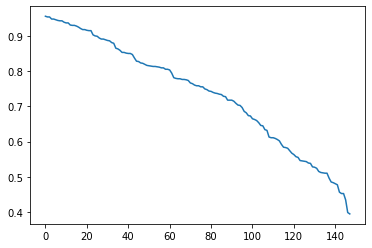

In [342]:
plt.plot(covid['Human Development Index 2019 (HDI)'])
plt.show()

In [343]:
covid.describe()

,HDI rank,Human Development Index 2019 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,GDP 2019 (US$),GDP per capita 2019 (US$),GDP growth 2019 (annual %),Inflation Rate 2019 (%),Unemployment Rate 2020 (%),total_vaccinations,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million,New Deaths/1M pop
count,148.000000,148.000000,148.000000,148.000000,148.000000,148.000000,1.480000e+02,148.000000,148.000000,148.000000,148.000000,1.480000e+02,1.480000e+02,1.430000e+02,1.220000e+02,1.480000e+02,148.000000,148.000000,143.000000,148.000000,67.000000
mean,89.358108,0.736486,73.254122,13.654646,8.835875,22055.442507,5.689418e+11,16115.807130,2.862133,3.250608,8.127162,2.642093e+07,1.414767e+07,7.546039e+06,6.015731e+05,3.590498e+05,49.029189,29.021959,21.121538,7835.141892,2.270746
std,55.942391,0.151265,7.603609,2.924268,3.183824,20824.755374,2.196546e+12,20888.151087,2.903664,5.315561,5.369888,1.395674e+08,6.116941e+07,2.528019e+07,2.491923e+06,1.931005e+06,45.305844,24.913804,21.605296,10972.507067,4.112967
min,1.000000,0.394000,54.240000,6.471450,1.644299,1034.677638,8.247185e+08,411.552340,-6.700000,-3.233389,0.690000,4.078000e+03,4.078000e+03,1.140000e+02,3.000000e+01,2.720000e+02,0.040000,0.040000,0.000000,35.000000,0.040000
25%,39.750000,0.610500,67.800000,11.521392,6.452716,5279.974073,1.409808e+10,2494.581828,1.212137,0.824152,4.545000,4.214112e+05,2.819138e+05,1.282435e+05,1.974300e+04,1.016100e+04,6.225000,3.887500,2.070000,1734.000000,0.300000
50%,86.000000,0.759000,75.050000,13.991780,9.201735,13936.969180,5.440082e+10,6306.250015,2.432134,2.186902,6.535000,2.062887e+06,1.418607e+06,8.326730e+05,8.641000e+04,3.590300e+04,36.730000,24.890000,13.160000,6363.500000,0.700000
75%,138.500000,0.855500,78.735000,15.644513,11.506941,34424.788272,3.078324e+11,23167.863622,4.583666,3.636446,10.240000,1.012821e+07,5.617409e+06,4.193453e+06,2.925110e+05,1.507125e+05,85.875000,49.370000,38.050000,10735.500000,2.000000
max,189.000000,0.957000,84.860000,21.954330,14.151680,92418.230360,2.143323e+13,114704.594171,18.723525,50.994052,28.740000,1.601249e+09,6.220000e+08,2.232990e+08,2.474100e+07,2.242429e+07,170.010000,89.710000,84.650000,118759.000000,26.000000


In [344]:
covid.isnull().sum()

Country Code                               0
Country                                    0
HDI rank                                   0
Human Development Index 2019 (HDI)         0
Life expectancy at birth                   0
Expected years of schooling                0
Mean years of schooling                    0
Gross national income (GNI) per capita     0
GDP 2019 (US$)                             0
GDP per capita 2019 (US$)                  0
GDP growth 2019 (annual %)                 0
Inflation Rate 2019 (%)                    0
Unemployment Rate 2020 (%)                 0
Region                                     0
IncomeGroup                                0
total_vaccinations                         0
date                                       0
people_vaccinated                          0
people_fully_vaccinated                    5
daily_vaccinations_raw                    26
daily_vaccinations                         0
total_vaccinations_per_hundred             0
people_vac

In [345]:
covid['TotalDeaths'].value_counts()

26         2
195        2
212        2
8,250      1
1,485      1
942        1
19         1
239,616    1
9,686      1
3,434      1
3,956      1
3,814      1
1,383      1
20,255     1
423        1
4,997      1
88         1
286        1
776        1
923        1
802        1
108        1
30,363     1
2,139      1
2,303      1
15,160     1
298        1
52,916     1
6,466      1
75,257     1
601        1
799        1
1,334      1
2,970      1
8,212      1
196,138    1
4,381      1
155        1
211        1
5,019      1
10,000     1
628,152    1
6,791      1
630        1
27,577     1
5,035      1
2          1
423,243    1
10,737     1
90,552     1
2,548      1
770        1
119,801    1
30,797     1
7,897      1
129,515    1
30,025     1
3,355      1
4,413      1
227        1
6,677      1
12,536     1
412        1
1,272      1
92,114     1
8,552      1
51,184     1
5,950      1
5,491      1
326        1
18,533     1
7,758      1
2,632      1
1,629      1
4,324      1
17,754     1
177        1

In [346]:
covid.nunique()

Country Code                              148
Country                                   148
HDI rank                                  126
Human Development Index 2019 (HDI)        126
Life expectancy at birth                  142
Expected years of schooling               148
Mean years of schooling                   147
Gross national income (GNI) per capita    148
GDP 2019 (US$)                            148
GDP per capita 2019 (US$)                 148
GDP growth 2019 (annual %)                148
Inflation Rate 2019 (%)                   148
Unemployment Rate 2020 (%)                134
Region                                      7
IncomeGroup                                 4
total_vaccinations                        148
date                                       18
people_vaccinated                         148
people_fully_vaccinated                   143
daily_vaccinations_raw                    121
daily_vaccinations                        148
total_vaccinations_per_hundred    

In [347]:
#There's the need to find lat and long for all countries to put it on the map 

In [348]:
url = 'https://gist.githubusercontent.com/tadast/8827699/raw/f5cac3d42d16b78348610fc4ec301e9234f82821/countries_codes_and_coordinates.csv'
countrylatlong = pd.read_csv(url)
countrylatlong

,Country,Alpha-2 code,Alpha-3 code,Numeric code,Latitude (average),Longitude (average)
0,Afghanistan,"""AF""","""AFG""","""4""","""33""","""65"""
1,Albania,"""AL""","""ALB""","""8""","""41""","""20"""
2,Algeria,"""DZ""","""DZA""","""12""","""28""","""3"""
3,American Samoa,"""AS""","""ASM""","""16""","""-14.3333""","""-170"""
4,Andorra,"""AD""","""AND""","""20""","""42.5""","""1.6"""
5,Angola,"""AO""","""AGO""","""24""","""-12.5""","""18.5"""
6,Anguilla,"""AI""","""AIA""","""660""","""18.25""","""-63.1667"""
7,Antarctica,"""AQ""","""ATA""","""10""","""-90""","""0"""
8,Antigua and Barbuda,"""AG""","""ATG""","""28""","""17.05""","""-61.8"""
9,Argentina,"""AR""","""ARG""","""32""","""-34""","""-64"""


In [349]:
countrylatlong.drop(['Numeric code', 'Alpha-2 code'], axis = 1, inplace = True)

In [350]:
countrylatlong

,Country,Alpha-3 code,Latitude (average),Longitude (average)
0,Afghanistan,"""AFG""","""33""","""65"""
1,Albania,"""ALB""","""41""","""20"""
2,Algeria,"""DZA""","""28""","""3"""
3,American Samoa,"""ASM""","""-14.3333""","""-170"""
4,Andorra,"""AND""","""42.5""","""1.6"""
5,Angola,"""AGO""","""-12.5""","""18.5"""
6,Anguilla,"""AIA""","""18.25""","""-63.1667"""
7,Antarctica,"""ATA""","""-90""","""0"""
8,Antigua and Barbuda,"""ATG""","""17.05""","""-61.8"""
9,Argentina,"""ARG""","""-34""","""-64"""


In [351]:
countrylatlong.rename({'Alpha-3 code': 'Country Code', 'Latitude (average)':'Latitude', 'Longitude (average)':'Longitude'}, axis=1, inplace=True)

In [352]:
countrylatlong

,Country,Country Code,Latitude,Longitude
0,Afghanistan,"""AFG""","""33""","""65"""
1,Albania,"""ALB""","""41""","""20"""
2,Algeria,"""DZA""","""28""","""3"""
3,American Samoa,"""ASM""","""-14.3333""","""-170"""
4,Andorra,"""AND""","""42.5""","""1.6"""
5,Angola,"""AGO""","""-12.5""","""18.5"""
6,Anguilla,"""AIA""","""18.25""","""-63.1667"""
7,Antarctica,"""ATA""","""-90""","""0"""
8,Antigua and Barbuda,"""ATG""","""17.05""","""-61.8"""
9,Argentina,"""ARG""","""-34""","""-64"""


In [353]:
countrylatlong['Country Code'] = countrylatlong['Country Code'].str.strip('" "')
countrylatlong['Latitude'] = countrylatlong['Latitude'].str.strip('" "')
countrylatlong['Longitude'] = countrylatlong['Longitude'].str.strip('" "')

In [354]:
countrylatlong

,Country,Country Code,Latitude,Longitude
0,Afghanistan,AFG,33,65
1,Albania,ALB,41,20
2,Algeria,DZA,28,3
3,American Samoa,ASM,-14.3333,-170
4,Andorra,AND,42.5,1.6
5,Angola,AGO,-12.5,18.5
6,Anguilla,AIA,18.25,-63.1667
7,Antarctica,ATA,-90,0
8,Antigua and Barbuda,ATG,17.05,-61.8
9,Argentina,ARG,-34,-64


In [355]:
covid

,Country Code,Country,HDI rank,Human Development Index 2019 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,GDP 2019 (US$),GDP per capita 2019 (US$),GDP growth 2019 (annual %),Inflation Rate 2019 (%),Unemployment Rate 2020 (%),Region,IncomeGroup,total_vaccinations,date,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop
0,NOR,Norway,1,0.957,82.40,18.066150,12.897750,66494.252170,4.033364e+11,75419.634869,1.154722,2.167730,4.620000,Europe & Central Asia,High income,5183188,2021-07-27,3433640,1749548.0,123595.0,54198,95.61,63.34,32.27,9997,Norway,"136,881",+158,799,NaN,"88,952",NaN,"47,130",3,"6,586,068","5,466,648",Europe,29,NaN,"8,621"
1,IRL,Ireland,2,0.955,82.31,18.705290,12.666331,68370.587370,3.886987e+11,78660.956463,5.549767,0.939044,5.920000,Europe & Central Asia,High income,5726222,2021-07-28,3248996,2686260.0,110673.0,71265,115.97,65.80,54.40,14433,Ireland,"298,048","+1,361","5,035",NaN,"266,896",+333,"26,117",26,"4,729,538","4,996,826",Europe,272,NaN,"5,227"
2,CHE,Switzerland,2,0.955,83.78,16.328440,13.380812,69393.520760,7.030824e+11,81993.727126,0.928832,0.362916,4.940000,Europe & Central Asia,High income,8875854,2021-07-27,4631104,4081767.0,113111.0,92323,102.56,53.51,47.16,10667,Switzerland,"716,865",+827,"10,906",+3,"691,972",+129,"13,987",37,"9,030,792","8,722,424",Europe,95,0.30,"1,604"
3,HKG,"Hong Kong, China (SAR)",4,0.949,84.86,16.929470,12.279960,62984.765530,3.657115e+11,48713.473748,-1.249488,2.864928,5.800000,East Asia & Pacific,High income,5464797,2021-07-28,3132660,2332137.0,70783.0,64331,72.89,41.79,31.11,8581,Hong Kong,"11,983",+2,212,NaN,"11,709",+2,62,NaN,"21,390,075","7,562,128",Asia,0.3,NaN,8
4,ISL,Iceland,4,0.949,82.99,19.083090,12.772787,54682.380570,2.418804e+10,66944.833077,1.918677,3.013972,5.010000,Europe & Central Asia,High income,468416,2021-07-23,267830,253666.0,21266.0,7546,137.26,78.48,74.33,22113,Iceland,"7,676",+131,30,NaN,"6,680",+12,966,8,"852,333","343,616",Europe,381,NaN,"2,811"
5,DEU,Germany,6,0.947,81.33,16.977190,14.151680,55314.353550,3.861124e+12,46445.249101,0.555451,1.445667,4.310000,Europe & Central Asia,High income,90998253,2021-07-28,51007130,42362788.0,1417840.0,868959,108.61,60.88,50.56,10371,Germany,"3,771,050","+1,509","92,114",+8,"3,650,900","+1,800","28,036",347,"65,845,568","84,071,162",Europe,18,0.10,333
6,SWE,Sweden,7,0.945,82.80,19.482340,12.548470,54507.805040,5.308839e+11,51615.020651,1.260980,1.784151,8.450000,Europe & Central Asia,High income,10399256,2021-07-28,6330448,4068808.0,123779.0,109894,102.97,62.68,40.29,10881,Sweden,"1,099,414",NaN,"14,618",NaN,"1,075,469",+247,"9,327",16,"11,300,881","10,166,741",Europe,NaN,NaN,917
7,AUS,Australia,8,0.944,83.44,21.954330,12.724691,48084.842070,1.396567e+12,55060.326101,2.160956,1.610768,6.610000,East Asia & Pacific,High income,11593766,2021-07-28,8048704,3545062.0,196982.0,160533,45.47,31.56,13.90,6295,Australia,"33,726",+252,923,+2,"29,926",NaN,"2,877",59,"24,671,699","25,816,549",Australia/Oceania,10,0.08,111
8,NLD,Netherlands,8,0.944,82.28,18.485130,12.414800,57707.068670,9.070509e+11,52331.316728,1.677418,2.633699,4.090000,Europe & Central Asia,High income,19751575,2021-07-25,11855109,8657328.0,NaN,240410,115.27,69.19,50.52,14030,Netherlands,"1,859,199","+4,415","17,815",+3,"1,666,554",+530,"174,830",171,"15,767,121","17,175,526",Europe,257,0.20,"10,179"
9,DNK,Denmark,10,0.940,80.90,18.893420,12.613803,58661.870840,3.501043e+11,60170.342637,2.849514,0.758132,5.660000,Europe & Central Asia,High income,7157842,2021-07-28,4146424,3057911.0,178071.0,89141,123.58,71.59,52.79,15390,D

In [356]:
covidlatlong = countrylatlong.merge(covid, on= 'Country Code', how = 'inner', indicator = True)

In [357]:
covidlatlong

,Country_x,Country Code,Latitude,Longitude,Country_y,HDI rank,Human Development Index 2019 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,GDP 2019 (US$),GDP per capita 2019 (US$),GDP growth 2019 (annual %),Inflation Rate 2019 (%),Unemployment Rate 2020 (%),Region,IncomeGroup,total_vaccinations,date,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop,_merge
0,Afghanistan,AFG,33,65,Afghanistan,169,0.511,64.83,10.176430,3.930000,2229.362021,1.929110e+10,507.103432,3.911603,2.302373,11.730000,South Asia,Low income,1277085,2021-07-27,939835,219159.0,4015.0,22461,3.28,2.41,0.56,577,Afghanistan,"146,523",+527,"6,677",+62,"96,692",+966,"43,154","1,124","701,952","39,864,282",Asia,13,2.00,"1,083",both
1,Albania,ALB,41,20,Albania,69,0.795,78.57,14.695620,10.145730,13998.299890,1.527918e+10,5353.244856,2.240070,1.411091,11.700000,Europe & Central Asia,Upper middle income,1138771,2021-07-25,640047,498724.0,23655.0,17565,39.57,22.24,17.33,6104,Albania,"132,999",+47,"2,457",NaN,"130,187",+13,355,3,"916,777","2,874,426",Europe,16,NaN,124,both
2,Algeria,DZA,28,3,Algeria,91,0.748,76.88,14.604302,7.986548,11173.956810,1.710913e+11,3973.964072,0.800000,1.951768,12.830000,Middle East & North Africa,Lower middle income,75000,2021-02-19,75000,NaN,30.0,3748,0.17,0.17,NaN,85,Algeria,"168,668","+1,537","4,189",+28,"113,707",+807,"50,772",37,"230,861","44,697,286",Africa,34,0.60,"1,136",both
3,Angola,AGO,-12.5,18.5,Angola,148,0.581,61.15,11.777202,5.173993,6104.054640,8.881570e+10,2790.726615,-0.624644,17.081215,7.700000,Sub-Saharan Africa,Lower middle income,1592537,2021-07-19,958373,634164.0,NaN,33700,4.85,2.92,1.93,1025,Angola,"42,288",NaN,"1,000",NaN,"35,964",NaN,"5,324",8,"681,443","33,955,402",Africa,NaN,NaN,157,both
4,Armenia,ARM,40,45,Armenia,81,0.776,75.09,13.068610,11.301740,13894.013020,1.367280e+10,4622.733493,7.600000,1.443447,20.209999,Europe & Central Asia,Upper middle income,152529,2021-07-25,108674,43855.0,NaN,3282,5.15,3.67,1.48,1108,Armenia,"229,603",+233,"4,604",+7,"219,502",+123,"5,497",NaN,"1,328,107","2,969,182",Asia,78,2.00,"1,851",both
5,Australia,AUS,-27,133,Australia,8,0.944,83.44,21.954330,12.724691,48084.842070,1.396567e+12,55060.326101,2.160956,1.610768,6.610000,East Asia & Pacific,High income,11593766,2021-07-28,8048704,3545062.0,196982.0,160533,45.47,31.56,13.90,6295,Australia,"33,726",+252,923,+2,"29,926",NaN,"2,877",59,"24,671,699","25,816,549",Australia/Oceania,10,0.08,111,both
6,Austria,AUT,47.3333,13.3333,Austria,18,0.922,81.54,16.092070,12.546144,56196.898690,4.450754e+11,50137.662776,1.418734,1.530896,5.770000,Europe & Central Asia,High income,9553753,2021-07-28,5264597,4479543.0,143537.0,91715,106.08,58.45,49.74,10183,Austria,"658,004",+503,"10,737",NaN,"642,229",+349,"5,038",40,"65,725,061","9,061,466",Europe,56,NaN,556,both
7,Azerbaijan,AZE,40.5,47.5,Azerbaijan,88,0.756,73.01,12.893640,10.575430,13783.679950,4.804765e+10,4793.587020,2.218704,2.610572,6.270000,Europe & Central Asia,Upper middle income,4714039,2021-07-28,2731114,1982925.0,88978.0,64583,46.49,26.94,19.56,6370,Azerbaijan,"342,548",+615,"5,019",+5,"332,574",+181,"4,955",NaN,"4,014,073","10,237,045",Asia,60,0.50,484,both
8,Bahamas,BHS,24.25,-76,Bahamas,58,0.814,73.92,12.899450,11.436920,33747.212640,1.357880e+10,34863.742098,1.217874,2.491235,14.410000,Latin America & Caribbean,High income,103164,2021-07-24,60578,43943.0,110.0,1689,26.23,15.40,11.17,4295,Bahamas,"14,457",NaN,286,NaN,"12,501",NaN,"1,670",10,"118,017","397,267",North America,NaN,NaN,"4,204",both
9,Bahrain,BHR,26,50.55,Bahrain,42,0.852,77.29,16.254820,9.51

In [358]:
covidlatlong = covidlatlong.drop_duplicates(subset=['Country Code'])

In [359]:
covidlatlong

,Country_x,Country Code,Latitude,Longitude,Country_y,HDI rank,Human Development Index 2019 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,GDP 2019 (US$),GDP per capita 2019 (US$),GDP growth 2019 (annual %),Inflation Rate 2019 (%),Unemployment Rate 2020 (%),Region,IncomeGroup,total_vaccinations,date,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop,_merge
0,Afghanistan,AFG,33,65,Afghanistan,169,0.511,64.83,10.176430,3.930000,2229.362021,1.929110e+10,507.103432,3.911603,2.302373,11.730000,South Asia,Low income,1277085,2021-07-27,939835,219159.0,4015.0,22461,3.28,2.41,0.56,577,Afghanistan,"146,523",+527,"6,677",+62,"96,692",+966,"43,154","1,124","701,952","39,864,282",Asia,13,2.00,"1,083",both
1,Albania,ALB,41,20,Albania,69,0.795,78.57,14.695620,10.145730,13998.299890,1.527918e+10,5353.244856,2.240070,1.411091,11.700000,Europe & Central Asia,Upper middle income,1138771,2021-07-25,640047,498724.0,23655.0,17565,39.57,22.24,17.33,6104,Albania,"132,999",+47,"2,457",NaN,"130,187",+13,355,3,"916,777","2,874,426",Europe,16,NaN,124,both
2,Algeria,DZA,28,3,Algeria,91,0.748,76.88,14.604302,7.986548,11173.956810,1.710913e+11,3973.964072,0.800000,1.951768,12.830000,Middle East & North Africa,Lower middle income,75000,2021-02-19,75000,NaN,30.0,3748,0.17,0.17,NaN,85,Algeria,"168,668","+1,537","4,189",+28,"113,707",+807,"50,772",37,"230,861","44,697,286",Africa,34,0.60,"1,136",both
3,Angola,AGO,-12.5,18.5,Angola,148,0.581,61.15,11.777202,5.173993,6104.054640,8.881570e+10,2790.726615,-0.624644,17.081215,7.700000,Sub-Saharan Africa,Lower middle income,1592537,2021-07-19,958373,634164.0,NaN,33700,4.85,2.92,1.93,1025,Angola,"42,288",NaN,"1,000",NaN,"35,964",NaN,"5,324",8,"681,443","33,955,402",Africa,NaN,NaN,157,both
4,Armenia,ARM,40,45,Armenia,81,0.776,75.09,13.068610,11.301740,13894.013020,1.367280e+10,4622.733493,7.600000,1.443447,20.209999,Europe & Central Asia,Upper middle income,152529,2021-07-25,108674,43855.0,NaN,3282,5.15,3.67,1.48,1108,Armenia,"229,603",+233,"4,604",+7,"219,502",+123,"5,497",NaN,"1,328,107","2,969,182",Asia,78,2.00,"1,851",both
5,Australia,AUS,-27,133,Australia,8,0.944,83.44,21.954330,12.724691,48084.842070,1.396567e+12,55060.326101,2.160956,1.610768,6.610000,East Asia & Pacific,High income,11593766,2021-07-28,8048704,3545062.0,196982.0,160533,45.47,31.56,13.90,6295,Australia,"33,726",+252,923,+2,"29,926",NaN,"2,877",59,"24,671,699","25,816,549",Australia/Oceania,10,0.08,111,both
6,Austria,AUT,47.3333,13.3333,Austria,18,0.922,81.54,16.092070,12.546144,56196.898690,4.450754e+11,50137.662776,1.418734,1.530896,5.770000,Europe & Central Asia,High income,9553753,2021-07-28,5264597,4479543.0,143537.0,91715,106.08,58.45,49.74,10183,Austria,"658,004",+503,"10,737",NaN,"642,229",+349,"5,038",40,"65,725,061","9,061,466",Europe,56,NaN,556,both
7,Azerbaijan,AZE,40.5,47.5,Azerbaijan,88,0.756,73.01,12.893640,10.575430,13783.679950,4.804765e+10,4793.587020,2.218704,2.610572,6.270000,Europe & Central Asia,Upper middle income,4714039,2021-07-28,2731114,1982925.0,88978.0,64583,46.49,26.94,19.56,6370,Azerbaijan,"342,548",+615,"5,019",+5,"332,574",+181,"4,955",NaN,"4,014,073","10,237,045",Asia,60,0.50,484,both
8,Bahamas,BHS,24.25,-76,Bahamas,58,0.814,73.92,12.899450,11.436920,33747.212640,1.357880e+10,34863.742098,1.217874,2.491235,14.410000,Latin America & Caribbean,High income,103164,2021-07-24,60578,43943.0,110.0,1689,26.23,15.40,11.17,4295,Bahamas,"14,457",NaN,286,NaN,"12,501",NaN,"1,670",10,"118,017","397,267",North America,NaN,NaN,"4,204",both
9,Bahrain,BHR,26,50.55,Bahrain,42,0.852,77.29,16.254820,9.51

In [360]:
covidlatlong.reset_index(drop=True, inplace = True)

In [361]:
covidlatlong

,Country_x,Country Code,Latitude,Longitude,Country_y,HDI rank,Human Development Index 2019 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,GDP 2019 (US$),GDP per capita 2019 (US$),GDP growth 2019 (annual %),Inflation Rate 2019 (%),Unemployment Rate 2020 (%),Region,IncomeGroup,total_vaccinations,date,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop,_merge
0,Afghanistan,AFG,33,65,Afghanistan,169,0.511,64.83,10.176430,3.930000,2229.362021,1.929110e+10,507.103432,3.911603,2.302373,11.730000,South Asia,Low income,1277085,2021-07-27,939835,219159.0,4015.0,22461,3.28,2.41,0.56,577,Afghanistan,"146,523",+527,"6,677",+62,"96,692",+966,"43,154","1,124","701,952","39,864,282",Asia,13,2.00,"1,083",both
1,Albania,ALB,41,20,Albania,69,0.795,78.57,14.695620,10.145730,13998.299890,1.527918e+10,5353.244856,2.240070,1.411091,11.700000,Europe & Central Asia,Upper middle income,1138771,2021-07-25,640047,498724.0,23655.0,17565,39.57,22.24,17.33,6104,Albania,"132,999",+47,"2,457",NaN,"130,187",+13,355,3,"916,777","2,874,426",Europe,16,NaN,124,both
2,Algeria,DZA,28,3,Algeria,91,0.748,76.88,14.604302,7.986548,11173.956810,1.710913e+11,3973.964072,0.800000,1.951768,12.830000,Middle East & North Africa,Lower middle income,75000,2021-02-19,75000,NaN,30.0,3748,0.17,0.17,NaN,85,Algeria,"168,668","+1,537","4,189",+28,"113,707",+807,"50,772",37,"230,861","44,697,286",Africa,34,0.60,"1,136",both
3,Angola,AGO,-12.5,18.5,Angola,148,0.581,61.15,11.777202,5.173993,6104.054640,8.881570e+10,2790.726615,-0.624644,17.081215,7.700000,Sub-Saharan Africa,Lower middle income,1592537,2021-07-19,958373,634164.0,NaN,33700,4.85,2.92,1.93,1025,Angola,"42,288",NaN,"1,000",NaN,"35,964",NaN,"5,324",8,"681,443","33,955,402",Africa,NaN,NaN,157,both
4,Armenia,ARM,40,45,Armenia,81,0.776,75.09,13.068610,11.301740,13894.013020,1.367280e+10,4622.733493,7.600000,1.443447,20.209999,Europe & Central Asia,Upper middle income,152529,2021-07-25,108674,43855.0,NaN,3282,5.15,3.67,1.48,1108,Armenia,"229,603",+233,"4,604",+7,"219,502",+123,"5,497",NaN,"1,328,107","2,969,182",Asia,78,2.00,"1,851",both
5,Australia,AUS,-27,133,Australia,8,0.944,83.44,21.954330,12.724691,48084.842070,1.396567e+12,55060.326101,2.160956,1.610768,6.610000,East Asia & Pacific,High income,11593766,2021-07-28,8048704,3545062.0,196982.0,160533,45.47,31.56,13.90,6295,Australia,"33,726",+252,923,+2,"29,926",NaN,"2,877",59,"24,671,699","25,816,549",Australia/Oceania,10,0.08,111,both
6,Austria,AUT,47.3333,13.3333,Austria,18,0.922,81.54,16.092070,12.546144,56196.898690,4.450754e+11,50137.662776,1.418734,1.530896,5.770000,Europe & Central Asia,High income,9553753,2021-07-28,5264597,4479543.0,143537.0,91715,106.08,58.45,49.74,10183,Austria,"658,004",+503,"10,737",NaN,"642,229",+349,"5,038",40,"65,725,061","9,061,466",Europe,56,NaN,556,both
7,Azerbaijan,AZE,40.5,47.5,Azerbaijan,88,0.756,73.01,12.893640,10.575430,13783.679950,4.804765e+10,4793.587020,2.218704,2.610572,6.270000,Europe & Central Asia,Upper middle income,4714039,2021-07-28,2731114,1982925.0,88978.0,64583,46.49,26.94,19.56,6370,Azerbaijan,"342,548",+615,"5,019",+5,"332,574",+181,"4,955",NaN,"4,014,073","10,237,045",Asia,60,0.50,484,both
8,Bahamas,BHS,24.25,-76,Bahamas,58,0.814,73.92,12.899450,11.436920,33747.212640,1.357880e+10,34863.742098,1.217874,2.491235,14.410000,Latin America & Caribbean,High income,103164,2021-07-24,60578,43943.0,110.0,1689,26.23,15.40,11.17,4295,Bahamas,"14,457",NaN,286,NaN,"12,501",NaN,"1,670",10,"118,017","397,267",North America,NaN,NaN,"4,204",both
9,Bahrain,BHR,26,50.55,Bahrain,42,0.852,77.29,16.254820,9.51

In [362]:
covidlatlong = covidlatlong.drop(['Country_y','_merge'], axis = 1)

In [363]:
covidlatlong

,Country_x,Country Code,Latitude,Longitude,HDI rank,Human Development Index 2019 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,GDP 2019 (US$),GDP per capita 2019 (US$),GDP growth 2019 (annual %),Inflation Rate 2019 (%),Unemployment Rate 2020 (%),Region,IncomeGroup,total_vaccinations,date,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop
0,Afghanistan,AFG,33,65,169,0.511,64.83,10.176430,3.930000,2229.362021,1.929110e+10,507.103432,3.911603,2.302373,11.730000,South Asia,Low income,1277085,2021-07-27,939835,219159.0,4015.0,22461,3.28,2.41,0.56,577,Afghanistan,"146,523",+527,"6,677",+62,"96,692",+966,"43,154","1,124","701,952","39,864,282",Asia,13,2.00,"1,083"
1,Albania,ALB,41,20,69,0.795,78.57,14.695620,10.145730,13998.299890,1.527918e+10,5353.244856,2.240070,1.411091,11.700000,Europe & Central Asia,Upper middle income,1138771,2021-07-25,640047,498724.0,23655.0,17565,39.57,22.24,17.33,6104,Albania,"132,999",+47,"2,457",NaN,"130,187",+13,355,3,"916,777","2,874,426",Europe,16,NaN,124
2,Algeria,DZA,28,3,91,0.748,76.88,14.604302,7.986548,11173.956810,1.710913e+11,3973.964072,0.800000,1.951768,12.830000,Middle East & North Africa,Lower middle income,75000,2021-02-19,75000,NaN,30.0,3748,0.17,0.17,NaN,85,Algeria,"168,668","+1,537","4,189",+28,"113,707",+807,"50,772",37,"230,861","44,697,286",Africa,34,0.60,"1,136"
3,Angola,AGO,-12.5,18.5,148,0.581,61.15,11.777202,5.173993,6104.054640,8.881570e+10,2790.726615,-0.624644,17.081215,7.700000,Sub-Saharan Africa,Lower middle income,1592537,2021-07-19,958373,634164.0,NaN,33700,4.85,2.92,1.93,1025,Angola,"42,288",NaN,"1,000",NaN,"35,964",NaN,"5,324",8,"681,443","33,955,402",Africa,NaN,NaN,157
4,Armenia,ARM,40,45,81,0.776,75.09,13.068610,11.301740,13894.013020,1.367280e+10,4622.733493,7.600000,1.443447,20.209999,Europe & Central Asia,Upper middle income,152529,2021-07-25,108674,43855.0,NaN,3282,5.15,3.67,1.48,1108,Armenia,"229,603",+233,"4,604",+7,"219,502",+123,"5,497",NaN,"1,328,107","2,969,182",Asia,78,2.00,"1,851"
5,Australia,AUS,-27,133,8,0.944,83.44,21.954330,12.724691,48084.842070,1.396567e+12,55060.326101,2.160956,1.610768,6.610000,East Asia & Pacific,High income,11593766,2021-07-28,8048704,3545062.0,196982.0,160533,45.47,31.56,13.90,6295,Australia,"33,726",+252,923,+2,"29,926",NaN,"2,877",59,"24,671,699","25,816,549",Australia/Oceania,10,0.08,111
6,Austria,AUT,47.3333,13.3333,18,0.922,81.54,16.092070,12.546144,56196.898690,4.450754e+11,50137.662776,1.418734,1.530896,5.770000,Europe & Central Asia,High income,9553753,2021-07-28,5264597,4479543.0,143537.0,91715,106.08,58.45,49.74,10183,Austria,"658,004",+503,"10,737",NaN,"642,229",+349,"5,038",40,"65,725,061","9,061,466",Europe,56,NaN,556
7,Azerbaijan,AZE,40.5,47.5,88,0.756,73.01,12.893640,10.575430,13783.679950,4.804765e+10,4793.587020,2.218704,2.610572,6.270000,Europe & Central Asia,Upper middle income,4714039,2021-07-28,2731114,1982925.0,88978.0,64583,46.49,26.94,19.56,6370,Azerbaijan,"342,548",+615,"5,019",+5,"332,574",+181,"4,955",NaN,"4,014,073","10,237,045",Asia,60,0.50,484
8,Bahamas,BHS,24.25,-76,58,0.814,73.92,12.899450,11.436920,33747.212640,1.357880e+10,34863.742098,1.217874,2.491235,14.410000,Latin America & Caribbean,High income,103164,2021-07-24,60578,43943.0,110.0,1689,26.23,15.40,11.17,4295,Bahamas,"14,457",NaN,286,NaN,"12,501",NaN,"1,670",10,"118,017","397,267",North America,NaN,NaN,"4,204"
9,Bahrain,BHR,26,50.55,42,0.852,77.29,16.254820,9.519200,42521.704510,3.857407e+10,23503.977127,1.819175,1.005820,4.090000,Middle East & North Africa,High income,2287637,2021-07-28,1105717,1049663.0,818

In [364]:
covidlatlong.rename({'Country_x': 'Country'}, axis=1, inplace=True)

In [365]:
covidlatlong

,Country,Country Code,Latitude,Longitude,HDI rank,Human Development Index 2019 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,GDP 2019 (US$),GDP per capita 2019 (US$),GDP growth 2019 (annual %),Inflation Rate 2019 (%),Unemployment Rate 2020 (%),Region,IncomeGroup,total_vaccinations,date,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop
0,Afghanistan,AFG,33,65,169,0.511,64.83,10.176430,3.930000,2229.362021,1.929110e+10,507.103432,3.911603,2.302373,11.730000,South Asia,Low income,1277085,2021-07-27,939835,219159.0,4015.0,22461,3.28,2.41,0.56,577,Afghanistan,"146,523",+527,"6,677",+62,"96,692",+966,"43,154","1,124","701,952","39,864,282",Asia,13,2.00,"1,083"
1,Albania,ALB,41,20,69,0.795,78.57,14.695620,10.145730,13998.299890,1.527918e+10,5353.244856,2.240070,1.411091,11.700000,Europe & Central Asia,Upper middle income,1138771,2021-07-25,640047,498724.0,23655.0,17565,39.57,22.24,17.33,6104,Albania,"132,999",+47,"2,457",NaN,"130,187",+13,355,3,"916,777","2,874,426",Europe,16,NaN,124
2,Algeria,DZA,28,3,91,0.748,76.88,14.604302,7.986548,11173.956810,1.710913e+11,3973.964072,0.800000,1.951768,12.830000,Middle East & North Africa,Lower middle income,75000,2021-02-19,75000,NaN,30.0,3748,0.17,0.17,NaN,85,Algeria,"168,668","+1,537","4,189",+28,"113,707",+807,"50,772",37,"230,861","44,697,286",Africa,34,0.60,"1,136"
3,Angola,AGO,-12.5,18.5,148,0.581,61.15,11.777202,5.173993,6104.054640,8.881570e+10,2790.726615,-0.624644,17.081215,7.700000,Sub-Saharan Africa,Lower middle income,1592537,2021-07-19,958373,634164.0,NaN,33700,4.85,2.92,1.93,1025,Angola,"42,288",NaN,"1,000",NaN,"35,964",NaN,"5,324",8,"681,443","33,955,402",Africa,NaN,NaN,157
4,Armenia,ARM,40,45,81,0.776,75.09,13.068610,11.301740,13894.013020,1.367280e+10,4622.733493,7.600000,1.443447,20.209999,Europe & Central Asia,Upper middle income,152529,2021-07-25,108674,43855.0,NaN,3282,5.15,3.67,1.48,1108,Armenia,"229,603",+233,"4,604",+7,"219,502",+123,"5,497",NaN,"1,328,107","2,969,182",Asia,78,2.00,"1,851"
5,Australia,AUS,-27,133,8,0.944,83.44,21.954330,12.724691,48084.842070,1.396567e+12,55060.326101,2.160956,1.610768,6.610000,East Asia & Pacific,High income,11593766,2021-07-28,8048704,3545062.0,196982.0,160533,45.47,31.56,13.90,6295,Australia,"33,726",+252,923,+2,"29,926",NaN,"2,877",59,"24,671,699","25,816,549",Australia/Oceania,10,0.08,111
6,Austria,AUT,47.3333,13.3333,18,0.922,81.54,16.092070,12.546144,56196.898690,4.450754e+11,50137.662776,1.418734,1.530896,5.770000,Europe & Central Asia,High income,9553753,2021-07-28,5264597,4479543.0,143537.0,91715,106.08,58.45,49.74,10183,Austria,"658,004",+503,"10,737",NaN,"642,229",+349,"5,038",40,"65,725,061","9,061,466",Europe,56,NaN,556
7,Azerbaijan,AZE,40.5,47.5,88,0.756,73.01,12.893640,10.575430,13783.679950,4.804765e+10,4793.587020,2.218704,2.610572,6.270000,Europe & Central Asia,Upper middle income,4714039,2021-07-28,2731114,1982925.0,88978.0,64583,46.49,26.94,19.56,6370,Azerbaijan,"342,548",+615,"5,019",+5,"332,574",+181,"4,955",NaN,"4,014,073","10,237,045",Asia,60,0.50,484
8,Bahamas,BHS,24.25,-76,58,0.814,73.92,12.899450,11.436920,33747.212640,1.357880e+10,34863.742098,1.217874,2.491235,14.410000,Latin America & Caribbean,High income,103164,2021-07-24,60578,43943.0,110.0,1689,26.23,15.40,11.17,4295,Bahamas,"14,457",NaN,286,NaN,"12,501",NaN,"1,670",10,"118,017","397,267",North America,NaN,NaN,"4,204"
9,Bahrain,BHR,26,50.55,42,0.852,77.29,16.254820,9.519200,42521.704510,3.857407e+10,23503.977127,1.819175,1.005820,4.090000,Middle East & North Africa,High income,2287637,2021-07-28,1105717,1049663.0,81811

In [366]:
covidlatlong.to_excel('covidlatlong.xlsx', index = False)

#### 5.1 Mapping

In [2]:
import pandas as pd

In [3]:
covidlatlong = pd.read_excel('C:/Users/andre/Documents/Programming Languages/Python/pimespython/Project/covidwebscraping/actualcovid19project/covidlatlong.xlsx')

In [4]:
covidlatlong.head(3)

,Country,Country Code,Latitude,Longitude,HDI rank,Human Development Index 2019 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,...,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop
0,Afghanistan,AFG,33.0,65.0,169,0.511,64.83,10.176430,3.930000,2229.362021,...,"96,692",+966,"43,154","1,124","701,952","39,864,282",Asia,13,2.0,"1,083"
1,Albania,ALB,41.0,20.0,69,0.795,78.57,14.695620,10.145730,13998.299890,...,"130,187",+13,355,3,"916,777","2,874,426",Europe,16,NaN,124
2,Algeria,DZA,28.0,3.0,91,0.748,76.88,14.604302,7.986548,11173.956810,...,"113,707",+807,"50,772",37,"230,861","44,697,286",Africa,34,0.6,"1,136"


In [5]:
covidlatlong.dtypes

Country                                    object
Country Code                               object
Latitude                                  float64
Longitude                                 float64
HDI rank                                    int64
Human Development Index 2019 (HDI)        float64
Life expectancy at birth                  float64
Expected years of schooling               float64
Mean years of schooling                   float64
Gross national income (GNI) per capita    float64
GDP 2019 (US$)                            float64
GDP per capita 2019 (US$)                 float64
GDP growth 2019 (annual %)                float64
Inflation Rate 2019 (%)                   float64
Unemployment Rate 2020 (%)                float64
Region                                     object
IncomeGroup                                object
total_vaccinations                          int64
date                                       object
people_vaccinated                           int64


#### 5.1.1 Globe

In [6]:
import geopandas as gpd

In [8]:
from mpl_toolkits.basemap import Basemap 

In [9]:
import seaborn as sns 

In [10]:
import matplotlib.pyplot as plt
%matplotlib inline

In [11]:
covidlatlong.shape

(148, 42)

In [12]:
sns.color_palette('Set1',148)

[(0.8941176470588236, 0.10196078431372549, 0.10980392156862745),
 (0.21568627450980393, 0.49411764705882355, 0.7215686274509804),
 (0.30196078431372547, 0.6862745098039216, 0.2901960784313726),
 (0.596078431372549, 0.3058823529411765, 0.6392156862745098),
 (1.0, 0.4980392156862745, 0.0),
 (1.0, 1.0, 0.2),
 (0.6509803921568628, 0.33725490196078434, 0.1568627450980392),
 (0.9686274509803922, 0.5058823529411764, 0.7490196078431373),
 (0.6, 0.6, 0.6),
 (0.8941176470588236, 0.10196078431372549, 0.10980392156862745),
 (0.21568627450980393, 0.49411764705882355, 0.7215686274509804),
 (0.30196078431372547, 0.6862745098039216, 0.2901960784313726),
 (0.596078431372549, 0.3058823529411765, 0.6392156862745098),
 (1.0, 0.4980392156862745, 0.0),
 (1.0, 1.0, 0.2),
 (0.6509803921568628, 0.33725490196078434, 0.1568627450980392),
 (0.9686274509803922, 0.5058823529411764, 0.7490196078431373),
 (0.6, 0.6, 0.6),
 (0.8941176470588236, 0.10196078431372549, 0.10980392156862745),
 (0.21568627450980393, 0.49411764705882355, 0.7215686274509804),
 (0.30196078431372547, 0.6862745098039216, 0.2901960784313726),
 (0.596078431372549, 0.3058823529411765, 0.6392156862745098),
 (1.0, 0.4980392156862745, 0.0),
 (1.0, 1.0, 0.2),
 (0.6509803921568628, 0.33725490196078434, 0.1568627450980392),
 (0.9686274509803922, 0.5058823529411764, 0.7490196078431373),
 (0.6, 0.6, 0.6),
 (0.8941176470588236, 0.10196078431372549, 0.10980392156862745),
 (0.21568627450980393, 0.49411764705882355, 0.7215686274509804),
 (0.30196078431372547, 0.6862745098039216, 0.2901960784313726),
 (0.596078431372549, 0.3058823529411765, 0.6392156862745098),
 (1.0, 0.4980392156862745, 0.0),
 (1.0, 1.0, 0.2),
 (0.6509803921568628, 0.33725490196078434, 0.1568627450980392),
 (0.9686274509803922, 0.5058823529411764, 0.7490196078431373),
 (0.6, 0.6, 0.6),
 (0.8941176470588236, 0.10196078431372549, 0.10980392156862745),
 (0.21568627450980393, 0.49411764705882355, 0.7215686274509804),
 (0.30196078431372547, 0.6862745098039216, 0.2901960784313726),
 (0.596078431372549, 0.3058823529411765, 0.6392156862745098),
 (1.0, 0.4980392156862745, 0.0),
 (1.0, 1.0, 0.2),
 (0.6509803921568628, 0.33725490196078434, 0.1568627450980392),
 (0.9686274509803922, 0.5058823529411764, 0.7490196078431373),
 (0.6, 0.6, 0.6),
 (0.8941176470588236, 0.10196078431372549, 0.10980392156862745),
 (0.21568627450980393, 0.49411764705882355, 0.7215686274509804),
 (0.30196078431372547, 0.6862745098039216, 0.2901960784313726),
 (0.596078431372549, 0.3058823529411765, 0.6392156862745098),
 (1.0, 0.4980392156862745, 0.0),
 (1.0, 1.0, 0.2),
 (0.6509803921568628, 0.33725490196078434, 0.1568627450980392),
 (0.9686274509803922, 0.5058823529411764, 0.7490196078431373),
 (0.6, 0.6, 0.6),
 (0.8941176470588236, 0.10196078431372549, 0.10980392156862745),
 (0.21568627450980393, 0.49411764705882355, 0.7215686274509804),
 (0.30196078431372547, 0.6862745098039216, 0.2901960784313726),
 (0.596078431372549, 0.3058823529411765, 0.6392156862745098),
 (1.0, 0.4980392156862745, 0.0),
 (1.0, 1.0, 0.2),
 (0.6509803921568628, 0.33725490196078434, 0.1568627450980392),
 (0.9686274509803922, 0.5058823529411764, 0.7490196078431373),
 (0.6, 0.6, 0.6),
 (0.8941176470588236, 0.10196078431372549, 0.10980392156862745),
 (0.21568627450980393, 0.49411764705882355, 0.7215686274509804),
 (0.30196078431372547, 0.6862745098039216, 0.2901960784313726),
 (0.596078431372549, 0.3058823529411765, 0.6392156862745098),
 (1.0, 0.4980392156862745, 0.0),
 (1.0, 1.0, 0.2),
 (0.6509803921568628, 0.33725490196078434, 0.1568627450980392),
 (0.9686274509803922, 0.5058823529411764, 0.7490196078431373),
 (0.6, 0.6, 0.6),
 (0.8941176470588236, 0.10196078431372549, 0.10980392156862745),
 (0.21568627450980393, 0.49411764705882355, 0.7215686274509804),
 (0.30196078431372547, 0.6862745098039216, 0.2901960784313726),
 (0.596078431372549, 0.3058823529411765, 0.6392156862745098),
 (1.0, 0.4980392156862745, 0.0),
 (1.0, 1.0, 0.2),
 (0.6509803921568628, 0.33725490196078434, 0.1568627450980392),
 (0.968627450

In [13]:
country = list(covidlatlong['Country'].unique())
c = sns.color_palette('Set1',148)
label = country

In [14]:
country

['Afghanistan',
 'Albania',
 'Algeria',
 'Angola',
 'Armenia',
 'Australia',
 'Austria',
 'Azerbaijan',
 'Bahamas',
 'Bahrain',
 'Bangladesh',
 'Barbados',
 'Belarus',
 'Belgium',
 'Benin',
 'Bhutan',
 'Bolivia, Plurinational State of',
 'Bosnia and Herzegovina',
 'Botswana',
 'Brazil',
 'Brunei Darussalam',
 'Bulgaria',
 'Burkina Faso',
 'Cameroon',
 'Canada',
 'Cape Verde',
 'Chad',
 'Chile',
 'China',
 'Colombia',
 'Congo',
 'Costa Rica',
 "Côte d'Ivoire",
 'Croatia',
 'Cyprus',
 'Czech Republic',
 'Denmark',
 'Djibouti',
 'Dominican Republic',
 'Ecuador',
 'El Salvador',
 'Equatorial Guinea',
 'Estonia',
 'Ethiopia',
 'Fiji',
 'Finland',
 'France',
 'Gabon',
 'Gambia',
 'Georgia',
 'Germany',
 'Ghana',
 'Greece',
 'Guatemala',
 'Guinea',
 'Guinea-Bissau',
 'Guyana',
 'Haiti',
 'Honduras',
 'Hong Kong',
 'Hungary',
 'Iceland',
 'India',
 'Indonesia',
 'Iraq',
 'Ireland',
 'Israel',
 'Italy',
 'Jamaica',
 'Japan',
 'Jordan',
 'Korea, Republic of',
 'Kuwait',
 'Kyrgyzstan',
 "Lao Peop

In [15]:
c

[(0.8941176470588236, 0.10196078431372549, 0.10980392156862745),
 (0.21568627450980393, 0.49411764705882355, 0.7215686274509804),
 (0.30196078431372547, 0.6862745098039216, 0.2901960784313726),
 (0.596078431372549, 0.3058823529411765, 0.6392156862745098),
 (1.0, 0.4980392156862745, 0.0),
 (1.0, 1.0, 0.2),
 (0.6509803921568628, 0.33725490196078434, 0.1568627450980392),
 (0.9686274509803922, 0.5058823529411764, 0.7490196078431373),
 (0.6, 0.6, 0.6),
 (0.8941176470588236, 0.10196078431372549, 0.10980392156862745),
 (0.21568627450980393, 0.49411764705882355, 0.7215686274509804),
 (0.30196078431372547, 0.6862745098039216, 0.2901960784313726),
 (0.596078431372549, 0.3058823529411765, 0.6392156862745098),
 (1.0, 0.4980392156862745, 0.0),
 (1.0, 1.0, 0.2),
 (0.6509803921568628, 0.33725490196078434, 0.1568627450980392),
 (0.9686274509803922, 0.5058823529411764, 0.7490196078431373),
 (0.6, 0.6, 0.6),
 (0.8941176470588236, 0.10196078431372549, 0.10980392156862745),
 (0.21568627450980393, 0.49411764705882355, 0.7215686274509804),
 (0.30196078431372547, 0.6862745098039216, 0.2901960784313726),
 (0.596078431372549, 0.3058823529411765, 0.6392156862745098),
 (1.0, 0.4980392156862745, 0.0),
 (1.0, 1.0, 0.2),
 (0.6509803921568628, 0.33725490196078434, 0.1568627450980392),
 (0.9686274509803922, 0.5058823529411764, 0.7490196078431373),
 (0.6, 0.6, 0.6),
 (0.8941176470588236, 0.10196078431372549, 0.10980392156862745),
 (0.21568627450980393, 0.49411764705882355, 0.7215686274509804),
 (0.30196078431372547, 0.6862745098039216, 0.2901960784313726),
 (0.596078431372549, 0.3058823529411765, 0.6392156862745098),
 (1.0, 0.4980392156862745, 0.0),
 (1.0, 1.0, 0.2),
 (0.6509803921568628, 0.33725490196078434, 0.1568627450980392),
 (0.9686274509803922, 0.5058823529411764, 0.7490196078431373),
 (0.6, 0.6, 0.6),
 (0.8941176470588236, 0.10196078431372549, 0.10980392156862745),
 (0.21568627450980393, 0.49411764705882355, 0.7215686274509804),
 (0.30196078431372547, 0.6862745098039216, 0.2901960784313726),
 (0.596078431372549, 0.3058823529411765, 0.6392156862745098),
 (1.0, 0.4980392156862745, 0.0),
 (1.0, 1.0, 0.2),
 (0.6509803921568628, 0.33725490196078434, 0.1568627450980392),
 (0.9686274509803922, 0.5058823529411764, 0.7490196078431373),
 (0.6, 0.6, 0.6),
 (0.8941176470588236, 0.10196078431372549, 0.10980392156862745),
 (0.21568627450980393, 0.49411764705882355, 0.7215686274509804),
 (0.30196078431372547, 0.6862745098039216, 0.2901960784313726),
 (0.596078431372549, 0.3058823529411765, 0.6392156862745098),
 (1.0, 0.4980392156862745, 0.0),
 (1.0, 1.0, 0.2),
 (0.6509803921568628, 0.33725490196078434, 0.1568627450980392),
 (0.9686274509803922, 0.5058823529411764, 0.7490196078431373),
 (0.6, 0.6, 0.6),
 (0.8941176470588236, 0.10196078431372549, 0.10980392156862745),
 (0.21568627450980393, 0.49411764705882355, 0.7215686274509804),
 (0.30196078431372547, 0.6862745098039216, 0.2901960784313726),
 (0.596078431372549, 0.3058823529411765, 0.6392156862745098),
 (1.0, 0.4980392156862745, 0.0),
 (1.0, 1.0, 0.2),
 (0.6509803921568628, 0.33725490196078434, 0.1568627450980392),
 (0.9686274509803922, 0.5058823529411764, 0.7490196078431373),
 (0.6, 0.6, 0.6),
 (0.8941176470588236, 0.10196078431372549, 0.10980392156862745),
 (0.21568627450980393, 0.49411764705882355, 0.7215686274509804),
 (0.30196078431372547, 0.6862745098039216, 0.2901960784313726),
 (0.596078431372549, 0.3058823529411765, 0.6392156862745098),
 (1.0, 0.4980392156862745, 0.0),
 (1.0, 1.0, 0.2),
 (0.6509803921568628, 0.33725490196078434, 0.1568627450980392),
 (0.9686274509803922, 0.5058823529411764, 0.7490196078431373),
 (0.6, 0.6, 0.6),
 (0.8941176470588236, 0.10196078431372549, 0.10980392156862745),
 (0.21568627450980393, 0.49411764705882355, 0.7215686274509804),
 (0.30196078431372547, 0.6862745098039216, 0.2901960784313726),
 (0.596078431372549, 0.3058823529411765, 0.6392156862745098),
 (1.0, 0.4980392156862745, 0.0),
 (1.0, 1.0, 0.2),
 (0.6509803921568628, 0.33725490196078434, 0.1568627450980392),
 (0.968627450

In [16]:
for i, j, k in zip(country,c,country):
    print(i,j,k)

Afghanistan (0.8941176470588236, 0.10196078431372549, 0.10980392156862745) Afghanistan
Albania (0.21568627450980393, 0.49411764705882355, 0.7215686274509804) Albania
Algeria (0.30196078431372547, 0.6862745098039216, 0.2901960784313726) Algeria
Angola (0.596078431372549, 0.3058823529411765, 0.6392156862745098) Angola
Armenia (1.0, 0.4980392156862745, 0.0) Armenia
Australia (1.0, 1.0, 0.2) Australia
Austria (0.6509803921568628, 0.33725490196078434, 0.1568627450980392) Austria
Azerbaijan (0.9686274509803922, 0.5058823529411764, 0.7490196078431373) Azerbaijan
Bahamas (0.6, 0.6, 0.6) Bahamas
Bahrain (0.8941176470588236, 0.10196078431372549, 0.10980392156862745) Bahrain
Bangladesh (0.21568627450980393, 0.49411764705882355, 0.7215686274509804) Bangladesh
Barbados (0.30196078431372547, 0.6862745098039216, 0.2901960784313726) Barbados
Belarus (0.596078431372549, 0.3058823529411765, 0.6392156862745098) Belarus
Belgium (1.0, 0.4980392156862745, 0.0) Belgium
Benin (1.0, 1.0, 0.2) Benin
Bhutan (0.6

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


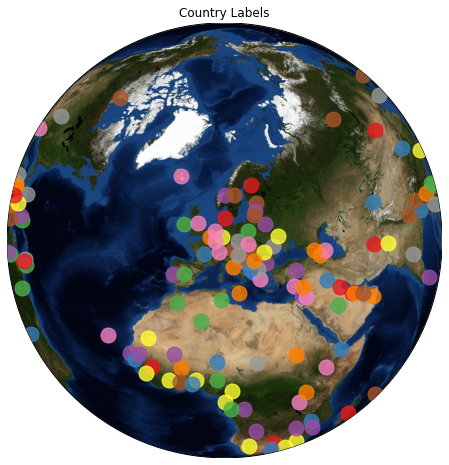

In [17]:
m3 = Basemap(projection='ortho', resolution=None, lat_0=50, lon_0=10,urcrnrlat=80,llcrnrlat=-80)

plt.figure(figsize=(8,8))

country = list(covidlatlong['Country'].unique())
c       = sns.color_palette('Set1',148)
#label   = country

def function(country,c,label):
    lat = list(covidlatlong[covidlatlong['Country'] == country].Latitude) 
    lon = list(covidlatlong[covidlatlong['Country'] == country].Longitude)
    x,y = m3(lon,lat)
    m3.plot(x,y,'go',markersize=15,color=c,alpha=.8,label=label)

for i,j in zip(country,c): # zip: aggregates elements based on the elements
    function(i,j,i)

m3.bluemarble(scale=0.5)
#plt.legend(loc='lower right',frameon=True,prop={'size':8}).get_frame().set_facecolor('white')
plt.title('Country Labels')
plt.show()

In [18]:
list(covidlatlong[covidlatlong['Country']=='Afghanistan'].Latitude)

[33.0]

In [19]:
list(covidlatlong['Country'].unique())

['Afghanistan',
 'Albania',
 'Algeria',
 'Angola',
 'Armenia',
 'Australia',
 'Austria',
 'Azerbaijan',
 'Bahamas',
 'Bahrain',
 'Bangladesh',
 'Barbados',
 'Belarus',
 'Belgium',
 'Benin',
 'Bhutan',
 'Bolivia, Plurinational State of',
 'Bosnia and Herzegovina',
 'Botswana',
 'Brazil',
 'Brunei Darussalam',
 'Bulgaria',
 'Burkina Faso',
 'Cameroon',
 'Canada',
 'Cape Verde',
 'Chad',
 'Chile',
 'China',
 'Colombia',
 'Congo',
 'Costa Rica',
 "Côte d'Ivoire",
 'Croatia',
 'Cyprus',
 'Czech Republic',
 'Denmark',
 'Djibouti',
 'Dominican Republic',
 'Ecuador',
 'El Salvador',
 'Equatorial Guinea',
 'Estonia',
 'Ethiopia',
 'Fiji',
 'Finland',
 'France',
 'Gabon',
 'Gambia',
 'Georgia',
 'Germany',
 'Ghana',
 'Greece',
 'Guatemala',
 'Guinea',
 'Guinea-Bissau',
 'Guyana',
 'Haiti',
 'Honduras',
 'Hong Kong',
 'Hungary',
 'Iceland',
 'India',
 'Indonesia',
 'Iraq',
 'Ireland',
 'Israel',
 'Italy',
 'Jamaica',
 'Japan',
 'Jordan',
 'Korea, Republic of',
 'Kuwait',
 'Kyrgyzstan',
 "Lao Peop

In [20]:
country

['Afghanistan',
 'Albania',
 'Algeria',
 'Angola',
 'Armenia',
 'Australia',
 'Austria',
 'Azerbaijan',
 'Bahamas',
 'Bahrain',
 'Bangladesh',
 'Barbados',
 'Belarus',
 'Belgium',
 'Benin',
 'Bhutan',
 'Bolivia, Plurinational State of',
 'Bosnia and Herzegovina',
 'Botswana',
 'Brazil',
 'Brunei Darussalam',
 'Bulgaria',
 'Burkina Faso',
 'Cameroon',
 'Canada',
 'Cape Verde',
 'Chad',
 'Chile',
 'China',
 'Colombia',
 'Congo',
 'Costa Rica',
 "Côte d'Ivoire",
 'Croatia',
 'Cyprus',
 'Czech Republic',
 'Denmark',
 'Djibouti',
 'Dominican Republic',
 'Ecuador',
 'El Salvador',
 'Equatorial Guinea',
 'Estonia',
 'Ethiopia',
 'Fiji',
 'Finland',
 'France',
 'Gabon',
 'Gambia',
 'Georgia',
 'Germany',
 'Ghana',
 'Greece',
 'Guatemala',
 'Guinea',
 'Guinea-Bissau',
 'Guyana',
 'Haiti',
 'Honduras',
 'Hong Kong',
 'Hungary',
 'Iceland',
 'India',
 'Indonesia',
 'Iraq',
 'Ireland',
 'Israel',
 'Italy',
 'Jamaica',
 'Japan',
 'Jordan',
 'Korea, Republic of',
 'Kuwait',
 'Kyrgyzstan',
 "Lao Peop

In [21]:
print(country)

['Afghanistan', 'Albania', 'Algeria', 'Angola', 'Armenia', 'Australia', 'Austria', 'Azerbaijan', 'Bahamas', 'Bahrain', 'Bangladesh', 'Barbados', 'Belarus', 'Belgium', 'Benin', 'Bhutan', 'Bolivia, Plurinational State of', 'Bosnia and Herzegovina', 'Botswana', 'Brazil', 'Brunei Darussalam', 'Bulgaria', 'Burkina Faso', 'Cameroon', 'Canada', 'Cape Verde', 'Chad', 'Chile', 'China', 'Colombia', 'Congo', 'Costa Rica', "Côte d'Ivoire", 'Croatia', 'Cyprus', 'Czech Republic', 'Denmark', 'Djibouti', 'Dominican Republic', 'Ecuador', 'El Salvador', 'Equatorial Guinea', 'Estonia', 'Ethiopia', 'Fiji', 'Finland', 'France', 'Gabon', 'Gambia', 'Georgia', 'Germany', 'Ghana', 'Greece', 'Guatemala', 'Guinea', 'Guinea-Bissau', 'Guyana', 'Haiti', 'Honduras', 'Hong Kong', 'Hungary', 'Iceland', 'India', 'Indonesia', 'Iraq', 'Ireland', 'Israel', 'Italy', 'Jamaica', 'Japan', 'Jordan', 'Korea, Republic of', 'Kuwait', 'Kyrgyzstan', "Lao People's Democratic Republic", 'Latvia', 'Lebanon', 'Lesotho', 'Lithuania', 'L

##### 5.1.2 World Map 

In [24]:
# Create a world map to show distributions of users 
import folium
from folium.plugins import MarkerCluster
#empty map
world_map= folium.Map(tiles='cartodbpositron')
marker_cluster = MarkerCluster().add_to(world_map)
#for each coordinate, create circlemarker of user percent
for i in range(len(covid)):
        lat = covidlatlong.iloc[i]['Latitude']
        long = covidlatlong.iloc[i]['Longitude']
        radius=5
        popup_text = """Country : {}<br>
                    Fully Vaccinated : {}<br>"""
        popup_text = popup_text.format(covidlatlong.iloc[i]['Country'],
                                   covidlatlong.iloc[i]['people_fully_vaccinated_per_hundred']
                                   )
        folium.CircleMarker(location = [lat, long], radius=radius, popup= popup_text, fill =True).add_to(marker_cluster)
#show the map
world_map

In [25]:
covidlatlong.head(3)

,Country,Country Code,Latitude,Longitude,HDI rank,Human Development Index 2019 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,...,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop
0,Afghanistan,AFG,33.0,65.0,169,0.511,64.83,10.176430,3.930000,2229.362021,...,"96,692",+966,"43,154","1,124","701,952","39,864,282",Asia,13,2.0,"1,083"
1,Albania,ALB,41.0,20.0,69,0.795,78.57,14.695620,10.145730,13998.299890,...,"130,187",+13,355,3,"916,777","2,874,426",Europe,16,NaN,124
2,Algeria,DZA,28.0,3.0,91,0.748,76.88,14.604302,7.986548,11173.956810,...,"113,707",+807,"50,772",37,"230,861","44,697,286",Africa,34,0.6,"1,136"


### 6. Graphs

In [26]:
import pandas as pd

In [27]:
covidvisual = pd.read_excel('C:/Users/andre/Documents/Programming Languages/Python/pimespython/Project/covidwebscraping/actualcovid19project/covidlatlong.xlsx')

In [28]:
covidvisual.head(3)

,Country,Country Code,Latitude,Longitude,HDI rank,Human Development Index 2019 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,...,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop
0,Afghanistan,AFG,33.0,65.0,169,0.511,64.83,10.176430,3.930000,2229.362021,...,"96,692",+966,"43,154","1,124","701,952","39,864,282",Asia,13,2.0,"1,083"
1,Albania,ALB,41.0,20.0,69,0.795,78.57,14.695620,10.145730,13998.299890,...,"130,187",+13,355,3,"916,777","2,874,426",Europe,16,NaN,124
2,Algeria,DZA,28.0,3.0,91,0.748,76.88,14.604302,7.986548,11173.956810,...,"113,707",+807,"50,772",37,"230,861","44,697,286",Africa,34,0.6,"1,136"


In [29]:
covidvisual.shape

(148, 42)

In [30]:
covidvisual.dtypes

Country                                    object
Country Code                               object
Latitude                                  float64
Longitude                                 float64
HDI rank                                    int64
Human Development Index 2019 (HDI)        float64
Life expectancy at birth                  float64
Expected years of schooling               float64
Mean years of schooling                   float64
Gross national income (GNI) per capita    float64
GDP 2019 (US$)                            float64
GDP per capita 2019 (US$)                 float64
GDP growth 2019 (annual %)                float64
Inflation Rate 2019 (%)                   float64
Unemployment Rate 2020 (%)                float64
Region                                     object
IncomeGroup                                object
total_vaccinations                          int64
date                                       object
people_vaccinated                           int64


In [31]:
covidvisual['TotalDeaths'] = covidvisual['TotalDeaths'].replace(',','', regex=True)

In [32]:
covidvisual['Population']=covidvisual['Population'].replace(',','', regex=True)

In [33]:
covidvisual.head(2)

,Country,Country Code,Latitude,Longitude,HDI rank,Human Development Index 2019 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,...,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop
0,Afghanistan,AFG,33.0,65.0,169,0.511,64.83,10.17643,3.93000,2229.362021,...,"96,692",+966,"43,154","1,124","701,952",39864282,Asia,13,2.0,"1,083"
1,Albania,ALB,41.0,20.0,69,0.795,78.57,14.69562,10.14573,13998.299890,...,"130,187",+13,355,3,"916,777",2874426,Europe,16,NaN,124


In [34]:
covidvisual['TotalDeaths'] = covidvisual['TotalDeaths'].astype(float)
covidvisual['Population'] = covidvisual['Population'].astype(float)

In [35]:
covidvisual.dtypes

Country                                    object
Country Code                               object
Latitude                                  float64
Longitude                                 float64
HDI rank                                    int64
Human Development Index 2019 (HDI)        float64
Life expectancy at birth                  float64
Expected years of schooling               float64
Mean years of schooling                   float64
Gross national income (GNI) per capita    float64
GDP 2019 (US$)                            float64
GDP per capita 2019 (US$)                 float64
GDP growth 2019 (annual %)                float64
Inflation Rate 2019 (%)                   float64
Unemployment Rate 2020 (%)                float64
Region                                     object
IncomeGroup                                object
total_vaccinations                          int64
date                                       object
people_vaccinated                           int64


In [36]:
covidvisual['covid_mortality_rate (per 100000)'] = (covidvisual['TotalDeaths']/covidvisual['Population']*100000)

In [37]:
covidvisual.dtypes

Country                                    object
Country Code                               object
Latitude                                  float64
Longitude                                 float64
HDI rank                                    int64
Human Development Index 2019 (HDI)        float64
Life expectancy at birth                  float64
Expected years of schooling               float64
Mean years of schooling                   float64
Gross national income (GNI) per capita    float64
GDP 2019 (US$)                            float64
GDP per capita 2019 (US$)                 float64
GDP growth 2019 (annual %)                float64
Inflation Rate 2019 (%)                   float64
Unemployment Rate 2020 (%)                float64
Region                                     object
IncomeGroup                                object
total_vaccinations                          int64
date                                       object
people_vaccinated                           int64


In [38]:
covidvisual.head(3)

,Country,Country Code,Latitude,Longitude,HDI rank,Human Development Index 2019 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,...,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop,covid_mortality_rate (per 100000)
0,Afghanistan,AFG,33.0,65.0,169,0.511,64.83,10.176430,3.930000,2229.362021,...,+966,"43,154","1,124","701,952",39864282.0,Asia,13,2.0,"1,083",16.749330
1,Albania,ALB,41.0,20.0,69,0.795,78.57,14.695620,10.145730,13998.299890,...,+13,355,3,"916,777",2874426.0,Europe,16,NaN,124,85.477935
2,Algeria,DZA,28.0,3.0,91,0.748,76.88,14.604302,7.986548,11173.956810,...,+807,"50,772",37,"230,861",44697286.0,Africa,34,0.6,"1,136",9.371934


In [39]:
covidvisual.to_excel('covidvisual.xlsx', index = False)

#### 6.1 Using Plotly

In [41]:
import plotly_express as px

In [42]:
covidvisual = pd.read_excel('C:/Users/andre/Documents/Programming Languages/Python/pimespython/Project/covidwebscraping/actualcovid19project/covidvisual.xlsx')

In [43]:
covidvisual.head(3)

,Country,Country Code,Latitude,Longitude,HDI rank,Human Development Index 2019 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,...,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop,covid_mortality_rate (per 100000)
0,Afghanistan,AFG,33.0,65.0,169,0.511,64.83,10.176430,3.930000,2229.362021,...,+966,"43,154","1,124","701,952",39864282,Asia,13,2.0,"1,083",16.749330
1,Albania,ALB,41.0,20.0,69,0.795,78.57,14.695620,10.145730,13998.299890,...,+13,355,3,"916,777",2874426,Europe,16,NaN,124,85.477935
2,Algeria,DZA,28.0,3.0,91,0.748,76.88,14.604302,7.986548,11173.956810,...,+807,"50,772",37,"230,861",44697286,Africa,34,0.6,"1,136",9.371934


##### 6.1.1 Scatter Plots

In [44]:
fig = px.scatter(covidvisual, x = 'people_fully_vaccinated_per_hundred', y ='Country', title = 'People Fully Vaccinated (per 100) by Country', color = 'Country')
fig.update_layout(
    title={
        'text': 'People Fully Vaccinated (per 100) by Country',
        'y':0.85,
        'x':0.44,
        'xanchor': 'center',
        'yanchor': 'top'})

In [45]:
fig = px.scatter(covidvisual, x = 'GDP per capita 2019 (US$)', y = 'people_fully_vaccinated_per_hundred', marginal_x = 'box', marginal_y = 'violin', color = 'GDP per capita 2019 (US$)')
fig.update_layout(
    title={
        'text': 'People Fully Vaccinated (per 100) by GDP per capita 2019',
        'y':0.95,
        'x':0.34,
        'xanchor': 'center',
        'yanchor': 'top'})

In [46]:
fig = px.scatter(covidvisual, x = 'Human Development Index 2019 (HDI)', y = 'people_fully_vaccinated_per_hundred', marginal_x = 'box', marginal_y = 'violin', color = 'Country')
fig.update_layout(
    title={
        'text': 'People Fully Vaccinated (per 100) by Countries HDI',
        'y':0.95,
        'x':0.3,
        'xanchor': 'center',
        'yanchor': 'top'})

In [47]:
fig = px.scatter(covidvisual, x = 'GDP per capita 2019 (US$)', y = 'people_fully_vaccinated_per_hundred', marginal_x = 'box', marginal_y = 'violin', color = 'Country', trendline = 'ols')
fig.update_layout(
    title={
        'text': 'People Fully Vaccinated (per 100) by GDP per capita',
        'y':0.95,
        'x':0.3,
        'xanchor': 'center',
        'yanchor': 'top'})

##### 6.1.2 Bar Graphs

In [48]:
fig = px.bar(covidvisual, x = 'Country', y = 'people_fully_vaccinated_per_hundred', color = 'Country')
fig.update_layout(
    title={
        'text': 'People Fully Vaccinated (per 100) by Country',
        'y':0.95,
        'x':0.4,
        'xanchor': 'center',
        'yanchor': 'top'})

In [49]:
fig = px.bar(covidvisual, x = 'people_fully_vaccinated_per_hundred', y = 'Country', color = 'Country', orientation='h')
fig.update_layout(
    title={
        'text': 'People Fully Vaccinated (per 100) by Country',
        'y':0.95,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top'})

In [50]:
fig = px.bar(covidvisual, x='people_fully_vaccinated_per_hundred', y='Country', color='Country', orientation='h',
             hover_data=['Human Development Index 2019 (HDI)', 'TotalDeaths'],
             height=400)
fig.update_layout(
    title={
        'text': 'People Fully Vaccinated (per 100) by Country with HDI and Total Deaths',
        'y':0.95,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top'})

In [51]:
fig = px.scatter(covidvisual, x='Country', y='people_fully_vaccinated_per_hundred', color='Continent')
fig.update_layout(
    title={
        'text': 'People Fully Vaccinated (per 100) by Country and Continent',
        'y':0.95,
        'x':0.45,
        'xanchor': 'center',
        'yanchor': 'top'})

##### 6.1.3 Pie Chart

In [52]:
covidvisual1 = covidvisual.sort_values(by='TotalDeaths', ascending = False)

In [53]:
covidvisual1.head()

,Country,Country Code,Latitude,Longitude,HDI rank,Human Development Index 2019 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,...,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop,covid_mortality_rate (per 100000)
143,United States,USA,38.0,-97.0,17,0.926,78.86,16.31039,13.41344,63825.657480,...,+567,"5,261,874","9,051","527,202,813",333082557,North America,21,0.2,"15,798",188.587480
19,Brazil,BRA,-10.0,-55.0,84,0.765,75.88,15.41401,7.98130,14262.934590,...,NaN,"713,938","8,318","55,034,721",214178124,South America,NaN,NaN,"3,333",258.323301
62,India,IND,20.0,77.0,131,0.645,69.66,12.16229,6.50000,6681.346904,...,"+41,447","412,092","8,944","462,629,773",1394531345,Asia,32,0.4,296,30.350196
88,Mexico,MEX,23.0,-102.0,74,0.779,75.05,14.80978,8.75461,19159.839670,...,"+10,196","369,967","4,798","8,317,170",130382945,North America,146,4.0,"2,838",183.778638
108,Peru,PER,-10.0,-76.0,79,0.777,76.74,14.99071,9.69633,12252.300180,...,NaN,NaN,"1,856","15,432,556",33463188,South America,NaN,NaN,"5,710",586.130646


In [54]:
covidvisual1['TotalDeaths'][0:19]

143    628152.0
19     553272.0
62     423243.0
88     239616.0
108    196138.0
114    156977.0
142    129515.0
67     128029.0
29     119801.0
46     111735.0
50      92114.0
63      90552.0
128     81396.0
110     75257.0
127     71431.0
140     52916.0
138     51184.0
27      35295.0
113     34275.0
Name: TotalDeaths, dtype: float64

In [55]:
covidvisual1.loc[covidvisual1['TotalDeaths']< 22000, 'Country'] ='Other Countries Total Deaths'
fig = px.pie(covidvisual1, values='TotalDeaths', names='Country', title='Total Deaths by Country')
fig.update_layout(
    title={
        'text': 'Countries with Highest Deaths',
        'y':0.9,
        'x':0.45,
        'xanchor': 'center',
        'yanchor': 'top'})

In [56]:
covidvisual1

,Country,Country Code,Latitude,Longitude,HDI rank,Human Development Index 2019 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,...,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop,covid_mortality_rate (per 100000)
143,United States,USA,38.0000,-97.0000,17,0.926,78.86,16.310390,13.413440,63825.657480,...,+567,"5,261,874","9,051","527,202,813",333082557,North America,21,0.2,"15,798",188.587480
19,Brazil,BRA,-10.0000,-55.0000,84,0.765,75.88,15.414010,7.981300,14262.934590,...,NaN,"713,938","8,318","55,034,721",214178124,South America,NaN,NaN,"3,333",258.323301
62,India,IND,20.0000,77.0000,131,0.645,69.66,12.162290,6.500000,6681.346904,...,"+41,447","412,092","8,944","462,629,773",1394531345,Asia,32,0.4,296,30.350196
88,Mexico,MEX,23.0000,-102.0000,74,0.779,75.05,14.809780,8.754610,19159.839670,...,"+10,196","369,967","4,798","8,317,170",130382945,North America,146,4.0,"2,838",183.778638
108,Peru,PER,-10.0000,-76.0000,79,0.777,76.74,14.990710,9.696330,12252.300180,...,NaN,NaN,"1,856","15,432,556",33463188,South America,NaN,NaN,"5,710",586.130646
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
20,Other Countries Total Deaths,BRN,4.5000,114.6667,47,0.838,75.86,14.313910,9.140000,63965.092790,...,NaN,60,NaN,"150,942",441964,Asia,NaN,NaN,136,0.678788
15,Other Countries Total Deaths,BTN,27.5000,90.5000,129,0.654,71.78,12.982658,4.073800,10745.843960,...,NaN,168,NaN,"798,573",780703,Asia,NaN,NaN,215,0.256179
145,Other Countries Total Deaths,VUT,-16.0000,167.0000,140,0.609,70.47,11.733910,7.064846,3104.799016,...,NaN,0,NaN,"23,000",314806,Australia/Oceania,NaN,NaN,NaN,0.317656
118,Samoa,WSM,-13.5833,-172.3333,111,0.715,73.32,12.729700,10.779210,6308.652491,...,NaN,0,NaN,NaN,199827,Australia/Oceania,NaN,NaN,NaN,NaN


In [57]:
covidvisual2 = covidvisual.sort_values(by='covid_mortality_rate (per 100000)', ascending = False)

In [58]:
covidvisual2

,Country,Country Code,Latitude,Longitude,HDI rank,Human Development Index 2019 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,...,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop,covid_mortality_rate (per 100000)
108,Peru,PER,-10.0000,-76.0000,79,0.777,76.74,14.990710,9.696330,12252.300180,...,NaN,NaN,"1,856","15,432,556",33463188,South America,NaN,NaN,"5,710",586.130646
60,Hungary,HUN,47.0000,20.0000,40,0.854,76.88,15.204180,11.963290,31328.805990,...,+531,"31,890",13,"6,323,793",9634027,Europe,7,NaN,"3,310",311.655759
17,Bosnia and Herzegovina,BIH,44.0000,18.0000,73,0.780,77.40,13.800000,9.817870,14871.811140,...,NaN,"6,621",NaN,"1,068,521",3258906,Europe,NaN,NaN,"2,032",297.216305
35,Czech Republic,CZE,49.7500,15.5000,27,0.900,79.38,16.785110,12.722382,38108.566620,...,+9,"3,007",8,"32,665,779",10730286,Europe,18,NaN,280,282.965431
21,Bulgaria,BGR,43.0000,25.0000,56,0.816,75.05,14.414420,11.360090,23324.657400,...,NaN,"7,702",79,"3,574,097",6892268,Europe,NaN,NaN,"1,117",264.136566
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
145,Vanuatu,VUT,-16.0000,167.0000,140,0.609,70.47,11.733910,7.064846,3104.799016,...,NaN,0,NaN,"23,000",314806,Australia/Oceania,NaN,NaN,NaN,0.317656
15,Bhutan,BTN,27.5000,90.5000,129,0.654,71.78,12.982658,4.073800,10745.843960,...,NaN,168,NaN,"798,573",780703,Asia,NaN,NaN,215,0.256179
74,Lao People's Democratic Republic,LAO,18.0000,105.0000,137,0.613,67.92,10.987240,5.288000,7413.331630,...,+188,"2,978",NaN,"305,013",7388483,Asia,33,NaN,403,0.081207
118,Samoa,WSM,-13.5833,-172.3333,111,0.715,73.32,12.729700,10.779210,6308.652491,...,NaN,0,NaN,NaN,199827,Australia/Oceania,NaN,NaN,NaN,NaN


In [59]:
covidvisual2.loc[covidvisual2['covid_mortality_rate (per 100000)']<100, 'Country'] = 'Other countries Death Rate'
fig = px.pie(covidvisual2, values='covid_mortality_rate (per 100000)', names='Country')
fig.update_layout(
    title={
        'text': 'Countries with Highest Mortality Rate',
        'y':0.98,
        'x':0.4,
        'xanchor': 'center',
        'yanchor': 'top'})

In [60]:
fig = px.pie(covidvisual2, values='covid_mortality_rate (per 100000)', names='Country',
             hover_data=['Human Development Index 2019 (HDI)'], labels={'HDI':'Human Develpment Index'})
fig.update_traces(textposition='inside', textinfo='percent+label')
fig.update_layout(
    title={
        'text': 'Countries with Highest Covid Death Rate and HDI',
        'y':0.95,
        'x':0.37,
        'xanchor': 'center',
        'yanchor': 'top'})
fig.show()

##### 6.1.4 TreeMap 

In [61]:
covidvisual.head()

,Country,Country Code,Latitude,Longitude,HDI rank,Human Development Index 2019 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,...,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop,covid_mortality_rate (per 100000)
0,Afghanistan,AFG,33.0,65.0,169,0.511,64.83,10.176430,3.930000,2229.362021,...,+966,"43,154","1,124","701,952",39864282,Asia,13,2.0,"1,083",16.749330
1,Albania,ALB,41.0,20.0,69,0.795,78.57,14.695620,10.145730,13998.299890,...,+13,355,3,"916,777",2874426,Europe,16,NaN,124,85.477935
2,Algeria,DZA,28.0,3.0,91,0.748,76.88,14.604302,7.986548,11173.956810,...,+807,"50,772",37,"230,861",44697286,Africa,34,0.6,"1,136",9.371934
3,Angola,AGO,-12.5,18.5,148,0.581,61.15,11.777202,5.173993,6104.054640,...,NaN,"5,324",8,"681,443",33955402,Africa,NaN,NaN,157,2.945039
4,Armenia,ARM,40.0,45.0,81,0.776,75.09,13.068610,11.301740,13894.013020,...,+123,"5,497",NaN,"1,328,107",2969182,Asia,78,2.0,"1,851",155.059542


In [62]:
covidvisual.isnull().sum()

Country                                    0
Country Code                               0
Latitude                                   0
Longitude                                  0
HDI rank                                   0
Human Development Index 2019 (HDI)         0
Life expectancy at birth                   0
Expected years of schooling                0
Mean years of schooling                    0
Gross national income (GNI) per capita     0
GDP 2019 (US$)                             0
GDP per capita 2019 (US$)                  0
GDP growth 2019 (annual %)                 0
Inflation Rate 2019 (%)                    0
Unemployment Rate 2020 (%)                 0
Region                                     0
IncomeGroup                                0
total_vaccinations                         0
date                                       0
people_vaccinated                          0
people_fully_vaccinated                    5
daily_vaccinations_raw                    26
daily_vacc

In [63]:
df_plot0 = covidvisual[covidvisual['people_fully_vaccinated_per_hundred']!=0] 

In [64]:
df_plot0.shape

(147, 43)

In [65]:
covidvisual.shape

(148, 43)

In [66]:
fig = px.treemap(df_plot0, path=['Continent', 'Country'], values='people_fully_vaccinated_per_hundred',
                  color='covid_mortality_rate (per 100000)', hover_data=['Country Code'])
fig.update_layout(
    title={
        'text': 'Treemap of People Fully Vaccinated (per 100) by Country',
        'y':0.95,
        'x':0.44,
        'xanchor': 'center',
        'yanchor': 'top'})
fig.show()

##### 6.1.5 Trendline

In [67]:
fig = px.scatter(covidvisual, x='covid_mortality_rate (per 100000)', y='people_fully_vaccinated_per_hundred', trendline='ols')
fig.update_layout(
    title={
        'text': 'People Fully Vaccinated (per 100) by Covid Death Rate OLS',
        'y':0.95,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top'})
fig.show()

In [68]:
fig = px.scatter(covidvisual, x='Human Development Index 2019 (HDI)', y='people_fully_vaccinated_per_hundred', trendline='ols')
fig.update_layout(
    title={
        'text': 'People Fully Vaccinated (per 100) and HDI OLS',
        'y':0.95,
        'x':0.47,
        'xanchor': 'center',
        'yanchor': 'top'})
fig.show()

In [69]:
fig = px.scatter(covidvisual, x='Human Development Index 2019 (HDI)', y='people_fully_vaccinated_per_hundred', trendline='ols', color = 'Country')
fig.update_layout(
    title={
        'text': 'People Fully Vaccinated (per 100) and HDI by Country',
        'y':0.95,
        'x':0.37,
        'xanchor': 'center',
        'yanchor': 'top'})
fig.show()

In [70]:
px.scatter(covidvisual, x='Human Development Index 2019 (HDI)', y='people_fully_vaccinated_per_hundred', trendline='ols', color = 'Continent')
fig.update_layout(
    title={
        'text': 'People Fully Vaccinated (per 100) vs HDI by Continent OLS',
        'y':0.95,
        'x':0.38,
        'xanchor': 'center',
        'yanchor': 'top'})
fig.show()

In [71]:
fig = px.scatter(covidvisual, x='Inflation Rate 2019 (%)', y='people_fully_vaccinated_per_hundred', trendline='ols')
fig.update_layout(
    title={
        'text': 'People Fully Vaccinated (per 100) vs Inflation Rate (%)',
        'y':0.95,
        'x':0.47,
        'xanchor': 'center',
        'yanchor': 'top'})
fig.show()

In [72]:
fig = px.scatter(covidvisual, x='Unemployment Rate 2020 (%)', y='covid_mortality_rate (per 100000)', trendline='ols')
fig.update_layout(
    title={
        'text': 'Covid Death Rate (per 100000) vs Unemployment Rate (%)',
        'y':0.95,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top'})
fig.show()

In [73]:
covidvisual.columns

Index(['Country', 'Country Code', 'Latitude', 'Longitude', 'HDI rank',
       'Human Development Index 2019 (HDI)', 'Life expectancy at birth',
       'Expected years of schooling', 'Mean years of schooling',
       'Gross national income (GNI) per capita', 'GDP 2019 (US$)',
       'GDP per capita 2019 (US$)', 'GDP growth 2019 (annual %)',
       'Inflation Rate 2019 (%)', 'Unemployment Rate 2020 (%)', 'Region',
       'IncomeGroup', 'total_vaccinations', 'date', 'people_vaccinated',
       'people_fully_vaccinated', 'daily_vaccinations_raw',
       'daily_vaccinations', 'total_vaccinations_per_hundred',
       'people_vaccinated_per_hundred', 'people_fully_vaccinated_per_hundred',
       'daily_vaccinations_per_million', 'Country,Other', 'TotalCases',
       'NewCases', 'TotalDeaths', 'NewDeaths', 'TotalRecovered',
       'NewRecovered', 'ActiveCases', 'Serious,Critical', 'TotalTests',
       'Population', 'Continent', 'New Cases/1M pop', 'New Deaths/1M pop',
       'Active Cases/1M p

C:\Users\andre\anaconda3\lib\site-packages\seaborn\distributions.py:306: UserWarning:

Dataset has 0 variance; skipping density estimate.

C:\Users\andre\anaconda3\lib\site-packages\seaborn\distributions.py:306: UserWarning:

Dataset has 0 variance; skipping density estimate.

C:\Users\andre\anaconda3\lib\site-packages\seaborn\distributions.py:306: UserWarning:

Dataset has 0 variance; skipping density estimate.

C:\Users\andre\anaconda3\lib\site-packages\seaborn\distributions.py:306: UserWarning:

Dataset has 0 variance; skipping density estimate.

C:\Users\andre\anaconda3\lib\site-packages\seaborn\distributions.py:306: UserWarning:

Dataset has 0 variance; skipping density estimate.

C:\Users\andre\anaconda3\lib\site-packages\seaborn\distributions.py:306: UserWarning:

Dataset has 0 variance; skipping density estimate.

C:\Users\andre\anaconda3\lib\site-packages\seaborn\distributions.py:306: UserWarning:

Dataset has 0 variance; skipping density estimate.

C:\Users\andre\anaconda3\li

C:\Users\andre\anaconda3\lib\site-packages\seaborn\distributions.py:306: UserWarning:

Dataset has 0 variance; skipping density estimate.

C:\Users\andre\anaconda3\lib\site-packages\seaborn\distributions.py:306: UserWarning:

Dataset has 0 variance; skipping density estimate.

C:\Users\andre\anaconda3\lib\site-packages\seaborn\distributions.py:306: UserWarning:

Dataset has 0 variance; skipping density estimate.

C:\Users\andre\anaconda3\lib\site-packages\seaborn\distributions.py:306: UserWarning:

Dataset has 0 variance; skipping density estimate.

C:\Users\andre\anaconda3\lib\site-packages\seaborn\distributions.py:306: UserWarning:

Dataset has 0 variance; skipping density estimate.

C:\Users\andre\anaconda3\lib\site-packages\seaborn\distributions.py:306: UserWarning:

Dataset has 0 variance; skipping density estimate.

C:\Users\andre\anaconda3\lib\site-packages\seaborn\distributions.py:306: UserWarning:

Dataset has 0 variance; skipping density estimate.

C:\Users\andre\anaconda3\li

C:\Users\andre\anaconda3\lib\site-packages\seaborn\distributions.py:306: UserWarning:

Dataset has 0 variance; skipping density estimate.

C:\Users\andre\anaconda3\lib\site-packages\seaborn\distributions.py:306: UserWarning:

Dataset has 0 variance; skipping density estimate.

C:\Users\andre\anaconda3\lib\site-packages\seaborn\distributions.py:306: UserWarning:

Dataset has 0 variance; skipping density estimate.

C:\Users\andre\anaconda3\lib\site-packages\seaborn\distributions.py:306: UserWarning:

Dataset has 0 variance; skipping density estimate.

C:\Users\andre\anaconda3\lib\site-packages\seaborn\distributions.py:306: UserWarning:

Dataset has 0 variance; skipping density estimate.

C:\Users\andre\anaconda3\lib\site-packages\seaborn\distributions.py:306: UserWarning:

Dataset has 0 variance; skipping density estimate.

C:\Users\andre\anaconda3\lib\site-packages\seaborn\distributions.py:306: UserWarning:

Dataset has 0 variance; skipping density estimate.

C:\Users\andre\anaconda3\li

C:\Users\andre\anaconda3\lib\site-packages\seaborn\distributions.py:306: UserWarning:

Dataset has 0 variance; skipping density estimate.

C:\Users\andre\anaconda3\lib\site-packages\seaborn\distributions.py:306: UserWarning:

Dataset has 0 variance; skipping density estimate.

C:\Users\andre\anaconda3\lib\site-packages\seaborn\distributions.py:306: UserWarning:

Dataset has 0 variance; skipping density estimate.

C:\Users\andre\anaconda3\lib\site-packages\seaborn\distributions.py:306: UserWarning:

Dataset has 0 variance; skipping density estimate.

C:\Users\andre\anaconda3\lib\site-packages\seaborn\distributions.py:306: UserWarning:

Dataset has 0 variance; skipping density estimate.

C:\Users\andre\anaconda3\lib\site-packages\seaborn\distributions.py:306: UserWarning:

Dataset has 0 variance; skipping density estimate.

C:\Users\andre\anaconda3\lib\site-packages\seaborn\distributions.py:306: UserWarning:

Dataset has 0 variance; skipping density estimate.

C:\Users\andre\anaconda3\li

C:\Users\andre\anaconda3\lib\site-packages\seaborn\distributions.py:306: UserWarning:

Dataset has 0 variance; skipping density estimate.

C:\Users\andre\anaconda3\lib\site-packages\seaborn\distributions.py:306: UserWarning:

Dataset has 0 variance; skipping density estimate.

C:\Users\andre\anaconda3\lib\site-packages\seaborn\distributions.py:306: UserWarning:

Dataset has 0 variance; skipping density estimate.

C:\Users\andre\anaconda3\lib\site-packages\seaborn\distributions.py:306: UserWarning:

Dataset has 0 variance; skipping density estimate.

C:\Users\andre\anaconda3\lib\site-packages\seaborn\distributions.py:306: UserWarning:

Dataset has 0 variance; skipping density estimate.

C:\Users\andre\anaconda3\lib\site-packages\seaborn\distributions.py:306: UserWarning:

Dataset has 0 variance; skipping density estimate.

C:\Users\andre\anaconda3\lib\site-packages\seaborn\distributions.py:306: UserWarning:

Dataset has 0 variance; skipping density estimate.

C:\Users\andre\anaconda3\li

C:\Users\andre\anaconda3\lib\site-packages\seaborn\distributions.py:306: UserWarning:

Dataset has 0 variance; skipping density estimate.

C:\Users\andre\anaconda3\lib\site-packages\seaborn\distributions.py:306: UserWarning:

Dataset has 0 variance; skipping density estimate.

C:\Users\andre\anaconda3\lib\site-packages\seaborn\distributions.py:306: UserWarning:

Dataset has 0 variance; skipping density estimate.

C:\Users\andre\anaconda3\lib\site-packages\seaborn\distributions.py:306: UserWarning:

Dataset has 0 variance; skipping density estimate.

C:\Users\andre\anaconda3\lib\site-packages\seaborn\distributions.py:306: UserWarning:

Dataset has 0 variance; skipping density estimate.

C:\Users\andre\anaconda3\lib\site-packages\seaborn\distributions.py:306: UserWarning:

Dataset has 0 variance; skipping density estimate.

C:\Users\andre\anaconda3\lib\site-packages\seaborn\distributions.py:306: UserWarning:

Dataset has 0 variance; skipping density estimate.

C:\Users\andre\anaconda3\li

C:\Users\andre\anaconda3\lib\site-packages\seaborn\distributions.py:306: UserWarning:

Dataset has 0 variance; skipping density estimate.

C:\Users\andre\anaconda3\lib\site-packages\seaborn\distributions.py:306: UserWarning:

Dataset has 0 variance; skipping density estimate.

C:\Users\andre\anaconda3\lib\site-packages\seaborn\distributions.py:306: UserWarning:

Dataset has 0 variance; skipping density estimate.

C:\Users\andre\anaconda3\lib\site-packages\seaborn\distributions.py:306: UserWarning:

Dataset has 0 variance; skipping density estimate.

C:\Users\andre\anaconda3\lib\site-packages\seaborn\distributions.py:306: UserWarning:

Dataset has 0 variance; skipping density estimate.

C:\Users\andre\anaconda3\lib\site-packages\seaborn\distributions.py:306: UserWarning:

Dataset has 0 variance; skipping density estimate.

C:\Users\andre\anaconda3\lib\site-packages\seaborn\distributions.py:306: UserWarning:

Dataset has 0 variance; skipping density estimate.

C:\Users\andre\anaconda3\li

C:\Users\andre\anaconda3\lib\site-packages\seaborn\distributions.py:306: UserWarning:

Dataset has 0 variance; skipping density estimate.

C:\Users\andre\anaconda3\lib\site-packages\seaborn\distributions.py:306: UserWarning:

Dataset has 0 variance; skipping density estimate.

C:\Users\andre\anaconda3\lib\site-packages\seaborn\distributions.py:306: UserWarning:

Dataset has 0 variance; skipping density estimate.

C:\Users\andre\anaconda3\lib\site-packages\seaborn\distributions.py:306: UserWarning:

Dataset has 0 variance; skipping density estimate.

C:\Users\andre\anaconda3\lib\site-packages\seaborn\distributions.py:306: UserWarning:

Dataset has 0 variance; skipping density estimate.

C:\Users\andre\anaconda3\lib\site-packages\seaborn\distributions.py:306: UserWarning:

Dataset has 0 variance; skipping density estimate.

C:\Users\andre\anaconda3\lib\site-packages\seaborn\distributions.py:306: UserWarning:

Dataset has 0 variance; skipping density estimate.

C:\Users\andre\anaconda3\li

C:\Users\andre\anaconda3\lib\site-packages\seaborn\distributions.py:306: UserWarning:

Dataset has 0 variance; skipping density estimate.

C:\Users\andre\anaconda3\lib\site-packages\seaborn\distributions.py:306: UserWarning:

Dataset has 0 variance; skipping density estimate.

C:\Users\andre\anaconda3\lib\site-packages\seaborn\distributions.py:306: UserWarning:

Dataset has 0 variance; skipping density estimate.



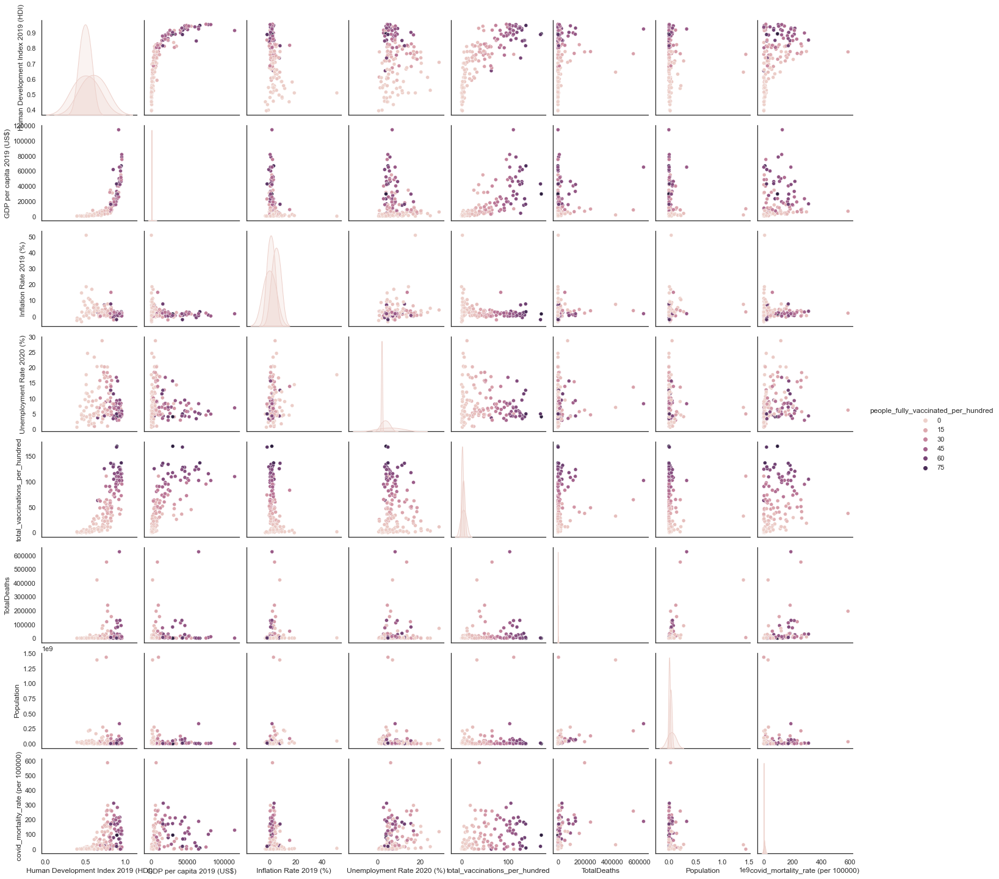

In [74]:
sns.set(
    style="white", 
    palette="muted", 
    color_codes=True
)
sns.pairplot(
    covidvisual[[
        'Human Development Index 2019 (HDI)', 'GDP per capita 2019 (US$)',
       'Region', 'Inflation Rate 2019 (%)','Unemployment Rate 2020 (%)', 'total_vaccinations_per_hundred', 'people_fully_vaccinated_per_hundred',
       'TotalCases','TotalDeaths','Population','Continent', 'covid_mortality_rate (per 100000)'
    ]].dropna(), 
    hue='people_fully_vaccinated_per_hundred'
)

### 7. Maps with Shapefiles

In [75]:
import geopandas as gpd
import pandas as pd
import matplotlib.pyplot as plt
from shapely.geometry import Point, Polygon

##### There are two very common ways to work with map plotting
#### 7.1 From latitude and longitude finding a point to plot over the shapefile
#### 7.2 Merging the shapefile with the data, not plotting the point over it

#### 7.1. From latitude and longitude finding a point to plot over the shapefile

In [76]:
covidvisual = pd.read_excel('C:/Users/andre/Documents/Programming Languages/Python/pimespython/Project/covidwebscraping/actualcovid19project/covidvisual.xlsx')

In [77]:
covidvisual.head()

,Country,Country Code,Latitude,Longitude,HDI rank,Human Development Index 2019 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,...,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop,covid_mortality_rate (per 100000)
0,Afghanistan,AFG,33.0,65.0,169,0.511,64.83,10.176430,3.930000,2229.362021,...,+966,"43,154","1,124","701,952",39864282,Asia,13,2.0,"1,083",16.749330
1,Albania,ALB,41.0,20.0,69,0.795,78.57,14.695620,10.145730,13998.299890,...,+13,355,3,"916,777",2874426,Europe,16,NaN,124,85.477935
2,Algeria,DZA,28.0,3.0,91,0.748,76.88,14.604302,7.986548,11173.956810,...,+807,"50,772",37,"230,861",44697286,Africa,34,0.6,"1,136",9.371934
3,Angola,AGO,-12.5,18.5,148,0.581,61.15,11.777202,5.173993,6104.054640,...,NaN,"5,324",8,"681,443",33955402,Africa,NaN,NaN,157,2.945039
4,Armenia,ARM,40.0,45.0,81,0.776,75.09,13.068610,11.301740,13894.013020,...,+123,"5,497",NaN,"1,328,107",2969182,Asia,78,2.0,"1,851",155.059542


In [78]:
#'naturalearth_lowres' is a shapefile dataset from geopandas
world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))
world.head(3)

,pop_est,continent,name,iso_a3,gdp_md_est,geometry
0,920938,Oceania,Fiji,FJI,8374.0,"MULTIPOLYGON (((180.00000 -16.06713, 180.00000..."
1,53950935,Africa,Tanzania,TZA,150600.0,"POLYGON ((33.90371 -0.95000, 34.07262 -1.05982..."
2,603253,Africa,W. Sahara,ESH,906.5,"POLYGON ((-8.66559 27.65643, -8.66512 27.58948..."


<AxesSubplot:>

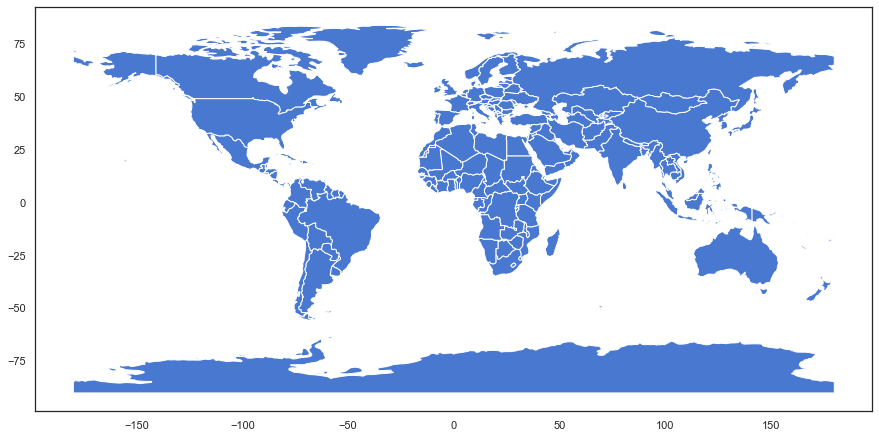

In [79]:
fig, ax = plt.subplots(figsize = (15,15))
world.plot(ax=ax)

In [80]:
crs = {'init':'epsg:4326'}
geometry = [Point(xy) for xy in zip(covidvisual['Longitude'], covidvisual['Latitude'])]
geometry[:5]

In [81]:
geodataframe = gpd.GeoDataFrame(covidvisual, crs = crs, geometry = geometry)
geodataframe.head()

C:\Users\andre\anaconda3\lib\site-packages\pyproj\crs\crs.py:68: FutureWarning:

'+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6



,Country,Country Code,Latitude,Longitude,HDI rank,Human Development Index 2019 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,...,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop,covid_mortality_rate (per 100000),geometry
0,Afghanistan,AFG,33.0,65.0,169,0.511,64.83,10.176430,3.930000,2229.362021,...,"43,154","1,124","701,952",39864282,Asia,13,2.0,"1,083",16.749330,POINT (65.00000 33.00000)
1,Albania,ALB,41.0,20.0,69,0.795,78.57,14.695620,10.145730,13998.299890,...,355,3,"916,777",2874426,Europe,16,NaN,124,85.477935,POINT (20.00000 41.00000)
2,Algeria,DZA,28.0,3.0,91,0.748,76.88,14.604302,7.986548,11173.956810,...,"50,772",37,"230,861",44697286,Africa,34,0.6,"1,136",9.371934,POINT (3.00000 28.00000)
3,Angola,AGO,-12.5,18.5,148,0.581,61.15,11.777202,5.173993,6104.054640,...,"5,324",8,"681,443",33955402,Africa,NaN,NaN,157,2.945039,POINT (18.50000 -12.50000)
4,Armenia,ARM,40.0,45.0,81,0.776,75.09,13.068610,11.301740,13894.013020,...,"5,497",NaN,"1,328,107",2969182,Asia,78,2.0,"1,851",155.059542,POINT (45.00000 40.00000)


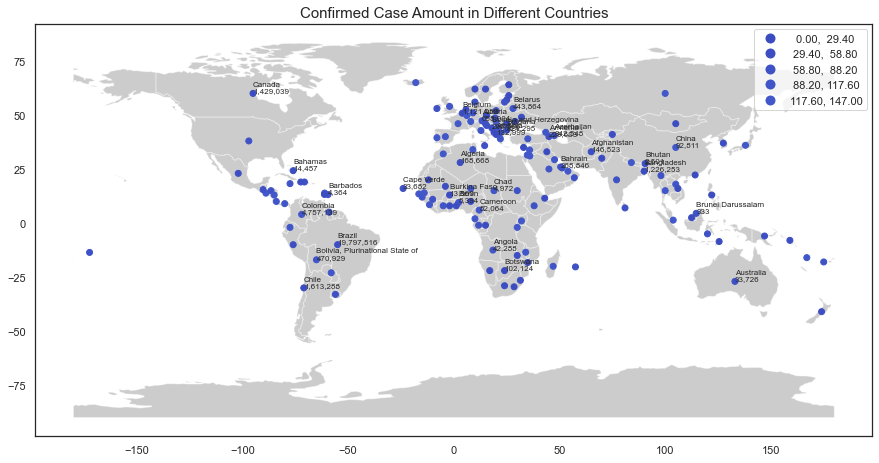

In [83]:
#plot confirmed cases world map 
#plotting the points from latitude and longitude over a shapefile
fig, ax = plt.subplots(figsize = (15,15))
world.plot(ax=ax, alpha = 0.4, color = 'grey')
geodataframe.plot(ax = ax, column='TotalCases', scheme="quantiles",
           figsize=(25, 20),
           legend=True,cmap='coolwarm')
plt.title('Confirmed Case Amount in Different Countries',fontsize=15)
# add countries names and numbers 
for i in range(0,30):
    plt.text(float(geodataframe.Longitude[i]),float(geodataframe.Latitude[i]),"{}\n{}".format(geodataframe.Country[i],geodataframe.TotalCases[i]),size=8)
plt.show()

#### 7.2 Merging the shapefile with the data, not plotting the point over it

In [84]:
covidvisual = pd.read_excel('C:/Users/andre/Documents/Programming Languages/Python/pimespython/Project/covidwebscraping/actualcovid19project/covidvisual.xlsx')

In [85]:
covidvisual.head()

,Country,Country Code,Latitude,Longitude,HDI rank,Human Development Index 2019 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,...,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop,covid_mortality_rate (per 100000)
0,Afghanistan,AFG,33.0,65.0,169,0.511,64.83,10.176430,3.930000,2229.362021,...,+966,"43,154","1,124","701,952",39864282,Asia,13,2.0,"1,083",16.749330
1,Albania,ALB,41.0,20.0,69,0.795,78.57,14.695620,10.145730,13998.299890,...,+13,355,3,"916,777",2874426,Europe,16,NaN,124,85.477935
2,Algeria,DZA,28.0,3.0,91,0.748,76.88,14.604302,7.986548,11173.956810,...,+807,"50,772",37,"230,861",44697286,Africa,34,0.6,"1,136",9.371934
3,Angola,AGO,-12.5,18.5,148,0.581,61.15,11.777202,5.173993,6104.054640,...,NaN,"5,324",8,"681,443",33955402,Africa,NaN,NaN,157,2.945039
4,Armenia,ARM,40.0,45.0,81,0.776,75.09,13.068610,11.301740,13894.013020,...,+123,"5,497",NaN,"1,328,107",2969182,Asia,78,2.0,"1,851",155.059542


In [86]:
world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))

In [87]:
world.head()

,pop_est,continent,name,iso_a3,gdp_md_est,geometry
0,920938,Oceania,Fiji,FJI,8374.0,"MULTIPOLYGON (((180.00000 -16.06713, 180.00000..."
1,53950935,Africa,Tanzania,TZA,150600.0,"POLYGON ((33.90371 -0.95000, 34.07262 -1.05982..."
2,603253,Africa,W. Sahara,ESH,906.5,"POLYGON ((-8.66559 27.65643, -8.66512 27.58948..."
3,35623680,North America,Canada,CAN,1674000.0,"MULTIPOLYGON (((-122.84000 49.00000, -122.9742..."
4,326625791,North America,United States of America,USA,18560000.0,"MULTIPOLYGON (((-122.84000 49.00000, -120.0000..."


In [88]:
world.drop(['pop_est', 'continent', 'gdp_md_est'], axis = 1, inplace = True)

In [89]:
world.rename({'iso_a3':'Country Code'}, axis = 1, inplace = True)

In [90]:
world.head(3)

,name,Country Code,geometry
0,Fiji,FJI,"MULTIPOLYGON (((180.00000 -16.06713, 180.00000..."
1,Tanzania,TZA,"POLYGON ((33.90371 -0.95000, 34.07262 -1.05982..."
2,W. Sahara,ESH,"POLYGON ((-8.66559 27.65643, -8.66512 27.58948..."


In [91]:
worldmerge = world.merge(covidvisual, how = 'inner', on ='Country Code', indicator = True)

In [92]:
worldmerge.head(3)

,name,Country Code,geometry,Country,Latitude,Longitude,HDI rank,Human Development Index 2019 (HDI),Life expectancy at birth,Expected years of schooling,...,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop,covid_mortality_rate (per 100000),_merge
0,Fiji,FJI,"MULTIPOLYGON (((180.00000 -16.06713, 180.00000...",Fiji,-18.0,175.0,93,0.743,67.44,14.42733,...,"20,319",40,"305,970",903404,Australia/Oceania,"1,440",10.00,"22,492",25.127186,both
1,Canada,CAN,"MULTIPOLYGON (((-122.84000 49.00000, -122.9742...",Canada,60.0,-95.0,16,0.929,82.43,16.15789,...,"5,561",231,"38,351,116",38096547,North America,9,0.08,146,69.751728,both
2,United States of America,USA,"MULTIPOLYGON (((-122.84000 49.00000, -120.0000...",United States,38.0,-97.0,17,0.926,78.86,16.31039,...,"5,261,874","9,051","527,202,813",333082557,North America,21,0.20,"15,798",188.587480,both


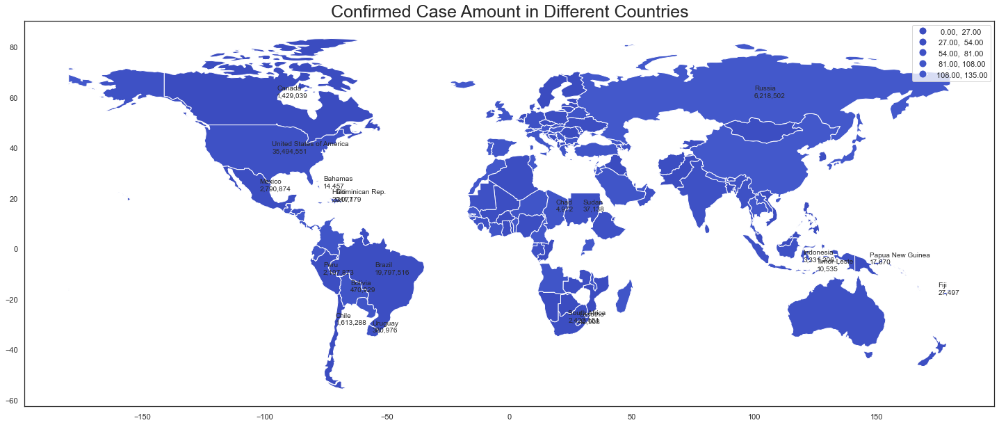

In [93]:
worldmerge.plot(column='TotalCases', scheme="quantiles",
           figsize=(25, 20),
           legend=True,cmap='coolwarm')
plt.title('Confirmed Case Amount in Different Countries',fontsize=25)
for i in range(0,20):
    plt.text(float(worldmerge.Longitude[i]),float(worldmerge.Latitude[i]),"{}\n{}".format(worldmerge.name[i],worldmerge.TotalCases[i]),size=10)
plt.show()

### 8. Maps, Bubble Chart and Boxplot  with Plotly

In [94]:
import numpy as np

In [95]:
covidvisual3 = covidvisual.replace(np.nan, 0) #it replaces nan with 0s in order to plot the maps below

In [96]:
covidvisual3.shape

(148, 43)

In [97]:
covidvisual.shape

(148, 43)

In [98]:
covidvisual3.head(3)

,Country,Country Code,Latitude,Longitude,HDI rank,Human Development Index 2019 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,...,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop,covid_mortality_rate (per 100000)
0,Afghanistan,AFG,33.0,65.0,169,0.511,64.83,10.176430,3.930000,2229.362021,...,+966,"43,154","1,124","701,952",39864282,Asia,13,2.0,"1,083",16.749330
1,Albania,ALB,41.0,20.0,69,0.795,78.57,14.695620,10.145730,13998.299890,...,+13,355,3,"916,777",2874426,Europe,16,0.0,124,85.477935
2,Algeria,DZA,28.0,3.0,91,0.748,76.88,14.604302,7.986548,11173.956810,...,+807,"50,772",37,"230,861",44697286,Africa,34,0.6,"1,136",9.371934


In [99]:
import plotly.express as px

In [100]:
fig = px.scatter_geo(covidvisual3, locations='Country Code', color='Continent',title = 'Total Deaths per Country',
               hover_name='Country', size='TotalDeaths')
fig.update_layout(
    title={
        'text':'Total Deaths per Country and Continent',
        'y':0.85,
        'x':0.47,
        'xanchor': 'center',
        'yanchor': 'top'})

In [101]:
fig = px.scatter_geo(covidvisual,
                    lat=covidvisual.Latitude,
                    lon=covidvisual.Longitude,
                    hover_name='Country')
fig.update_layout(
    title={
        'text':'Countries Coordinates',
        'y':0.94,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top'})

In [102]:
fig = px.choropleth(covidvisual, locations='Country Code',
                    color='covid_mortality_rate (per 100000)',
                    hover_name='Country',
                    color_continuous_scale=px.colors.sequential.Plasma)
fig.update_layout(
    title={
        'text':'Covid Death Rate by Country',
        'y':0.88,
        'x':0.44,
        'xanchor': 'center',
        'yanchor': 'top'})

In [103]:
import plotly.graph_objects as go

In [104]:
fig = go.Figure(data=go.Choropleth(
    locations = covidvisual['Country Code'],
    z = covidvisual['people_fully_vaccinated_per_hundred'],
    text = covidvisual['Country'],
    colorscale = 'Blues',
    autocolorscale=False,
    reversescale=True,
    marker_line_color='darkgray',
    marker_line_width=0.5,
    #colorbar_tickprefix = '$',
    colorbar_title = 'per 100',
    
))

fig.update_layout(
    title={'text':'People Fully Vaccinated by Country','y':0.89,'x':0.5,'xanchor': 'center','yanchor': 'top'},
    geo=dict(
        showframe=False,
        showcoastlines=False,
        projection_type='equirectangular'
    ),
    annotations = [dict(
        x=0.5,
        y=0.1,
        xref='paper',
        yref='paper',
        text='World Map',
        
        showarrow = False
    )]
)

fig.show()

In [105]:
fig = px.scatter(covidvisual3, x='Human Development Index 2019 (HDI)', y='people_fully_vaccinated_per_hundred', size='TotalDeaths', color='Continent',
           hover_name='Country', log_x=True, size_max=60)
fig.update_layout(
    title={
        'text':'Fully Vaccinated People (per 100) vs HDI by Continent and Total Deaths',
        'y':0.95,
        'x':0.44,
        'xanchor': 'center',
        'yanchor': 'top'})

In [106]:
fig = px.box(covidvisual, y='covid_mortality_rate (per 100000)', color = 'IncomeGroup', title = 'Covid Death Rate by Income Group')
fig.update_layout(
    title={
        'text': 'Covid Death Rate per Continent',
        'y':0.88,
        'x':0.44,
        'xanchor': 'center',
        'yanchor': 'top'})

In [107]:
fig = px.box(covidvisual, y='covid_mortality_rate (per 100000)', color = 'Continent')
fig.update_layout(
    title={
        'text': 'Covid Death Rate per Continent',
        'y':0.95,
        'x':0.44,
        'xanchor': 'center',
        'yanchor': 'top'}, font_family='Arial',font_color='blue', title_font_family='Times New Roman',title_font_color='black',
    legend_title_font_color='green',  font=dict(family='Courier New, monospace',size=15,color='RebeccaPurple'
    ))
fig.show()

### 9. Statistics

In [108]:
import pandas as pd

In [109]:
covidvisual = pd.read_excel('C:/Users/andre/Documents/Programming Languages/Python/pimespython/Project/covidwebscraping/actualcovid19project/covidvisual.xlsx')

In [110]:
covidvisual.head(4)

,Country,Country Code,Latitude,Longitude,HDI rank,Human Development Index 2019 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,...,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop,covid_mortality_rate (per 100000)
0,Afghanistan,AFG,33.0,65.0,169,0.511,64.83,10.176430,3.930000,2229.362021,...,+966,"43,154","1,124","701,952",39864282,Asia,13,2.0,"1,083",16.749330
1,Albania,ALB,41.0,20.0,69,0.795,78.57,14.695620,10.145730,13998.299890,...,+13,355,3,"916,777",2874426,Europe,16,NaN,124,85.477935
2,Algeria,DZA,28.0,3.0,91,0.748,76.88,14.604302,7.986548,11173.956810,...,+807,"50,772",37,"230,861",44697286,Africa,34,0.6,"1,136",9.371934
3,Angola,AGO,-12.5,18.5,148,0.581,61.15,11.777202,5.173993,6104.054640,...,NaN,"5,324",8,"681,443",33955402,Africa,NaN,NaN,157,2.945039


In [111]:
covidvisual.shape

(148, 43)

In [112]:
covidvisual.columns

Index(['Country', 'Country Code', 'Latitude', 'Longitude', 'HDI rank',
       'Human Development Index 2019 (HDI)', 'Life expectancy at birth',
       'Expected years of schooling', 'Mean years of schooling',
       'Gross national income (GNI) per capita', 'GDP 2019 (US$)',
       'GDP per capita 2019 (US$)', 'GDP growth 2019 (annual %)',
       'Inflation Rate 2019 (%)', 'Unemployment Rate 2020 (%)', 'Region',
       'IncomeGroup', 'total_vaccinations', 'date', 'people_vaccinated',
       'people_fully_vaccinated', 'daily_vaccinations_raw',
       'daily_vaccinations', 'total_vaccinations_per_hundred',
       'people_vaccinated_per_hundred', 'people_fully_vaccinated_per_hundred',
       'daily_vaccinations_per_million', 'Country,Other', 'TotalCases',
       'NewCases', 'TotalDeaths', 'NewDeaths', 'TotalRecovered',
       'NewRecovered', 'ActiveCases', 'Serious,Critical', 'TotalTests',
       'Population', 'Continent', 'New Cases/1M pop', 'New Deaths/1M pop',
       'Active Cases/1M p

In [122]:
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

In [113]:
covidvisual

,Country,Country Code,Latitude,Longitude,HDI rank,Human Development Index 2019 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,...,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop,covid_mortality_rate (per 100000)
0,Afghanistan,AFG,33.0,65.0,169,0.511,64.83,10.176430,3.930000,2229.362021,...,+966,"43,154","1,124","701,952",39864282,Asia,13,2.0,"1,083",16.749330
1,Albania,ALB,41.0,20.0,69,0.795,78.57,14.695620,10.145730,13998.299890,...,+13,355,3,"916,777",2874426,Europe,16,NaN,124,85.477935
2,Algeria,DZA,28.0,3.0,91,0.748,76.88,14.604302,7.986548,11173.956810,...,+807,"50,772",37,"230,861",44697286,Africa,34,0.6,"1,136",9.371934
3,Angola,AGO,-12.5,18.5,148,0.581,61.15,11.777202,5.173993,6104.054640,...,NaN,"5,324",8,"681,443",33955402,Africa,NaN,NaN,157,2.945039
4,Armenia,ARM,40.0,45.0,81,0.776,75.09,13.068610,11.301740,13894.013020,...,+123,"5,497",NaN,"1,328,107",2969182,Asia,78,2.0,"1,851",155.059542
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
143,United States,USA,38.0,-97.0,17,0.926,78.86,16.310390,13.413440,63825.657480,...,+567,"5,261,874","9,051","527,202,813",333082557,North America,21,0.2,"15,798",188.587480
144,Uruguay,URY,-33.0,-56.0,55,0.817,77.91,16.835640,8.925730,20063.642220,...,NaN,"2,305",68,"3,039,586",3486636,South America,NaN,NaN,661,170.651597
145,Vanuatu,VUT,-16.0,167.0,140,0.609,70.47,11.733910,7.064846,3104.799016,...,NaN,0,NaN,"23,000",314806,Australia/Oceania,NaN,NaN,NaN,0.317656
146,Viet Nam,VNM,16.0,106.0,117,0.704,75.40,12.692323,8.320000,7432.706806,...,NaN,"95,553",NaN,"11,890,084",98276482,Asia,29,NaN,972,0.641049


In [114]:
import plotly.express as px

In [115]:
fig = px.scatter(covidvisual, x='Human Development Index 2019 (HDI)', y='people_fully_vaccinated_per_hundred', color='Continent', trendline='ols')
fig.update_layout(
    title={
        'text': 'People Fully Vaccinanted (per 100) vs HDI by Continent OLS ',
        'y':0.95,
        'x':0.44,
        'xanchor': 'center',
        'yanchor': 'top'})
fig.show()

results = px.get_trendline_results(fig)
print(results)

results.px_fit_results.iloc[0].summary()

           Continent                                     px_fit_results
0               Asia  <statsmodels.regression.linear_model.Regressio...
1             Europe  <statsmodels.regression.linear_model.Regressio...
2             Africa  <statsmodels.regression.linear_model.Regressio...
3  Australia/Oceania  <statsmodels.regression.linear_model.Regressio...
4      North America  <statsmodels.regression.linear_model.Regressio...
5      South America  <statsmodels.regression.linear_model.Regressio...


<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                      y   R-squared:                       0.296
Model:                            OLS   Adj. R-squared:                  0.277
Method:                 Least Squares   F-statistic:                     15.16
Date:                Fri, 30 Jul 2021   Prob (F-statistic):           0.000411
Time:                        17:15:59   Log-Likelihood:                -164.08
No. Observations:                  38   AIC:                             332.2
Df Residuals:                      36   BIC:                             335.4
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const        -58.1362     20.520     -2.833      0.008     -99.753     -16.519
x1           104.0963     26.736      3.894      0.000      49.874     158.319
==============================================================================
Omnibus:                        7.926   Durbin-Watson:                   1.867
Prob(Omnibus):                  0.019   Jarque-Bera (JB):                7.038
Skew:                           1.034   Prob(JB):                       0.0296
Kurtosis:                       3.408   Cond. No.                         14.0
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

In [116]:
fig = px.scatter(covidvisual, x='Human Development Index 2019 (HDI)', y='people_fully_vaccinated_per_hundred', trendline='ols', hover_name='Country')
fig.update_layout(
    title={
        'text': 'People Fully Vaccinated (per 100) vs HDI OLS',
        'y':0.94,
        'x':0.47,
        'xanchor': 'center',
        'yanchor': 'top'})
fig.show()

results = px.get_trendline_results(fig)
print(results)

results.px_fit_results.iloc[0].summary()

                                      px_fit_results
0  <statsmodels.regression.linear_model.Regressio...


<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                      y   R-squared:                       0.547
Model:                            OLS   Adj. R-squared:                  0.544
Method:                 Least Squares   F-statistic:                     170.4
Date:                Fri, 30 Jul 2021   Prob (F-statistic):           4.94e-26
Time:                        17:16:07   Log-Likelihood:                -585.18
No. Observations:                 143   AIC:                             1174.
Df Residuals:                     141   BIC:                             1180.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const        -58.0630      6.187     -9.385      0.000     -70.294     -45.832
x1           106.6965      8.173     13.055      0.000      90.539     122.854
==============================================================================
Omnibus:                       14.654   Durbin-Watson:                   1.653
Prob(Omnibus):                  0.001   Jarque-Bera (JB):               16.264
Skew:                           0.714   Prob(JB):                     0.000294
Kurtosis:                       3.830   Cond. No.                         10.4
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

In [117]:
fig = px.scatter(covidvisual, x='Human Development Index 2019 (HDI)', y='covid_mortality_rate (per 100000)', trendline='ols', hover_name='Country')
fig.update_layout(
    title={
        'text': 'Covid Death Rate (per 100000) vs HDI OLS',
        'y':0.94,
        'x':0.48,
        'xanchor': 'center',
        'yanchor': 'top'})
fig.show()

results = px.get_trendline_results(fig)
print(results)

results.px_fit_results.iloc[0].summary()

                                      px_fit_results
0  <statsmodels.regression.linear_model.Regressio...


<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                      y   R-squared:                       0.202
Model:                            OLS   Adj. R-squared:                  0.196
Method:                 Least Squares   F-statistic:                     36.38
Date:                Fri, 30 Jul 2021   Prob (F-statistic):           1.31e-08
Time:                        17:16:15   Log-Likelihood:                -849.36
No. Observations:                 146   AIC:                             1703.
Df Residuals:                     144   BIC:                             1709.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const       -122.6540     33.780     -3.631      0.000    -189.423     -55.885
x1           270.5315     44.854      6.031      0.000     181.874     359.189
==============================================================================
Omnibus:                       83.537   Durbin-Watson:                   1.888
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              543.828
Skew:                           1.956   Prob(JB):                    8.11e-119
Kurtosis:                      11.608   Cond. No.                         10.3
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

In [118]:
fig = px.scatter(covidvisual, x='people_fully_vaccinated_per_hundred', y='covid_mortality_rate (per 100000)', trendline='ols', hover_name='Country')
fig.update_layout(
    title={
        'text': 'Covid Death Rate vs People Fully Vaccinated (per 100) OLS',
        'y':0.95,
        'x':0.48,
        'xanchor': 'center',
        'yanchor': 'top'})
fig.show()

results = px.get_trendline_results(fig)
print(results)

results.px_fit_results.iloc[0].summary()

                                      px_fit_results
0  <statsmodels.regression.linear_model.Regressio...


<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                      y   R-squared:                       0.103
Model:                            OLS   Adj. R-squared:                  0.096
Method:                 Least Squares   F-statistic:                     15.89
Date:                Fri, 30 Jul 2021   Prob (F-statistic):           0.000108
Time:                        17:16:39   Log-Likelihood:                -829.36
No. Observations:                 141   AIC:                             1663.
Df Residuals:                     139   BIC:                             1669.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         50.5468     10.343      4.887      0.000      30.098      70.996
x1             1.3582      0.341      3.987      0.000       0.685       2.032
==============================================================================
Omnibus:                       81.573   Durbin-Watson:                   1.490
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              452.561
Skew:                           2.040   Prob(JB):                     5.34e-99
Kurtosis:                      10.771   Cond. No.                         42.7
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

In [119]:
import numpy as np 
import matplotlib.pyplot as plt
import itertools
import seaborn as sns

C:\Users\andre\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).

C:\Users\andre\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).

C:\Users\andre\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).

C:\Users\andre\anaconda3\lib\site-pac

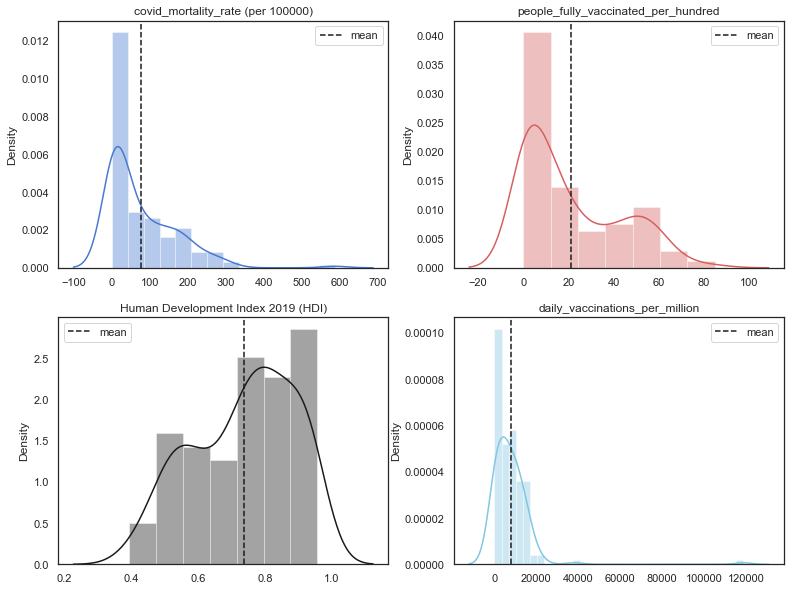

In [120]:
cols  = ['covid_mortality_rate (per 100000)','people_fully_vaccinated_per_hundred','Human Development Index 2019 (HDI)','daily_vaccinations_per_million']
length = len(cols)
c = ['b','r','k','c']
plt.figure(figsize=(13,10))

for i,j,k in itertools.zip_longest(cols,range(length),c):
    plt.subplot(2,2,j+1)
    sns.distplot(covidvisual[i],color=k)
    plt.axvline(covidvisual[i].mean(),color = 'k',linestyle = 'dashed',label='mean')
    plt.legend(loc='best')
    plt.title(i)
    plt.xlabel('')

plt.show()

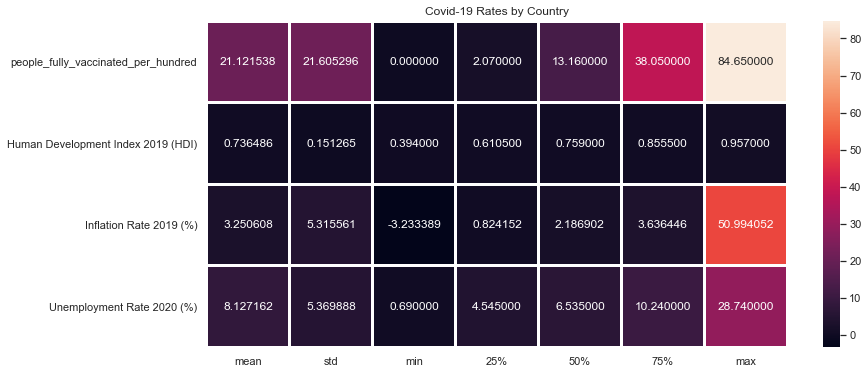

In [121]:
plt.figure(figsize=(13,6))
sns.heatmap(covidvisual[['people_fully_vaccinated_per_hundred', 'Human Development Index 2019 (HDI)','Inflation Rate 2019 (%)','Unemployment Rate 2020 (%)']].describe()[1:].transpose(),annot=True,fmt='f',linecolor="white",linewidths=2) # fmt: String formatting code to use when adding annotations
plt.title('Covid-19 Rates by Country')
plt.show()

Text(0.5, 1.0, 'Correlation Heatmap')

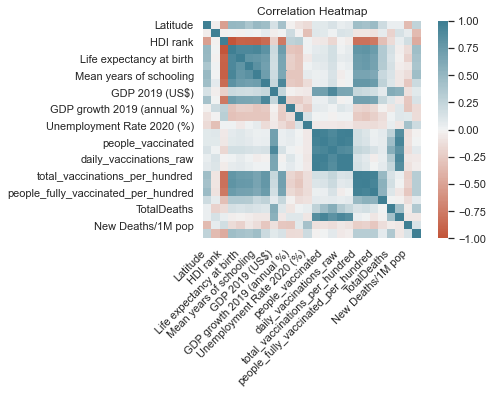

In [122]:
corr = covidvisual.corr()
ax = sns.heatmap(
    corr, 
    vmin=-1, vmax=1, center=0,
    cmap=sns.diverging_palette(20, 220, n=200),
    square=True
)
ax.set_xticklabels(
    ax.get_xticklabels(),
    rotation=45,
    horizontalalignment='right'
);
plt.title('Correlation Heatmap')

In [123]:
fig = px.imshow(covidvisual.corr())
fig.update_layout(
    title={
        'text': 'Correlation Heatmap',
        'y':0.92,
        'x':0.48,
        'xanchor': 'center',
        'yanchor': 'top'})
fig.show()

In [124]:
import string
letters = string.ascii_uppercase[0:15]
covidvisual.corr()

,Latitude,Longitude,HDI rank,Human Development Index 2019 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,GDP 2019 (US$),GDP per capita 2019 (US$),...,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million,TotalDeaths,Population,New Deaths/1M pop,covid_mortality_rate (per 100000)
Latitude,1.000000,-0.030051,-0.525417,0.502230,0.485065,0.385642,0.490223,0.460643,0.145862,0.422644,...,0.046710,0.071213,0.454468,0.427806,0.469508,0.189621,0.033178,0.035028,-0.340720,0.261506
Longitude,-0.030051,1.000000,-0.009387,0.003063,-0.014894,0.017684,0.006187,0.069306,-0.025818,0.006888,...,0.131036,0.111376,-0.080768,-0.084526,-0.092918,0.059552,-0.197683,0.143686,0.059261,-0.346362
HDI rank,-0.525417,-0.009387,1.000000,-0.991905,-0.902897,-0.906612,-0.923641,-0.856336,-0.209214,-0.764815,...,-0.006788,-0.044794,-0.810415,-0.819780,-0.760929,-0.326307,-0.142396,0.045275,0.175223,-0.443633
Human Development Index 2019 (HDI),0.502230,0.003063,-0.991905,1.000000,0.913261,0.908702,0.935168,0.824838,0.207117,0.731669,...,0.018234,0.054261,0.792634,0.806387,0.739759,0.337255,0.151264,-0.031006,-0.137485,0.449080
Life expectancy at birth,0.485065,-0.014894,-0.902897,0.913261,1.000000,0.802541,0.787116,0.729416,0.183297,0.659822,...,0.047144,0.077237,0.741141,0.761334,0.687542,0.342535,0.130216,-0.008661,-0.201892,0.418362
Expected years of schooling,0.385642,0.017684,-0.906612,0.908702,0.802541,1.000000,0.828729,0.710315,0.171971,0.653128,...,0.019332,0.046568,0.728636,0.753929,0.681011,0.328721,0.154142,-0.031964,-0.063343,0.393538
Mean years of schooling,0.490223,0.006187,-0.923641,0.935168,0.787116,0.828729,1.000000,0.719192,0.188600,0.647936,...,-0.034418,0.011735,0.677692,0.677738,0.629629,0.221953,0.126710,-0.062507,-0.131671,0.456428
Gross national income (GNI) per capita,0.460643,0.069306,-0.856336,0.824838,0.729416,0.710315,0.719192,1.000000,0.229252,0.925864,...,-0.023397,0.010387,0.779407,0.780166,0.736470,0.280612,0.102297,-0.063258,-0.259098,0.208184
GDP 2019 (US$),0.145862,-0.025818,-0.209214,0.207117,0.183297,0.171971,0.188600,0.229252,1.000000,0.247190,...,0.657301,0.655824,0.233295,0.199838,0.156636,0.065150,0.600476,0.569908,-0.114520,0.082580
GDP per capita 2019 (US$),0.422644,0.006888,-0.764815,0.731669,0.659822,0.653128,0.647936,0.925864,0.247190,1.000000,...,-0.022786,0.007840,0.706977,0.709014,0.673399,0.239123,0.100428,-0.056234,-0.260924,0.137670


In [125]:
corr = covidvisual.corr()

In [128]:
corr.style.background_gradient(cmap='coolwarm')

,Latitude,Longitude,HDI rank,Human Development Index 2019 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,GDP 2019 (US$),GDP per capita 2019 (US$),GDP growth 2019 (annual %),Inflation Rate 2019 (%),Unemployment Rate 2020 (%),total_vaccinations,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million,TotalDeaths,Population,New Deaths/1M pop,covid_mortality_rate (per 100000)
Latitude,1.000000,-0.030051,-0.525417,0.502230,0.485065,0.385642,0.490223,0.460643,0.145862,0.422644,-0.010177,-0.101458,-0.147385,0.082927,0.082330,0.139465,0.046710,0.071213,0.454468,0.427806,0.469508,0.189621,0.033178,0.035028,-0.340720,0.261506
Longitude,-0.030051,1.000000,-0.009387,0.003063,-0.014894,0.017684,0.006187,0.069306,-0.025818,0.006888,0.192851,-0.003750,-0.312522,0.090282,0.083533,0.010632,0.131036,0.111376,-0.080768,-0.084526,-0.092918,0.059552,-0.197683,0.143686,0.059261,-0.346362
HDI rank,-0.525417,-0.009387,1.000000,-0.991905,-0.902897,-0.906612,-0.923641,-0.856336,-0.209214,-0.764815,0.280662,0.300318,0.018341,-0.061218,-0.069183,-0.161142,-0.006788,-0.044794,-0.810415,-0.819780,-0.760929,-0.326307,-0.142396,0.045275,0.175223,-0.443633
Human Development Index 2019 (HDI),0.502230,0.003063,-0.991905,1.000000,0.913261,0.908702,0.935168,0.824838,0.207117,0.731669,-0.283950,-0.302710,0.021880,0.069542,0.079443,0.165638,0.018234,0.054261,0.792634,0.806387,0.739759,0.337255,0.151264,-0.031006,-0.137485,0.449080
Life expectancy at birth,0.485065,-0.014894,-0.902897,0.913261,1.000000,0.802541,0.787116,0.729416,0.183297,0.659822,-0.216576,-0.282571,-0.057891,0.088733,0.096223,0.165328,0.047144,0.077237,0.741141,0.761334,0.687542,0.342535,0.130216,-0.008661,-0.201892,0.418362
Expected years of schooling,0.385642,0.017684,-0.906612,0.908702,0.802541,1.000000,0.828729,0.710315,0.171971,0.653128,-0.222158,-0.274515,0.011884,0.060599,0.072788,0.144264,0.019332,0.046568,0.728636,0.753929,0.681011,0.328721,0.154142,-0.031964,-0.063343,0.393538
Mean years of schooling,0.490223,0.006187,-0.923641,0.935168,0.787116,0.828729,1.000000,0.719192,0.188600,0.647936,-0.276210,-0.269227,0.051038,0.027380,0.034312,0.122778,-0.034418,0.011735,0.677692,0.677738,0.629629,0.221953,0.126710,-0.062507,-0.131671,0.456428
Gross national income (GNI) per capita,0.460643,0.069306,-0.856336,0.824838,0.729416,0.710315,0.719192,1.000000,0.229252,0.925864,-0.255273,-0.272337,-0.134854,0.031823,0.039560,0.143354,-0.023397,0.010387,0.779407,0.780166,0.736470,0.280612,0.102297,-0.063258,-0.259098,0.208184
GDP 2019 (US$),0.145862,-0.025818,-0.209214,0.207117,0.183297,0.171971,0.188600,0.229252,1.000000,0.247190,-0.022812,-0.043157,-0.061121,0.701038,0.716598,0.908615,0.657301,0.655824,0.233295,0.199838,0.156636,0.065150,0.600476,0.569908,-0.114520,0.082580
GDP per capita 2019 (US$),0.422644,0.006888,-0.764815,0.731669,0.659822,0.653128,0.647936,0.925864,0.247190,1.000000,-0.220153,-0.232028,-0.145566,0.031374,0.038759,0.143331,-0.022786,0.007840,0.706977,0.709014,0.673399,0.239123,0.100428,-0.056234,-0.260924,0.137670


In [126]:
corr.style.background_gradient(cmap='coolwarm').set_precision(2) 

,Latitude,Longitude,HDI rank,Human Development Index 2019 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,GDP 2019 (US$),GDP per capita 2019 (US$),GDP growth 2019 (annual %),Inflation Rate 2019 (%),Unemployment Rate 2020 (%),total_vaccinations,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million,TotalDeaths,Population,New Deaths/1M pop,covid_mortality_rate (per 100000)
Latitude,1.00,-0.03,-0.53,0.50,0.49,0.39,0.49,0.46,0.15,0.42,-0.01,-0.10,-0.15,0.08,0.08,0.14,0.05,0.07,0.45,0.43,0.47,0.19,0.03,0.04,-0.34,0.26
Longitude,-0.03,1.00,-0.01,0.00,-0.01,0.02,0.01,0.07,-0.03,0.01,0.19,-0.00,-0.31,0.09,0.08,0.01,0.13,0.11,-0.08,-0.08,-0.09,0.06,-0.20,0.14,0.06,-0.35
HDI rank,-0.53,-0.01,1.00,-0.99,-0.90,-0.91,-0.92,-0.86,-0.21,-0.76,0.28,0.30,0.02,-0.06,-0.07,-0.16,-0.01,-0.04,-0.81,-0.82,-0.76,-0.33,-0.14,0.05,0.18,-0.44
Human Development Index 2019 (HDI),0.50,0.00,-0.99,1.00,0.91,0.91,0.94,0.82,0.21,0.73,-0.28,-0.30,0.02,0.07,0.08,0.17,0.02,0.05,0.79,0.81,0.74,0.34,0.15,-0.03,-0.14,0.45
Life expectancy at birth,0.49,-0.01,-0.90,0.91,1.00,0.80,0.79,0.73,0.18,0.66,-0.22,-0.28,-0.06,0.09,0.10,0.17,0.05,0.08,0.74,0.76,0.69,0.34,0.13,-0.01,-0.20,0.42
Expected years of schooling,0.39,0.02,-0.91,0.91,0.80,1.00,0.83,0.71,0.17,0.65,-0.22,-0.27,0.01,0.06,0.07,0.14,0.02,0.05,0.73,0.75,0.68,0.33,0.15,-0.03,-0.06,0.39
Mean years of schooling,0.49,0.01,-0.92,0.94,0.79,0.83,1.00,0.72,0.19,0.65,-0.28,-0.27,0.05,0.03,0.03,0.12,-0.03,0.01,0.68,0.68,0.63,0.22,0.13,-0.06,-0.13,0.46
Gross national income (GNI) per capita,0.46,0.07,-0.86,0.82,0.73,0.71,0.72,1.00,0.23,0.93,-0.26,-0.27,-0.13,0.03,0.04,0.14,-0.02,0.01,0.78,0.78,0.74,0.28,0.10,-0.06,-0.26,0.21
GDP 2019 (US$),0.15,-0.03,-0.21,0.21,0.18,0.17,0.19,0.23,1.00,0.25,-0.02,-0.04,-0.06,0.70,0.72,0.91,0.66,0.66,0.23,0.20,0.16,0.07,0.60,0.57,-0.11,0.08
GDP per capita 2019 (US$),0.42,0.01,-0.76,0.73,0.66,0.65,0.65,0.93,0.25,1.00,-0.22,-0.23,-0.15,0.03,0.04,0.14,-0.02,0.01,0.71,0.71,0.67,0.24,0.10,-0.06,-0.26,0.14


In [127]:
corr = covidvisual.corr() 
c1 = corr.unstack()
c1.sort_values(ascending = False)

Latitude                            Latitude                              1.000000
total_vaccinations                  total_vaccinations                    1.000000
Human Development Index 2019 (HDI)  Human Development Index 2019 (HDI)    1.000000
Life expectancy at birth            Life expectancy at birth              1.000000
Expected years of schooling         Expected years of schooling           1.000000
                                                                            ...   
HDI rank                            Expected years of schooling          -0.906612
Mean years of schooling             HDI rank                             -0.923641
HDI rank                            Mean years of schooling              -0.923641
Human Development Index 2019 (HDI)  HDI rank                             -0.991905
HDI rank                            Human Development Index 2019 (HDI)   -0.991905
Length: 676, dtype: float64

In [129]:
corr = covidvisual.corr() 
c1 = corr.abs().unstack()
c1.sort_values(ascending = False)

Latitude                            Latitude                              1.000000
total_vaccinations                  total_vaccinations                    1.000000
Human Development Index 2019 (HDI)  Human Development Index 2019 (HDI)    1.000000
Life expectancy at birth            Life expectancy at birth              1.000000
Expected years of schooling         Expected years of schooling           1.000000
                                                                            ...   
people_vaccinated                   covid_mortality_rate (per 100000)     0.003193
Human Development Index 2019 (HDI)  Longitude                             0.003063
Longitude                           Human Development Index 2019 (HDI)    0.003063
TotalDeaths                         daily_vaccinations_per_million        0.000036
daily_vaccinations_per_million      TotalDeaths                           0.000036
Length: 676, dtype: float64

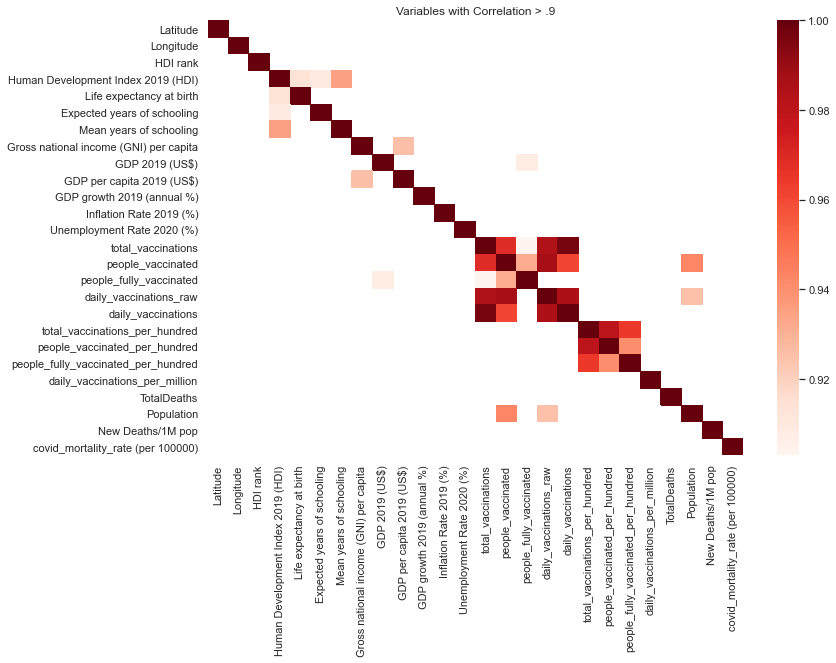

In [130]:
corr = covidvisual.corr()
kot = corr[corr>=.9]
plt.figure(figsize=(12,8))
sns.heatmap(kot, cmap='Reds')
plt.title('Variables with Correlation > .9');

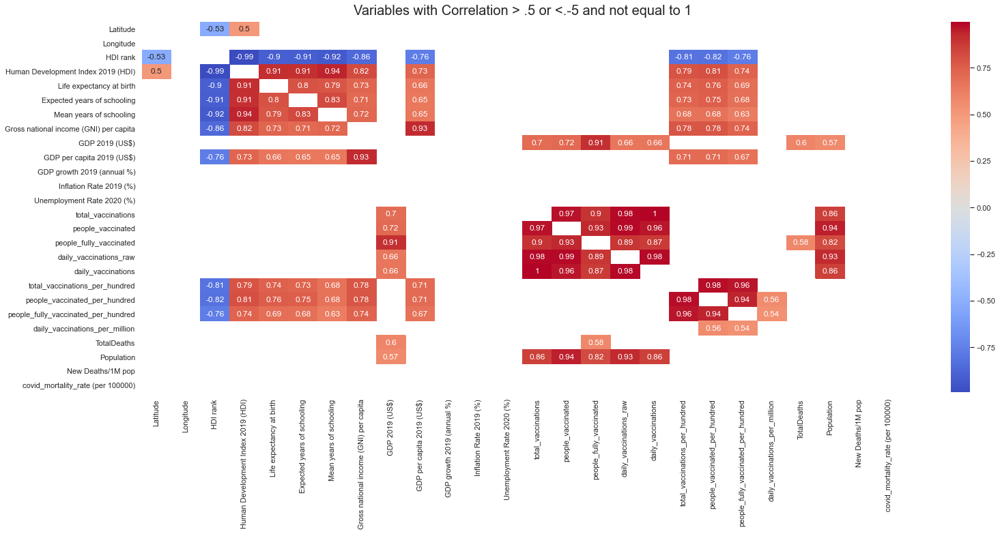

In [131]:
dfCorr = covidvisual.corr()
filteredDf = dfCorr[((dfCorr >= .5) | (dfCorr <= -.5)) & (dfCorr !=1.000)]
plt.figure(figsize=(25,10))
sns.heatmap(filteredDf, annot=True, cmap='coolwarm')
plt.title('Variables with Correlation > .5 or <.-5 and not equal to 1',
          size=20, verticalalignment='bottom')
plt.show()

### 10. Econometrics

In [132]:
import statsmodels.api as sm
import statsmodels.formula.api as smf
from statsmodels.sandbox.regression.predstd import wls_prediction_std
from statsmodels.api import add_constant, OLS
from statsmodels.iolib.summary2 import summary_col
from numpy import NaN
from sklearn import linear_model
from scipy import stats
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
from linearmodels.iv import IV2SLS

In [133]:
covidvisual = pd.read_excel('C:/Users/andre/Documents/Programming Languages/Python/pimespython/Project/covidwebscraping/actualcovid19project/covidvisual.xlsx')

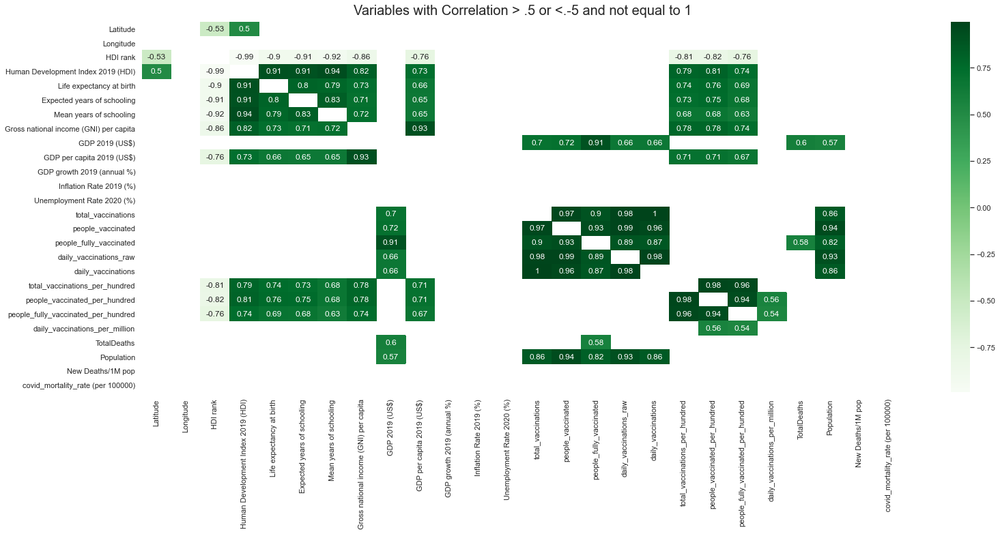

In [134]:
dfCorr = covidvisual.corr()
filteredDf = dfCorr[((dfCorr >= .5) | (dfCorr <= -.5)) & (dfCorr !=1.000)]
plt.figure(figsize=(25,10))
plt.title('Variables with Correlation > .5 or <.-5 and not equal to 1',
          size=20, verticalalignment='bottom')
sns.heatmap(filteredDf, annot=True, cmap='Greens')
plt.show()

In [145]:
pd.set_option('display.max_rows', 100)
pd.set_option('display.max_columns', None)

In [135]:
covidvisual.head(3)

,Country,Country Code,Latitude,Longitude,HDI rank,Human Development Index 2019 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,...,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop,covid_mortality_rate (per 100000)
0,Afghanistan,AFG,33.0,65.0,169,0.511,64.83,10.176430,3.930000,2229.362021,...,+966,"43,154","1,124","701,952",39864282,Asia,13,2.0,"1,083",16.749330
1,Albania,ALB,41.0,20.0,69,0.795,78.57,14.695620,10.145730,13998.299890,...,+13,355,3,"916,777",2874426,Europe,16,NaN,124,85.477935
2,Algeria,DZA,28.0,3.0,91,0.748,76.88,14.604302,7.986548,11173.956810,...,+807,"50,772",37,"230,861",44697286,Africa,34,0.6,"1,136",9.371934


In [136]:
covidvisual.sort_values(by=['covid_mortality_rate (per 100000)'], ascending = False).head(3)

,Country,Country Code,Latitude,Longitude,HDI rank,Human Development Index 2019 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,...,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop,covid_mortality_rate (per 100000)
108,Peru,PER,-10.0,-76.0,79,0.777,76.74,14.99071,9.69633,12252.30018,...,NaN,NaN,"1,856","15,432,556",33463188,South America,NaN,NaN,"5,710",586.130646
60,Hungary,HUN,47.0,20.0,40,0.854,76.88,15.20418,11.96329,31328.80599,...,+531,"31,890",13,"6,323,793",9634027,Europe,7,NaN,"3,310",311.655759
17,Bosnia and Herzegovina,BIH,44.0,18.0,73,0.780,77.40,13.80000,9.81787,14871.81114,...,NaN,"6,621",NaN,"1,068,521",3258906,Europe,NaN,NaN,"2,032",297.216305


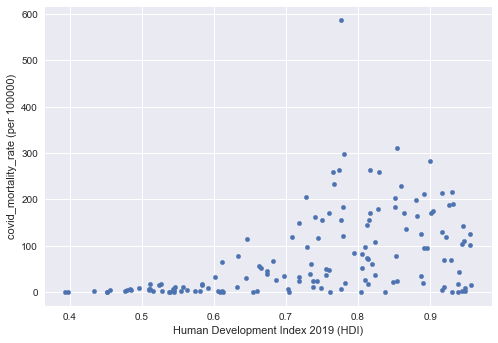

In [137]:
plt.style.use('seaborn')
covidvisual.plot(x='Human Development Index 2019 (HDI)', y='covid_mortality_rate (per 100000)', kind='scatter')
plt.show()

In [138]:
#correlating the hdi with covid_mortality_rate, as control population, latitude can be used, income group (or gpd per capita);
#for an instrument, a variable that correlates with hdi but not directly to covid mortality rate, gdp per capita for example 

#### 10.1 Linear Regression Model

$$ 
Coviddeathrate_{i} = \beta_{0} + \beta_{1}HDI_{i} + u_{i}
$$


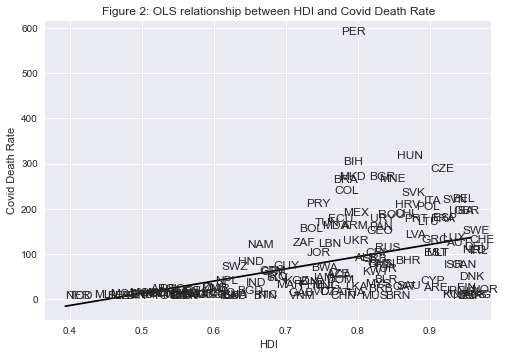

In [139]:
# Dropping NA's is required to use numpy's polyfit
df1_subset = covidvisual.dropna(subset=['covid_mortality_rate (per 100000)', 'Human Development Index 2019 (HDI)'])

# Use only 'base sample' for plotting purposes
#df1_subset = df1_subset[df1_subset['baseco'] == 1]

X = df1_subset['Human Development Index 2019 (HDI)']
y = df1_subset['covid_mortality_rate (per 100000)']
labels = df1_subset['Country Code']

# Replace markers with country labels
fig, ax = plt.subplots()
ax.scatter(X, y, marker='')

for i, label in enumerate(labels):
    ax.annotate(label, (X.iloc[i], y.iloc[i]))

# Fit a linear trend line
ax.plot(np.unique(X),
         np.poly1d(np.polyfit(X, y, 1))(np.unique(X)),
         color='black')

#ax.set_xlim([0,1])
#ax.set_ylim([0,300])
ax.set_xlabel('HDI')
ax.set_ylabel('Covid Death Rate')
ax.set_title('Figure 2: OLS relationship between HDI and Covid Death Rate')
plt.show()

In [140]:
#it might seem counterintuitive at first, as HDI increases Covid Death Rate increases
#it could be because of countries with higher HDI has higher mobility, or something else, let's find out

In [141]:
#adding a constant term prevents overall bias by forcing the residual mean to equal zero
#it's like moving the regression line up or down to the point where the residual mean equals zero
#that's why a constant term is usually added into a linear regression
#bias exists if the residuals have an overall positive or negative mean, the model makes predicitons that are too high or too low
#the constant term prevents overall bias by forcing the residual mean to equal zero

In [142]:
covidvisual['const'] = 1

In [143]:
covidvisual.head(3)

,Country,Country Code,Latitude,Longitude,HDI rank,Human Development Index 2019 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,...,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop,covid_mortality_rate (per 100000),const
0,Afghanistan,AFG,33.0,65.0,169,0.511,64.83,10.176430,3.930000,2229.362021,...,"43,154","1,124","701,952",39864282,Asia,13,2.0,"1,083",16.749330,1
1,Albania,ALB,41.0,20.0,69,0.795,78.57,14.695620,10.145730,13998.299890,...,355,3,"916,777",2874426,Europe,16,NaN,124,85.477935,1
2,Algeria,DZA,28.0,3.0,91,0.748,76.88,14.604302,7.986548,11173.956810,...,"50,772",37,"230,861",44697286,Africa,34,0.6,"1,136",9.371934,1


In [144]:
#building the model

In [145]:
reg1 = sm.OLS(endog=covidvisual['covid_mortality_rate (per 100000)'], exog=covidvisual[['const', 'Human Development Index 2019 (HDI)']], \
    missing='drop')
type(reg1)

statsmodels.regression.linear_model.OLS

In [146]:
#obtainning the parameter estimates 

$$ 
Coviddeathrate_{i} = \hat\beta_{0} + \hat\beta_{1}HDI_{i} + u_{i}
$$

In [147]:
results = reg1.fit()
type(results)

statsmodels.regression.linear_model.RegressionResultsWrapper

In [148]:
print(results.summary())

                                    OLS Regression Results                                   
Dep. Variable:     covid_mortality_rate (per 100000)   R-squared:                       0.202
Model:                                           OLS   Adj. R-squared:                  0.196
Method:                                Least Squares   F-statistic:                     36.38
Date:                               Fri, 30 Jul 2021   Prob (F-statistic):           1.31e-08
Time:                                       17:20:13   Log-Likelihood:                -849.36
No. Observations:                                146   AIC:                             1703.
Df Residuals:                                    144   BIC:                             1709.
Df Model:                                          1                                         
Covariance Type:                           nonrobust                                         
                                         coef    std err    

The intercept $ \hat\beta_{0} = -122.65 $ \
The slope $ \hat\beta_{1} = 270.53 $ \
The positive $ \hat\beta_{1} $ parameter estimate implies that HDI has a positive effect on covid death rate, that is the higher HDI, higher covid death rate \
The p-value of 0.000 for $ \hat\beta_{1} $ implies that the effect of HDI on covid death rate is statistically significant
(using p<0.05 as a rejection rule). \
The R-squared value of 0.202 indicates that around 20% of variation in covid death rate is explained by HDI

In [149]:
#using the parameter estimates

$$
\widehat{Coviddeathrate_{i}} = -122.65 + 270.53HDI_{i}
$$

In [150]:
#the equation above describes the line that best fits the data shown in Figure 2
#the equation can be used to predict the level of covid death rate for a value of HDI

In [151]:
mean_hdi = np.mean(df1_subset['Human Development Index 2019 (HDI)'])
mean_hdi

0.7377945205479449

In [152]:
predicted_coviddeathrate = -122.65 + 270.53 * 0.74
predicted_coviddeathrate

77.54219999999998

In [153]:
#for a country with HDI value of 0.74 (the average for the dataset), the predicted level of covid death rate is 77.54

In [154]:
#there's another way to do it, it's easier and more accurate, using predict(), setting constant = 1 and hdii = mean_hdi

In [155]:
results.predict(exog=[1, mean_hdi])

array([76.94267855])

In [156]:
#plotting the predicted values hdi and observed values covid death rate

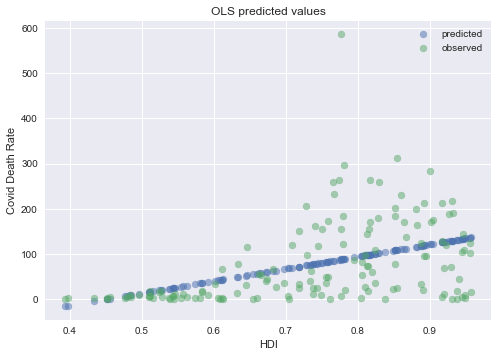

In [157]:
# Drop missing observations from whole sample

df1_plot = covidvisual.dropna(subset=['covid_mortality_rate (per 100000)', 'Human Development Index 2019 (HDI)'])

# Plot predicted values

fix, ax = plt.subplots()
ax.scatter(df1_plot['Human Development Index 2019 (HDI)'], results.predict(), alpha=0.5,
        label='predicted')

# Plot observed values

ax.scatter(df1_plot['Human Development Index 2019 (HDI)'], df1_plot['covid_mortality_rate (per 100000)'], alpha=0.5,
        label='observed')

ax.legend()
ax.set_title('OLS predicted values')
ax.set_xlabel('HDI')
ax.set_ylabel('Covid Death Rate')
plt.show()

#### 10.2 Multivariate Regression Model 

In [158]:
#that are many factors that influence covid death rate, and leaving out variables that affect it, will result in omitted variable bias
#yielding biased and inconsistent parameter estimates
#adding other factors will extend the linear regression model into multivariate regression model

In [159]:
#Factos such as:
#the effect on climate on covid death rate, latitude is used as a proxy
#(Latitude)
#population, in general it's harder to control countries with higher population, and the higher population more people can trasmit the virus
#(Population)
#people fully vaccinated per hundred, people who received all doses are less likely to die from the virus
#(people_fully_vaccinated_per_hundred)
#incomegroup, lower income groups are more likely to die from the virus cause the lack of resources, worse sanitation such as sewage treatment, 
#less access to treated water, and the lower income group are also more likely to share rooms with the same household, increasing the chance of transmitting the virus
#(IncomeGroup)-> since income group is categorical it won't be used in the regression

In [160]:
covidvisual.head()

,Country,Country Code,Latitude,Longitude,HDI rank,Human Development Index 2019 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,...,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop,covid_mortality_rate (per 100000),const
0,Afghanistan,AFG,33.0,65.0,169,0.511,64.83,10.176430,3.930000,2229.362021,...,"43,154","1,124","701,952",39864282,Asia,13,2.0,"1,083",16.749330,1
1,Albania,ALB,41.0,20.0,69,0.795,78.57,14.695620,10.145730,13998.299890,...,355,3,"916,777",2874426,Europe,16,NaN,124,85.477935,1
2,Algeria,DZA,28.0,3.0,91,0.748,76.88,14.604302,7.986548,11173.956810,...,"50,772",37,"230,861",44697286,Africa,34,0.6,"1,136",9.371934,1
3,Angola,AGO,-12.5,18.5,148,0.581,61.15,11.777202,5.173993,6104.054640,...,"5,324",8,"681,443",33955402,Africa,NaN,NaN,157,2.945039,1
4,Armenia,ARM,40.0,45.0,81,0.776,75.09,13.068610,11.301740,13894.013020,...,"5,497",NaN,"1,328,107",2969182,Asia,78,2.0,"1,851",155.059542,1


In [161]:
#lists of variables to be used in each regression
X1 = ['const', 'Human Development Index 2019 (HDI)']
X2 = ['const', 'Human Development Index 2019 (HDI)', 'Latitude']
X3 = ['const', 'Human Development Index 2019 (HDI)', 'Latitude','Population']
X4 = ['const', 'Human Development Index 2019 (HDI)', 'Latitude','Population','people_fully_vaccinated_per_hundred']
#X5 = ['const', 'Human Development Index 2019 (HDI)', 'Latitude','Population','people_fully_vaccinated_per_hundred','IncomeGroup']
#estimating an OLS regression for each set of variables
reg1 = sm.OLS(covidvisual['covid_mortality_rate (per 100000)'], covidvisual[X1], missing='drop').fit()
reg2 = sm.OLS(covidvisual['covid_mortality_rate (per 100000)'], covidvisual[X2], missing='drop').fit()
reg3 = sm.OLS(covidvisual['covid_mortality_rate (per 100000)'], covidvisual[X3], missing='drop').fit()
reg4 = sm.OLS(covidvisual['covid_mortality_rate (per 100000)'], covidvisual[X4], missing='drop').fit()
#reg5 = sm.OLS(covidvisual['covid_mortality_rate (per 100000)'], covidvisual[X5], missing='drop').fit()

In [162]:
info_dict={'R-squared' : lambda x: f"{x.rsquared:.2f}",
           'No. observations' : lambda x: f"{int(x.nobs):d}"}

results_table = summary_col(results=[reg1,reg2,reg3, reg4],
                            float_format='%0.2f',
                            stars = True,
                            model_names=['Model 1',
                                         'Model 2',
                                         'Model 3',
                                         'Model 4'],
                            info_dict=info_dict,
                            regressor_order=['const',
                                             'Human Development Index 2019 (HDI)',
                                             'Latitude',
                                             'Population',
                                             'people_fully_vaccinated_per_hundred'])

results_table.add_title('Table 2 - OLS Regressions')

print(results_table)

                          Table 2 - OLS Regressions
                                     Model 1    Model 2    Model 3    Model 4 
------------------------------------------------------------------------------
const                               -122.65*** -115.50*** -112.76*** -113.01**
                                    (33.78)    (36.08)    (36.33)    (46.07)  
Human Development Index 2019 (HDI)  270.53***  255.65***  253.51***  257.40***
                                    (44.85)    (51.90)    (52.07)    (71.94)  
Latitude                                       0.18       0.19       0.20     
                                               (0.32)     (0.32)     (0.33)   
Population                                                -0.00      -0.00    
                                                          (0.00)     (0.00)   
people_fully_vaccinated_per_hundred                                  -0.08    
                                                                     (0.49)   


In [163]:
#population and people fully vaccinated did not show significant 
#as for HDI, it showed statistically significant throghout all models  for p<.01, meaning that higher HDI impacts into higher covid death rate
#Latitude was not significant 
#latitude ranges from -90 to 90, at the equator is 0, above is positve until 90 and below is negative until 90

#### 10.3 Endogeneity 

In [164]:
#OLS models are likely to suffer from endogeneity issues, resulting in biased and inconsistent model estimates
#there's likely a two-way relationship between HDI and covid death rate

#higher covid death rate can be because of higher mobility, richer people can afford to travel more, in and out of the country
#variables that affect covid death rate may also be correlated with HDI

#to deal with endogeneity, two-stage least squares (2SLS) regression, an extension of OLS regression, can be used

##### 10.3.1 Two-stage least squares (2SLS) regression

In [165]:
#this method requires replacing the endogenous variable HDIi, with a variable that is:
#1. correlated with HDIi
#2. not correlated with the error term (ie. it should not directly affect the dependent variable (in this case covid death rate),
#otherwise it would be correlated with ui due to omitted variable bias)

#the new set of regressor is called an intrument, which aims to remove endogeneity in our HDI variable

In [166]:
# an option for an instrument could be inflation rate or unemployment rate, each one is correlated with HDI,
#because countries that have lower unemployment rate tend to have a higher HDI
#and also countries that have lower inflation rate tend to have a higher HDI
#both, inflation rate nor unemployment rate is correlated dirrectly to covid death rate
#let's find out which one would be a better instrument

In [167]:
covidvisual.head(3)

,Country,Country Code,Latitude,Longitude,HDI rank,Human Development Index 2019 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,...,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop,covid_mortality_rate (per 100000),const
0,Afghanistan,AFG,33.0,65.0,169,0.511,64.83,10.176430,3.930000,2229.362021,...,"43,154","1,124","701,952",39864282,Asia,13,2.0,"1,083",16.749330,1
1,Albania,ALB,41.0,20.0,69,0.795,78.57,14.695620,10.145730,13998.299890,...,355,3,"916,777",2874426,Europe,16,NaN,124,85.477935,1
2,Algeria,DZA,28.0,3.0,91,0.748,76.88,14.604302,7.986548,11173.956810,...,"50,772",37,"230,861",44697286,Africa,34,0.6,"1,136",9.371934,1


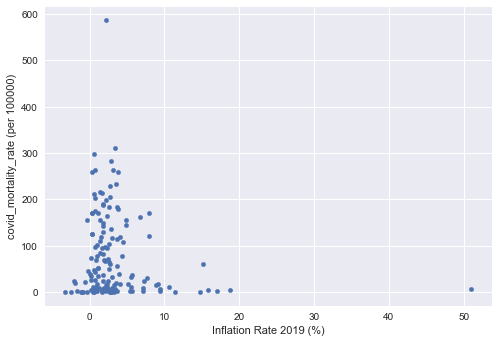

In [168]:
plt.style.use('seaborn')
covidvisual.plot(x='Inflation Rate 2019 (%)', y='covid_mortality_rate (per 100000)', kind='scatter')
plt.show()

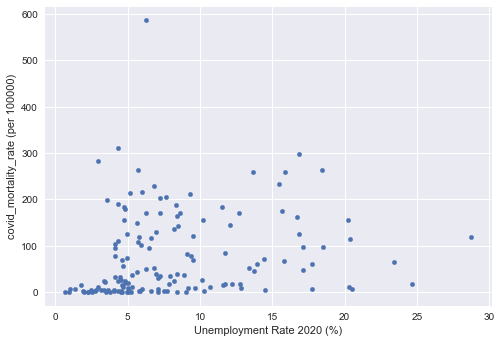

In [169]:
plt.style.use('seaborn')
covidvisual.plot(x='Unemployment Rate 2020 (%)', y='covid_mortality_rate (per 100000)', kind='scatter')
plt.show()

In [170]:
#both inflation rate nor unemployment rate shows correlation with covid death rate, which is a good sign for the instrument
#it has to be correlated with the independent variable HDI and not with the dependent variable covid death rate

In [171]:
px.scatter(covidvisual, x='Inflation Rate 2019 (%)', y='Human Development Index 2019 (HDI)', trendline='ols')

In [172]:
px.scatter(covidvisual, x='Unemployment Rate 2020 (%)', y='Human Development Index 2019 (HDI)', trendline='ols')

In [173]:
#inflation rate will be used as instrument because it shows a correlation (negative) with HDI
#a country with a higher inflation rate tends to present a lower HDI, 
#meanwhile inflation rate is not directly correlated with covid death rate

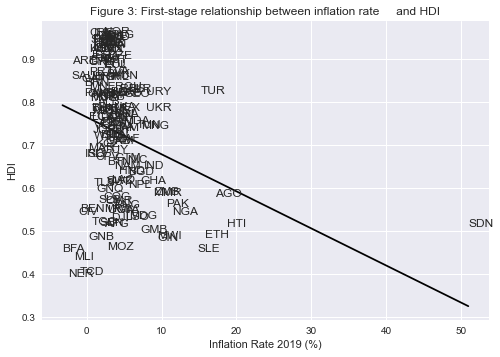

In [174]:
# Dropping NA's is required to use numpy's polyfit
df1_subset2 = covidvisual.dropna(subset=['Inflation Rate 2019 (%)', 'Human Development Index 2019 (HDI)'])

X = df1_subset2['Inflation Rate 2019 (%)']
y = df1_subset2['Human Development Index 2019 (HDI)']
labels = df1_subset2['Country Code']

# Replace markers with country labels
fig, ax = plt.subplots()
ax.scatter(X, y, marker='')

for i, label in enumerate(labels):
    ax.annotate(label, (X.iloc[i], y.iloc[i]))

# Fit a linear trend line
ax.plot(np.unique(X),
         np.poly1d(np.polyfit(X, y, 1))(np.unique(X)),
         color='black')

#ax.set_xlim([1.8,8.4])
#ax.set_ylim([3.3,10.4])
ax.set_xlabel('Inflation Rate 2019 (%)')
ax.set_ylabel('HDI')
ax.set_title('Figure 3: First-stage relationship between inflation rate \
    and HDI')
plt.show()

###### 10.3.1.1 First Stage 

In [175]:
#the first stage involves regressing the endogenous variable (HDIi) on the instrument
#the instrument is the set of all exonegous variables in the model (not just the variable replaced)
#on model 1, the instrument is a constant and inflation rate
#thus, the first-stage regression estimated is

$$ 
HDI_{i} = \delta_{0} + \delta_{1}inflationrate_{i} +v_{i}
$$

In [176]:
covidvisual.head(3)

,Country,Country Code,Latitude,Longitude,HDI rank,Human Development Index 2019 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,...,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop,covid_mortality_rate (per 100000),const
0,Afghanistan,AFG,33.0,65.0,169,0.511,64.83,10.176430,3.930000,2229.362021,...,"43,154","1,124","701,952",39864282,Asia,13,2.0,"1,083",16.749330,1
1,Albania,ALB,41.0,20.0,69,0.795,78.57,14.695620,10.145730,13998.299890,...,355,3,"916,777",2874426,Europe,16,NaN,124,85.477935,1
2,Algeria,DZA,28.0,3.0,91,0.748,76.88,14.604302,7.986548,11173.956810,...,"50,772",37,"230,861",44697286,Africa,34,0.6,"1,136",9.371934,1


In [177]:
# Fit the first stage regression and print summary
results_fs = sm.OLS(covidvisual['Human Development Index 2019 (HDI)'],
                    covidvisual[['const', 'Inflation Rate 2019 (%)']],
                    missing='drop').fit()
print(results_fs.summary())

                                    OLS Regression Results                                    
Dep. Variable:     Human Development Index 2019 (HDI)   R-squared:                       0.092
Model:                                            OLS   Adj. R-squared:                  0.085
Method:                                 Least Squares   F-statistic:                     14.73
Date:                                Fri, 30 Jul 2021   Prob (F-statistic):           0.000184
Time:                                        17:21:35   Log-Likelihood:                 77.141
No. Observations:                                 148   AIC:                            -150.3
Df Residuals:                                     146   BIC:                            -144.3
Df Model:                                           1                                         
Covariance Type:                            nonrobust                                         
                              coef    std err     

###### 10.3.1.2 Second Stage

There's the need to retrieve the predicted values of HDIi using .predict()
then replace the endogenous variable HDIi with the predicted values $ \widehat{HDI_i} $ in the original linear model
the second stage regression is the following:

$$ 
Coviddeathrate_{i} = \beta_{0} + \beta_{1}\widehat{HDI_i} + u_{i}
$$

In [178]:
covidvisual['predicted_HDI'] = results_fs.predict()

results_ss = sm.OLS(covidvisual['covid_mortality_rate (per 100000)'],
                    covidvisual[['const', 'predicted_HDI']], missing = 'drop').fit()
print(results_ss.summary())

                                    OLS Regression Results                                   
Dep. Variable:     covid_mortality_rate (per 100000)   R-squared:                       0.018
Model:                                           OLS   Adj. R-squared:                  0.011
Method:                                Least Squares   F-statistic:                     2.624
Date:                               Fri, 30 Jul 2021   Prob (F-statistic):              0.107
Time:                                       17:21:40   Log-Likelihood:                -864.49
No. Observations:                                146   AIC:                             1733.
Df Residuals:                                    144   BIC:                             1739.
Df Model:                                          1                                         
Covariance Type:                           nonrobust                                         
                    coef    std err          t      P>|t|   

In [179]:
#the second stage results in a p-value that is not statistically significant
#indicating the second-stage regression results does not give an unbiased and conssitent estimate of the effect of 
#HDI on covid death rate, the inflation rate is not a good instrument, and HDI is not endogenous according to the 
#Hausman Test used after the IV2SLS 

In [180]:
covidvisual.head(3)

,Country,Country Code,Latitude,Longitude,HDI rank,Human Development Index 2019 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,...,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop,covid_mortality_rate (per 100000),const,predicted_HDI
0,Afghanistan,AFG,33.0,65.0,169,0.511,64.83,10.176430,3.930000,2229.362021,...,"1,124","701,952",39864282,Asia,13,2.0,"1,083",16.749330,1,0.744655
1,Albania,ALB,41.0,20.0,69,0.795,78.57,14.695620,10.145730,13998.299890,...,3,"916,777",2874426,Europe,16,NaN,124,85.477935,1,0.752333
2,Algeria,DZA,28.0,3.0,91,0.748,76.88,14.604302,7.986548,11173.956810,...,37,"230,861",44697286,Africa,34,0.6,"1,136",9.371934,1,0.747675


In [181]:
iv = IV2SLS(dependent=covidvisual['covid_mortality_rate (per 100000)'],
            exog=covidvisual['const'],
            endog=covidvisual['Human Development Index 2019 (HDI)'],
            instruments=covidvisual['Inflation Rate 2019 (%)']).fit(cov_type='unadjusted')

print(iv.summary)

                                  IV-2SLS Estimation Summary                                 
Dep. Variable:     covid_mortality_rate (per 100000)   R-squared:                      0.2015
Estimator:                                   IV-2SLS   Adj. R-squared:                 0.1959
No. Observations:                                146   F-statistic:                    3.2717
Date:                               Fri, Jul 30 2021   P-value (F-stat)                0.0705
Time:                                       17:21:45   Distribution:                  chi2(1)
Cov. Estimator:                           unadjusted                                         
                                                                                             
                                         Parameter Estimates                                          
                                    Parameter  Std. Err.     T-stat    P-value    Lower CI    Upper CI
------------------------------------------

C:\Users\andre\anaconda3\lib\site-packages\linearmodels\shared\exceptions.py:35: MissingValueWarning:


Inputs contain missing values. Dropping rows with missing observations.



In [182]:
#the p value is not significant meaning the estimates are not consistent nor unbiased, but if it were interpreting the results
#there's the marginal effect of 262.38 to calculate the difference in the hdi index implies difference in covid death rate

##### 10.3.2 Hausman Test

In [183]:
#besides identifying endogeneity by thinking about the data and model, there's a test for endogeneity, it's called Hausman test
#to test the correlation between the endogenous variable, HDIi, and the errors, ui

$$
H_{0}: Cov({HDI_i},u_{i}) = 0 \ (no \ endogeneity) \\
H_{1}: Cov({HDI_i},u_{i}) \neq 0 \ (endogeneity)
$$

In [184]:
#the test is run in two stages
#first regressing the independent variable (HDIi) on the instrument (inflationratei)

$$ 
HDI_{i} = \pi_{0} + \pi_{1}inflationrate_{i} +v_{i}
$$

second retrieving the residuals $ \hat{v_{i}} $ and including them in the original equation

$$ 
Coviddeathrate_{i} = \beta_{0} + \beta_{1}{HDI_i} + \alpha\hat{v_i} + u_{i}
$$

If $\alpha$ is statistically significant (with a p-value < 0.05), then we reject the null hypothesis and conclude that $HDI_{i}$ is endogenous.
Estimating the Hausman Test and interpreting the results

In [185]:
# Estimate the first stage regression
reg1 = sm.OLS(endog=covidvisual['Human Development Index 2019 (HDI)'],
              exog=covidvisual[['const', 'Inflation Rate 2019 (%)']],
              missing='drop').fit()

# Retrieve the residuals
covidvisual['resid'] = reg1.resid

# Estimate the second stage residuals
reg2 = sm.OLS(endog=covidvisual['covid_mortality_rate (per 100000)'],
              exog=covidvisual[['const', 'Human Development Index 2019 (HDI)', 'resid']],
              missing='drop').fit()

print(reg2.summary())

                                    OLS Regression Results                                   
Dep. Variable:     covid_mortality_rate (per 100000)   R-squared:                       0.202
Model:                                           OLS   Adj. R-squared:                  0.191
Method:                                Least Squares   F-statistic:                     18.06
Date:                               Fri, 30 Jul 2021   Prob (F-statistic):           1.01e-07
Time:                                       17:21:55   Log-Likelihood:                -849.36
No. Observations:                                146   AIC:                             1705.
Df Residuals:                                    143   BIC:                             1714.
Df Model:                                          2                                         
Covariance Type:                           nonrobust                                         
                                         coef    std err    

In [186]:
#the output shows that the coefficient on the residuals is not statistically significant, 
#indicating HDIi is not endogenous

#if the coefficient on the residuals were statistically significant, HDIi would be endogenous

#### 10.4 The OLS parameter $\beta$ estimated using matrix algebra and numpy 

In [187]:
#the linear equation to estimate written in matrix form is 

y = X$\beta$ + u

In [188]:
#to solve the unknown parameter B, we want to minimize the sum of squared residuals

${\displaystyle\min_\hat{\beta}} \ \hat{u}' \ \hat{u}$

In [189]:
#isolating u on the first equation and substituting into the second equation

${\displaystyle\min_\hat{\beta}} \ (Y - X \hat{\beta})'(Y - X \hat{\beta})$

optimizing the problem gives the solution for the  $\hat{\beta}$ coefficients

$\hat{\beta} = (X'X)^{-1}X'y$

computing $\hat{\beta}$ from the model using numpy, the results should be the same as using statsmodels

In [190]:
df1 = covidvisual.dropna(subset=['covid_mortality_rate (per 100000)', 'Human Development Index 2019 (HDI)'])
# Define the X and y variables
y = np.asarray(df1['covid_mortality_rate (per 100000)'])
X = np.asarray(df1[['const', 'Human Development Index 2019 (HDI)']])

# Compute β_hat
β_hat = np.linalg.solve(X.T @ X, X.T @ y)

# Print out the results from the 2 x 1 vector β_hat
print(f'β_0 = {β_hat[0]:.2}')
print(f'β_1 = {β_hat[1]:.2}')

β_0 = -1.2e+02
β_1 = 2.7e+02


In [191]:
#exactly the same results

In [192]:
reg1 = sm.OLS(endog=covidvisual['covid_mortality_rate (per 100000)'], exog=covidvisual[['const', 'Human Development Index 2019 (HDI)']], \
    missing='drop')
type(reg1)

results = reg1.fit()
type(results)

print(results.summary())

                                    OLS Regression Results                                   
Dep. Variable:     covid_mortality_rate (per 100000)   R-squared:                       0.202
Model:                                           OLS   Adj. R-squared:                  0.196
Method:                                Least Squares   F-statistic:                     36.38
Date:                               Fri, 30 Jul 2021   Prob (F-statistic):           1.31e-08
Time:                                       17:22:09   Log-Likelihood:                -849.36
No. Observations:                                146   AIC:                             1703.
Df Residuals:                                    144   BIC:                             1709.
Df Model:                                          1                                         
Covariance Type:                           nonrobust                                         
                                         coef    std err    

The intercept $ \hat\beta_{0} = -122.65 $ \
The slope $ \hat\beta_{1} = 270.53 $ 

#### 10.5 Regression Discontinuity Design (RDD)

In [193]:
covidvisual = pd.read_excel('C:/Users/andre/Documents/Programming Languages/Python/pimespython/Project/covidwebscraping/actualcovid19project/covidvisual.xlsx')

In [194]:
covidvisual.head(3)

,Country,Country Code,Latitude,Longitude,HDI rank,Human Development Index 2019 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,...,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop,covid_mortality_rate (per 100000)
0,Afghanistan,AFG,33.0,65.0,169,0.511,64.83,10.176430,3.930000,2229.362021,...,+966,"43,154","1,124","701,952",39864282,Asia,13,2.0,"1,083",16.749330
1,Albania,ALB,41.0,20.0,69,0.795,78.57,14.695620,10.145730,13998.299890,...,+13,355,3,"916,777",2874426,Europe,16,NaN,124,85.477935
2,Algeria,DZA,28.0,3.0,91,0.748,76.88,14.604302,7.986548,11173.956810,...,+807,"50,772",37,"230,861",44697286,Africa,34,0.6,"1,136",9.371934


In [195]:
covidvisual.shape

(148, 43)

In [212]:
pd.set_option('display.max_rows', None)

In [196]:
covidvisual.sort_values(by = 'people_fully_vaccinated_per_hundred', ascending = False)

,Country,Country Code,Latitude,Longitude,HDI rank,Human Development Index 2019 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,...,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop,covid_mortality_rate (per 100000)
85,Malta,MLT,35.8333,14.5833,28,0.895,82.53,16.104070,11.326130,39554.520780,...,+229,"2,456",2,"1,083,490",442804,Europe,215,NaN,"5,546",95.527592
61,Iceland,ISL,65.0000,-18.0000,4,0.949,82.99,19.083090,12.772787,54682.380570,...,+12,966,8,"852,333",343616,Europe,381,NaN,"2,811",8.730676
141,United Arab Emirates,ARE,24.0000,54.0000,31,0.890,77.97,14.344100,12.111220,67462.095300,...,"+1,508","20,679",NaN,"65,324,101",10018287,Asia,155,0.50,"2,064",19.354606
27,Chile,CHL,-30.0000,-71.0000,43,0.851,80.18,16.447550,10.582950,23261.297260,...,"+1,058","9,699","1,516","18,538,716",19291941,South America,71,6.00,503,182.952042
144,Uruguay,URY,-33.0000,-56.0000,55,0.817,77.91,16.835640,8.925730,20063.642220,...,NaN,"2,305",68,"3,039,586",3486636,South America,NaN,NaN,661,170.651597
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2,Algeria,DZA,28.0000,3.0000,91,0.748,76.88,14.604302,7.986548,11173.956810,...,+807,"50,772",37,"230,861",44697286,Africa,34,0.60,"1,136",9.371934
30,Congo,COG,-1.0000,15.0000,149,0.574,64.57,11.726620,6.517171,2879.190985,...,NaN,"1,220",NaN,"158,304",5663010,Africa,NaN,NaN,215,3.125546
32,Côte d'Ivoire,CIV,8.0000,-5.0000,162,0.538,57.78,9.954740,5.288000,5068.606313,...,NaN,409,NaN,"775,631",27075221,Africa,NaN,NaN,15,1.204053
43,Ethiopia,ETH,8.0000,38.0000,173,0.485,66.60,8.813018,2.883189,2206.534378,...,+326,"11,856",228,"3,006,482",118001955,Africa,4,0.04,100,3.712650


In [197]:
covidvisual['people_fully_vaccinated_per_hundred'].mean()

21.121538461538467

In [198]:
covidvisual['people_fully_vaccinated_per_hundred'].median()

13.16

In [199]:
covidvisual['people_fully_vaccinated_per_hundred'].isna().sum()

5

In [200]:
covidvisual['IncomeGroup'].value_counts()

High income            52
Upper middle income    39
Lower middle income    39
Low income             18
Name: IncomeGroup, dtype: int64

In [201]:
covidvisual['people_fully_vaccinated_per_hundred'].mean()

21.121538461538467

In [202]:
covidvisual.groupby(['IncomeGroup'])['people_fully_vaccinated_per_hundred'].mean()

IncomeGroup
High income            42.627692
Low income              0.598125
Lower middle income     7.813333
Upper middle income    13.151026
Name: people_fully_vaccinated_per_hundred, dtype: float64

In [203]:
covidvisual.groupby(['IncomeGroup'])['people_fully_vaccinated_per_hundred'].median()

IncomeGroup
High income            46.335
Low income              0.280
Lower middle income     2.470
Upper middle income    11.850
Name: people_fully_vaccinated_per_hundred, dtype: float64

In [204]:
covidvisual[covidvisual['IncomeGroup']=='High income']

,Country,Country Code,Latitude,Longitude,HDI rank,Human Development Index 2019 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,...,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop,covid_mortality_rate (per 100000)
5,Australia,AUS,-27.0000,133.0000,8,0.944,83.44,21.954330,12.724691,48084.84207,...,NaN,"2,877",59,"24,671,699",25816549,Australia/Oceania,10,0.08,111,3.575226
6,Austria,AUT,47.3333,13.3333,18,0.922,81.54,16.092070,12.546144,56196.89869,...,+349,"5,038",40,"65,725,061",9061466,Europe,56,NaN,556,118.490761
8,Bahamas,BHS,24.2500,-76.0000,58,0.814,73.92,12.899450,11.436920,33747.21264,...,NaN,"1,670",10,"118,017",397267,North America,NaN,NaN,"4,204",71.991885
9,Bahrain,BHR,26.0000,50.5500,42,0.852,77.29,16.254820,9.519200,42521.70451,...,NaN,892,3,"5,405,502",1764527,Asia,NaN,NaN,506,78.377945
11,Barbados,BRB,13.1667,-59.5333,58,0.814,79.19,15.392887,10.642444,14935.90942,...,NaN,149,NaN,"214,259",287752,North America,NaN,NaN,518,16.681031
13,Belgium,BEL,50.8333,4.0000,14,0.931,81.63,19.774380,12.050270,52084.59209,...,NaN,"37,786",94,"17,070,054",11643687,Europe,177,0.09,"3,245",216.692530
20,Brunei Darussalam,BRN,4.5000,114.6667,47,0.838,75.86,14.313910,9.140000,63965.09279,...,NaN,60,NaN,"150,942",441964,Asia,NaN,NaN,136,0.678788
24,Canada,CAN,60.0000,-95.0000,16,0.929,82.43,16.157890,13.366105,48527.03573,...,+259,"5,561",231,"38,351,116",38096547,North America,9,0.08,146,69.751728
27,Chile,CHL,-30.0000,-71.0000,43,0.851,80.18,16.447550,10.582950,23261.29726,...,"+1,058","9,699","1,516","18,538,716",19291941,South America,71,6.00,503,182.952042
33,Croatia,HRV,45.1667,15.5000,43,0.851,78.49,15.226720,11.449320,28069.84837,...,+153,"1,076",12,"2,287,422",4078083,Europe,46,0.20,264,202.300934


In [205]:
len(covidvisual[covidvisual['IncomeGroup']=='High income'])

52

In [206]:
#in order to use RDD let's get the cut off to be around the median of 46 for High Income Group 
#since there's a higher number of observations the high income group, this group will be used cause it has similar characteristics

In [207]:
covidhighincomerdd = covidvisual[covidvisual['IncomeGroup']=='High income']

In [208]:
covidhighincomerdd.head(3)

,Country,Country Code,Latitude,Longitude,HDI rank,Human Development Index 2019 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,...,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop,covid_mortality_rate (per 100000)
5,Australia,AUS,-27.0000,133.0000,8,0.944,83.44,21.95433,12.724691,48084.84207,...,NaN,"2,877",59,"24,671,699",25816549,Australia/Oceania,10,0.08,111,3.575226
6,Austria,AUT,47.3333,13.3333,18,0.922,81.54,16.09207,12.546144,56196.89869,...,+349,"5,038",40,"65,725,061",9061466,Europe,56,NaN,556,118.490761
8,Bahamas,BHS,24.2500,-76.0000,58,0.814,73.92,12.89945,11.436920,33747.21264,...,NaN,"1,670",10,"118,017",397267,North America,NaN,NaN,"4,204",71.991885


In [209]:
covidhighincomerdd.shape

(52, 43)

In [210]:
covidhighincomerdd = covidhighincomerdd.sort_values(by ='people_fully_vaccinated_per_hundred', ascending = False)

In [211]:
covidhighincomerdd = covidhighincomerdd.dropna(subset=['people_fully_vaccinated_per_hundred'])

In [212]:
covidhighincomerdd.shape

(52, 43)

In [213]:
covidhighincomerdd['people_fully_vaccinated_per_hundred'].median() #when the whole code is run again the median of 46.33 will change, because the data will be updated

46.334999999999994

In [214]:
len(covidhighincomerdd[covidhighincomerdd['people_fully_vaccinated_per_hundred'] < 46.33])

26

In [215]:
len(covidhighincomerdd[covidhighincomerdd['people_fully_vaccinated_per_hundred'] > 46.33])

26

In [216]:
#to ilustrate a RDD application the cuttoff will be 46.33 (median) for people fully vaccinated per hundred
#it would be interesting to use the date in which countries started applying the vaccine, but this information in the data 
#is not available, the vaccine application ordered by the government would be an exogenous fact

In [217]:
covidhighincomerdd

,Country,Country Code,Latitude,Longitude,HDI rank,Human Development Index 2019 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,...,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop,covid_mortality_rate (per 100000)
85,Malta,MLT,35.8333,14.5833,28,0.895,82.53,16.104070,11.326130,39554.52078,...,+229,"2,456",2,"1,083,490",442804,Europe,215,NaN,"5,546",95.527592
61,Iceland,ISL,65.0000,-18.0000,4,0.949,82.99,19.083090,12.772787,54682.38057,...,+12,966,8,"852,333",343616,Europe,381,NaN,"2,811",8.730676
141,United Arab Emirates,ARE,24.0000,54.0000,31,0.890,77.97,14.344100,12.111220,67462.09530,...,"+1,508","20,679",NaN,"65,324,101",10018287,Asia,155,0.50,"2,064",19.354606
27,Chile,CHL,-30.0000,-71.0000,43,0.851,80.18,16.447550,10.582950,23261.29726,...,"+1,058","9,699","1,516","18,538,716",19291941,South America,71,6.00,503,182.952042
144,Uruguay,URY,-33.0000,-56.0000,55,0.817,77.91,16.835640,8.925730,20063.64222,...,NaN,"2,305",68,"3,039,586",3486636,South America,NaN,NaN,661,170.651597
66,Israel,ISR,31.5000,34.7500,19,0.919,82.97,16.162830,13.034854,40186.84583,...,"+1,245","15,521",151,"16,371,245",9326000,Asia,195,0.40,"1,664",69.333047
9,Bahrain,BHR,26.0000,50.5500,42,0.852,77.29,16.254820,9.519200,42521.70451,...,NaN,892,3,"5,405,502",1764527,Asia,NaN,NaN,506,78.377945
112,Qatar,QAT,25.5000,51.2500,45,0.848,80.23,12.035950,9.731440,92418.23036,...,+118,"1,810",27,"2,320,721",2807805,Asia,56,NaN,645,21.404620
24,Canada,CAN,60.0000,-95.0000,16,0.929,82.43,16.157890,13.366105,48527.03573,...,+259,"5,561",231,"38,351,116",38096547,North America,9,0.08,146,69.751728
128,Spain,ESP,40.0000,-4.0000,25,0.904,83.57,17.616130,10.251780,40974.52408,...,NaN,"610,295","1,593","55,855,941",46774203,Europe,NaN,NaN,"13,048",174.018999


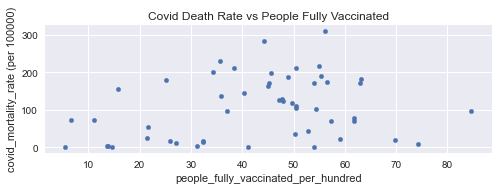

In [218]:
plt.figure(figsize=(8,8))
ax = plt.subplot(3,1,1)
covidhighincomerdd.plot.scatter(x='people_fully_vaccinated_per_hundred', y='covid_mortality_rate (per 100000)', ax=ax)
plt.title('Covid Death Rate vs People Fully Vaccinated');

In [219]:
covidhighincomerdd.rename({'covid_mortality_rate (per 100000)':'coviddeathrate'}, axis = 'columns', inplace = True)

In [220]:
rdd_df = covidhighincomerdd.assign(threshold=(covidhighincomerdd['people_fully_vaccinated_per_hundred'] > 16.55).astype(int))

model = smf.wls('coviddeathrate~people_fully_vaccinated_per_hundred*threshold', rdd_df).fit()

model.summary().tables[1]

,coef,std err,t,P>|t|,[0.025,0.975]
Intercept,11.5734,99.737,0.116,0.908,-188.961,212.108
people_fully_vaccinated_per_hundred,2.7991,8.179,0.342,0.734,-13.646,19.245
threshold,81.5993,108.898,0.749,0.457,-137.354,300.552
people_fully_vaccinated_per_hundred:threshold,-2.3140,8.227,-0.281,0.780,-18.856,14.228


In [221]:
#covid death rate increases by 81.60 (threshold) points with more people fully vaccinated
#people fully vaccinated inscreases the chance of death by 81%
#the p-value is not below 0.01, so it's not statistically significant
#and the right interpretation that would make total sense would be 81% decrease in death rate by people fully vaccinated per hundred above the threshold (46.33) 

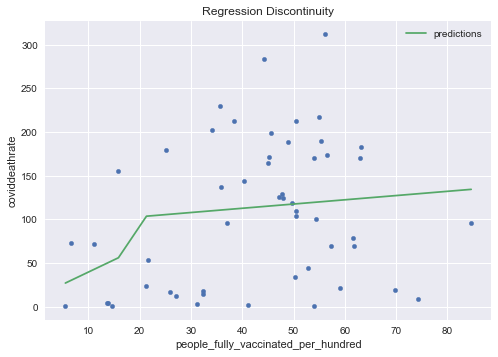

In [222]:
ax = covidhighincomerdd.plot.scatter(x='people_fully_vaccinated_per_hundred', y='coviddeathrate', color='C0')
covidhighincomerdd.assign(predictions=model.fittedvalues).plot(x='people_fully_vaccinated_per_hundred', y='predictions', ax=ax, color='C1')
plt.title('Regression Discontinuity');

In [223]:
#a discontinuity around the threshold is not observed

In [224]:
#another way of doing it would be 

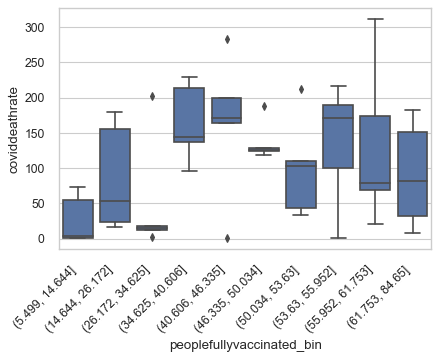

In [225]:
# Create binned peoplefullyvaccinated values
covidhighincomerdd['peoplefullyvaccinated_bin'] = pd.qcut(covidhighincomerdd['people_fully_vaccinated_per_hundred'],10)
covidhighincomerdd['peoplefullyvaccinated_bin'].value_counts()

covidhighincomerdd['over46'] = 0
covidhighincomerdd.loc[covidhighincomerdd['people_fully_vaccinated_per_hundred']>=46.33,'over46'] = 1 
covidhighincomerdd['over46'].value_counts()

# Plot
plt.figure(num=None, figsize=(6, 4), dpi=80, facecolor='w', edgecolor='k')
sns.set(style='whitegrid')
a = sns.boxplot(x='peoplefullyvaccinated_bin', y='coviddeathrate',
              color='b',  data=covidhighincomerdd)
a.set_xticklabels(a.get_xticklabels(), rotation=45, horizontalalignment='right');

In [226]:
re = smf.ols(formula = 'coviddeathrate ~ over46', data = covidhighincomerdd).fit()
print(re.summary())

                            OLS Regression Results                            
Dep. Variable:         coviddeathrate   R-squared:                       0.020
Model:                            OLS   Adj. R-squared:                  0.000
Method:                 Least Squares   F-statistic:                     1.008
Date:                Fri, 30 Jul 2021   Prob (F-statistic):              0.320
Time:                        17:24:01   Log-Likelihood:                -302.53
No. Observations:                  52   AIC:                             609.1
Df Residuals:                      50   BIC:                             613.0
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept     94.9267     16.273      5.834      0.0

In [227]:
#the p-value is not significant, meaning the RDD is not a good choice is this case

Text(0.5, 1.0, 'Regression Discontinuity: Before and After the Cutoff')

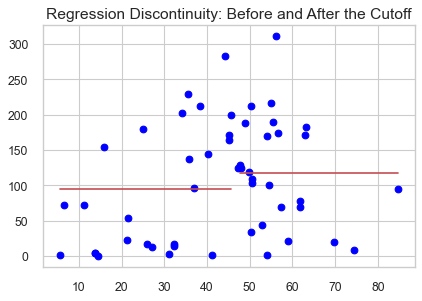

In [228]:
plt.figure(num=None, figsize=(6, 4), dpi=80, facecolor='w', edgecolor='k')
plt.scatter(covidhighincomerdd['people_fully_vaccinated_per_hundred'],covidhighincomerdd['coviddeathrate'], color='blue')
l=covidhighincomerdd.loc[covidhighincomerdd['over46']==0,'over46'].count()
plt.plot(covidhighincomerdd['people_fully_vaccinated_per_hundred'][0:(l-1)], re.predict()[0:(l-1)], '-', color='r')
plt.plot(covidhighincomerdd['people_fully_vaccinated_per_hundred'][l:], re.predict()[l:], '-', color='r')
plt.title('Regression Discontinuity: Before and After the Cutoff', fontsize='14')

In [229]:
#a very slight discontinuity is shown but it's not statistically significant, another model should be used

#### 10.6 Difference-in-Difference (DID)

In [230]:
'''The idea behind DiD is the following: 
The difference in the mean of the outcome between the two groups, treatment group and control group, in the "before" period (A) 
The difference in the mean of the outcome between the two groups, treatment group and control group, in the "after" period (B)
The "second difference", the difference between (A) and (B), which would be (C)
It measures how the change in outcome differs between the two groups, the average effect of treatment on the treated (ATT)
This difference is attributed to the causal effect of the intervention, difference-in-differences (DiD)

So, 
1. The difference in the mean of the outcome between the treatment group and control group
before the intervention (A)
2. The difference in the mean of the outcome between the treatment group and control group
after the intervention (B)
3. The difference between (A) and (B), which is the "second difference", DiD estimate

To do this there are some assumptions that need to be met when designing the treatment and control groups, they are:

1. Parallel trends: the treatment and control groups have parallel trends in the outcome. 
Meaning that in the absence of the intervention, the difference between the treatment and control group is constant over time. 
To see this, a good way is to plot and visually inspect if the parallel trends hold.
2. No spillover effects.
3. The characteristics of the treatment and control groups are stable over the study period.'''

'The idea behind DiD is the following: \nThe difference in the mean of the outcome between the two groups, treatment group and control group, in the "before" period (A) \nThe difference in the mean of the outcome between the two groups, treatment group and control group, in the "after" period (B)\nThe "second difference", the difference between (A) and (B), which would be (C)\nIt measures how the change in outcome differs between the two groups, the average effect of treatment on the treated (ATT)\nThis difference is attributed to the causal effect of the intervention, difference-in-differences (DiD)\n\nSo, \n1. The difference in the mean of the outcome between the treatment group and control group\nbefore the intervention (A)\n2. The difference in the mean of the outcome between the treatment group and control group\nafter the intervention (B)\n3. The difference between (A) and (B), which is the "second difference", DiD estimate\n\nTo do this there are some assumptions that need to be

In [231]:
covidvisual = pd.read_excel('C:/Users/andre/Documents/Programming Languages/Python/pimespython/Project/covidwebscraping/actualcovid19project/covidvisual.xlsx')

In [232]:
pd.set_option('display.max_columns', None)

In [233]:
covidvisual.head()

,Country,Country Code,Latitude,Longitude,HDI rank,Human Development Index 2019 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,GDP 2019 (US$),GDP per capita 2019 (US$),GDP growth 2019 (annual %),Inflation Rate 2019 (%),Unemployment Rate 2020 (%),Region,IncomeGroup,total_vaccinations,date,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop,covid_mortality_rate (per 100000)
0,Afghanistan,AFG,33.0,65.0,169,0.511,64.83,10.176430,3.930000,2229.362021,1.929110e+10,507.103432,3.911603,2.302373,11.730000,South Asia,Low income,1277085,2021-07-27,939835,219159.0,4015.0,22461,3.28,2.41,0.56,577,Afghanistan,"146,523",+527,6677.0,+62,"96,692",+966,"43,154","1,124","701,952",39864282,Asia,13,2.0,"1,083",16.749330
1,Albania,ALB,41.0,20.0,69,0.795,78.57,14.695620,10.145730,13998.299890,1.527918e+10,5353.244856,2.240070,1.411091,11.700000,Europe & Central Asia,Upper middle income,1138771,2021-07-25,640047,498724.0,23655.0,17565,39.57,22.24,17.33,6104,Albania,"132,999",+47,2457.0,NaN,"130,187",+13,355,3,"916,777",2874426,Europe,16,NaN,124,85.477935
2,Algeria,DZA,28.0,3.0,91,0.748,76.88,14.604302,7.986548,11173.956810,1.710913e+11,3973.964072,0.800000,1.951768,12.830000,Middle East & North Africa,Lower middle income,75000,2021-02-19,75000,NaN,30.0,3748,0.17,0.17,NaN,85,Algeria,"168,668","+1,537",4189.0,+28,"113,707",+807,"50,772",37,"230,861",44697286,Africa,34,0.6,"1,136",9.371934
3,Angola,AGO,-12.5,18.5,148,0.581,61.15,11.777202,5.173993,6104.054640,8.881570e+10,2790.726615,-0.624644,17.081215,7.700000,Sub-Saharan Africa,Lower middle income,1592537,2021-07-19,958373,634164.0,NaN,33700,4.85,2.92,1.93,1025,Angola,"42,288",NaN,1000.0,NaN,"35,964",NaN,"5,324",8,"681,443",33955402,Africa,NaN,NaN,157,2.945039
4,Armenia,ARM,40.0,45.0,81,0.776,75.09,13.068610,11.301740,13894.013020,1.367280e+10,4622.733493,7.600000,1.443447,20.209999,Europe & Central Asia,Upper middle income,152529,2021-07-25,108674,43855.0,NaN,3282,5.15,3.67,1.48,1108,Armenia,"229,603",+233,4604.0,+7,"219,502",+123,"5,497",NaN,"1,328,107",2969182,Asia,78,2.0,"1,851",155.059542


In [234]:
#to ilustrate a DiD, the best idea would be to have two different periods in time, for example when the vaccines started being 
#applied. The period would be before the vaccines were applied and after, the treatment group the countries that received 
#the vaccines and the control group the countries that did not receive vaccines. For a good counterfactual countries within 
#the same income group could be chosen as treatment group (the ones that received that vaccines) and the control group 
#the ones that did not receive the vaccines, in this case differences-in-differences-in-differences could be used, since 
#the income groups would be interacted, or just differences-in-dinfferences with a dummy variable for income
#but this is not the case, the data does not have two periods, so to apply the method I'll use 
#the median date, how it is affecting the covid death rate

In [235]:
#there's the need to create the dummies and interaction

In [236]:
covidvisual.sort_values('date', ascending = False)

,Country,Country Code,Latitude,Longitude,HDI rank,Human Development Index 2019 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,GDP 2019 (US$),GDP per capita 2019 (US$),GDP growth 2019 (annual %),Inflation Rate 2019 (%),Unemployment Rate 2020 (%),Region,IncomeGroup,total_vaccinations,date,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop,covid_mortality_rate (per 100000)
147,Zambia,ZMB,-15.0000,30.0000,146,0.584,63.89,11.478083,7.152016,3325.518591,2.330977e+10,1305.063254,1.441785,9.150316,12.17,Sub-Saharan Africa,Lower middle income,400639,2021-07-28,282556,118083.0,28034.0,13814,2.18,1.54,0.64,751,Zambia,"194,140",+708,3355.0,+17,"185,210","+1,253","5,575",468,"2,076,147",18932856,Africa,37,0.90,294,17.720517
43,Ethiopia,ETH,8.0000,38.0000,173,0.485,66.60,8.813018,2.883189,2206.534378,9.591259e+10,855.760862,8.364086,15.840322,2.79,Sub-Saharan Africa,Low income,2197813,2021-07-28,2197813,NaN,59977.0,35777,1.91,1.91,NaN,311,Ethiopia,"279,629",+476,4381.0,+5,"263,392",+326,"11,856",228,"3,006,482",118001955,Africa,4,0.04,100,3.712650
92,Morocco,MAR,32.0000,-5.0000,121,0.686,76.68,13.721170,5.648000,7368.360268,1.197003e+11,3204.095003,2.481905,0.196066,10.15,Middle East & North Africa,Lower middle income,22986926,2021-07-28,12971479,10015447.0,542519.0,259446,62.28,35.14,27.13,7029,Morocco,"606,871","+8,995",9697.0,+32,"552,983","+2,101","44,191",489,"7,515,364",37378784,Africa,241,0.90,"1,182",25.942524
96,Nepal,NPL,28.0000,84.0000,142,0.602,70.78,12.756130,5.014000,3456.706213,3.064138e+10,1071.050761,6.991212,5.568685,4.44,South Asia,Lower middle income,5047355,2021-07-28,3544043,1503312.0,153729.0,111686,17.32,12.16,5.16,3833,Nepal,"690,642","+2,335",9807.0,+16,"650,445","+1,373","30,390",NaN,"3,584,419",29696879,Asia,79,0.50,"1,023",33.023672
50,Germany,DEU,51.0000,9.0000,6,0.947,81.33,16.977190,14.151680,55314.353550,3.861124e+12,46445.249101,0.555451,1.445667,4.31,Europe & Central Asia,High income,90998253,2021-07-28,51007130,42362788.0,1417840.0,868959,108.61,60.88,50.56,10371,Germany,"3,771,050","+1,509",92114.0,+8,"3,650,900","+1,800","28,036",347,"65,845,568",84071162,Europe,18,0.10,333,109.566703
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
72,Kuwait,KWT,29.3375,47.6581,64,0.806,75.49,14.245820,7.275668,58590.082190,1.346285e+11,32000.448469,0.427321,1.091848,6.79,Middle East & North Africa,High income,2375455,2021-07-03,1452148,923307.0,NaN,40778,55.62,34.00,21.62,9549,Kuwait,"395,479",NaN,2303.0,NaN,"380,175",NaN,"13,001",310,"3,365,452",4338120,Asia,NaN,NaN,"2,997",53.087513
94,Myanmar,MMR,22.0000,98.0000,147,0.583,67.13,10.670240,5.034491,4960.528169,7.608585e+10,1407.813143,2.887961,8.825067,1.79,East Asia & Pacific,Lower middle income,3500000,2021-07-01,1840758,1527284.0,3800.0,67615,6.43,3.38,2.81,1243,Myanmar,"289,333","+5,234",8552.0,+342,"202,235","+4,241","78,546",NaN,"3,131,511",54800595,Asia,96,6.00,"1,433",15.605670
81,Madagascar,MDG,-20.0000,47.0000,164,0.528,67.04,10.173920,6.100000,1596.281080,1.411463e+10,523.359064,4.851000,5.610514,1.92,Sub-Saharan Africa,Low income,197001,2021-06-28,197001,NaN,13544.0,10256,0.71,0.71,NaN,370,Madagascar,"42,645",+30,942.0,NaN,"41,109",+18,594,30,"226,580",28450395,Africa,1,NaN,21,3.311026
37,Djibouti,DJI,11.5000,43.0000,166,0.524,67.11,6.791215,4.100000,5689.348966,3.324634e+09,3414.924870,7.770497,3.319254,11.57,Middle East & North Africa,Lower middle income,26796,2021-06-23,12547,8810.0,NaN,802,2.71,

In [237]:
covidvisual['date'].max()

'2021-07-28'

In [238]:
covidvisual['date'].min()

'2021-02-19'

In [239]:
covidvisual['date'].astype('datetime64[ns]').quantile(0.5, interpolation='midpoint')

Timestamp('2021-07-27 00:00:00')

In [240]:
covidvisual.dtypes

Country                                    object
Country Code                               object
Latitude                                  float64
Longitude                                 float64
HDI rank                                    int64
Human Development Index 2019 (HDI)        float64
Life expectancy at birth                  float64
Expected years of schooling               float64
Mean years of schooling                   float64
Gross national income (GNI) per capita    float64
GDP 2019 (US$)                            float64
GDP per capita 2019 (US$)                 float64
GDP growth 2019 (annual %)                float64
Inflation Rate 2019 (%)                   float64
Unemployment Rate 2020 (%)                float64
Region                                     object
IncomeGroup                                object
total_vaccinations                          int64
date                                       object
people_vaccinated                           int64


In [241]:
#covidvisual['date'] = pd.to_datetime(covidvisual['date']) it's better not to convert to timestamp

In [242]:
covidvisual['date'].describe()

count            148
unique            18
top       2021-07-28
freq              58
Name: date, dtype: object

In [243]:
#covidvisual['date'].median() #this works when converted to timestamp 
#the median Timestamp('2021-07-27 00:00:00') will change when the code is run again with the data updated

In [244]:
covidvisual['people_fully_vaccinated_per_hundred'].describe()

count    143.000000
mean      21.121538
std       21.605296
min        0.000000
25%        2.070000
50%       13.160000
75%       38.050000
max       84.650000
Name: people_fully_vaccinated_per_hundred, dtype: float64

In [245]:
covidvisual['date']

0      2021-07-27
1      2021-07-25
2      2021-02-19
3      2021-07-19
4      2021-07-25
          ...    
143    2021-07-28
144    2021-07-28
145    2021-07-27
146    2021-07-28
147    2021-07-28
Name: date, Length: 148, dtype: object

In [246]:
len(covidvisual[covidvisual['date'] < '2021-07-27'])

58

In [247]:
len(covidvisual[covidvisual['date'] > '2021-07-27'])

58

In [248]:
len(covidvisual[covidvisual['date'] == '2021-07-27'])

32

In [249]:
#I'll choose two periods, before 2021-07-27 and after, for treatment and control 
#in the low income group the treatment for the countries who received the vaccines (18 countries), and as control 
#the countries who did not receive the vaccines

In [250]:
covidvisual['IncomeGroup']

0               Low income
1      Upper middle income
2      Lower middle income
3      Lower middle income
4      Upper middle income
              ...         
143            High income
144            High income
145    Lower middle income
146    Lower middle income
147    Lower middle income
Name: IncomeGroup, Length: 148, dtype: object

In [251]:
len(covidvisual[covidvisual['IncomeGroup']=='Low income'])

18

In [252]:
(covidvisual[covidvisual['IncomeGroup']=='Low income']).isna().sum()

Country                                    0
Country Code                               0
Latitude                                   0
Longitude                                  0
HDI rank                                   0
Human Development Index 2019 (HDI)         0
Life expectancy at birth                   0
Expected years of schooling                0
Mean years of schooling                    0
Gross national income (GNI) per capita     0
GDP 2019 (US$)                             0
GDP per capita 2019 (US$)                  0
GDP growth 2019 (annual %)                 0
Inflation Rate 2019 (%)                    0
Unemployment Rate 2020 (%)                 0
Region                                     0
IncomeGroup                                0
total_vaccinations                         0
date                                       0
people_vaccinated                          0
people_fully_vaccinated                    2
daily_vaccinations_raw                     8
daily_vacc

In [253]:
pd.set_option('display.max_columns', None)

In [254]:
covidlowincome = covidvisual[covidvisual['IncomeGroup']=='Low income']

In [255]:
covidlowincome.head(3)

,Country,Country Code,Latitude,Longitude,HDI rank,Human Development Index 2019 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,GDP 2019 (US$),GDP per capita 2019 (US$),GDP growth 2019 (annual %),Inflation Rate 2019 (%),Unemployment Rate 2020 (%),Region,IncomeGroup,total_vaccinations,date,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop,covid_mortality_rate (per 100000)
0,Afghanistan,AFG,33.0,65.0,169,0.511,64.83,10.17643,3.930000,2229.362021,1.929110e+10,507.103432,3.911603,2.302373,11.73,South Asia,Low income,1277085,2021-07-27,939835,219159.0,4015.0,22461,3.28,2.41,0.56,577,Afghanistan,"146,523",+527,6677.0,+62,"96,692",+966,"43,154","1,124","701,952",39864282,Asia,13,2.0,"1,083",16.749330
22,Burkina Faso,BFA,13.0,-2.0,182,0.452,61.58,9.27373,1.644299,2132.955570,1.599080e+10,786.895631,5.699435,-3.233389,4.96,Sub-Saharan Africa,Low income,37120,2021-07-24,34749,2371.0,NaN,1825,0.18,0.17,0.01,87,Burkina Faso,"13,560",NaN,169.0,NaN,"13,361",NaN,30,NaN,"202,591",21514446,Africa,NaN,NaN,1,0.785519
26,Chad,TCD,15.0,19.0,187,0.398,54.24,7.34935,2.523680,1555.373575,1.131495e+10,709.540310,3.247182,-0.971939,2.26,Sub-Saharan Africa,Low income,28810,2021-07-21,21581,7229.0,NaN,1329,0.18,0.13,0.04,81,Chad,"4,972",NaN,174.0,NaN,"4,789",NaN,9,NaN,"130,796",16928283,Africa,NaN,NaN,0.5,1.027866


In [256]:
covidlowincome['people_fully_vaccinated_per_hundred'].fillna(0).apply(np.ceil).astype(int)

0      1
22     1
26     1
43     0
48     1
54     3
55     1
57     0
81     0
82     1
84     1
93     2
100    1
115    2
122    1
130    1
136    2
139    1
Name: people_fully_vaccinated_per_hundred, dtype: int32

In [257]:
covidlowincome['people_fully_vaccinated_per_hundred']=covidlowincome['people_fully_vaccinated_per_hundred'].fillna(0).apply(np.ceil).astype(int)

<ipython-input-257-9074147ca381>:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [258]:
covidlowincome['people_fully_vaccinated_per_hundred']

0      1
22     1
26     1
43     0
48     1
54     3
55     1
57     0
81     0
82     1
84     1
93     2
100    1
115    2
122    1
130    1
136    2
139    1
Name: people_fully_vaccinated_per_hundred, dtype: int32

In [259]:
covidlowincome.head(3)

,Country,Country Code,Latitude,Longitude,HDI rank,Human Development Index 2019 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,GDP 2019 (US$),GDP per capita 2019 (US$),GDP growth 2019 (annual %),Inflation Rate 2019 (%),Unemployment Rate 2020 (%),Region,IncomeGroup,total_vaccinations,date,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop,covid_mortality_rate (per 100000)
0,Afghanistan,AFG,33.0,65.0,169,0.511,64.83,10.17643,3.930000,2229.362021,1.929110e+10,507.103432,3.911603,2.302373,11.73,South Asia,Low income,1277085,2021-07-27,939835,219159.0,4015.0,22461,3.28,2.41,1,577,Afghanistan,"146,523",+527,6677.0,+62,"96,692",+966,"43,154","1,124","701,952",39864282,Asia,13,2.0,"1,083",16.749330
22,Burkina Faso,BFA,13.0,-2.0,182,0.452,61.58,9.27373,1.644299,2132.955570,1.599080e+10,786.895631,5.699435,-3.233389,4.96,Sub-Saharan Africa,Low income,37120,2021-07-24,34749,2371.0,NaN,1825,0.18,0.17,1,87,Burkina Faso,"13,560",NaN,169.0,NaN,"13,361",NaN,30,NaN,"202,591",21514446,Africa,NaN,NaN,1,0.785519
26,Chad,TCD,15.0,19.0,187,0.398,54.24,7.34935,2.523680,1555.373575,1.131495e+10,709.540310,3.247182,-0.971939,2.26,Sub-Saharan Africa,Low income,28810,2021-07-21,21581,7229.0,NaN,1329,0.18,0.13,1,81,Chad,"4,972",NaN,174.0,NaN,"4,789",NaN,9,NaN,"130,796",16928283,Africa,NaN,NaN,0.5,1.027866


In [260]:
covidvisualdummies = pd.get_dummies(covidlowincome, columns=['IncomeGroup', 'Continent']) #drop_first = True)

In [261]:
covidvisualdummies.shape

(18, 45)

In [262]:
covidvisualdummies.head(3)

,Country,Country Code,Latitude,Longitude,HDI rank,Human Development Index 2019 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,GDP 2019 (US$),GDP per capita 2019 (US$),GDP growth 2019 (annual %),Inflation Rate 2019 (%),Unemployment Rate 2020 (%),Region,total_vaccinations,date,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop,covid_mortality_rate (per 100000),IncomeGroup_Low income,Continent_Africa,Continent_Asia,Continent_North America
0,Afghanistan,AFG,33.0,65.0,169,0.511,64.83,10.17643,3.930000,2229.362021,1.929110e+10,507.103432,3.911603,2.302373,11.73,South Asia,1277085,2021-07-27,939835,219159.0,4015.0,22461,3.28,2.41,1,577,Afghanistan,"146,523",+527,6677.0,+62,"96,692",+966,"43,154","1,124","701,952",39864282,13,2.0,"1,083",16.749330,1,0,1,0
22,Burkina Faso,BFA,13.0,-2.0,182,0.452,61.58,9.27373,1.644299,2132.955570,1.599080e+10,786.895631,5.699435,-3.233389,4.96,Sub-Saharan Africa,37120,2021-07-24,34749,2371.0,NaN,1825,0.18,0.17,1,87,Burkina Faso,"13,560",NaN,169.0,NaN,"13,361",NaN,30,NaN,"202,591",21514446,NaN,NaN,1,0.785519,1,1,0,0
26,Chad,TCD,15.0,19.0,187,0.398,54.24,7.34935,2.523680,1555.373575,1.131495e+10,709.540310,3.247182,-0.971939,2.26,Sub-Saharan Africa,28810,2021-07-21,21581,7229.0,NaN,1329,0.18,0.13,1,81,Chad,"4,972",NaN,174.0,NaN,"4,789",NaN,9,NaN,"130,796",16928283,NaN,NaN,0.5,1.027866,1,1,0,0


In [263]:
covidvisualdummies.sort_values('date', ascending = False)

,Country,Country Code,Latitude,Longitude,HDI rank,Human Development Index 2019 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,GDP 2019 (US$),GDP per capita 2019 (US$),GDP growth 2019 (annual %),Inflation Rate 2019 (%),Unemployment Rate 2020 (%),Region,total_vaccinations,date,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop,covid_mortality_rate (per 100000),IncomeGroup_Low income,Continent_Africa,Continent_Asia,Continent_North America
139,Uganda,UGA,1.0000,32.0000,159,0.544,63.37,11.412656,6.171952,2123.269350,3.516516e+10,794.341078,6.803327,2.869094,2.440000,Sub-Saharan Africa,1135036,2021-07-28,1135036,4129.0,51433.0,29315,2.48,2.48,1,641,Uganda,"93,282",+160,2632.0,+27,"81,014","+1,210","9,636",620,"1,461,319",47279712,3,0.60,204,5.566870,1,1,0,0
43,Ethiopia,ETH,8.0000,38.0000,173,0.485,66.60,8.813018,2.883189,2206.534378,9.591259e+10,855.760862,8.364086,15.840322,2.790000,Sub-Saharan Africa,2197813,2021-07-28,2197813,NaN,59977.0,35777,1.91,1.91,0,311,Ethiopia,"279,629",+476,4381.0,+5,"263,392",+326,"11,856",228,"3,006,482",118001955,4,0.04,100,3.712650,1,1,0,0
57,Haiti,HTI,19.0000,-72.4167,170,0.510,64.00,9.700000,5.592370,1708.809043,1.433216e+10,1272.490925,-1.681985,18.703783,14.500000,Latin America & Caribbean,4078,2021-07-27,4078,341.0,709.0,401,0.04,0.04,0,35,Haiti,"20,077",NaN,545.0,NaN,"13,951",NaN,"5,581",NaN,"99,119",11551283,NaN,NaN,483,4.718091,1,0,0,1
0,Afghanistan,AFG,33.0000,65.0000,169,0.511,64.83,10.176430,3.930000,2229.362021,1.929110e+10,507.103432,3.911603,2.302373,11.730000,South Asia,1277085,2021-07-27,939835,219159.0,4015.0,22461,3.28,2.41,1,577,Afghanistan,"146,523",+527,6677.0,+62,"96,692",+966,"43,154","1,124","701,952",39864282,13,2.00,"1,083",16.749330,1,0,1,0
82,Malawi,MWI,-13.5000,34.0000,174,0.483,64.26,11.241910,4.730000,1034.677638,7.666704e+09,411.552340,4.369239,9.370836,5.990000,Sub-Saharan Africa,448408,2021-07-27,390738,57670.0,19419.0,13108,2.34,2.04,1,685,Malawi,"50,381",NaN,1561.0,NaN,"37,196",NaN,"11,624",285,"330,033",19657242,NaN,NaN,591,7.941094,1,1,0,0
93,Mozambique,MOZ,-18.2500,35.0000,181,0.456,60.85,9.974020,3.540898,1250.405688,1.529145e+10,503.570773,2.283597,2.781106,3.390000,Sub-Saharan Africa,691040,2021-07-26,372085,318955.0,NaN,11654,2.21,1.19,2,373,Mozambique,"117,660","+1,774",1388.0,+21,"87,256",+833,"29,016",32,"725,363",32189003,55,0.70,901,4.312032,1,1,0,0
54,Guinea,GIN,11.0000,-10.0000,178,0.477,61.60,9.408505,2.774225,2405.181497,1.229667e+10,962.839909,5.600000,9.470779,4.350000,Sub-Saharan Africa,799884,2021-07-25,513637,286247.0,128912.0,25420,6.09,3.91,3,1936,Guinea,"25,401",+108,211.0,+3,"24,071",+47,"1,119",24,"494,239",13512653,8,0.20,83,1.561499,1,1,0,0
22,Burkina Faso,BFA,13.0000,-2.0000,182,0.452,61.58,9.273730,1.644299,2132.955570,1.599080e+10,786.895631,5.699435,-3.233389,4.960000,Sub-Saharan Africa,37120,2021-07-24,34749,2371.0,NaN,1825,0.18,0.17,1,87,Burkina Faso,"13,560",NaN,169.0,NaN,"13,361",NaN,30,NaN,"202,591",21514446,NaN,NaN,1,0.785519,1,1,0,0
115,Rwanda,RWA,-2.0000,30.0000,160,0.543,69.02,11.186660,4.417151,2155.334054,1.035442e+10,820.025242,9.428675,3.347877,1.350000,Sub-Saharan Africa,646909,2021-07-23,423182,252842.0,83842.0,24860,4.99,3.27,2,1919,Rwanda,"67,902",NaN,776.0,NaN,"44,791",NaN,"22,335",61,"2,046,754",13294788,NaN,NaN,"1,680",5.836874,1,1,0,0
26,Chad,TCD,15.0000,19.0000,187,0.398,54.24,7.349350,2.523680,1555.373575,1.131495e+10,709.540310,3.247182,-0.971939,2.260000,Sub-Saharan Africa,28810,2021-07-21,21581,7229.0,NaN,1329,0.18,0.13,1,81,Chad,"4,972",NaN,174.0,NaN,"4,789",NaN,9,NaN,"130,796",1692828

In [264]:
covidvisualdummies.dtypes

Country                                    object
Country Code                               object
Latitude                                  float64
Longitude                                 float64
HDI rank                                    int64
Human Development Index 2019 (HDI)        float64
Life expectancy at birth                  float64
Expected years of schooling               float64
Mean years of schooling                   float64
Gross national income (GNI) per capita    float64
GDP 2019 (US$)                            float64
GDP per capita 2019 (US$)                 float64
GDP growth 2019 (annual %)                float64
Inflation Rate 2019 (%)                   float64
Unemployment Rate 2020 (%)                float64
Region                                     object
total_vaccinations                          int64
date                                       object
people_vaccinated                           int64
people_fully_vaccinated                   float64


In [265]:
covidvisualdummies['date'] = covidvisualdummies['date'].str.replace('-','')

In [266]:
covidvisualdummies

,Country,Country Code,Latitude,Longitude,HDI rank,Human Development Index 2019 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,GDP 2019 (US$),GDP per capita 2019 (US$),GDP growth 2019 (annual %),Inflation Rate 2019 (%),Unemployment Rate 2020 (%),Region,total_vaccinations,date,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop,covid_mortality_rate (per 100000),IncomeGroup_Low income,Continent_Africa,Continent_Asia,Continent_North America
0,Afghanistan,AFG,33.0000,65.0000,169,0.511,64.83,10.176430,3.930000,2229.362021,1.929110e+10,507.103432,3.911603,2.302373,11.730000,South Asia,1277085,20210727,939835,219159.0,4015.0,22461,3.28,2.41,1,577,Afghanistan,"146,523",+527,6677.0,+62,"96,692",+966,"43,154","1,124","701,952",39864282,13,2.00,"1,083",16.749330,1,0,1,0
22,Burkina Faso,BFA,13.0000,-2.0000,182,0.452,61.58,9.273730,1.644299,2132.955570,1.599080e+10,786.895631,5.699435,-3.233389,4.960000,Sub-Saharan Africa,37120,20210724,34749,2371.0,NaN,1825,0.18,0.17,1,87,Burkina Faso,"13,560",NaN,169.0,NaN,"13,361",NaN,30,NaN,"202,591",21514446,NaN,NaN,1,0.785519,1,1,0,0
26,Chad,TCD,15.0000,19.0000,187,0.398,54.24,7.349350,2.523680,1555.373575,1.131495e+10,709.540310,3.247182,-0.971939,2.260000,Sub-Saharan Africa,28810,20210721,21581,7229.0,NaN,1329,0.18,0.13,1,81,Chad,"4,972",NaN,174.0,NaN,"4,789",NaN,9,NaN,"130,796",16928283,NaN,NaN,0.5,1.027866,1,1,0,0
43,Ethiopia,ETH,8.0000,38.0000,173,0.485,66.60,8.813018,2.883189,2206.534378,9.591259e+10,855.760862,8.364086,15.840322,2.790000,Sub-Saharan Africa,2197813,20210728,2197813,NaN,59977.0,35777,1.91,1.91,0,311,Ethiopia,"279,629",+476,4381.0,+5,"263,392",+326,"11,856",228,"3,006,482",118001955,4,0.04,100,3.712650,1,1,0,0
48,Gambia,GMB,13.4667,-16.5667,172,0.496,62.05,9.911519,3.922000,2167.883472,1.826074e+09,777.811932,6.056766,7.115676,9.640000,Sub-Saharan Africa,43557,20210715,31254,12303.0,NaN,1458,1.80,1.29,1,603,Gambia,"7,709",NaN,212.0,NaN,"6,600",NaN,897,3,"91,290",2489049,NaN,NaN,360,8.517309,1,1,0,0
54,Guinea,GIN,11.0000,-10.0000,178,0.477,61.60,9.408505,2.774225,2405.181497,1.229667e+10,962.839909,5.600000,9.470779,4.350000,Sub-Saharan Africa,799884,20210725,513637,286247.0,128912.0,25420,6.09,3.91,3,1936,Guinea,"25,401",+108,211.0,+3,"24,071",+47,"1,119",24,"494,239",13512653,8,0.20,83,1.561499,1,1,0,0
55,Guinea-Bissau,GNB,12.0000,-15.0000,175,0.480,58.32,10.623850,3.562600,1996.042927,1.339449e+09,697.294927,4.600094,0.246600,3.160000,Sub-Saharan Africa,25225,20210719,24000,1225.0,NaN,475,1.28,1.22,1,241,Guinea-Bissau,"4,334",NaN,74.0,NaN,"3,854",NaN,406,4,"79,988",2017643,NaN,NaN,201,3.667646,1,1,0,0
57,Haiti,HTI,19.0000,-72.4167,170,0.510,64.00,9.700000,5.592370,1708.809043,1.433216e+10,1272.490925,-1.681985,18.703783,14.500000,Latin America & Caribbean,4078,20210727,4078,341.0,709.0,401,0.04,0.04,0,35,Haiti,"20,077",NaN,545.0,NaN,"13,951",NaN,"5,581",NaN,"99,119",11551283,NaN,NaN,483,4.718091,1,0,0,1
81,Madagascar,MDG,-20.0000,47.0000,164,0.528,67.04,10.173920,6.100000,1596.281080,1.411463e+10,523.359064,4.851000,5.610514,1.920000,Sub-Saharan Africa,197001,20210628,197001,NaN,13544.0,10256,0.71,0.71,0,370,Madagascar,"42,645",+30,942.0,NaN,"41,109",+18,594,30,"226,580",28450395,1,NaN,21,3.311026,1,1,0,0
82,Malawi,MWI,-13.5000,34.0000,174,0.483,64.26,11.241910,4.730000,1034.677638,7.666704e+09,411.552340,4.369239,9.370836,5.990000,Sub-Saharan Africa,448408,20210727,390738,57670.0,19419.0,13108,2.34,2.04,1,685,Malawi,"50,381",NaN,1561.0,NaN,"37,196",NaN,"11,624",285,"330,033",19657242,NaN,NaN,591,7.941094,1,1,0,0


In [267]:
covidvisualdummies.sort_values(by = 'date', ascending = False, inplace = True)

In [268]:
covidvisualdummies

,Country,Country Code,Latitude,Longitude,HDI rank,Human Development Index 2019 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,GDP 2019 (US$),GDP per capita 2019 (US$),GDP growth 2019 (annual %),Inflation Rate 2019 (%),Unemployment Rate 2020 (%),Region,total_vaccinations,date,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop,covid_mortality_rate (per 100000),IncomeGroup_Low income,Continent_Africa,Continent_Asia,Continent_North America
139,Uganda,UGA,1.0000,32.0000,159,0.544,63.37,11.412656,6.171952,2123.269350,3.516516e+10,794.341078,6.803327,2.869094,2.440000,Sub-Saharan Africa,1135036,20210728,1135036,4129.0,51433.0,29315,2.48,2.48,1,641,Uganda,"93,282",+160,2632.0,+27,"81,014","+1,210","9,636",620,"1,461,319",47279712,3,0.60,204,5.566870,1,1,0,0
43,Ethiopia,ETH,8.0000,38.0000,173,0.485,66.60,8.813018,2.883189,2206.534378,9.591259e+10,855.760862,8.364086,15.840322,2.790000,Sub-Saharan Africa,2197813,20210728,2197813,NaN,59977.0,35777,1.91,1.91,0,311,Ethiopia,"279,629",+476,4381.0,+5,"263,392",+326,"11,856",228,"3,006,482",118001955,4,0.04,100,3.712650,1,1,0,0
57,Haiti,HTI,19.0000,-72.4167,170,0.510,64.00,9.700000,5.592370,1708.809043,1.433216e+10,1272.490925,-1.681985,18.703783,14.500000,Latin America & Caribbean,4078,20210727,4078,341.0,709.0,401,0.04,0.04,0,35,Haiti,"20,077",NaN,545.0,NaN,"13,951",NaN,"5,581",NaN,"99,119",11551283,NaN,NaN,483,4.718091,1,0,0,1
0,Afghanistan,AFG,33.0000,65.0000,169,0.511,64.83,10.176430,3.930000,2229.362021,1.929110e+10,507.103432,3.911603,2.302373,11.730000,South Asia,1277085,20210727,939835,219159.0,4015.0,22461,3.28,2.41,1,577,Afghanistan,"146,523",+527,6677.0,+62,"96,692",+966,"43,154","1,124","701,952",39864282,13,2.00,"1,083",16.749330,1,0,1,0
82,Malawi,MWI,-13.5000,34.0000,174,0.483,64.26,11.241910,4.730000,1034.677638,7.666704e+09,411.552340,4.369239,9.370836,5.990000,Sub-Saharan Africa,448408,20210727,390738,57670.0,19419.0,13108,2.34,2.04,1,685,Malawi,"50,381",NaN,1561.0,NaN,"37,196",NaN,"11,624",285,"330,033",19657242,NaN,NaN,591,7.941094,1,1,0,0
93,Mozambique,MOZ,-18.2500,35.0000,181,0.456,60.85,9.974020,3.540898,1250.405688,1.529145e+10,503.570773,2.283597,2.781106,3.390000,Sub-Saharan Africa,691040,20210726,372085,318955.0,NaN,11654,2.21,1.19,2,373,Mozambique,"117,660","+1,774",1388.0,+21,"87,256",+833,"29,016",32,"725,363",32189003,55,0.70,901,4.312032,1,1,0,0
54,Guinea,GIN,11.0000,-10.0000,178,0.477,61.60,9.408505,2.774225,2405.181497,1.229667e+10,962.839909,5.600000,9.470779,4.350000,Sub-Saharan Africa,799884,20210725,513637,286247.0,128912.0,25420,6.09,3.91,3,1936,Guinea,"25,401",+108,211.0,+3,"24,071",+47,"1,119",24,"494,239",13512653,8,0.20,83,1.561499,1,1,0,0
22,Burkina Faso,BFA,13.0000,-2.0000,182,0.452,61.58,9.273730,1.644299,2132.955570,1.599080e+10,786.895631,5.699435,-3.233389,4.960000,Sub-Saharan Africa,37120,20210724,34749,2371.0,NaN,1825,0.18,0.17,1,87,Burkina Faso,"13,560",NaN,169.0,NaN,"13,361",NaN,30,NaN,"202,591",21514446,NaN,NaN,1,0.785519,1,1,0,0
115,Rwanda,RWA,-2.0000,30.0000,160,0.543,69.02,11.186660,4.417151,2155.334054,1.035442e+10,820.025242,9.428675,3.347877,1.350000,Sub-Saharan Africa,646909,20210723,423182,252842.0,83842.0,24860,4.99,3.27,2,1919,Rwanda,"67,902",NaN,776.0,NaN,"44,791",NaN,"22,335",61,"2,046,754",13294788,NaN,NaN,"1,680",5.836874,1,1,0,0
26,Chad,TCD,15.0000,19.0000,187,0.398,54.24,7.349350,2.523680,1555.373575,1.131495e+10,709.540310,3.247182,-0.971939,2.260000,Sub-Saharan Africa,28810,20210721,21581,7229.0,NaN,1329,0.18,0.13,1,81,Chad,"4,972",NaN,174.0,NaN,"4,789",NaN,9,NaN,"130,796",16928283,NaN,NaN,0.5,1.0278

In [269]:
len(covidvisualdummies['date'])//2

9

In [270]:
covidvisualdummies['date'].iloc[9]

'20210721'

In [271]:
covidvisualdummies['date'] = covidvisualdummies['date'].astype(int)

In [272]:
covidvisualdummies[covidvisualdummies['date'] < 20210721] 

,Country,Country Code,Latitude,Longitude,HDI rank,Human Development Index 2019 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,GDP 2019 (US$),GDP per capita 2019 (US$),GDP growth 2019 (annual %),Inflation Rate 2019 (%),Unemployment Rate 2020 (%),Region,total_vaccinations,date,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop,covid_mortality_rate (per 100000),IncomeGroup_Low income,Continent_Africa,Continent_Asia,Continent_North America
55,Guinea-Bissau,GNB,12.0000,-15.0000,175,0.480,58.32,10.623850,3.562600,1996.042927,1.339449e+09,697.294927,4.600094,0.246600,3.160000,Sub-Saharan Africa,25225,20210719,24000,1225.0,NaN,475,1.28,1.22,1,241,Guinea-Bissau,"4,334",NaN,74.0,NaN,"3,854",NaN,406,4,"79,988",2017643,NaN,NaN,201,3.667646,1,1,0,0
136,Togo,TGO,8.0000,1.1667,167,0.515,61.04,12.664980,4.949926,1602.349340,5.490272e+09,679.290249,5.338670,0.685898,4.050000,Sub-Saharan Africa,454208,20210719,304278,149930.0,NaN,10051,5.49,3.68,2,1214,Togo,"15,393",NaN,150.0,NaN,"14,272",NaN,971,NaN,"399,464",8485815,NaN,NaN,114,1.767656,1,1,0,0
130,Sudan,SDN,15.0000,30.0000,170,0.510,65.31,7.884416,3.770000,3828.660219,3.051346e+10,441.505603,-2.503537,50.994052,17.709999,Sub-Saharan Africa,810560,20210718,627833,182727.0,20715.0,14177,1.85,1.43,1,323,Sudan,"37,138",NaN,2776.0,NaN,"30,867",NaN,"3,495",NaN,"234,414",44942013,NaN,NaN,78,6.176848,1,1,0,0
48,Gambia,GMB,13.4667,-16.5667,172,0.496,62.05,9.911519,3.922000,2167.883472,1.826074e+09,777.811932,6.056766,7.115676,9.640000,Sub-Saharan Africa,43557,20210715,31254,12303.0,NaN,1458,1.80,1.29,1,603,Gambia,"7,709",NaN,212.0,NaN,"6,600",NaN,897,3,"91,290",2489049,NaN,NaN,360,8.517309,1,1,0,0
84,Mali,MLI,17.0000,-4.0000,184,0.434,59.31,7.461030,2.352954,2268.772780,1.727957e+10,879.008010,4.751342,-1.658267,7.500000,Sub-Saharan Africa,196862,20210712,145016,51846.0,NaN,4197,0.97,0.72,1,207,Mali,"14,566",+3,531.0,NaN,"13,939",+5,96,NaN,"342,097",20872563,0.1,NaN,5,2.544010,1,1,0,0
100,Niger,NER,16.0000,8.0000,189,0.394,62.42,6.471450,2.079049,1200.898463,1.291169e+10,553.895050,5.902792,-2.489793,0.690000,Sub-Saharan Africa,423335,20210705,363018,60317.0,NaN,15250,1.75,1.50,1,630,Niger,"5,607",+3,195.0,NaN,"5,330",+26,82,2,"128,595",25138940,0.1,NaN,3,0.775689,1,1,0,0
122,Sierra Leone,SLE,8.5000,-11.5000,182,0.452,54.70,10.175930,3.700000,1667.844447,4.121734e+09,527.533634,5.507686,14.803059,4.600000,Sub-Saharan Africa,225380,20210705,82145,15170.0,6053.0,8538,2.83,1.03,1,1070,Sierra Leone,"6,268",+18,120.0,+1,"4,258",+17,"1,890",NaN,"160,358",8150252,2,0.1,232,1.472347,1,1,0,0
81,Madagascar,MDG,-20.0000,47.0000,164,0.528,67.04,10.173920,6.100000,1596.281080,1.411463e+10,523.359064,4.851000,5.610514,1.920000,Sub-Saharan Africa,197001,20210628,197001,NaN,13544.0,10256,0.71,0.71,0,370,Madagascar,"42,645",+30,942.0,NaN,"41,109",+18,594,30,"226,580",28450395,1,NaN,21,3.311026,1,1,0,0


In [273]:
covidvisualdummies.loc[covidvisualdummies['date'] < 20210721, 'date'] = 0
covidvisualdummies.loc[covidvisualdummies['date'] >= 20210721, 'date'] = 1 

In [274]:
covidvisualdummies

,Country,Country Code,Latitude,Longitude,HDI rank,Human Development Index 2019 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,GDP 2019 (US$),GDP per capita 2019 (US$),GDP growth 2019 (annual %),Inflation Rate 2019 (%),Unemployment Rate 2020 (%),Region,total_vaccinations,date,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop,covid_mortality_rate (per 100000),IncomeGroup_Low income,Continent_Africa,Continent_Asia,Continent_North America
139,Uganda,UGA,1.0000,32.0000,159,0.544,63.37,11.412656,6.171952,2123.269350,3.516516e+10,794.341078,6.803327,2.869094,2.440000,Sub-Saharan Africa,1135036,1,1135036,4129.0,51433.0,29315,2.48,2.48,1,641,Uganda,"93,282",+160,2632.0,+27,"81,014","+1,210","9,636",620,"1,461,319",47279712,3,0.60,204,5.566870,1,1,0,0
43,Ethiopia,ETH,8.0000,38.0000,173,0.485,66.60,8.813018,2.883189,2206.534378,9.591259e+10,855.760862,8.364086,15.840322,2.790000,Sub-Saharan Africa,2197813,1,2197813,NaN,59977.0,35777,1.91,1.91,0,311,Ethiopia,"279,629",+476,4381.0,+5,"263,392",+326,"11,856",228,"3,006,482",118001955,4,0.04,100,3.712650,1,1,0,0
57,Haiti,HTI,19.0000,-72.4167,170,0.510,64.00,9.700000,5.592370,1708.809043,1.433216e+10,1272.490925,-1.681985,18.703783,14.500000,Latin America & Caribbean,4078,1,4078,341.0,709.0,401,0.04,0.04,0,35,Haiti,"20,077",NaN,545.0,NaN,"13,951",NaN,"5,581",NaN,"99,119",11551283,NaN,NaN,483,4.718091,1,0,0,1
0,Afghanistan,AFG,33.0000,65.0000,169,0.511,64.83,10.176430,3.930000,2229.362021,1.929110e+10,507.103432,3.911603,2.302373,11.730000,South Asia,1277085,1,939835,219159.0,4015.0,22461,3.28,2.41,1,577,Afghanistan,"146,523",+527,6677.0,+62,"96,692",+966,"43,154","1,124","701,952",39864282,13,2.00,"1,083",16.749330,1,0,1,0
82,Malawi,MWI,-13.5000,34.0000,174,0.483,64.26,11.241910,4.730000,1034.677638,7.666704e+09,411.552340,4.369239,9.370836,5.990000,Sub-Saharan Africa,448408,1,390738,57670.0,19419.0,13108,2.34,2.04,1,685,Malawi,"50,381",NaN,1561.0,NaN,"37,196",NaN,"11,624",285,"330,033",19657242,NaN,NaN,591,7.941094,1,1,0,0
93,Mozambique,MOZ,-18.2500,35.0000,181,0.456,60.85,9.974020,3.540898,1250.405688,1.529145e+10,503.570773,2.283597,2.781106,3.390000,Sub-Saharan Africa,691040,1,372085,318955.0,NaN,11654,2.21,1.19,2,373,Mozambique,"117,660","+1,774",1388.0,+21,"87,256",+833,"29,016",32,"725,363",32189003,55,0.70,901,4.312032,1,1,0,0
54,Guinea,GIN,11.0000,-10.0000,178,0.477,61.60,9.408505,2.774225,2405.181497,1.229667e+10,962.839909,5.600000,9.470779,4.350000,Sub-Saharan Africa,799884,1,513637,286247.0,128912.0,25420,6.09,3.91,3,1936,Guinea,"25,401",+108,211.0,+3,"24,071",+47,"1,119",24,"494,239",13512653,8,0.20,83,1.561499,1,1,0,0
22,Burkina Faso,BFA,13.0000,-2.0000,182,0.452,61.58,9.273730,1.644299,2132.955570,1.599080e+10,786.895631,5.699435,-3.233389,4.960000,Sub-Saharan Africa,37120,1,34749,2371.0,NaN,1825,0.18,0.17,1,87,Burkina Faso,"13,560",NaN,169.0,NaN,"13,361",NaN,30,NaN,"202,591",21514446,NaN,NaN,1,0.785519,1,1,0,0
115,Rwanda,RWA,-2.0000,30.0000,160,0.543,69.02,11.186660,4.417151,2155.334054,1.035442e+10,820.025242,9.428675,3.347877,1.350000,Sub-Saharan Africa,646909,1,423182,252842.0,83842.0,24860,4.99,3.27,2,1919,Rwanda,"67,902",NaN,776.0,NaN,"44,791",NaN,"22,335",61,"2,046,754",13294788,NaN,NaN,"1,680",5.836874,1,1,0,0
26,Chad,TCD,15.0000,19.0000,187,0.398,54.24,7.349350,2.523680,1555.373575,1.131495e+10,709.540310,3.247182,-0.971939,2.260000,Sub-Saharan Africa,28810,1,21581,7229.0,NaN,1329,0.18,0.13,1,81,Chad,"4,972",NaN,174.0,NaN,"4,789",NaN,9,NaN,"130,796",16928283,NaN,NaN,0.5,1.027866,1,1,0,0


In [275]:
#now there's a need for an interaction term

In [276]:
covidvisualdummies['people_fully_vaccinated_per_hundred']

139    1
43     0
57     0
0      1
82     1
93     2
54     3
22     1
115    2
26     1
55     1
136    2
130    1
48     1
84     1
100    1
122    1
81     0
Name: people_fully_vaccinated_per_hundred, dtype: int32

In [277]:
covidvisualdummies['date']

139    1
43     1
57     1
0      1
82     1
93     1
54     1
22     1
115    1
26     1
55     0
136    0
130    0
48     0
84     0
100    0
122    0
81     0
Name: date, dtype: int32

In [278]:
covidvisualdummies['date*people_fully_vaccinated_per_hundred']=covidvisualdummies['date']*covidvisualdummies['people_fully_vaccinated_per_hundred']

In [279]:
covidvisualdummies.head(3)

,Country,Country Code,Latitude,Longitude,HDI rank,Human Development Index 2019 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,GDP 2019 (US$),GDP per capita 2019 (US$),GDP growth 2019 (annual %),Inflation Rate 2019 (%),Unemployment Rate 2020 (%),Region,total_vaccinations,date,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop,covid_mortality_rate (per 100000),IncomeGroup_Low income,Continent_Africa,Continent_Asia,Continent_North America,date*people_fully_vaccinated_per_hundred
139,Uganda,UGA,1.0,32.0000,159,0.544,63.37,11.412656,6.171952,2123.269350,3.516516e+10,794.341078,6.803327,2.869094,2.44,Sub-Saharan Africa,1135036,1,1135036,4129.0,51433.0,29315,2.48,2.48,1,641,Uganda,"93,282",+160,2632.0,+27,"81,014","+1,210","9,636",620,"1,461,319",47279712,3,0.60,204,5.566870,1,1,0,0,1
43,Ethiopia,ETH,8.0,38.0000,173,0.485,66.60,8.813018,2.883189,2206.534378,9.591259e+10,855.760862,8.364086,15.840322,2.79,Sub-Saharan Africa,2197813,1,2197813,NaN,59977.0,35777,1.91,1.91,0,311,Ethiopia,"279,629",+476,4381.0,+5,"263,392",+326,"11,856",228,"3,006,482",118001955,4,0.04,100,3.712650,1,1,0,0,0
57,Haiti,HTI,19.0,-72.4167,170,0.510,64.00,9.700000,5.592370,1708.809043,1.433216e+10,1272.490925,-1.681985,18.703783,14.50,Latin America & Caribbean,4078,1,4078,341.0,709.0,401,0.04,0.04,0,35,Haiti,"20,077",NaN,545.0,NaN,"13,951",NaN,"5,581",NaN,"99,119",11551283,NaN,NaN,483,4.718091,1,0,0,1,0


In [280]:
covidvisualdummies.rename({'covid_mortality_rate (per 100000)':'coviddeathrate', 'IncomeGroup_Low income':'lowincomegroup'}, axis = 'columns', inplace = True)

In [281]:
covidvisualdummies.rename({'Continent_North America':'continent_northamerica'}, axis = 'columns', inplace = True)

In [282]:
model = smf.ols(formula = 'coviddeathrate ~ date*people_fully_vaccinated_per_hundred + Continent_Africa + Continent_Asia \
                + continent_northamerica + lowincomegroup', data = covidvisualdummies).fit()
print(model.summary())

                            OLS Regression Results                            
Dep. Variable:         coviddeathrate   R-squared:                       0.638
Model:                            OLS   Adj. R-squared:                  0.487
Method:                 Least Squares   F-statistic:                     4.229
Date:                Fri, 30 Jul 2021   Prob (F-statistic):             0.0189
Time:                        17:26:16   Log-Likelihood:                -40.268
No. Observations:                  18   AIC:                             92.54
Df Residuals:                      12   BIC:                             97.88
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
                                               coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------------------------------

C:\Users\andre\anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning:

kurtosistest only valid for n>=20 ... continuing anyway, n=18



In [283]:
#The 'date:people_fully_vaccinated_per_hundred' is not statistically significant, meaning that vaccines after the date meantioned has no impact on coviddeathrate, as compared with the date before.

In [284]:
# People Fully Vaccinated in the low income group Before and after the middle date
peoplefullyvaccinated_before = covidvisualdummies.loc[(covidvisualdummies['people_fully_vaccinated_per_hundred']==1) & (covidvisualdummies['date']!=1),'coviddeathrate'].mean()
peoplefullyvaccinated_after  = covidvisualdummies.loc[(covidvisualdummies['people_fully_vaccinated_per_hundred']==1) & (covidvisualdummies['date']==1),'coviddeathrate'].mean()

# People Not Fully Vaccinated in the low income group Before and after the middle date
peoplenotfullyvaccinated_before = covidvisualdummies.loc[(covidvisualdummies['people_fully_vaccinated_per_hundred']!=1) & (covidvisualdummies['date']!=1),'coviddeathrate'].mean()
peoplenotfullyvaccinated_after  = covidvisualdummies.loc[(covidvisualdummies['people_fully_vaccinated_per_hundred']!=1) & (covidvisualdummies['date']==1),'coviddeathrate'].mean()

# People Fully Vaccinated in the low income group Before and after the middle date counterfactual (if no treatment)
peoplefullyvaccinated_counterfactual = peoplefullyvaccinated_before + ( peoplefullyvaccinated_before - peoplenotfullyvaccinated_before )

[peoplefullyvaccinated_before, peoplefullyvaccinated_after,
 peoplenotfullyvaccinated_before,peoplenotfullyvaccinated_after,peoplefullyvaccinated_before,peoplefullyvaccinated_counterfactual]

#it'll present the covid death rate of peoplefullyvaccinated (before and after), peoplenotfullyvaccinated(before and after) and peoplefullyvaccinated counterfactual

[3.858974861886423,
 6.41413548371918,
 2.5393409369266458,
 4.028229177380746,
 3.858974861886423,
 5.1786087868462]

<Figure size 320x240 with 0 Axes>

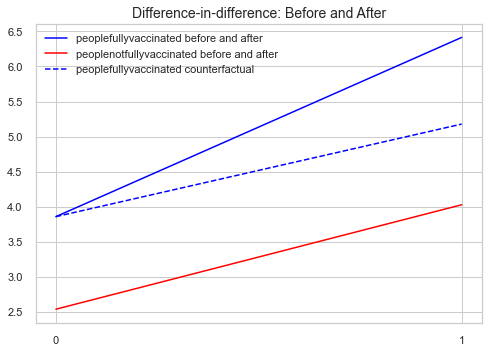

In [285]:
plt.figure(num=None, figsize=(4, 3), dpi=80, facecolor='w', edgecolor='k')
fig, ax = plt.subplots()
linepeoplefullyvaccinated, = ax.plot(['0', '1'], [peoplefullyvaccinated_before, peoplefullyvaccinated_after],color='blue',label='peoplefullyvaccinated before and after')
linepeoplenotfullyvaccinated, = ax.plot(['0', '1'], [peoplenotfullyvaccinated_before, peoplenotfullyvaccinated_after],color = 'red',label = 'peoplenotfullyvaccinated before and after')
linepeoplefullyvaccinated0, = ax.plot(['0', '1'], [peoplefullyvaccinated_before, peoplefullyvaccinated_counterfactual],color = 'blue',linestyle='dashed',label='peoplefullyvaccinated counterfactual')
ax.legend()
#plt.ylim(10, 20)  
plt.title("Difference-in-difference: Before and After", fontsize="14");

#### 10.7 More OLS

In [286]:
import pandas as pd
import statsmodels.api as sm
import matplotlib.pyplot as plt
from sklearn import linear_model
import statsmodels.formula.api as smf
import numpy as np

In [287]:
covidvisual = pd.read_excel('C:/Users/andre/Documents/Programming Languages/Python/pimespython/Project/covidwebscraping/actualcovid19project/covidvisual.xlsx')

In [288]:
covidvisual.shape

(148, 43)

In [289]:
covidvisual.head(3)

,Country,Country Code,Latitude,Longitude,HDI rank,Human Development Index 2019 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,GDP 2019 (US$),GDP per capita 2019 (US$),GDP growth 2019 (annual %),Inflation Rate 2019 (%),Unemployment Rate 2020 (%),Region,IncomeGroup,total_vaccinations,date,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop,covid_mortality_rate (per 100000)
0,Afghanistan,AFG,33.0,65.0,169,0.511,64.83,10.176430,3.930000,2229.362021,1.929110e+10,507.103432,3.911603,2.302373,11.73,South Asia,Low income,1277085,2021-07-27,939835,219159.0,4015.0,22461,3.28,2.41,0.56,577,Afghanistan,"146,523",+527,6677.0,+62,"96,692",+966,"43,154","1,124","701,952",39864282,Asia,13,2.0,"1,083",16.749330
1,Albania,ALB,41.0,20.0,69,0.795,78.57,14.695620,10.145730,13998.299890,1.527918e+10,5353.244856,2.240070,1.411091,11.70,Europe & Central Asia,Upper middle income,1138771,2021-07-25,640047,498724.0,23655.0,17565,39.57,22.24,17.33,6104,Albania,"132,999",+47,2457.0,NaN,"130,187",+13,355,3,"916,777",2874426,Europe,16,NaN,124,85.477935
2,Algeria,DZA,28.0,3.0,91,0.748,76.88,14.604302,7.986548,11173.956810,1.710913e+11,3973.964072,0.800000,1.951768,12.83,Middle East & North Africa,Lower middle income,75000,2021-02-19,75000,NaN,30.0,3748,0.17,0.17,NaN,85,Algeria,"168,668","+1,537",4189.0,+28,"113,707",+807,"50,772",37,"230,861",44697286,Africa,34,0.6,"1,136",9.371934


In [290]:
pd.set_option('display.max_columns', None)

In [291]:
covidvisual.head(4)

,Country,Country Code,Latitude,Longitude,HDI rank,Human Development Index 2019 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,GDP 2019 (US$),GDP per capita 2019 (US$),GDP growth 2019 (annual %),Inflation Rate 2019 (%),Unemployment Rate 2020 (%),Region,IncomeGroup,total_vaccinations,date,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop,covid_mortality_rate (per 100000)
0,Afghanistan,AFG,33.0,65.0,169,0.511,64.83,10.176430,3.930000,2229.362021,1.929110e+10,507.103432,3.911603,2.302373,11.73,South Asia,Low income,1277085,2021-07-27,939835,219159.0,4015.0,22461,3.28,2.41,0.56,577,Afghanistan,"146,523",+527,6677.0,+62,"96,692",+966,"43,154","1,124","701,952",39864282,Asia,13,2.0,"1,083",16.749330
1,Albania,ALB,41.0,20.0,69,0.795,78.57,14.695620,10.145730,13998.299890,1.527918e+10,5353.244856,2.240070,1.411091,11.70,Europe & Central Asia,Upper middle income,1138771,2021-07-25,640047,498724.0,23655.0,17565,39.57,22.24,17.33,6104,Albania,"132,999",+47,2457.0,NaN,"130,187",+13,355,3,"916,777",2874426,Europe,16,NaN,124,85.477935
2,Algeria,DZA,28.0,3.0,91,0.748,76.88,14.604302,7.986548,11173.956810,1.710913e+11,3973.964072,0.800000,1.951768,12.83,Middle East & North Africa,Lower middle income,75000,2021-02-19,75000,NaN,30.0,3748,0.17,0.17,NaN,85,Algeria,"168,668","+1,537",4189.0,+28,"113,707",+807,"50,772",37,"230,861",44697286,Africa,34,0.6,"1,136",9.371934
3,Angola,AGO,-12.5,18.5,148,0.581,61.15,11.777202,5.173993,6104.054640,8.881570e+10,2790.726615,-0.624644,17.081215,7.70,Sub-Saharan Africa,Lower middle income,1592537,2021-07-19,958373,634164.0,NaN,33700,4.85,2.92,1.93,1025,Angola,"42,288",NaN,1000.0,NaN,"35,964",NaN,"5,324",8,"681,443",33955402,Africa,NaN,NaN,157,2.945039


In [292]:
covidvisual.columns

Index(['Country', 'Country Code', 'Latitude', 'Longitude', 'HDI rank',
       'Human Development Index 2019 (HDI)', 'Life expectancy at birth',
       'Expected years of schooling', 'Mean years of schooling',
       'Gross national income (GNI) per capita', 'GDP 2019 (US$)',
       'GDP per capita 2019 (US$)', 'GDP growth 2019 (annual %)',
       'Inflation Rate 2019 (%)', 'Unemployment Rate 2020 (%)', 'Region',
       'IncomeGroup', 'total_vaccinations', 'date', 'people_vaccinated',
       'people_fully_vaccinated', 'daily_vaccinations_raw',
       'daily_vaccinations', 'total_vaccinations_per_hundred',
       'people_vaccinated_per_hundred', 'people_fully_vaccinated_per_hundred',
       'daily_vaccinations_per_million', 'Country,Other', 'TotalCases',
       'NewCases', 'TotalDeaths', 'NewDeaths', 'TotalRecovered',
       'NewRecovered', 'ActiveCases', 'Serious,Critical', 'TotalTests',
       'Population', 'Continent', 'New Cases/1M pop', 'New Deaths/1M pop',
       'Active Cases/1M p

In [293]:
X = covidvisual[['people_fully_vaccinated_per_hundred', 'Human Development Index 2019 (HDI)', 'Unemployment Rate 2020 (%)', 'Inflation Rate 2019 (%)', 'GDP per capita 2019 (US$)', 'GDP 2019 (US$)', 'HDI rank']]
y = covidvisual['covid_mortality_rate (per 100000)']
X = sm.add_constant(X)

In [294]:
model = sm.OLS(y, X, missing='drop')
results = model.fit()
predictions = results.predict(X)
results.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                                    OLS Regression Results                                   
=============================================================================================
Dep. Variable:     covid_mortality_rate (per 100000)   R-squared:                       0.322
Model:                                           OLS   Adj. R-squared:                  0.287
Method:                                Least Squares   F-statistic:                     9.039
Date:                               Fri, 30 Jul 2021   Prob (F-statistic):           4.26e-09
Time:                                       17:26:36   Log-Likelihood:                -809.56
No. Observations:                                141   AIC:                             1635.
Df Residuals:                                    133   BIC:                             1659.
Df Model:                                          7                                         
Covariance Type:                           nonrobust                                         
=======================================================================================================
                                          coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------------------------------
const                                 535.7327    372.980      1.436      0.153    -202.008    1273.474
people_fully_vaccinated_per_hundred     0.5345      0.482      1.109      0.270      -0.419       1.488
Human Development Index 2019 (HDI)   -362.7003    375.821     -0.965      0.336   -1106.060     380.659
Unemployment Rate 2020 (%)              3.2441      1.312      2.472      0.015       0.649       5.840
Inflation Rate 2019 (%)                -0.6407      1.311     -0.489      0.626      -3.235       1.953
GDP per capita 2019 (US$)              -0.0022      0.001     -4.274      0.000      -0.003      -0.001
GDP 2019 (US$)                       1.947e-12   3.02e-12      0.645      0.520   -4.03e-12    7.92e-12
HDI rank                               -2.1496      1.078     -1.994      0.048      -4.282      -0.017
==============================================================================
Omnibus:                       95.215   Durbin-Watson:                   2.081
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              872.184
Skew:                           2.242   Prob(JB):                    4.05e-190
Kurtosis:                      14.329   Cond. No.                     1.88e+14
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The condition number is large, 1.88e+14. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

In [295]:
covidvisual.isnull().sum()

Country                                    0
Country Code                               0
Latitude                                   0
Longitude                                  0
HDI rank                                   0
Human Development Index 2019 (HDI)         0
Life expectancy at birth                   0
Expected years of schooling                0
Mean years of schooling                    0
Gross national income (GNI) per capita     0
GDP 2019 (US$)                             0
GDP per capita 2019 (US$)                  0
GDP growth 2019 (annual %)                 0
Inflation Rate 2019 (%)                    0
Unemployment Rate 2020 (%)                 0
Region                                     0
IncomeGroup                                0
total_vaccinations                         0
date                                       0
people_vaccinated                          0
people_fully_vaccinated                    5
daily_vaccinations_raw                    26
daily_vacc

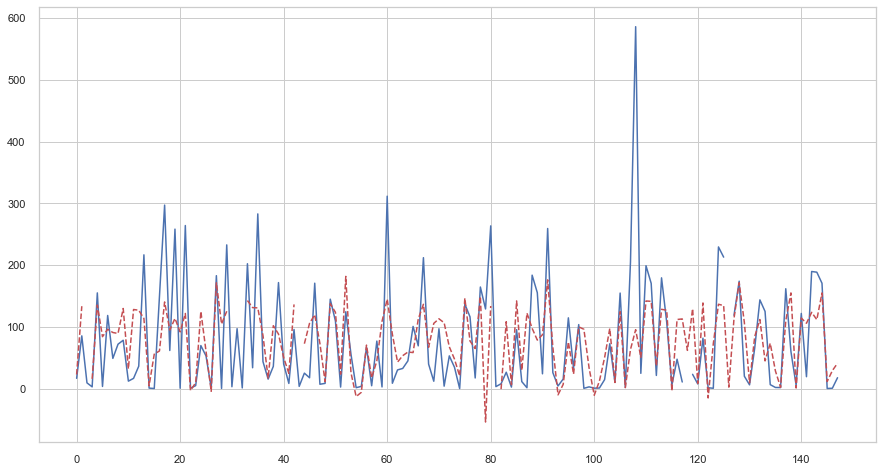

In [296]:
fig = plt.figure(figsize=(15,8))
plt.plot(range(0,len(y)), y.tolist(), 'b')
plt.plot(range(0,len(y)), predictions.tolist(), 'r--')
plt.show()

In [297]:
covidvisual = pd.read_excel('C:/Users/andre/Documents/Programming Languages/Python/pimespython/Project/covidwebscraping/actualcovid19project/covidvisual.xlsx')
covidvisual.head(2)

,Country,Country Code,Latitude,Longitude,HDI rank,Human Development Index 2019 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,GDP 2019 (US$),GDP per capita 2019 (US$),GDP growth 2019 (annual %),Inflation Rate 2019 (%),Unemployment Rate 2020 (%),Region,IncomeGroup,total_vaccinations,date,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop,covid_mortality_rate (per 100000)
0,Afghanistan,AFG,33.0,65.0,169,0.511,64.83,10.17643,3.93000,2229.362021,1.929110e+10,507.103432,3.911603,2.302373,11.73,South Asia,Low income,1277085,2021-07-27,939835,219159.0,4015.0,22461,3.28,2.41,0.56,577,Afghanistan,"146,523",+527,6677.0,+62,"96,692",+966,"43,154","1,124","701,952",39864282,Asia,13,2.0,"1,083",16.749330
1,Albania,ALB,41.0,20.0,69,0.795,78.57,14.69562,10.14573,13998.299890,1.527918e+10,5353.244856,2.240070,1.411091,11.70,Europe & Central Asia,Upper middle income,1138771,2021-07-25,640047,498724.0,23655.0,17565,39.57,22.24,17.33,6104,Albania,"132,999",+47,2457.0,NaN,"130,187",+13,355,3,"916,777",2874426,Europe,16,NaN,124,85.477935


In [298]:
covidvisuallm = covidvisual.loc[:, ['people_fully_vaccinated_per_hundred','covid_mortality_rate (per 100000)']]

In [299]:
covidvisuallm

,people_fully_vaccinated_per_hundred,covid_mortality_rate (per 100000)
0,0.56,16.749330
1,17.33,85.477935
2,NaN,9.371934
3,1.93,2.945039
4,1.48,155.059542
...,...,...
143,48.91,188.587480
144,63.03,170.651597
145,0.04,0.317656
146,0.51,0.641049


In [300]:
covidvisuallm = covidvisuallm.dropna(subset=['people_fully_vaccinated_per_hundred','covid_mortality_rate (per 100000)'])

In [301]:
covidvisuallm

,people_fully_vaccinated_per_hundred,covid_mortality_rate (per 100000)
0,0.56,16.749330
1,17.33,85.477935
3,1.93,2.945039
4,1.48,155.059542
5,13.90,3.575226
...,...,...
143,48.91,188.587480
144,63.03,170.651597
145,0.04,0.317656
146,0.51,0.641049


In [302]:
X = covidvisuallm['people_fully_vaccinated_per_hundred']
y = covidvisuallm['covid_mortality_rate (per 100000)']

In [303]:
lm = linear_model.LinearRegression()
model = lm.fit(X.values.reshape(-1,1),y)

In [304]:
lm.coef_

array([1.35817302])

In [305]:
lm.intercept_

50.546811209796715

In [306]:
lm.score(X.values.reshape(-1,1),y)

0.10261577412706757

In [307]:
predictions = lm.predict(X.values.reshape(-1,1))
print(predictions[0:5])

[51.3073881  74.08394965 53.16808514 52.55690728 69.42541619]


##### 10.7.1 Robust linear regression

In [308]:
X = covidvisuallm['people_fully_vaccinated_per_hundred']
y = covidvisuallm['covid_mortality_rate (per 100000)']

In [309]:
model = sm.RLM(y, X, missing='drop', M=sm.robust.norms.HuberT())
results = model.fit()
results.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            Robust linear Model Regression Results                           
=============================================================================================
Dep. Variable:     covid_mortality_rate (per 100000)   No. Observations:                  141
Model:                                           RLM   Df Residuals:                      140
Method:                                         IRLS   Df Model:                            0
Norm:                                         HuberT                                         
Scale Est.:                                      mad                                         
Cov Type:                                         H1                                         
Date:                               Fri, 30 Jul 2021                                         
Time:                                       17:27:02                                         
No. Iterations:                                   17                                         
=======================================================================================================
                                          coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------------------------------------------------------------
people_fully_vaccinated_per_hundred     2.4090      0.185     13.019      0.000       2.046       2.772
=======================================================================================================

If the model instance has been used for another fit with different fit parameters, then the fit options might not be the correct ones anymore .
"""

In [310]:
X = covidvisuallm['people_fully_vaccinated_per_hundred']
y = covidvisuallm['covid_mortality_rate (per 100000)']
X = sm.add_constant(X)

In [311]:
res = sm.OLS(y, X).fit()
print(res.params)

const                                  50.546811
people_fully_vaccinated_per_hundred     1.358173
dtype: float64


In [312]:
resrlm = sm.RLM(y, X).fit()
print(resrlm.params)

const                                  33.764235
people_fully_vaccinated_per_hundred     1.554961
dtype: float64


#### 10.8 Logit and Probit

In [313]:
#y must be 0 or 1

In [314]:
import pandas as pd

In [315]:
covidvisual = pd.read_excel('C:/Users/andre/Documents/Programming Languages/Python/pimespython/Project/covidwebscraping/actualcovid19project/covidvisual.xlsx')

In [316]:
covidvisual.head(3)

,Country,Country Code,Latitude,Longitude,HDI rank,Human Development Index 2019 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,GDP 2019 (US$),GDP per capita 2019 (US$),GDP growth 2019 (annual %),Inflation Rate 2019 (%),Unemployment Rate 2020 (%),Region,IncomeGroup,total_vaccinations,date,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop,covid_mortality_rate (per 100000)
0,Afghanistan,AFG,33.0,65.0,169,0.511,64.83,10.176430,3.930000,2229.362021,1.929110e+10,507.103432,3.911603,2.302373,11.73,South Asia,Low income,1277085,2021-07-27,939835,219159.0,4015.0,22461,3.28,2.41,0.56,577,Afghanistan,"146,523",+527,6677.0,+62,"96,692",+966,"43,154","1,124","701,952",39864282,Asia,13,2.0,"1,083",16.749330
1,Albania,ALB,41.0,20.0,69,0.795,78.57,14.695620,10.145730,13998.299890,1.527918e+10,5353.244856,2.240070,1.411091,11.70,Europe & Central Asia,Upper middle income,1138771,2021-07-25,640047,498724.0,23655.0,17565,39.57,22.24,17.33,6104,Albania,"132,999",+47,2457.0,NaN,"130,187",+13,355,3,"916,777",2874426,Europe,16,NaN,124,85.477935
2,Algeria,DZA,28.0,3.0,91,0.748,76.88,14.604302,7.986548,11173.956810,1.710913e+11,3973.964072,0.800000,1.951768,12.83,Middle East & North Africa,Lower middle income,75000,2021-02-19,75000,NaN,30.0,3748,0.17,0.17,NaN,85,Algeria,"168,668","+1,537",4189.0,+28,"113,707",+807,"50,772",37,"230,861",44697286,Africa,34,0.6,"1,136",9.371934


In [317]:
covidvisual['IncomeGroup']

0               Low income
1      Upper middle income
2      Lower middle income
3      Lower middle income
4      Upper middle income
              ...         
143            High income
144            High income
145    Lower middle income
146    Lower middle income
147    Lower middle income
Name: IncomeGroup, Length: 148, dtype: object

In [318]:
#y = covidvisual['IncomeGroup']
covidvisualdum = covidvisual.drop('IncomeGroup',1)

In [319]:
covidvisualdum.head(2)

,Country,Country Code,Latitude,Longitude,HDI rank,Human Development Index 2019 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,GDP 2019 (US$),GDP per capita 2019 (US$),GDP growth 2019 (annual %),Inflation Rate 2019 (%),Unemployment Rate 2020 (%),Region,total_vaccinations,date,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop,covid_mortality_rate (per 100000)
0,Afghanistan,AFG,33.0,65.0,169,0.511,64.83,10.17643,3.93000,2229.362021,1.929110e+10,507.103432,3.911603,2.302373,11.73,South Asia,1277085,2021-07-27,939835,219159.0,4015.0,22461,3.28,2.41,0.56,577,Afghanistan,"146,523",+527,6677.0,+62,"96,692",+966,"43,154","1,124","701,952",39864282,Asia,13,2.0,"1,083",16.749330
1,Albania,ALB,41.0,20.0,69,0.795,78.57,14.69562,10.14573,13998.299890,1.527918e+10,5353.244856,2.240070,1.411091,11.70,Europe & Central Asia,1138771,2021-07-25,640047,498724.0,23655.0,17565,39.57,22.24,17.33,6104,Albania,"132,999",+47,2457.0,NaN,"130,187",+13,355,3,"916,777",2874426,Europe,16,NaN,124,85.477935


In [320]:
dummie_incomegroup = pd.get_dummies(covidvisual['IncomeGroup'],prefix='dum')

In [321]:
dummie_incomegroup.head(3)

,dum_High income,dum_Low income,dum_Lower middle income,dum_Upper middle income
0,0,1,0,0
1,0,0,0,1
2,0,0,1,0


In [322]:
coviddummies = pd.concat([covidvisualdum, dummie_incomegroup], axis = 1)

In [323]:
coviddummies.head(3)

,Country,Country Code,Latitude,Longitude,HDI rank,Human Development Index 2019 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,GDP 2019 (US$),GDP per capita 2019 (US$),GDP growth 2019 (annual %),Inflation Rate 2019 (%),Unemployment Rate 2020 (%),Region,total_vaccinations,date,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop,covid_mortality_rate (per 100000),dum_High income,dum_Low income,dum_Lower middle income,dum_Upper middle income
0,Afghanistan,AFG,33.0,65.0,169,0.511,64.83,10.176430,3.930000,2229.362021,1.929110e+10,507.103432,3.911603,2.302373,11.73,South Asia,1277085,2021-07-27,939835,219159.0,4015.0,22461,3.28,2.41,0.56,577,Afghanistan,"146,523",+527,6677.0,+62,"96,692",+966,"43,154","1,124","701,952",39864282,Asia,13,2.0,"1,083",16.749330,0,1,0,0
1,Albania,ALB,41.0,20.0,69,0.795,78.57,14.695620,10.145730,13998.299890,1.527918e+10,5353.244856,2.240070,1.411091,11.70,Europe & Central Asia,1138771,2021-07-25,640047,498724.0,23655.0,17565,39.57,22.24,17.33,6104,Albania,"132,999",+47,2457.0,NaN,"130,187",+13,355,3,"916,777",2874426,Europe,16,NaN,124,85.477935,0,0,0,1
2,Algeria,DZA,28.0,3.0,91,0.748,76.88,14.604302,7.986548,11173.956810,1.710913e+11,3973.964072,0.800000,1.951768,12.83,Middle East & North Africa,75000,2021-02-19,75000,NaN,30.0,3748,0.17,0.17,NaN,85,Algeria,"168,668","+1,537",4189.0,+28,"113,707",+807,"50,772",37,"230,861",44697286,Africa,34,0.6,"1,136",9.371934,0,0,1,0


In [324]:
coviddummies1 = coviddummies.loc[:, ['people_fully_vaccinated_per_hundred','covid_mortality_rate (per 100000)','dum_High income']]

In [325]:
coviddummies1.head(3)

,people_fully_vaccinated_per_hundred,covid_mortality_rate (per 100000),dum_High income
0,0.56,16.749330,0
1,17.33,85.477935,0
2,NaN,9.371934,0


In [326]:
coviddummies1 = coviddummies1.dropna()
#coviddummies1= covidvisuallm.dropna(subset=['people_fully_vaccinated_per_hundred','covid_mortality_rate (per 100000)','dum_High income'])

In [327]:
coviddummies1.head(3)

,people_fully_vaccinated_per_hundred,covid_mortality_rate (per 100000),dum_High income
0,0.56,16.749330,0
1,17.33,85.477935,0
3,1.93,2.945039,0


In [328]:
coviddummies1.shape

(141, 3)

In [329]:
Y = coviddummies1['dum_High income']

In [330]:
Y.head(3)

0    0
1    0
3    0
Name: dum_High income, dtype: uint8

In [331]:
#X = covidvisual[["covid_mortality_rate (per 100000)","people_fully_vaccinated_per_hundred"]]

In [332]:
X = coviddummies1[['covid_mortality_rate (per 100000)', 'people_fully_vaccinated_per_hundred']]

In [333]:
X.head(3)

,covid_mortality_rate (per 100000),people_fully_vaccinated_per_hundred
0,16.749330,0.56
1,85.477935,17.33
3,2.945039,1.93


In [334]:
X = sm.add_constant(X)

In [335]:
X.head(3)

,const,covid_mortality_rate (per 100000),people_fully_vaccinated_per_hundred
0,1.0,16.749330,0.56
1,1.0,85.477935,17.33
3,1.0,2.945039,1.93


In [336]:
logit_mod = sm.Logit(Y,X)

In [337]:
logit_res = logit_mod.fit()
logit_res.summary()

Optimization terminated successfully.
         Current function value: inf
         Iterations 7


C:\Users\andre\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1810: RuntimeWarning:

overflow encountered in exp

C:\Users\andre\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1863: RuntimeWarning:

divide by zero encountered in log

C:\Users\andre\anaconda3\lib\site-packages\statsmodels\base\model.py:547: HessianInversionWarning:

Inverting hessian failed, no bse or cov_params available

C:\Users\andre\anaconda3\lib\site-packages\statsmodels\base\model.py:547: HessianInversionWarning:

Inverting hessian failed, no bse or cov_params available



<class 'statsmodels.iolib.summary.Summary'>
"""
                           Logit Regression Results                           
==============================================================================
Dep. Variable:        dum_High income   No. Observations:                  141
Model:                          Logit   Df Residuals:                      138
Method:                           MLE   Df Model:                            2
Date:                Fri, 30 Jul 2021   Pseudo R-squ.:                     inf
Time:                        17:27:46   Log-Likelihood:                   -inf
converged:                       True   LL-Null:                        0.0000
Covariance Type:            nonrobust   LLR p-value:                     1.000
=======================================================================================================
                                          coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------------------------------------------------------------
const                                  -3.1044      0.498     -6.228      0.000      -4.081      -2.127
covid_mortality_rate (per 100000)      -0.0012      0.003     -0.410      0.682      -0.007       0.005
people_fully_vaccinated_per_hundred     0.1183      0.019      6.283      0.000       0.081       0.155
=======================================================================================================
"""

In [338]:
logit_res.summary2()

<class 'statsmodels.iolib.summary2.Summary'>
"""
                                  Results: Logit
===================================================================================
Model:                      Logit                   Pseudo R-squared:        inf   
Dependent Variable:         dum_High income         AIC:                     inf   
Date:                       2021-07-30 17:27        BIC:                     inf   
No. Observations:           141                     Log-Likelihood:          -inf  
Df Model:                   2                       LL-Null:                 0.0000
Df Residuals:               138                     LLR p-value:             1.0000
Converged:                  1.0000                  Scale:                   1.0000
No. Iterations:             7.0000                                                 
-----------------------------------------------------------------------------------
                                     Coef.  Std.Err.    z    P>|z|   [0.025  0.975]
-----------------------------------------------------------------------------------
const                               -3.1044   0.4984 -6.2282 0.0000 -4.0813 -2.1275
covid_mortality_rate (per 100000)   -0.0012   0.0030 -0.4102 0.6817 -0.0072  0.0047
people_fully_vaccinated_per_hundred  0.1183   0.0188  6.2834 0.0000  0.0814  0.1552
===================================================================================

"""

In [339]:
logit_res.get_margeff(at='overall', method='dydx').summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
        Logit Marginal Effects       
=====================================
Dep. Variable:        dum_High income
Method:                          dydx
At:                           overall
=======================================================================================================
                                         dy/dx    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------------------------------------------------------------
covid_mortality_rate (per 100000)      -0.0001      0.000     -0.411      0.681      -0.001       0.000
people_fully_vaccinated_per_hundred     0.0112      0.001     13.339      0.000       0.010       0.013
=======================================================================================================
"""

#### 10.9 Quantile Regression

In [340]:
covidvisual.head(3)

,Country,Country Code,Latitude,Longitude,HDI rank,Human Development Index 2019 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,GDP 2019 (US$),GDP per capita 2019 (US$),GDP growth 2019 (annual %),Inflation Rate 2019 (%),Unemployment Rate 2020 (%),Region,IncomeGroup,total_vaccinations,date,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop,covid_mortality_rate (per 100000)
0,Afghanistan,AFG,33.0,65.0,169,0.511,64.83,10.176430,3.930000,2229.362021,1.929110e+10,507.103432,3.911603,2.302373,11.73,South Asia,Low income,1277085,2021-07-27,939835,219159.0,4015.0,22461,3.28,2.41,0.56,577,Afghanistan,"146,523",+527,6677.0,+62,"96,692",+966,"43,154","1,124","701,952",39864282,Asia,13,2.0,"1,083",16.749330
1,Albania,ALB,41.0,20.0,69,0.795,78.57,14.695620,10.145730,13998.299890,1.527918e+10,5353.244856,2.240070,1.411091,11.70,Europe & Central Asia,Upper middle income,1138771,2021-07-25,640047,498724.0,23655.0,17565,39.57,22.24,17.33,6104,Albania,"132,999",+47,2457.0,NaN,"130,187",+13,355,3,"916,777",2874426,Europe,16,NaN,124,85.477935
2,Algeria,DZA,28.0,3.0,91,0.748,76.88,14.604302,7.986548,11173.956810,1.710913e+11,3973.964072,0.800000,1.951768,12.83,Middle East & North Africa,Lower middle income,75000,2021-02-19,75000,NaN,30.0,3748,0.17,0.17,NaN,85,Algeria,"168,668","+1,537",4189.0,+28,"113,707",+807,"50,772",37,"230,861",44697286,Africa,34,0.6,"1,136",9.371934


In [341]:
covidvisual.rename({'covid_mortality_rate (per 100000)':'coviddeathrateper100k'}, axis='columns', inplace = True)

In [342]:
covidvisual.rename({'Human Development Index 2019 (HDI)':'hdi'}, axis='columns', inplace = True)

In [343]:
covidvisual

,Country,Country Code,Latitude,Longitude,HDI rank,hdi,Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,GDP 2019 (US$),GDP per capita 2019 (US$),GDP growth 2019 (annual %),Inflation Rate 2019 (%),Unemployment Rate 2020 (%),Region,IncomeGroup,total_vaccinations,date,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop,coviddeathrateper100k
0,Afghanistan,AFG,33.0,65.0,169,0.511,64.83,10.176430,3.930000,2229.362021,1.929110e+10,507.103432,3.911603,2.302373,11.730000,South Asia,Low income,1277085,2021-07-27,939835,219159.0,4015.0,22461,3.28,2.41,0.56,577,Afghanistan,"146,523",+527,6677.0,+62,"96,692",+966,"43,154","1,124","701,952",39864282,Asia,13,2.0,"1,083",16.749330
1,Albania,ALB,41.0,20.0,69,0.795,78.57,14.695620,10.145730,13998.299890,1.527918e+10,5353.244856,2.240070,1.411091,11.700000,Europe & Central Asia,Upper middle income,1138771,2021-07-25,640047,498724.0,23655.0,17565,39.57,22.24,17.33,6104,Albania,"132,999",+47,2457.0,NaN,"130,187",+13,355,3,"916,777",2874426,Europe,16,NaN,124,85.477935
2,Algeria,DZA,28.0,3.0,91,0.748,76.88,14.604302,7.986548,11173.956810,1.710913e+11,3973.964072,0.800000,1.951768,12.830000,Middle East & North Africa,Lower middle income,75000,2021-02-19,75000,NaN,30.0,3748,0.17,0.17,NaN,85,Algeria,"168,668","+1,537",4189.0,+28,"113,707",+807,"50,772",37,"230,861",44697286,Africa,34,0.6,"1,136",9.371934
3,Angola,AGO,-12.5,18.5,148,0.581,61.15,11.777202,5.173993,6104.054640,8.881570e+10,2790.726615,-0.624644,17.081215,7.700000,Sub-Saharan Africa,Lower middle income,1592537,2021-07-19,958373,634164.0,NaN,33700,4.85,2.92,1.93,1025,Angola,"42,288",NaN,1000.0,NaN,"35,964",NaN,"5,324",8,"681,443",33955402,Africa,NaN,NaN,157,2.945039
4,Armenia,ARM,40.0,45.0,81,0.776,75.09,13.068610,11.301740,13894.013020,1.367280e+10,4622.733493,7.600000,1.443447,20.209999,Europe & Central Asia,Upper middle income,152529,2021-07-25,108674,43855.0,NaN,3282,5.15,3.67,1.48,1108,Armenia,"229,603",+233,4604.0,+7,"219,502",+123,"5,497",NaN,"1,328,107",2969182,Asia,78,2.0,"1,851",155.059542
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
143,United States,USA,38.0,-97.0,17,0.926,78.86,16.310390,13.413440,63825.657480,2.143323e+13,65297.517508,2.161176,1.812210,8.310000,North America,High income,343361524,2021-07-28,189494180,163588042.0,4629928.0,3384387,102.67,56.66,48.91,10120,USA,"35,494,551","+7,061",628152.0,+54,"29,604,525",+567,"5,261,874","9,051","527,202,813",333082557,North America,21,0.2,"15,798",188.587480
144,Uruguay,URY,-33.0,-56.0,55,0.817,77.91,16.835640,8.925730,20063.642220,5.604591e+10,16190.126957,0.222122,7.881989,12.670000,Latin America & Caribbean,High income,4742902,2021-07-28,2553268,2189634.0,63597.0,49284,136.54,73.50,63.03,14188,Uruguay,"380,976",NaN,5950.0,NaN,"372,721",NaN,"2,305",68,"3,039,586",3486636,South America,NaN,NaN,661,170.651597
145,Vanuatu,VUT,-16.0,167.0,140,0.609,70.47,11.733910,7.064846,3104.799016,9.342400e+08,3115.358620,3.264590,2.762520,1.950000,East Asia & Pacific,Lower middle income,23995,2021-07-27,23881,114.0,NaN,758,7.81,7.78,0.04,2468,Vanuatu,4,NaN,1.0,NaN,3,NaN,0,NaN,"23,000",314806,Australia/Oceania,NaN,NaN,NaN,0.317656
146,Viet Nam,VNM,16.0,106.0,117,0.704,75.40,12.692323,8.320000,7432.706806,2.619212e+11,2715.276036,7.017435,2.795824,2.270000,East Asia & Pacific,Lower middle income,5321839,2021-07-28,4825209,496630.0,308664.0,164378,5.47,4.96,0.51,1689,Vietnam,"123,640","+2,821",630.0,NaN,"27,457",NaN,"95,553",NaN,"11,890,084"

In [344]:
mod = smf.quantreg('coviddeathrateper100k ~ hdi', covidvisual)
res = mod.fit(q=.5)
res.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                           QuantReg Regression Results                           
=================================================================================
Dep. Variable:     coviddeathrateper100k   Pseudo R-squared:               0.1878
Model:                          QuantReg   Bandwidth:                       56.17
Method:                    Least Squares   Sparsity:                        146.8
Date:                   Fri, 30 Jul 2021   No. Observations:                  146
Time:                           17:27:59   Df Residuals:                      144
                                           Df Model:                            1
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept   -113.5035     30.266     -3.750      0.000    -173.327     -53.680
hdi          234.6674     40.188      5.839      0.000     155.233     314.102
==============================================================================
"""

In [345]:
quantiles = np.arange(.05, .96, .1)
def fit_model(q):
    res = mod.fit(q=q)
    return [q, res.params['Intercept'], res.params['hdi']] + \
            res.conf_int().loc['hdi'].tolist()

models = [fit_model(x) for x in quantiles]
models = pd.DataFrame(models, columns=['q', 'a', 'b', 'lb', 'ub'])

ols = smf.ols('coviddeathrateper100k ~ hdi', covidvisual).fit()
ols_ci = ols.conf_int().loc['hdi'].tolist()
ols = dict(a = ols.params['Intercept'],
           b = ols.params['hdi'],
           lb = ols_ci[0],
           ub = ols_ci[1])

print(models)
print(ols)

      q           a           b          lb          ub
0  0.05    0.861678   -0.218245  -59.525583   59.089094
1  0.15  -12.664424   26.866546  -39.511342   93.244434
2  0.25  -27.772402   61.221428  -11.548680  133.991537
3  0.35  -82.801901  164.212734   92.296608  236.128860
4  0.45 -107.988582  218.740057  141.290160  296.189953
5  0.55 -121.652746  258.310781  176.564502  340.057060
6  0.65 -150.786478  319.387794  230.264334  408.511254
7  0.75 -183.587235  407.904322  311.143872  504.664771
8  0.85 -196.017991  457.516128  361.239443  553.792812
9  0.95 -248.946899  628.077301  484.244532  771.910069
{'a': -122.65400592516653, 'b': 270.53153543140047, 'lb': 181.87379882670763, 'ub': 359.1892720360933}


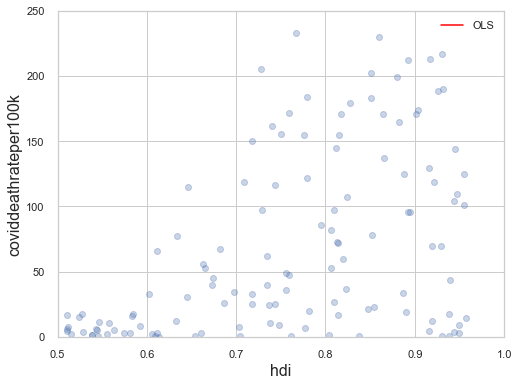

In [346]:
x = np.arange(covidvisual.hdi.min(), covidvisual.hdi.max(), 50)
get_y = lambda a, b: a + b * x

fig, ax = plt.subplots(figsize=(8, 6))

for i in range(models.shape[0]):
    y = get_y(models.a[i], models.b[i])
    ax.plot(x, y, linestyle='dotted', color='grey')

y = get_y(ols['a'], ols['b'])

ax.plot(x, y, color='red', label='OLS')
ax.scatter(covidvisual.hdi, covidvisual.coviddeathrateper100k, alpha=.3)
ax.set_xlim((0.5, 1))
ax.set_ylim((0, 250))
legend = ax.legend()
ax.set_xlabel('hdi', fontsize=16)
ax.set_ylabel('coviddeathrateper100k', fontsize=16);

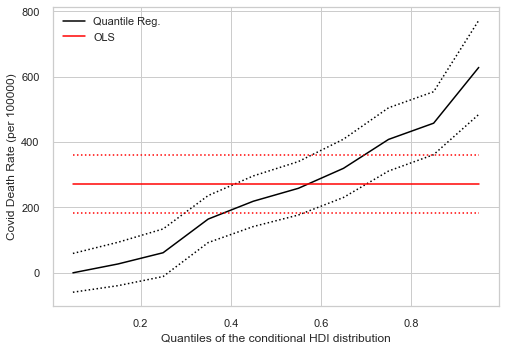

In [347]:
n = models.shape[0]
p1 = plt.plot(models.q, models.b, color='black', label='Quantile Reg.')
p2 = plt.plot(models.q, models.ub, linestyle='dotted', color='black')
p3 = plt.plot(models.q, models.lb, linestyle='dotted', color='black')
p4 = plt.plot(models.q, [ols['b']] * n, color='red', label='OLS')
p5 = plt.plot(models.q, [ols['lb']] * n, linestyle='dotted', color='red')
p6 = plt.plot(models.q, [ols['ub']] * n, linestyle='dotted', color='red')
plt.ylabel(r'Covid Death Rate (per 100000)')
plt.xlabel('Quantiles of the conditional HDI distribution')
plt.legend()
plt.show()

In [348]:
#the graph shows the estimated coeficients as a function of quantile in black line, the horizontal line is the OLS estimate of the coeficients
#most of the estimated coeficients in the quantiles does not fall inside the upper and lower (in a 95% confidence interval) bound of the OLS estimate.
#it means that there's a significant difference between the OLS estimates and the quantile regression estimates,meaning that it makes sense to analyze the 
#covid death rate by quantiles of the conditional HDI distribution, instead of just a regular OLS estimate

### 11. Spatial Econometrics 

In [479]:
import esda
import pandas as pd
import geopandas as gpd
from geopandas import GeoDataFrame
import libpysal as lps
import numpy as np
import matplotlib.pyplot as plt
from shapely.geometry import Point
%matplotlib inline

In [480]:
covidvisual = pd.read_excel('covidvisual.xlsx')

In [481]:
covidvisual.head(3)

,Country,Country Code,Latitude,Longitude,HDI rank,Human Development Index 2019 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,GDP 2019 (US$),GDP per capita 2019 (US$),GDP growth 2019 (annual %),Inflation Rate 2019 (%),Unemployment Rate 2020 (%),Region,IncomeGroup,total_vaccinations,date,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop,covid_mortality_rate (per 100000)
0,Afghanistan,AFG,33.0,65.0,169,0.511,64.83,10.176430,3.930000,2229.362021,1.929110e+10,507.103432,3.911603,2.302373,11.73,South Asia,Low income,1277085,2021-07-27,939835,219159.0,4015.0,22461,3.28,2.41,0.56,577,Afghanistan,"146,523",+527,6677.0,+62,"96,692",+966,"43,154","1,124","701,952",39864282,Asia,13,2.0,"1,083",16.749330
1,Albania,ALB,41.0,20.0,69,0.795,78.57,14.695620,10.145730,13998.299890,1.527918e+10,5353.244856,2.240070,1.411091,11.70,Europe & Central Asia,Upper middle income,1138771,2021-07-25,640047,498724.0,23655.0,17565,39.57,22.24,17.33,6104,Albania,"132,999",+47,2457.0,NaN,"130,187",+13,355,3,"916,777",2874426,Europe,16,NaN,124,85.477935
2,Algeria,DZA,28.0,3.0,91,0.748,76.88,14.604302,7.986548,11173.956810,1.710913e+11,3973.964072,0.800000,1.951768,12.83,Middle East & North Africa,Lower middle income,75000,2021-02-19,75000,NaN,30.0,3748,0.17,0.17,NaN,85,Algeria,"168,668","+1,537",4189.0,+28,"113,707",+807,"50,772",37,"230,861",44697286,Africa,34,0.6,"1,136",9.371934


In [352]:
pd.set_option('display.max_rows', 10)

In [483]:
covidvisual

,Country,Country Code,Latitude,Longitude,HDI rank,Human Development Index 2019 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,GDP 2019 (US$),GDP per capita 2019 (US$),GDP growth 2019 (annual %),Inflation Rate 2019 (%),Unemployment Rate 2020 (%),Region,IncomeGroup,total_vaccinations,date,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop,covid_mortality_rate (per 100000)
0,Afghanistan,AFG,33.0000,65.0000,169,0.511,64.83,10.176430,3.930000,2229.362021,1.929110e+10,507.103432,3.911603,2.302373,11.730000,South Asia,Low income,1277085,2021-07-27,939835,219159.0,4015.0,22461,3.28,2.41,0.56,577,Afghanistan,"146,523",+527,6677.0,+62,"96,692",+966,"43,154","1,124","701,952",39864282,Asia,13,2.00,"1,083",16.749330
1,Albania,ALB,41.0000,20.0000,69,0.795,78.57,14.695620,10.145730,13998.299890,1.527918e+10,5353.244856,2.240070,1.411091,11.700000,Europe & Central Asia,Upper middle income,1138771,2021-07-25,640047,498724.0,23655.0,17565,39.57,22.24,17.33,6104,Albania,"132,999",+47,2457.0,NaN,"130,187",+13,355,3,"916,777",2874426,Europe,16,NaN,124,85.477935
2,Algeria,DZA,28.0000,3.0000,91,0.748,76.88,14.604302,7.986548,11173.956810,1.710913e+11,3973.964072,0.800000,1.951768,12.830000,Middle East & North Africa,Lower middle income,75000,2021-02-19,75000,NaN,30.0,3748,0.17,0.17,NaN,85,Algeria,"168,668","+1,537",4189.0,+28,"113,707",+807,"50,772",37,"230,861",44697286,Africa,34,0.60,"1,136",9.371934
3,Angola,AGO,-12.5000,18.5000,148,0.581,61.15,11.777202,5.173993,6104.054640,8.881570e+10,2790.726615,-0.624644,17.081215,7.700000,Sub-Saharan Africa,Lower middle income,1592537,2021-07-19,958373,634164.0,NaN,33700,4.85,2.92,1.93,1025,Angola,"42,288",NaN,1000.0,NaN,"35,964",NaN,"5,324",8,"681,443",33955402,Africa,NaN,NaN,157,2.945039
4,Armenia,ARM,40.0000,45.0000,81,0.776,75.09,13.068610,11.301740,13894.013020,1.367280e+10,4622.733493,7.600000,1.443447,20.209999,Europe & Central Asia,Upper middle income,152529,2021-07-25,108674,43855.0,NaN,3282,5.15,3.67,1.48,1108,Armenia,"229,603",+233,4604.0,+7,"219,502",+123,"5,497",NaN,"1,328,107",2969182,Asia,78,2.00,"1,851",155.059542
5,Australia,AUS,-27.0000,133.0000,8,0.944,83.44,21.954330,12.724691,48084.842070,1.396567e+12,55060.326101,2.160956,1.610768,6.610000,East Asia & Pacific,High income,11593766,2021-07-28,8048704,3545062.0,196982.0,160533,45.47,31.56,13.90,6295,Australia,"33,726",+252,923.0,+2,"29,926",NaN,"2,877",59,"24,671,699",25816549,Australia/Oceania,10,0.08,111,3.575226
6,Austria,AUT,47.3333,13.3333,18,0.922,81.54,16.092070,12.546144,56196.898690,4.450754e+11,50137.662776,1.418734,1.530896,5.770000,Europe & Central Asia,High income,9553753,2021-07-28,5264597,4479543.0,143537.0,91715,106.08,58.45,49.74,10183,Austria,"658,004",+503,10737.0,NaN,"642,229",+349,"5,038",40,"65,725,061",9061466,Europe,56,NaN,556,118.490761
7,Azerbaijan,AZE,40.5000,47.5000,88,0.756,73.01,12.893640,10.575430,13783.679950,4.804765e+10,4793.587020,2.218704,2.610572,6.270000,Europe & Central Asia,Upper middle income,4714039,2021-07-28,2731114,1982925.0,88978.0,64583,46.49,26.94,19.56,6370,Azerbaijan,"342,548",+615,5019.0,+5,"332,574",+181,"4,955",NaN,"4,014,073",10237045,Asia,60,0.50,484,49.027820
8,Bahamas,BHS,24.2500,-76.0000,58,0.814,73.92,12.899450,11.436920,33747.212640,1.357880e+10,34863.742098,1.217874,2.491235,14.410000,Latin America & Caribbean,High income,103164,2021-07-24,60578,43943.0,110.0,1689,26.23,15.40,11.17,4295,Bahamas,"14,457",NaN,286.0,NaN,"12,501",NaN,"1,670",10,"118,017",397267,North America,NaN,NaN,"4,204",71.991885
9,Bahrain,BHR,26.0000,50.5500,42,0.852,77.29,16.25

In [484]:
covidvisual.shape

(148, 43)

In [485]:
covidvisual.columns

Index(['Country', 'Country Code', 'Latitude', 'Longitude', 'HDI rank',
       'Human Development Index 2019 (HDI)', 'Life expectancy at birth',
       'Expected years of schooling', 'Mean years of schooling',
       'Gross national income (GNI) per capita', 'GDP 2019 (US$)',
       'GDP per capita 2019 (US$)', 'GDP growth 2019 (annual %)',
       'Inflation Rate 2019 (%)', 'Unemployment Rate 2020 (%)', 'Region',
       'IncomeGroup', 'total_vaccinations', 'date', 'people_vaccinated',
       'people_fully_vaccinated', 'daily_vaccinations_raw',
       'daily_vaccinations', 'total_vaccinations_per_hundred',
       'people_vaccinated_per_hundred', 'people_fully_vaccinated_per_hundred',
       'daily_vaccinations_per_million', 'Country,Other', 'TotalCases',
       'NewCases', 'TotalDeaths', 'NewDeaths', 'TotalRecovered',
       'NewRecovered', 'ActiveCases', 'Serious,Critical', 'TotalTests',
       'Population', 'Continent', 'New Cases/1M pop', 'New Deaths/1M pop',
       'Active Cases/1M p

In [356]:
import shapely
shapely.speedups.disable()

In [486]:
world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))

In [487]:
world

,pop_est,continent,name,iso_a3,gdp_md_est,geometry
0,920938,Oceania,Fiji,FJI,8374.00,"MULTIPOLYGON (((180.00000 -16.06713, 180.00000..."
1,53950935,Africa,Tanzania,TZA,150600.00,"POLYGON ((33.90371 -0.95000, 34.07262 -1.05982..."
2,603253,Africa,W. Sahara,ESH,906.50,"POLYGON ((-8.66559 27.65643, -8.66512 27.58948..."
3,35623680,North America,Canada,CAN,1674000.00,"MULTIPOLYGON (((-122.84000 49.00000, -122.9742..."
4,326625791,North America,United States of America,USA,18560000.00,"MULTIPOLYGON (((-122.84000 49.00000, -120.0000..."
5,18556698,Asia,Kazakhstan,KAZ,460700.00,"POLYGON ((87.35997 49.21498, 86.59878 48.54918..."
6,29748859,Asia,Uzbekistan,UZB,202300.00,"POLYGON ((55.96819 41.30864, 55.92892 44.99586..."
7,6909701,Oceania,Papua New Guinea,PNG,28020.00,"MULTIPOLYGON (((141.00021 -2.60015, 142.73525 ..."
8,260580739,Asia,Indonesia,IDN,3028000.00,"MULTIPOLYGON (((141.00021 -2.60015, 141.01706 ..."
9,44293293,South America,Argentina,ARG,879400.00,"MULTIPOLYGON (((-68.63401 -52.63637, -68.25000..."


In [488]:
world.drop(['pop_est', 'continent', 'gdp_md_est'], axis = 1, inplace = True)

In [489]:
world.head(3)

,name,iso_a3,geometry
0,Fiji,FJI,"MULTIPOLYGON (((180.00000 -16.06713, 180.00000..."
1,Tanzania,TZA,"POLYGON ((33.90371 -0.95000, 34.07262 -1.05982..."
2,W. Sahara,ESH,"POLYGON ((-8.66559 27.65643, -8.66512 27.58948..."


In [490]:
covidvisual.head(3)

,Country,Country Code,Latitude,Longitude,HDI rank,Human Development Index 2019 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,GDP 2019 (US$),GDP per capita 2019 (US$),GDP growth 2019 (annual %),Inflation Rate 2019 (%),Unemployment Rate 2020 (%),Region,IncomeGroup,total_vaccinations,date,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop,covid_mortality_rate (per 100000)
0,Afghanistan,AFG,33.0,65.0,169,0.511,64.83,10.176430,3.930000,2229.362021,1.929110e+10,507.103432,3.911603,2.302373,11.73,South Asia,Low income,1277085,2021-07-27,939835,219159.0,4015.0,22461,3.28,2.41,0.56,577,Afghanistan,"146,523",+527,6677.0,+62,"96,692",+966,"43,154","1,124","701,952",39864282,Asia,13,2.0,"1,083",16.749330
1,Albania,ALB,41.0,20.0,69,0.795,78.57,14.695620,10.145730,13998.299890,1.527918e+10,5353.244856,2.240070,1.411091,11.70,Europe & Central Asia,Upper middle income,1138771,2021-07-25,640047,498724.0,23655.0,17565,39.57,22.24,17.33,6104,Albania,"132,999",+47,2457.0,NaN,"130,187",+13,355,3,"916,777",2874426,Europe,16,NaN,124,85.477935
2,Algeria,DZA,28.0,3.0,91,0.748,76.88,14.604302,7.986548,11173.956810,1.710913e+11,3973.964072,0.800000,1.951768,12.83,Middle East & North Africa,Lower middle income,75000,2021-02-19,75000,NaN,30.0,3748,0.17,0.17,NaN,85,Algeria,"168,668","+1,537",4189.0,+28,"113,707",+807,"50,772",37,"230,861",44697286,Africa,34,0.6,"1,136",9.371934


In [491]:
world.rename({'iso_a3':'Country Code'}, axis = 1, inplace = True)

In [492]:
worldmerge = world.merge(covidvisual, how = 'inner', on ='Country Code', indicator = True) 
#in order to preserve the map and to avoid empty spaces on the map, the merge is how='left'

In [493]:
worldmerge.head(3)

,name,Country Code,geometry,Country,Latitude,Longitude,HDI rank,Human Development Index 2019 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,GDP 2019 (US$),GDP per capita 2019 (US$),GDP growth 2019 (annual %),Inflation Rate 2019 (%),Unemployment Rate 2020 (%),Region,IncomeGroup,total_vaccinations,date,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop,covid_mortality_rate (per 100000),_merge
0,Fiji,FJI,"MULTIPOLYGON (((180.00000 -16.06713, 180.00000...",Fiji,-18.0,175.0,93,0.743,67.44,14.42733,10.901630,13009.07311,5.496251e+09,6175.888720,-0.445335,1.773102,4.79,East Asia & Pacific,Upper middle income,538439,2021-07-27,441171,97268.0,28295.0,12455,60.06,49.21,10.85,13894,Fiji,"27,497","+1,301",227.0,+9,"6,951",+245,"20,319",40,"305,970",903404,Australia/Oceania,"1,440",10.00,"22,492",25.127186,both
1,Canada,CAN,"MULTIPOLYGON (((-122.84000 49.00000, -122.9742...",Canada,60.0,-95.0,16,0.929,82.43,16.15789,13.366105,48527.03573,1.736426e+12,46194.725226,1.656041,1.949269,9.48,North America,High income,48530223,2021-07-28,26878305,21651918.0,703726.0,542779,128.58,71.22,57.37,14381,Canada,"1,429,039",+356,26573.0,+3,"1,396,905",+259,"5,561",231,"38,351,116",38096547,North America,9,0.08,146,69.751728,both
2,United States of America,USA,"MULTIPOLYGON (((-122.84000 49.00000, -120.0000...",United States,38.0,-97.0,17,0.926,78.86,16.31039,13.413440,63825.65748,2.143323e+13,65297.517508,2.161176,1.812210,8.31,North America,High income,343361524,2021-07-28,189494180,163588042.0,4629928.0,3384387,102.67,56.66,48.91,10120,USA,"35,494,551","+7,061",628152.0,+54,"29,604,525",+567,"5,261,874","9,051","527,202,813",333082557,North America,21,0.20,"15,798",188.587480,both


In [494]:
worldmerge.drop('_merge', axis = 1, inplace = True)

In [495]:
worldmerge

,name,Country Code,geometry,Country,Latitude,Longitude,HDI rank,Human Development Index 2019 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,GDP 2019 (US$),GDP per capita 2019 (US$),GDP growth 2019 (annual %),Inflation Rate 2019 (%),Unemployment Rate 2020 (%),Region,IncomeGroup,total_vaccinations,date,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop,covid_mortality_rate (per 100000)
0,Fiji,FJI,"MULTIPOLYGON (((180.00000 -16.06713, 180.00000...",Fiji,-18.0000,175.0000,93,0.743,67.44,14.427330,10.901630,13009.073110,5.496251e+09,6175.888720,-0.445335,1.773102,4.790000,East Asia & Pacific,Upper middle income,538439,2021-07-27,441171,97268.0,28295.0,12455,60.06,49.21,10.85,13894,Fiji,"27,497","+1,301",227.0,+9,"6,951",+245,"20,319",40,"305,970",903404,Australia/Oceania,"1,440",10.00,"22,492",25.127186
1,Canada,CAN,"MULTIPOLYGON (((-122.84000 49.00000, -122.9742...",Canada,60.0000,-95.0000,16,0.929,82.43,16.157890,13.366105,48527.035730,1.736426e+12,46194.725226,1.656041,1.949269,9.480000,North America,High income,48530223,2021-07-28,26878305,21651918.0,703726.0,542779,128.58,71.22,57.37,14381,Canada,"1,429,039",+356,26573.0,+3,"1,396,905",+259,"5,561",231,"38,351,116",38096547,North America,9,0.08,146,69.751728
2,United States of America,USA,"MULTIPOLYGON (((-122.84000 49.00000, -120.0000...",United States,38.0000,-97.0000,17,0.926,78.86,16.310390,13.413440,63825.657480,2.143323e+13,65297.517508,2.161176,1.812210,8.310000,North America,High income,343361524,2021-07-28,189494180,163588042.0,4629928.0,3384387,102.67,56.66,48.91,10120,USA,"35,494,551","+7,061",628152.0,+54,"29,604,525",+567,"5,261,874","9,051","527,202,813",333082557,North America,21,0.20,"15,798",188.587480
3,Papua New Guinea,PNG,"MULTIPOLYGON (((141.00021 -2.60015, 142.73525 ...",Papua New Guinea,-6.0000,147.0000,155,0.555,64.50,10.199261,4.660000,4301.098542,2.482911e+10,2829.170309,5.900000,3.637899,2.740000,East Asia & Pacific,Lower middle income,88343,2021-07-25,78399,9944.0,NaN,2025,0.99,0.88,0.11,226,Papua New Guinea,"17,670",NaN,192.0,NaN,"17,261",NaN,217,7,"145,959",9128111,Australia/Oceania,NaN,NaN,24,2.103392
4,Indonesia,IDN,"MULTIPOLYGON (((141.00021 -2.60015, 141.01706 ...",Indonesia,-5.0000,120.0000,107,0.718,71.72,13.606980,8.166680,11459.096920,1.119191e+12,4135.569263,5.024714,3.030587,4.110000,East Asia & Pacific,Upper middle income,64838074,2021-07-28,45734912,19103162.0,3087420.0,1054431,23.70,16.72,6.98,3855,Indonesia,"3,331,206","+43,479",90552.0,"+1,893","2,686,170","+45,494","554,484",NaN,"25,807,257",276619967,Asia,157,7.00,"2,004",32.735164
5,Chile,CHL,"MULTIPOLYGON (((-68.63401 -52.63637, -68.63335...",Chile,-30.0000,-71.0000,43,0.851,80.18,16.447550,10.582950,23261.297260,2.823182e+11,14896.453867,1.054443,2.557545,11.510000,Latin America & Caribbean,High income,25337393,2021-07-24,13772232,12068193.0,430286.0,298613,132.54,72.04,63.13,15621,Chile,"1,613,288","+1,371",35295.0,+119,"1,568,294","+1,058","9,699","1,516","18,538,716",19291941,South America,71,6.00,503,182.952042
6,Sudan,SDN,"POLYGON ((24.56737 8.22919, 23.80581 8.66632, ...",Sudan,15.0000,30.0000,170,0.510,65.31,7.884416,3.770000,3828.660219,3.051346e+10,441.505603,-2.503537,50.994052,17.709999,Sub-Saharan Africa,Low income,810560,2021-07-18,627833,182727.0,20715.0,14177,1.85,1.43,0.42,323,Sudan,"37,138",NaN,2776.0,NaN,"30,867",NaN,"3,495",NaN,"234,414",44942013,Africa,NaN,NaN,78,6.176848
7,Chad,TCD,"POLYGON ((23.83766 19.58047, 23.88689 15.61084...",Chad,15.0000,19.0000,187,0.398,54.24,7.349350,2.523680,1555.373575,1.131495e+10,709.540310,3.2

<AxesSubplot:>

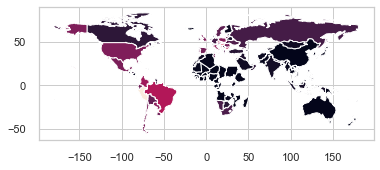

In [496]:
worldmerge.plot(column='covid_mortality_rate (per 100000)')

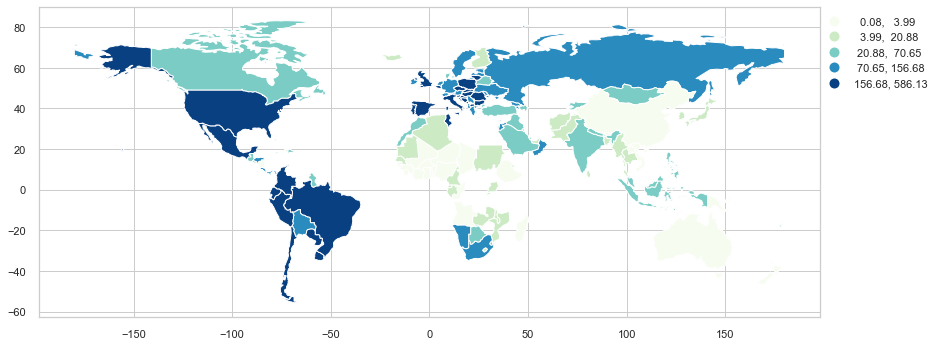

In [497]:
fig, ax = plt.subplots(figsize=(14,10), subplot_kw={'aspect':'equal'})
worldmerge.plot(column='covid_mortality_rate (per 100000)', scheme='Quantiles', k=5, cmap='GnBu', legend=True, ax=ax);
leg = ax.get_legend()
leg.set_bbox_to_anchor((0., 0., 1.15, 1.0))
#ax.set_xlim(150000, 160000)
#ax.set_ylim(208000, 215000)

#### 11.1 Spatial Autocorrelation 

In [498]:
#sometimes we see visually cluster patterns, but many times there is no statistical patterns, so it has to be tested
#spatial autocorrelation relates to the combination of two types of similarity: 
#spatial similarity and attribute similarity

##### 11.1.1 Spatial Similarity 

In [499]:
#queen contiguity for spatial weights is defined

In [500]:
#w = Queen.from_dataframe(df, idVariable='name')

In [501]:
#knn1 = lps.weights.KNN.from_dataframe(df)
#queen = lps.weights.Queen.from_dataframe(df)

#symm_knn = lps.weights.WSP((knn1.sparse + knn1.sparse.T)>0).to_W()

#fully_connected = lps.weights.w_union(symm_knn, queen)

In [502]:
worldmerge

,name,Country Code,geometry,Country,Latitude,Longitude,HDI rank,Human Development Index 2019 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,GDP 2019 (US$),GDP per capita 2019 (US$),GDP growth 2019 (annual %),Inflation Rate 2019 (%),Unemployment Rate 2020 (%),Region,IncomeGroup,total_vaccinations,date,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop,covid_mortality_rate (per 100000)
0,Fiji,FJI,"MULTIPOLYGON (((180.00000 -16.06713, 180.00000...",Fiji,-18.0000,175.0000,93,0.743,67.44,14.427330,10.901630,13009.073110,5.496251e+09,6175.888720,-0.445335,1.773102,4.790000,East Asia & Pacific,Upper middle income,538439,2021-07-27,441171,97268.0,28295.0,12455,60.06,49.21,10.85,13894,Fiji,"27,497","+1,301",227.0,+9,"6,951",+245,"20,319",40,"305,970",903404,Australia/Oceania,"1,440",10.00,"22,492",25.127186
1,Canada,CAN,"MULTIPOLYGON (((-122.84000 49.00000, -122.9742...",Canada,60.0000,-95.0000,16,0.929,82.43,16.157890,13.366105,48527.035730,1.736426e+12,46194.725226,1.656041,1.949269,9.480000,North America,High income,48530223,2021-07-28,26878305,21651918.0,703726.0,542779,128.58,71.22,57.37,14381,Canada,"1,429,039",+356,26573.0,+3,"1,396,905",+259,"5,561",231,"38,351,116",38096547,North America,9,0.08,146,69.751728
2,United States of America,USA,"MULTIPOLYGON (((-122.84000 49.00000, -120.0000...",United States,38.0000,-97.0000,17,0.926,78.86,16.310390,13.413440,63825.657480,2.143323e+13,65297.517508,2.161176,1.812210,8.310000,North America,High income,343361524,2021-07-28,189494180,163588042.0,4629928.0,3384387,102.67,56.66,48.91,10120,USA,"35,494,551","+7,061",628152.0,+54,"29,604,525",+567,"5,261,874","9,051","527,202,813",333082557,North America,21,0.20,"15,798",188.587480
3,Papua New Guinea,PNG,"MULTIPOLYGON (((141.00021 -2.60015, 142.73525 ...",Papua New Guinea,-6.0000,147.0000,155,0.555,64.50,10.199261,4.660000,4301.098542,2.482911e+10,2829.170309,5.900000,3.637899,2.740000,East Asia & Pacific,Lower middle income,88343,2021-07-25,78399,9944.0,NaN,2025,0.99,0.88,0.11,226,Papua New Guinea,"17,670",NaN,192.0,NaN,"17,261",NaN,217,7,"145,959",9128111,Australia/Oceania,NaN,NaN,24,2.103392
4,Indonesia,IDN,"MULTIPOLYGON (((141.00021 -2.60015, 141.01706 ...",Indonesia,-5.0000,120.0000,107,0.718,71.72,13.606980,8.166680,11459.096920,1.119191e+12,4135.569263,5.024714,3.030587,4.110000,East Asia & Pacific,Upper middle income,64838074,2021-07-28,45734912,19103162.0,3087420.0,1054431,23.70,16.72,6.98,3855,Indonesia,"3,331,206","+43,479",90552.0,"+1,893","2,686,170","+45,494","554,484",NaN,"25,807,257",276619967,Asia,157,7.00,"2,004",32.735164
5,Chile,CHL,"MULTIPOLYGON (((-68.63401 -52.63637, -68.63335...",Chile,-30.0000,-71.0000,43,0.851,80.18,16.447550,10.582950,23261.297260,2.823182e+11,14896.453867,1.054443,2.557545,11.510000,Latin America & Caribbean,High income,25337393,2021-07-24,13772232,12068193.0,430286.0,298613,132.54,72.04,63.13,15621,Chile,"1,613,288","+1,371",35295.0,+119,"1,568,294","+1,058","9,699","1,516","18,538,716",19291941,South America,71,6.00,503,182.952042
6,Sudan,SDN,"POLYGON ((24.56737 8.22919, 23.80581 8.66632, ...",Sudan,15.0000,30.0000,170,0.510,65.31,7.884416,3.770000,3828.660219,3.051346e+10,441.505603,-2.503537,50.994052,17.709999,Sub-Saharan Africa,Low income,810560,2021-07-18,627833,182727.0,20715.0,14177,1.85,1.43,0.42,323,Sudan,"37,138",NaN,2776.0,NaN,"30,867",NaN,"3,495",NaN,"234,414",44942013,Africa,NaN,NaN,78,6.176848
7,Chad,TCD,"POLYGON ((23.83766 19.58047, 23.88689 15.61084...",Chad,15.0000,19.0000,187,0.398,54.24,7.349350,2.523680,1555.373575,1.131495e+10,709.540310,3.2

In [503]:
df = worldmerge
wq =  lps.weights.Queen.from_dataframe(df, idVariable = 'Country Code')
wq.transform = 'r'

('WARNING: ', 'FJI', ' is an island (no neighbors)')
('WARNING: ', 'BHS', ' is an island (no neighbors)')
('WARNING: ', 'JAM', ' is an island (no neighbors)')
('WARNING: ', 'MDG', ' is an island (no neighbors)')
('WARNING: ', 'VUT', ' is an island (no neighbors)')
('WARNING: ', 'KOR', ' is an island (no neighbors)')
('WARNING: ', 'SLB', ' is an island (no neighbors)')
('WARNING: ', 'NZL', ' is an island (no neighbors)')
('WARNING: ', 'AUS', ' is an island (no neighbors)')
('WARNING: ', 'LKA', ' is an island (no neighbors)')
('WARNING: ', 'ISL', ' is an island (no neighbors)')
('WARNING: ', 'PHL', ' is an island (no neighbors)')
('WARNING: ', 'JPN', ' is an island (no neighbors)')
('WARNING: ', 'CYP', ' is an island (no neighbors)')


C:\Users\andre\anaconda3\lib\site-packages\libpysal\weights\weights.py:172: UserWarning:

The weights matrix is not fully connected: 
 There are 21 disconnected components.
 There are 14 islands with ids: AUS, BHS, CYP, FJI, ISL, JAM, JPN, KOR, LKA, MDG, NZL, PHL, SLB, VUT.



In [504]:
df = worldmerge
wq =  lps.weights.Queen.from_dataframe(df)
wq.transform = 'r'

('WARNING: ', 0, ' is an island (no neighbors)')
('WARNING: ', 11, ' is an island (no neighbors)')
('WARNING: ', 29, ' is an island (no neighbors)')
('WARNING: ', 56, ' is an island (no neighbors)')
('WARNING: ', 66, ' is an island (no neighbors)')
('WARNING: ', 71, ' is an island (no neighbors)')
('WARNING: ', 105, ' is an island (no neighbors)')
('WARNING: ', 106, ' is an island (no neighbors)')
('WARNING: ', 107, ' is an island (no neighbors)')
('WARNING: ', 108, ' is an island (no neighbors)')
('WARNING: ', 113, ' is an island (no neighbors)')
('WARNING: ', 116, ' is an island (no neighbors)')
('WARNING: ', 123, ' is an island (no neighbors)')
('WARNING: ', 126, ' is an island (no neighbors)')


C:\Users\andre\anaconda3\lib\site-packages\libpysal\weights\weights.py:172: UserWarning:

The weights matrix is not fully connected: 
 There are 21 disconnected components.
 There are 14 islands with ids: 0, 11, 29, 56, 66, 71, 105, 106, 107, 108, 113, 116, 123, 126.



In [476]:
pd.set_option('display.max_rows', None)

In [505]:
worldmerge

,name,Country Code,geometry,Country,Latitude,Longitude,HDI rank,Human Development Index 2019 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,GDP 2019 (US$),GDP per capita 2019 (US$),GDP growth 2019 (annual %),Inflation Rate 2019 (%),Unemployment Rate 2020 (%),Region,IncomeGroup,total_vaccinations,date,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop,covid_mortality_rate (per 100000)
0,Fiji,FJI,"MULTIPOLYGON (((180.00000 -16.06713, 180.00000...",Fiji,-18.0000,175.0000,93,0.743,67.44,14.427330,10.901630,13009.073110,5.496251e+09,6175.888720,-0.445335,1.773102,4.790000,East Asia & Pacific,Upper middle income,538439,2021-07-27,441171,97268.0,28295.0,12455,60.06,49.21,10.85,13894,Fiji,"27,497","+1,301",227.0,+9,"6,951",+245,"20,319",40,"305,970",903404,Australia/Oceania,"1,440",10.00,"22,492",25.127186
1,Canada,CAN,"MULTIPOLYGON (((-122.84000 49.00000, -122.9742...",Canada,60.0000,-95.0000,16,0.929,82.43,16.157890,13.366105,48527.035730,1.736426e+12,46194.725226,1.656041,1.949269,9.480000,North America,High income,48530223,2021-07-28,26878305,21651918.0,703726.0,542779,128.58,71.22,57.37,14381,Canada,"1,429,039",+356,26573.0,+3,"1,396,905",+259,"5,561",231,"38,351,116",38096547,North America,9,0.08,146,69.751728
2,United States of America,USA,"MULTIPOLYGON (((-122.84000 49.00000, -120.0000...",United States,38.0000,-97.0000,17,0.926,78.86,16.310390,13.413440,63825.657480,2.143323e+13,65297.517508,2.161176,1.812210,8.310000,North America,High income,343361524,2021-07-28,189494180,163588042.0,4629928.0,3384387,102.67,56.66,48.91,10120,USA,"35,494,551","+7,061",628152.0,+54,"29,604,525",+567,"5,261,874","9,051","527,202,813",333082557,North America,21,0.20,"15,798",188.587480
3,Papua New Guinea,PNG,"MULTIPOLYGON (((141.00021 -2.60015, 142.73525 ...",Papua New Guinea,-6.0000,147.0000,155,0.555,64.50,10.199261,4.660000,4301.098542,2.482911e+10,2829.170309,5.900000,3.637899,2.740000,East Asia & Pacific,Lower middle income,88343,2021-07-25,78399,9944.0,NaN,2025,0.99,0.88,0.11,226,Papua New Guinea,"17,670",NaN,192.0,NaN,"17,261",NaN,217,7,"145,959",9128111,Australia/Oceania,NaN,NaN,24,2.103392
4,Indonesia,IDN,"MULTIPOLYGON (((141.00021 -2.60015, 141.01706 ...",Indonesia,-5.0000,120.0000,107,0.718,71.72,13.606980,8.166680,11459.096920,1.119191e+12,4135.569263,5.024714,3.030587,4.110000,East Asia & Pacific,Upper middle income,64838074,2021-07-28,45734912,19103162.0,3087420.0,1054431,23.70,16.72,6.98,3855,Indonesia,"3,331,206","+43,479",90552.0,"+1,893","2,686,170","+45,494","554,484",NaN,"25,807,257",276619967,Asia,157,7.00,"2,004",32.735164
5,Chile,CHL,"MULTIPOLYGON (((-68.63401 -52.63637, -68.63335...",Chile,-30.0000,-71.0000,43,0.851,80.18,16.447550,10.582950,23261.297260,2.823182e+11,14896.453867,1.054443,2.557545,11.510000,Latin America & Caribbean,High income,25337393,2021-07-24,13772232,12068193.0,430286.0,298613,132.54,72.04,63.13,15621,Chile,"1,613,288","+1,371",35295.0,+119,"1,568,294","+1,058","9,699","1,516","18,538,716",19291941,South America,71,6.00,503,182.952042
6,Sudan,SDN,"POLYGON ((24.56737 8.22919, 23.80581 8.66632, ...",Sudan,15.0000,30.0000,170,0.510,65.31,7.884416,3.770000,3828.660219,3.051346e+10,441.505603,-2.503537,50.994052,17.709999,Sub-Saharan Africa,Low income,810560,2021-07-18,627833,182727.0,20715.0,14177,1.85,1.43,0.42,323,Sudan,"37,138",NaN,2776.0,NaN,"30,867",NaN,"3,495",NaN,"234,414",44942013,Africa,NaN,NaN,78,6.176848
7,Chad,TCD,"POLYGON ((23.83766 19.58047, 23.88689 15.61084...",Chad,15.0000,19.0000,187,0.398,54.24,7.349350,2.523680,1555.373575,1.131495e+10,709.540310,3.2

In [506]:
worldmerge.drop(worldmerge.index[[0, 11, 29, 56, 66, 71, 105, 106, 107, 108, 113, 116, 123, 126]], axis = 0, inplace = True)

In [507]:
worldmerge.reset_index(drop=True, inplace = True)

In [508]:
df = worldmerge
wq =  lps.weights.Queen.from_dataframe(df, idVariable = 'Country Code')
wq.transform = 'r'

C:\Users\andre\anaconda3\lib\site-packages\libpysal\weights\weights.py:172: UserWarning:

The weights matrix is not fully connected: 
 There are 7 disconnected components.



##### 11.1.2 Attribute Similarity 

In [509]:
#the spatial weight between neighborhoods i and j indicates if the two are neighbors 
#The spatial lag is a derived variable that is a measure of attribute of similarity that pairs up with the concept of spatial similarity
#the spatial lag for neighborhood i is as showed in the equation below

$$ 
ylag_{i} = \sum_{j}w_{i,j}y_{j}
$$

In [425]:
#so, the spatial lag = average of the neighbors 

In [510]:
y = df['covid_mortality_rate (per 100000)']
ylag = lps.weights.lag_spatial(wq, y)

In [511]:
ylag

array([100.77002723, 160.58832491,  56.15765953, 132.22933074,
         2.07095436,  44.04920478,  90.5390097 ,  44.6087681 ,
       183.62722893,  95.6323929 ,  82.21573767,  68.75668305,
       119.33521383,  68.16778066, 140.85008788, 119.34463962,
       311.65575932,  43.19467612, 165.48564632, 297.2163051 ,
        22.30689416, 128.06476599, 145.55876157,  36.52145167,
       109.97284072,  82.0368216 , 101.20235086,  98.51496658,
        41.36498794,  60.66927879,   2.59084892,   7.65632155,
       116.25830514,  87.87776784, 128.62226559, 129.06953739,
        93.09405177, 107.31521105, 193.49045789,  46.90599993,
        96.97831099,  90.42788932, 143.44563037,  63.30439576,
        43.82472929,  23.4751378 ,  28.76149248,  35.35036514,
        20.75541819, 258.32330103,  63.45751028,  63.03599762,
         0.8666425 ,  60.53266101, 179.05286775, 175.70493893,
         3.66764586,  13.88781   ,  30.30194148,  34.66640752,
        13.69377409,  77.01741856,   9.83835097, 175.18

In [512]:
import mapclassify as mc
ylagq5 = mc.Quantiles(ylag, k=5)

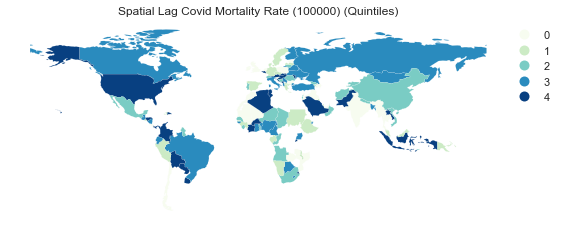

In [515]:
f, ax = plt.subplots(1, figsize=(9, 9))
df.assign(cl=ylagq5.yb).plot(column='cl', categorical=True, \
        k=5, cmap='GnBu', linewidth=0.1, ax=ax, \
        edgecolor='white', legend=True)
ax.set_axis_off()
leg = ax.get_legend()
leg.set_bbox_to_anchor((0., 0., 1.1, 1.0))
plt.title('Spatial Lag Covid Mortality Rate (100000) (Quintiles)')

plt.show()

In [516]:
#the quintile map for the spatial lag makes us think there's similarity in space

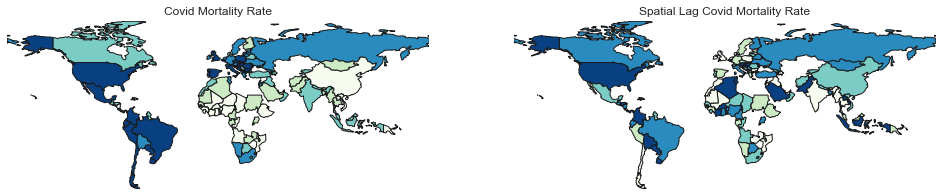

In [517]:
df['lag_coviddeathrate'] = ylag
f,ax = plt.subplots(1,2,figsize=(4.16*4,4))
df.plot(column='covid_mortality_rate (per 100000)', ax=ax[0], edgecolor='k',
        scheme='quantiles',  k=5, cmap='GnBu')
ax[0].axis(df.total_bounds[np.asarray([0,2,1,3])])
ax[0].set_title('Covid Mortality Rate')
df.plot(column='lag_coviddeathrate', ax=ax[1], edgecolor='k',
        scheme='quantiles', cmap='GnBu', k=5)
ax[1].axis(df.total_bounds[np.asarray([0,2,1,3])])
ax[1].set_title('Spatial Lag Covid Mortality Rate')
ax[0].axis('off')
ax[1].axis('off')
plt.show()

In [518]:
#on the left are the values of covid mortality rate and neighbors
#on the right are weighted average of covid death rates' neighbors, which is the spatial lag

#### 11.2 Global Spatial Autocorrelation 

In [519]:
#converting the attribute to a binary case to see it easitly 

In [520]:
y.median()

51.057666301455384

In [521]:
yb = y > y.median()
sum(yb)

61

In [522]:
sum(y < y.median())

61

In [523]:
#there are 61 neighborhoods with covid death rate above the median and 61 (122-61=61) below the median

In [524]:
y

0       69.751728
1      188.587480
2        2.103392
3       32.735164
4      182.952042
5        6.176848
6        1.027866
7        4.718091
8       36.080471
9      107.517327
10       1.932689
11     118.836088
12      17.311296
13     183.778638
14     170.651597
15     258.323301
16     149.906707
17     586.130646
18     232.788391
19     154.784296
20      97.143586
21       2.906585
22      77.017419
23      39.854133
24      55.961486
25      67.035997
26     171.766596
27      61.814602
28     114.668184
29       7.656322
30       2.544010
31      11.443488
32       0.866642
33       0.775689
34       1.010913
35       4.895255
36       1.767656
37       2.590849
38       1.204053
39       1.561499
40       3.667646
41       1.472347
42       0.785519
43       3.125546
44       7.143530
45       8.470684
46      17.720517
47       7.941094
48       4.312032
49      65.642306
50       2.945039
51      69.333047
52     116.258305
53       8.517309
54     161.793830
55       9

In [525]:
yb = y > y.median()
labels = ['0 Low', '1 High']
yb = [labels[i] for i in 1*yb] 
df['yb'] = yb

<AxesSubplot:>

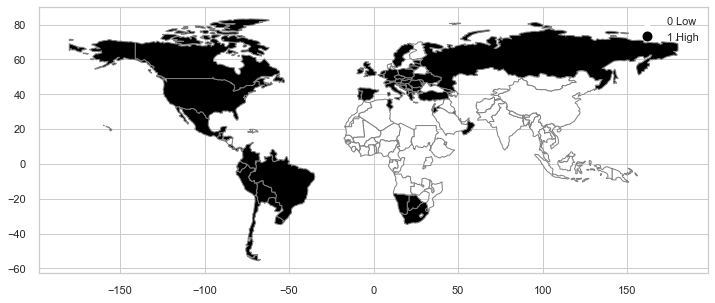

In [526]:
fig, ax = plt.subplots(figsize=(12,10), subplot_kw={'aspect':'equal'})
df.plot(column='yb', cmap='binary', edgecolor='grey', legend=True, ax=ax)

#### 11.2.1 Join counts 

In [527]:
# a join is a way to formalize a test for spatial autocorrelation in a binary attribute, it also exists for each 
#neighbor pair of observations, and the joins are reflected in the binary spatial weights object wq
#each unit can take either Black (B) or White (W), there are three type of joins, BB (black black), WW (white white), BW (black white or white black)
#finding out what is the number of BB joins if the 65 black polygons were randomly assingned on the map

In [528]:
import esda 
yb = 1 * (y > y.median()) # convert back to binary
wq =  lps.weights.Queen.from_dataframe(df)
wq.transform = 'b'
np.random.seed(12345)
jc = esda.join_counts.Join_Counts(yb, wq)

C:\Users\andre\anaconda3\lib\site-packages\libpysal\weights\weights.py:172: UserWarning:

The weights matrix is not fully connected: 
 There are 7 disconnected components.



In [529]:
jc.bb

89.0

In [530]:
jc.ww

76.0

In [531]:
jc.bw

32.0

In [532]:
jc.bb + jc.ww + jc.bw #all possibilites

197.0

In [533]:
wq.s0 / 2 #unique number of joins in the spatial weights object

197.0

In [535]:
jc.bb #there are 89 BB joins

89.0

In [536]:
jc.mean_bb #The average number of BB joins from the synthetic realizations is

48.688688688688686

In [537]:
#less than the observed count, but is it enought to reject the null of complete spatial randomness(CSR)

In [538]:
jc.p_sim_bb #the pseudo p-value summarizes that the observed value is extremely high, it'a bellow 1%, rejecting null of CSR, 
#meaning there's autocorrelation in covid death rate

0.001

##### 11.2.2 Continuous Case 

In [539]:
#transforming the weights to be row-standardized from the current binary state

In [540]:
wq.transform = 'r'

In [541]:
y = df['covid_mortality_rate (per 100000)']

In [542]:
#Moran's I is a test for global autocorrelation for a continuous attribute

In [543]:
np.random.seed(12345)
mi = esda.moran.Moran(y, wq)
mi.I

0.6286732096554036

Text(0.5, 0, "Moran's I")

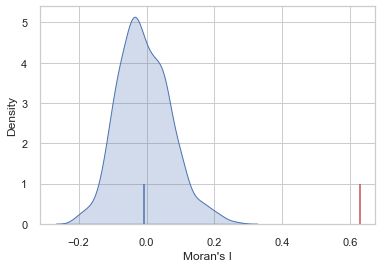

In [544]:
import seaborn as sbn
sbn.kdeplot(mi.sim, shade=True)
plt.vlines(mi.I, 0, 1, color='r')
plt.vlines(mi.EI, 0,1)
plt.xlabel('Moran\'s I')

In [545]:
mi.p_sim

0.001

#### 11.3 Local Autocorrelation: Hot Spots, Cold Spots, and Spatial Outliers 

In [460]:
#local Moran statistic

In [546]:
np.random.seed(12345)
import esda

In [547]:
wq.transform = 'r'
lag_coviddeathrate = lps.weights.lag_spatial(wq, df['covid_mortality_rate (per 100000)'])

In [548]:
df.rename({'covid_mortality_rate (per 100000)':'coviddeathrate'}, axis = 1, inplace = True)

In [549]:
df.head(3)

,name,Country Code,geometry,Country,Latitude,Longitude,HDI rank,Human Development Index 2019 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,GDP 2019 (US$),GDP per capita 2019 (US$),GDP growth 2019 (annual %),Inflation Rate 2019 (%),Unemployment Rate 2020 (%),Region,IncomeGroup,total_vaccinations,date,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop,coviddeathrate,lag_coviddeathrate,yb
0,Canada,CAN,"MULTIPOLYGON (((-122.84000 49.00000, -122.9742...",Canada,60.0,-95.0,16,0.929,82.43,16.157890,13.366105,48527.035730,1.736426e+12,46194.725226,1.656041,1.949269,9.48,North America,High income,48530223,2021-07-28,26878305,21651918.0,703726.0,542779,128.58,71.22,57.37,14381,Canada,"1,429,039",+356,26573.0,+3,"1,396,905",+259,"5,561",231,"38,351,116",38096547,North America,9,0.08,146,69.751728,100.770027,1 High
1,United States of America,USA,"MULTIPOLYGON (((-122.84000 49.00000, -120.0000...",United States,38.0,-97.0,17,0.926,78.86,16.310390,13.413440,63825.657480,2.143323e+13,65297.517508,2.161176,1.812210,8.31,North America,High income,343361524,2021-07-28,189494180,163588042.0,4629928.0,3384387,102.67,56.66,48.91,10120,USA,"35,494,551","+7,061",628152.0,+54,"29,604,525",+567,"5,261,874","9,051","527,202,813",333082557,North America,21,0.20,"15,798",188.587480,160.588325,1 High
2,Papua New Guinea,PNG,"MULTIPOLYGON (((141.00021 -2.60015, 142.73525 ...",Papua New Guinea,-6.0,147.0,155,0.555,64.50,10.199261,4.660000,4301.098542,2.482911e+10,2829.170309,5.900000,3.637899,2.74,East Asia & Pacific,Lower middle income,88343,2021-07-25,78399,9944.0,NaN,2025,0.99,0.88,0.11,226,Papua New Guinea,"17,670",NaN,192.0,NaN,"17,261",NaN,217,7,"145,959",9128111,Australia/Oceania,NaN,NaN,24,2.103392,56.157660,0 Low


In [550]:
#df = df[df.coviddeathrate != 0]
#df = df[df.lag_coviddeathrate !=0]
df = df.dropna(axis=0, subset=['coviddeathrate','lag_coviddeathrate'])

In [551]:
df = df[df['lag_coviddeathrate']!=0]

In [552]:
df['coviddeathrate'].values.reshape(-1,1) #when plotting the graph below there was an error expected x and y to have same length
#that's why the need to reshape, but this would be 2d, it has to be 1d, many errors where found when doing the plotting below
#what worked was reshaping x and y to 1d with values.reshape(-1)

array([[6.97517284e+01],
       [1.88587480e+02],
       [2.10339248e+00],
       [3.27351641e+01],
       [1.82952042e+02],
       [6.17684838e+00],
       [1.02786561e+00],
       [4.71809062e+00],
       [3.60804715e+01],
       [1.07517327e+02],
       [1.93268891e+00],
       [1.18836088e+02],
       [1.73112965e+01],
       [1.83778638e+02],
       [1.70651597e+02],
       [2.58323301e+02],
       [1.49906707e+02],
       [5.86130646e+02],
       [2.32788391e+02],
       [1.54784296e+02],
       [9.71435859e+01],
       [2.90658461e+00],
       [7.70174186e+01],
       [3.98541330e+01],
       [5.59614855e+01],
       [6.70359971e+01],
       [1.71766596e+02],
       [6.18146020e+01],
       [1.14668184e+02],
       [7.65632155e+00],
       [2.54400957e+00],
       [1.14434883e+01],
       [8.66642497e-01],
       [7.75689031e-01],
       [1.01091295e+00],
       [4.89525458e+00],
       [1.76765579e+00],
       [2.59084892e+00],
       [1.20405296e+00],
       [1.56149943e+00],


In [553]:
df['coviddeathrate'].values.reshape(-1)

array([6.97517284e+01, 1.88587480e+02, 2.10339248e+00, 3.27351641e+01,
       1.82952042e+02, 6.17684838e+00, 1.02786561e+00, 4.71809062e+00,
       3.60804715e+01, 1.07517327e+02, 1.93268891e+00, 1.18836088e+02,
       1.73112965e+01, 1.83778638e+02, 1.70651597e+02, 2.58323301e+02,
       1.49906707e+02, 5.86130646e+02, 2.32788391e+02, 1.54784296e+02,
       9.71435859e+01, 2.90658461e+00, 7.70174186e+01, 3.98541330e+01,
       5.59614855e+01, 6.70359971e+01, 1.71766596e+02, 6.18146020e+01,
       1.14668184e+02, 7.65632155e+00, 2.54400957e+00, 1.14434883e+01,
       8.66642497e-01, 7.75689031e-01, 1.01091295e+00, 4.89525458e+00,
       1.76765579e+00, 2.59084892e+00, 1.20405296e+00, 1.56149943e+00,
       3.66764586e+00, 1.47234711e+00, 7.85518716e-01, 3.12554631e+00,
       7.14353017e+00, 8.47068352e+00, 1.77205172e+01, 7.94109367e+00,
       4.31203166e+00, 6.56423057e+01, 2.94503950e+00, 6.93330474e+01,
       1.16258305e+02, 8.51730922e+00, 1.61793830e+02, 9.37193368e+00,
      

In [554]:
df

,name,Country Code,geometry,Country,Latitude,Longitude,HDI rank,Human Development Index 2019 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,GDP 2019 (US$),GDP per capita 2019 (US$),GDP growth 2019 (annual %),Inflation Rate 2019 (%),Unemployment Rate 2020 (%),Region,IncomeGroup,total_vaccinations,date,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop,coviddeathrate,lag_coviddeathrate,yb
0,Canada,CAN,"MULTIPOLYGON (((-122.840 49.000, -122.974 49.0...",Canada,60.0000,-95.0000,16,0.929,82.43,16.157890,13.366105,48527.035730,1.736426e+12,46194.725226,1.656041,1.949269,9.480000,North America,High income,48530223,2021-07-28,26878305,21651918.0,703726.0,542779,128.58,71.22,57.37,14381,Canada,"1,429,039",+356,26573.0,+3,"1,396,905",+259,"5,561",231,"38,351,116",38096547,North America,9,0.08,146,69.751728,100.770027,1 High
1,United States of America,USA,"MULTIPOLYGON (((-122.840 49.000, -120.000 49.0...",United States,38.0000,-97.0000,17,0.926,78.86,16.310390,13.413440,63825.657480,2.143323e+13,65297.517508,2.161176,1.812210,8.310000,North America,High income,343361524,2021-07-28,189494180,163588042.0,4629928.0,3384387,102.67,56.66,48.91,10120,USA,"35,494,551","+7,061",628152.0,+54,"29,604,525",+567,"5,261,874","9,051","527,202,813",333082557,North America,21,0.20,"15,798",188.587480,160.588325,1 High
2,Papua New Guinea,PNG,"MULTIPOLYGON (((141.000 -2.600, 142.735 -3.289...",Papua New Guinea,-6.0000,147.0000,155,0.555,64.50,10.199261,4.660000,4301.098542,2.482911e+10,2829.170309,5.900000,3.637899,2.740000,East Asia & Pacific,Lower middle income,88343,2021-07-25,78399,9944.0,NaN,2025,0.99,0.88,0.11,226,Papua New Guinea,"17,670",NaN,192.0,NaN,"17,261",NaN,217,7,"145,959",9128111,Australia/Oceania,NaN,NaN,24,2.103392,56.157660,0 Low
3,Indonesia,IDN,"MULTIPOLYGON (((141.000 -2.600, 141.017 -5.859...",Indonesia,-5.0000,120.0000,107,0.718,71.72,13.606980,8.166680,11459.096920,1.119191e+12,4135.569263,5.024714,3.030587,4.110000,East Asia & Pacific,Upper middle income,64838074,2021-07-28,45734912,19103162.0,3087420.0,1054431,23.70,16.72,6.98,3855,Indonesia,"3,331,206","+43,479",90552.0,"+1,893","2,686,170","+45,494","554,484",NaN,"25,807,257",276619967,Asia,157,7.00,"2,004",32.735164,132.229331,0 Low
4,Chile,CHL,"MULTIPOLYGON (((-68.634 -52.636, -68.633 -54.8...",Chile,-30.0000,-71.0000,43,0.851,80.18,16.447550,10.582950,23261.297260,2.823182e+11,14896.453867,1.054443,2.557545,11.510000,Latin America & Caribbean,High income,25337393,2021-07-24,13772232,12068193.0,430286.0,298613,132.54,72.04,63.13,15621,Chile,"1,613,288","+1,371",35295.0,+119,"1,568,294","+1,058","9,699","1,516","18,538,716",19291941,South America,71,6.00,503,182.952042,2.070954,1 High
5,Sudan,SDN,"POLYGON ((24.567 8.229, 23.806 8.666, 23.459 8...",Sudan,15.0000,30.0000,170,0.510,65.31,7.884416,3.770000,3828.660219,3.051346e+10,441.505603,-2.503537,50.994052,17.709999,Sub-Saharan Africa,Low income,810560,2021-07-18,627833,182727.0,20715.0,14177,1.85,1.43,0.42,323,Sudan,"37,138",NaN,2776.0,NaN,"30,867",NaN,"3,495",NaN,"234,414",44942013,Africa,NaN,NaN,78,6.176848,44.049205,0 Low
6,Chad,TCD,"POLYGON ((23.838 19.580, 23.887 15.611, 23.025...",Chad,15.0000,19.0000,187,0.398,54.24,7.349350,2.523680,1555.373575,1.131495e+10,709.540310,3.247182,-0.971939,2.260000,Sub-Saharan Africa,Low income,28810,2021-07-21,21581,7229.0,NaN,1329,0.18,0.13,0.04,81,Chad,"4,972",NaN,174.0,NaN,"4,789",NaN,9,NaN,"130,796",16928283,Africa,NaN,NaN,0.5,1.027866,90.539010,0 Low
7,Haiti,HTI,"POLYGON ((-71.712 19.714, -71.625 19.170, -71....",Haiti,19.0000,-72.4167,170,0.510,64

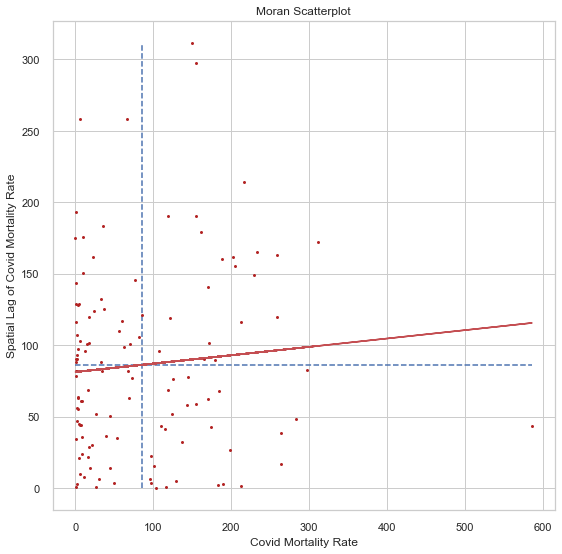

In [555]:
coviddeathrate = df['coviddeathrate'].values.reshape(-1)
lag_coviddeathrate = df['lag_coviddeathrate'].values.reshape(-1)
b, a = np.polyfit(coviddeathrate, lag_coviddeathrate, 1)
f, ax = plt.subplots(1, figsize=(9, 9))

plt.plot(coviddeathrate, lag_coviddeathrate, '.', color='firebrick')

 # dashed vert at mean of the price
plt.vlines(coviddeathrate.mean(), lag_coviddeathrate.min(), lag_coviddeathrate.max(), linestyle='--')
 # dashed horizontal at mean of lagged price 
plt.hlines(lag_coviddeathrate.mean(), coviddeathrate.min(), coviddeathrate.max(), linestyle='--')

# red line of best fit using global I as slope
plt.plot(coviddeathrate, a + b*coviddeathrate, 'r')
plt.title('Moran Scatterplot')
plt.ylabel('Spatial Lag of Covid Mortality Rate')
plt.xlabel('Covid Mortality Rate')
plt.show()

In [556]:
#instead of a single I statistic, there's an array of local Ii statistics, stored in the .Is attribute, and p-value from the simulation are in p_sim

In [557]:
#there might be spatial autocorrelation according to the graph,
#the positive slope means that neighbors of locations with large values have high values, and neighbors of locations
#with small values have small values

In [558]:
li = esda.moran.Moran_Local(y, wq)

In [559]:
li.q

array([2, 1, 3, 3, 1, 3, 3, 3, 3, 1, 3, 4, 2, 1, 1, 1, 1, 1, 1, 1, 4, 2,
       3, 3, 2, 2, 1, 3, 4, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3,
       3, 3, 3, 3, 3, 3, 3, 2, 4, 3, 4, 3, 4, 3, 3, 3, 3, 3, 3, 3, 3, 3,
       3, 3, 3, 3, 3, 3, 3, 3, 4, 4, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 2, 2, 1, 1, 1, 1, 1, 1, 1, 1, 3, 1, 2, 1, 2, 1, 3, 3, 1, 2, 1,
       1, 1, 3, 3, 3, 3, 3, 3, 1, 1, 2, 1])

In [560]:
#using conditional random permutations (different distributions for each focal location)

In [561]:
(li.p_sim < 0.05).sum()

40

In [560]:
#distinguishing the specific type of local spatial association reflected in the four quadrants of the Moran Scatterplot above:

In [562]:
sig = li.p_sim < 0.05
hotspot = sig * li.q==1
coldspot = sig * li.q==3
doughnut = sig * li.q==2
diamond = sig * li.q==4

In [563]:
spots = ['n.sig.', 'hot spot']
labels = [spots[i] for i in hotspot*1]

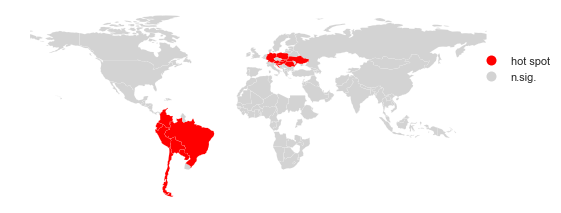

In [568]:
df = df
from matplotlib import colors
hmap = colors.ListedColormap(['red', 'lightgrey'])
f, ax = plt.subplots(1, figsize=(9, 9))
df.assign(cl=labels).plot(column='cl', categorical=True, \
        k=2, cmap=hmap, linewidth=0.1, ax=ax, \
        edgecolor='white', legend=True)
ax.set_axis_off()
leg = ax.get_legend()
leg.set_bbox_to_anchor((0., 0., 1.1, .8))
plt.show()

In [569]:
spots = ['n.sig.', 'cold spot']
labels = [spots[i] for i in coldspot*1]

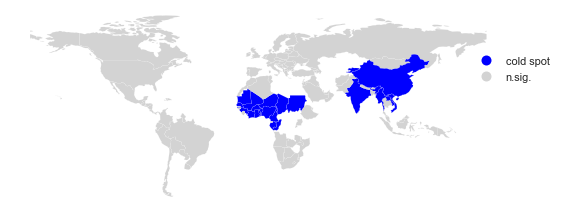

In [571]:
df = df
from matplotlib import colors
hmap = colors.ListedColormap(['blue', 'lightgrey'])
f, ax = plt.subplots(1, figsize=(9, 9))
df.assign(cl=labels).plot(column='cl', categorical=True, \
        k=2, cmap=hmap, linewidth=0.1, ax=ax, \
        edgecolor='white', legend=True)
ax.set_axis_off()
leg = ax.get_legend()
leg.set_bbox_to_anchor((0., 0., 1.1, .8))
plt.show()

In [572]:
spots = ['n.sig.', 'doughnut']
labels = [spots[i] for i in doughnut*1]

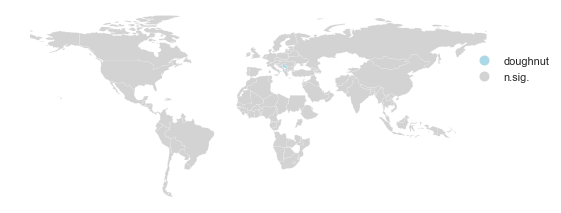

In [574]:
df = df
from matplotlib import colors
hmap = colors.ListedColormap(['lightblue', 'lightgrey'])
f, ax = plt.subplots(1, figsize=(9, 9))
df.assign(cl=labels).plot(column='cl', categorical=True, \
        k=2, cmap=hmap, linewidth=0.1, ax=ax, \
        edgecolor='white', legend=True)
ax.set_axis_off()
leg = ax.get_legend()
leg.set_bbox_to_anchor((0., 0., 1.1, .8))
plt.show()

In [575]:
spots = ['n.sig.', 'diamond']
labels = [spots[i] for i in diamond*1]

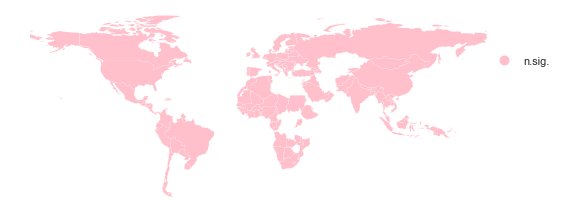

In [577]:
df = df
from matplotlib import colors
hmap = colors.ListedColormap(['pink', 'lightgrey'])
f, ax = plt.subplots(1, figsize=(9, 9))
df.assign(cl=labels).plot(column='cl', categorical=True, \
        k=2, cmap=hmap, linewidth=0.1, ax=ax, \
        edgecolor='white', legend=True)
ax.set_axis_off()
leg = ax.get_legend()
leg.set_bbox_to_anchor((0., 0., 1.1, .8))
plt.show()

In [578]:
sig = 1 * (li.p_sim < 0.05)
hotspot = 1 * (sig * li.q==1)
coldspot = 3 * (sig * li.q==3)
doughnut = 2 * (sig * li.q==2)
diamond = 4 * (sig * li.q==4)
spots = hotspot + coldspot + doughnut + diamond
spots

array([0, 0, 0, 0, 1, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0,
       0, 0, 0, 0, 1, 0, 0, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 0, 0, 3, 3,
       3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 3, 3,
       0, 3, 0, 0, 0, 0, 0, 3, 0, 0, 0, 1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0,
       0, 0, 2, 1, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1,
       0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0])

In [579]:
spot_labels = [ '0 ns', '1 hot spot', '2 doughnut', '3 cold spot', '4 diamond']
labels = [spot_labels[i] for i in spots]

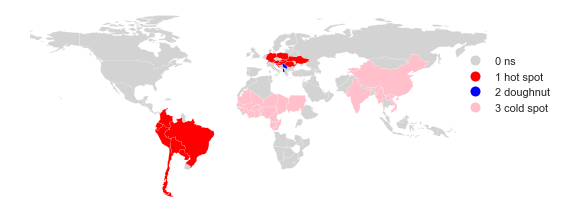

In [581]:
from matplotlib import colors
hmap = colors.ListedColormap([ 'lightgrey', 'red', 'lightblue', 'blue', 'pink'])
f, ax = plt.subplots(1, figsize=(9, 9))
df.assign(cl=labels).plot(column='cl', categorical=True, \
        k=2, cmap=hmap, linewidth=0.1, ax=ax, \
        edgecolor='white', legend=True)
ax.set_axis_off()
leg = ax.get_legend()
leg.set_bbox_to_anchor((0., 0., 1.1, .8))
plt.show()

### 12. Machine Learning

![](https://www.datacatchup.com/wp-content/uploads/2019/05/image.png)
![](https://static.javatpoint.com/tutorial/machine-learning/images/difference-between-supervised-and-unsupervised-learning.jpg)
![](https://miro.medium.com/max/1400/1*6iDmbHflsN6NULBLpVHA6A.png)
![](https://scikit-learn.org/stable/_static/ml_map.png)

In [582]:
import os
import pandas as pd

from sklearn import model_selection
from sklearn.metrics import accuracy_score
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC

import matplotlib.pyplot as plt

from pandas.plotting import scatter_matrix
from sklearn.metrics import confusion_matrix

In [583]:
#the model used below is classification, a subset of supervised learning 

#### 12.1 SVC (Support Vector Classifier)

In [584]:
covidvisual = pd.read_excel('C:/Users/andre/Documents/Programming Languages/Python/pimespython/Project/covidwebscraping/actualcovid19project/covidvisual.xlsx')

In [585]:
#pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)

In [586]:
covidvisual.head(3)

,Country,Country Code,Latitude,Longitude,HDI rank,Human Development Index 2019 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,GDP 2019 (US$),GDP per capita 2019 (US$),GDP growth 2019 (annual %),Inflation Rate 2019 (%),Unemployment Rate 2020 (%),Region,IncomeGroup,total_vaccinations,date,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop,covid_mortality_rate (per 100000)
0,Afghanistan,AFG,33.0,65.0,169,0.511,64.83,10.176430,3.930000,2229.362021,1.929110e+10,507.103432,3.911603,2.302373,11.73,South Asia,Low income,1277085,2021-07-27,939835,219159.0,4015.0,22461,3.28,2.41,0.56,577,Afghanistan,"146,523",+527,6677.0,+62,"96,692",+966,"43,154","1,124","701,952",39864282,Asia,13,2.0,"1,083",16.749330
1,Albania,ALB,41.0,20.0,69,0.795,78.57,14.695620,10.145730,13998.299890,1.527918e+10,5353.244856,2.240070,1.411091,11.70,Europe & Central Asia,Upper middle income,1138771,2021-07-25,640047,498724.0,23655.0,17565,39.57,22.24,17.33,6104,Albania,"132,999",+47,2457.0,NaN,"130,187",+13,355,3,"916,777",2874426,Europe,16,NaN,124,85.477935
2,Algeria,DZA,28.0,3.0,91,0.748,76.88,14.604302,7.986548,11173.956810,1.710913e+11,3973.964072,0.800000,1.951768,12.83,Middle East & North Africa,Lower middle income,75000,2021-02-19,75000,NaN,30.0,3748,0.17,0.17,NaN,85,Algeria,"168,668","+1,537",4189.0,+28,"113,707",+807,"50,772",37,"230,861",44697286,Africa,34,0.6,"1,136",9.371934


In [587]:
covidvisual.isnull().sum()

Country                                    0
Country Code                               0
Latitude                                   0
Longitude                                  0
HDI rank                                   0
Human Development Index 2019 (HDI)         0
Life expectancy at birth                   0
Expected years of schooling                0
Mean years of schooling                    0
Gross national income (GNI) per capita     0
GDP 2019 (US$)                             0
GDP per capita 2019 (US$)                  0
GDP growth 2019 (annual %)                 0
Inflation Rate 2019 (%)                    0
Unemployment Rate 2020 (%)                 0
Region                                     0
IncomeGroup                                0
total_vaccinations                         0
date                                       0
people_vaccinated                          0
people_fully_vaccinated                    5
daily_vaccinations_raw                    26
daily_vacc

In [588]:
covidvisual.shape

(148, 43)

In [589]:
covidvisual.columns

Index(['Country', 'Country Code', 'Latitude', 'Longitude', 'HDI rank',
       'Human Development Index 2019 (HDI)', 'Life expectancy at birth',
       'Expected years of schooling', 'Mean years of schooling',
       'Gross national income (GNI) per capita', 'GDP 2019 (US$)',
       'GDP per capita 2019 (US$)', 'GDP growth 2019 (annual %)',
       'Inflation Rate 2019 (%)', 'Unemployment Rate 2020 (%)', 'Region',
       'IncomeGroup', 'total_vaccinations', 'date', 'people_vaccinated',
       'people_fully_vaccinated', 'daily_vaccinations_raw',
       'daily_vaccinations', 'total_vaccinations_per_hundred',
       'people_vaccinated_per_hundred', 'people_fully_vaccinated_per_hundred',
       'daily_vaccinations_per_million', 'Country,Other', 'TotalCases',
       'NewCases', 'TotalDeaths', 'NewDeaths', 'TotalRecovered',
       'NewRecovered', 'ActiveCases', 'Serious,Critical', 'TotalTests',
       'Population', 'Continent', 'New Cases/1M pop', 'New Deaths/1M pop',
       'Active Cases/1M p

In [590]:
dataset = covidvisual.loc[:, ['total_vaccinations_per_hundred',
                              'daily_vaccinations_per_million','covid_mortality_rate (per 100000)',
                              'Human Development Index 2019 (HDI)','GDP per capita 2019 (US$)',
                              'IncomeGroup']]

In [591]:
dataset.head(3)

,total_vaccinations_per_hundred,daily_vaccinations_per_million,covid_mortality_rate (per 100000),Human Development Index 2019 (HDI),GDP per capita 2019 (US$),IncomeGroup
0,3.28,577,16.749330,0.511,507.103432,Low income
1,39.57,6104,85.477935,0.795,5353.244856,Upper middle income
2,0.17,85,9.371934,0.748,3973.964072,Lower middle income


In [592]:
dataset = dataset.dropna()

In [593]:
dataset

,total_vaccinations_per_hundred,daily_vaccinations_per_million,covid_mortality_rate (per 100000),Human Development Index 2019 (HDI),GDP per capita 2019 (US$),IncomeGroup
0,3.28,577,16.749330,0.511,507.103432,Low income
1,39.57,6104,85.477935,0.795,5353.244856,Upper middle income
2,0.17,85,9.371934,0.748,3973.964072,Lower middle income
3,4.85,1025,2.945039,0.581,2790.726615,Lower middle income
4,5.15,1108,155.059542,0.776,4622.733493,Upper middle income
5,45.47,6295,3.575226,0.944,55060.326101,High income
6,106.08,10183,118.490761,0.922,50137.662776,High income
7,46.49,6370,49.027820,0.756,4793.587020,Upper middle income
8,26.23,4295,71.991885,0.814,34863.742098,High income
9,134.44,12931,78.377945,0.852,23503.977127,High income


In [594]:
len(dataset)

146

In [595]:
dataset.shape

(146, 6)

In [596]:
dataset.describe()

,total_vaccinations_per_hundred,daily_vaccinations_per_million,covid_mortality_rate (per 100000),Human Development Index 2019 (HDI),GDP per capita 2019 (US$)
count,146.000000,146.000000,146.000000,146.000000,146.000000
mean,49.375822,7866.547945,76.942679,0.737795,16290.697320
std,45.474383,11042.225236,91.348137,0.151637,20977.150856
min,0.040000,35.000000,0.081207,0.394000,411.552340
25%,6.135000,1704.000000,6.262207,0.611000,2544.901758
50%,36.730000,6363.500000,36.217263,0.760000,6519.131315
75%,88.685000,10832.500000,124.906197,0.858500,23223.993553
max,170.010000,118759.000000,586.130646,0.957000,114704.594171


In [597]:
print(dataset.groupby('IncomeGroup').size())

IncomeGroup
High income            52
Low income             18
Lower middle income    38
Upper middle income    38
dtype: int64


In [598]:
dataset.drop(dataset.loc[dataset['IncomeGroup']=='Low income'].index, inplace=True)

In [599]:
print(dataset.groupby('IncomeGroup').size())

IncomeGroup
High income            52
Lower middle income    38
Upper middle income    38
dtype: int64


In [600]:
dataset=dataset.groupby('IncomeGroup', as_index=False, group_keys=False).apply(lambda x: x.sample(n=35))

In [601]:
print(dataset.groupby('IncomeGroup').size())

IncomeGroup
High income            35
Lower middle income    35
Upper middle income    35
dtype: int64


In [602]:
len(dataset)

105

In [603]:
dataset

,total_vaccinations_per_hundred,daily_vaccinations_per_million,covid_mortality_rate (per 100000),Human Development Index 2019 (HDI),GDP per capita 2019 (US$),IncomeGroup
85,170.01,17115,95.527592,0.895,29820.603247,High income
103,36.96,8463,72.714433,0.813,15343.062004,High income
111,116.24,14660,170.490303,0.864,23252.058518,High income
125,82.17,9629,212.961916,0.917,25946.182185,High income
72,55.62,9549,53.087513,0.806,32000.448469,High income
36,123.58,15390,43.824729,0.940,60170.342637,High income
20,34.31,7365,0.678788,0.838,31086.751119,High income
97,115.27,14030,103.723170,0.944,52331.316728,High income
112,129.50,12962,21.404620,0.848,62088.061828,High income
144,136.54,14188,170.651597,0.817,16190.126957,High income


In [604]:
#datasetrand = dataset.sample(frac=1)
#The frac keyword argument specifies the fraction of rows to return in the random sample, so frac=1 means return all rows (in random order)
#but in order to work in my case it needs to be in order like it is and not shuffled, otherwise it won't run later

In [605]:
import statsmodels.api as sm
import statsmodels.formula.api as smf

In [606]:
dummie_class = pd.get_dummies(dataset['IncomeGroup'],prefix='IncomeGroup')

In [607]:
dummie_class

,IncomeGroup_High income,IncomeGroup_Lower middle income,IncomeGroup_Upper middle income
85,1,0,0
103,1,0,0
111,1,0,0
125,1,0,0
72,1,0,0
36,1,0,0
20,1,0,0
97,1,0,0
112,1,0,0
144,1,0,0


In [608]:
Y = dummie_class['IncomeGroup_High income']

In [609]:
Y.sample(n=10) # 1 is high income, 0 it's not

90     0
146    0
137    0
142    1
41     0
132    1
101    0
58     0
124    1
134    0
Name: IncomeGroup_High income, dtype: uint8

In [610]:
X = dataset[['total_vaccinations_per_hundred',
            'daily_vaccinations_per_million',
             'covid_mortality_rate (per 100000)',
            'Human Development Index 2019 (HDI)','GDP per capita 2019 (US$)']] 
X = sm.add_constant(X)

In [611]:
X

,const,total_vaccinations_per_hundred,daily_vaccinations_per_million,covid_mortality_rate (per 100000),Human Development Index 2019 (HDI),GDP per capita 2019 (US$)
85,1.0,170.01,17115,95.527592,0.895,29820.603247
103,1.0,36.96,8463,72.714433,0.813,15343.062004
111,1.0,116.24,14660,170.490303,0.864,23252.058518
125,1.0,82.17,9629,212.961916,0.917,25946.182185
72,1.0,55.62,9549,53.087513,0.806,32000.448469
36,1.0,123.58,15390,43.824729,0.940,60170.342637
20,1.0,34.31,7365,0.678788,0.838,31086.751119
97,1.0,115.27,14030,103.723170,0.944,52331.316728
112,1.0,129.50,12962,21.404620,0.848,62088.061828
144,1.0,136.54,14188,170.651597,0.817,16190.126957


In [612]:
probit_mod = sm.Probit(Y, X)

In [613]:
probit_res = probit_mod.fit()

         Current function value: 0.000000
         Iterations: 35


C:\Users\andre\anaconda3\lib\site-packages\statsmodels\base\model.py:566: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals



In [614]:
print(probit_res.summary2())

                                          Results: Probit
Model:                       Probit                           Pseudo R-squared:          inf        
Dependent Variable:          IncomeGroup_High income          AIC:                       12.0000    
Date:                        2021-07-30 18:31                 BIC:                       27.9238    
No. Observations:            105                              Log-Likelihood:            -2.5646e-14
Df Model:                    5                                LL-Null:                   0.0000     
Df Residuals:                99                               LLR p-value:               1.0000     
Converged:                   0.0000                           Scale:                     1.0000     
No. Iterations:              35.0000                                                                
----------------------------------------------------------------------------------------------------
                                 

C:\Users\andre\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:3500: RuntimeWarning:

divide by zero encountered in double_scalars



In [615]:
print(probit_res.get_margeff(at='overall', method='dydx').summary())

         Probit Marginal Effects          
Dep. Variable:     IncomeGroup_High income
Method:                               dydx
At:                                overall
                                        dy/dx    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------------------------------
total_vaccinations_per_hundred     -1.027e-10      0.012  -8.31e-09      1.000      -0.024       0.024
daily_vaccinations_per_million       1.85e-12      0.000   8.52e-09      1.000      -0.000       0.000
covid_mortality_rate (per 100000)   8.355e-11      0.010   8.65e-09      1.000      -0.019       0.019
Human Development Index 2019 (HDI)  3.259e-09      0.588   5.54e-09      1.000      -1.153       1.153
GDP per capita 2019 (US$)           4.178e-13   4.85e-05   8.61e-09      1.000   -9.51e-05    9.51e-05


In [616]:
X.head(3)

,const,total_vaccinations_per_hundred,daily_vaccinations_per_million,covid_mortality_rate (per 100000),Human Development Index 2019 (HDI),GDP per capita 2019 (US$)
85,1.0,170.01,17115,95.527592,0.895,29820.603247
103,1.0,36.96,8463,72.714433,0.813,15343.062004
111,1.0,116.24,14660,170.490303,0.864,23252.058518


In [617]:
predictions = probit_res.predict(X)
print(predictions[15:30])

8      1.0
78     1.0
65     1.0
142    1.0
60     1.0
128    1.0
113    1.0
71     1.0
13     1.0
9      1.0
46     1.0
5      1.0
11     1.0
141    1.0
124    1.0
dtype: float64


In [618]:
Y[15:30]

8      1
78     1
65     1
142    1
60     1
128    1
113    1
71     1
13     1
9      1
46     1
5      1
11     1
141    1
124    1
Name: IncomeGroup_High income, dtype: uint8

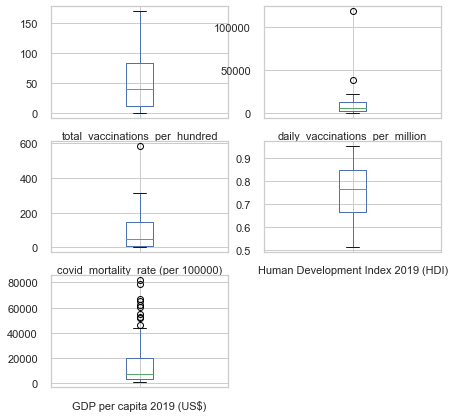

In [619]:
dataset.plot(kind='box', subplots=True, layout=(3,2), sharex=False, sharey=False, figsize=(7, 7))
plt.show()

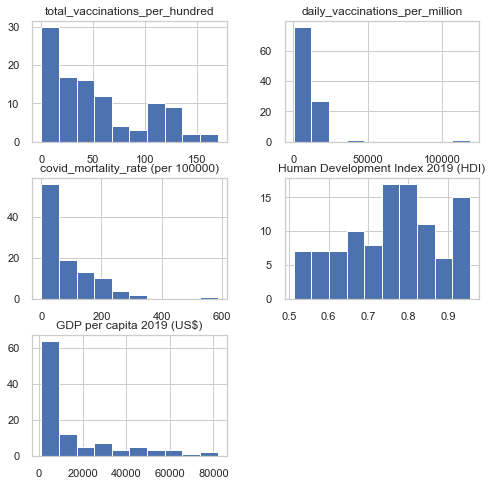

In [620]:
dataset.hist(figsize=(8, 8))
plt.show()

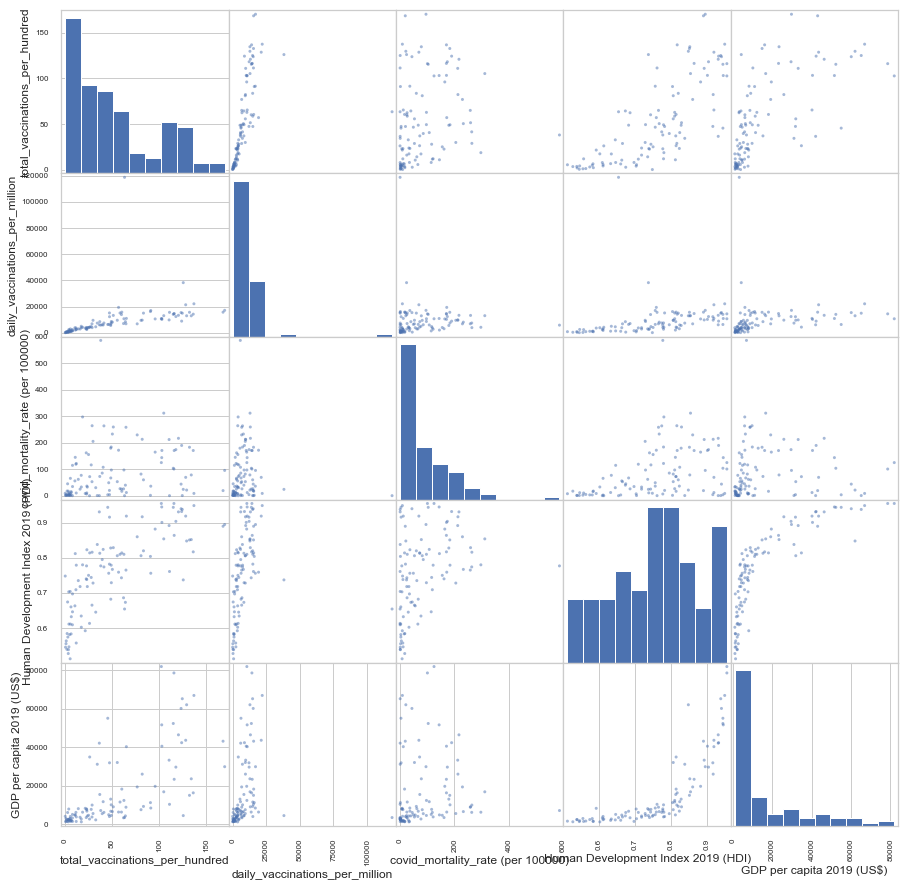

In [621]:
scatter_matrix(dataset, figsize=(15,15))
plt.show()

In [622]:
dataset

,total_vaccinations_per_hundred,daily_vaccinations_per_million,covid_mortality_rate (per 100000),Human Development Index 2019 (HDI),GDP per capita 2019 (US$),IncomeGroup
85,170.01,17115,95.527592,0.895,29820.603247,High income
103,36.96,8463,72.714433,0.813,15343.062004,High income
111,116.24,14660,170.490303,0.864,23252.058518,High income
125,82.17,9629,212.961916,0.917,25946.182185,High income
72,55.62,9549,53.087513,0.806,32000.448469,High income
36,123.58,15390,43.824729,0.940,60170.342637,High income
20,34.31,7365,0.678788,0.838,31086.751119,High income
97,115.27,14030,103.723170,0.944,52331.316728,High income
112,129.50,12962,21.404620,0.848,62088.061828,High income
144,136.54,14188,170.651597,0.817,16190.126957,High income


In [623]:
dataset.values

array([[170.01, 17115, 95.52759234333926, 0.895, 29820.60324740992,
        'High income'],
       [36.96, 8463, 72.7144332239757, 0.813, 15343.06200431059,
        'High income'],
       [116.24, 14660, 170.4903027614609, 0.864, 23252.05851812112,
        'High income'],
       [82.17, 9629, 212.9619164648707, 0.917, 25946.18218521273,
        'High income'],
       [55.62, 9549, 53.08751256304574, 0.806, 32000.44846915778,
        'High income'],
       [123.58, 15390, 43.82472929027846, 0.94, 60170.34263650685,
        'High income'],
       [34.31, 7365, 0.6787883176005285, 0.838, 31086.75111880282,
        'High income'],
       [115.27, 14030, 103.723169817332, 0.944, 52331.31672777971,
        'High income'],
       [129.5, 12962, 21.40462033510162, 0.848, 62088.06182769869,
        'High income'],
       [136.54, 14188, 170.6515965532393, 0.817, 16190.12695746501,
        'High income'],
       [128.49, 21370, 69.33304739438131, 0.919, 43592.08358232342,
        'High income'],

In [624]:
array = dataset.values

In [625]:
array

array([[170.01, 17115, 95.52759234333926, 0.895, 29820.60324740992,
        'High income'],
       [36.96, 8463, 72.7144332239757, 0.813, 15343.06200431059,
        'High income'],
       [116.24, 14660, 170.4903027614609, 0.864, 23252.05851812112,
        'High income'],
       [82.17, 9629, 212.9619164648707, 0.917, 25946.18218521273,
        'High income'],
       [55.62, 9549, 53.08751256304574, 0.806, 32000.44846915778,
        'High income'],
       [123.58, 15390, 43.82472929027846, 0.94, 60170.34263650685,
        'High income'],
       [34.31, 7365, 0.6787883176005285, 0.838, 31086.75111880282,
        'High income'],
       [115.27, 14030, 103.723169817332, 0.944, 52331.31672777971,
        'High income'],
       [129.5, 12962, 21.40462033510162, 0.848, 62088.06182769869,
        'High income'],
       [136.54, 14188, 170.6515965532393, 0.817, 16190.12695746501,
        'High income'],
       [128.49, 21370, 69.33304739438131, 0.919, 43592.08358232342,
        'High income'],

In [626]:
X = array[:,0:5]

In [627]:
X

array([[170.01, 17115, 95.52759234333926, 0.895, 29820.60324740992],
       [36.96, 8463, 72.7144332239757, 0.813, 15343.06200431059],
       [116.24, 14660, 170.4903027614609, 0.864, 23252.05851812112],
       [82.17, 9629, 212.9619164648707, 0.917, 25946.18218521273],
       [55.62, 9549, 53.08751256304574, 0.806, 32000.44846915778],
       [123.58, 15390, 43.82472929027846, 0.94, 60170.34263650685],
       [34.31, 7365, 0.6787883176005285, 0.838, 31086.75111880282],
       [115.27, 14030, 103.723169817332, 0.944, 52331.31672777971],
       [129.5, 12962, 21.40462033510162, 0.848, 62088.06182769869],
       [136.54, 14188, 170.6515965532393, 0.817, 16190.12695746501],
       [128.49, 21370, 69.33304739438131, 0.919, 43592.08358232342],
       [137.26, 22113, 8.73067610355746, 0.949, 66944.83307698254],
       [132.54, 15621, 182.9520419951523, 0.851, 14896.45386657887],
       [65.3, 10945, 12.02593187545986, 0.919, 40246.88012841641],
       [124.87, 14932, 0.6271583995324449, 0.938

In [628]:
Y = array[:,5]

In [629]:
Y

array(['High income', 'High income', 'High income', 'High income',
       'High income', 'High income', 'High income', 'High income',
       'High income', 'High income', 'High income', 'High income',
       'High income', 'High income', 'High income', 'High income',
       'High income', 'High income', 'High income', 'High income',
       'High income', 'High income', 'High income', 'High income',
       'High income', 'High income', 'High income', 'High income',
       'High income', 'High income', 'High income', 'High income',
       'High income', 'High income', 'High income', 'Lower middle income',
       'Lower middle income', 'Lower middle income',
       'Lower middle income', 'Lower middle income',
       'Lower middle income', 'Lower middle income',
       'Lower middle income', 'Lower middle income',
       'Lower middle income', 'Lower middle income',
       'Lower middle income', 'Lower middle income',
       'Lower middle income', 'Lower middle income',
       'Lower midd

In [630]:
validation_size = 0.2 #it sets 80% to train 20% to test, the default is 75% train 25% test
seed = 8
X_train, X_validation, Y_train, Y_validation = model_selection.train_test_split(X, Y, test_size=validation_size, random_state=seed)

In [631]:
X_train[0:5]

array([[125.9, 38271, 24.04987981057571, 0.737, 4339.843279250268],
       [46.49, 6370, 49.02782003986502, 0.756, 4793.587019669887],
       [7.9, 1398, 114.6681842505372, 0.646, 4957.458222264077],
       [134.44, 12931, 78.37794491101582, 0.852, 23503.97712667299],
       [37.98, 5802, 586.130646010177, 0.777, 6977.695783553824]],
      dtype=object)

In [632]:
Y_train[0:5]

array(['Lower middle income', 'Upper middle income',
       'Upper middle income', 'High income', 'Upper middle income'],
      dtype=object)

In [633]:
len(X_train)

84

In [634]:
len(X_validation)

21

In [635]:
len(Y_train)

84

In [636]:
len(Y_validation)

21

In [637]:
X[0:5]

array([[170.01, 17115, 95.52759234333926, 0.895, 29820.60324740992],
       [36.96, 8463, 72.7144332239757, 0.813, 15343.06200431059],
       [116.24, 14660, 170.4903027614609, 0.864, 23252.05851812112],
       [82.17, 9629, 212.9619164648707, 0.917, 25946.18218521273],
       [55.62, 9549, 53.08751256304574, 0.806, 32000.44846915778]],
      dtype=object)

In [638]:
Y[0:5]

array(['High income', 'High income', 'High income', 'High income',
       'High income'], dtype=object)

In [639]:
print('Training')
print('    X_training size:', len(X_train))
print('    Y_training size:', len(Y_train))
print('Validation')
print('    X_validation size:', len(X_validation))
print('    Y_validation size:', len(Y_validation))

Training
    X_training size: 84
    Y_training size: 84
Validation
    X_validation size: 21
    Y_validation size: 21


In [640]:
svm = SVC(probability=True) #training the model
#svm = SVC()
svm.fit(X_train, Y_train)

SVC(probability=True)

In [641]:
svm

SVC(probability=True)

In [642]:
predictions = svm.predict(X_validation) #making the predictions
print(predictions)

['Lower middle income' 'Upper middle income' 'Lower middle income'
 'Upper middle income' 'High income' 'Lower middle income' 'High income'
 'Lower middle income' 'Upper middle income' 'Upper middle income'
 'Upper middle income' 'Upper middle income' 'Upper middle income'
 'Upper middle income' 'Upper middle income' 'Lower middle income'
 'High income' 'High income' 'High income' 'Lower middle income'
 'Upper middle income']


In [643]:
print(Y_validation) #what the true outcome is

['Lower middle income' 'High income' 'Lower middle income'
 'Upper middle income' 'High income' 'Lower middle income' 'High income'
 'Upper middle income' 'Upper middle income' 'Upper middle income'
 'Upper middle income' 'Upper middle income' 'Lower middle income'
 'Upper middle income' 'High income' 'Lower middle income' 'High income'
 'High income' 'High income' 'Upper middle income' 'Upper middle income']


In [644]:
#comparing the true outcome (validation) with the predictions
print(accuracy_score(Y_validation, predictions)) 


0.7619047619047619


In [645]:
dataset.head(3)

,total_vaccinations_per_hundred,daily_vaccinations_per_million,covid_mortality_rate (per 100000),Human Development Index 2019 (HDI),GDP per capita 2019 (US$),IncomeGroup
85,170.01,17115,95.527592,0.895,29820.603247,High income
103,36.96,8463,72.714433,0.813,15343.062004,High income
111,116.24,14660,170.490303,0.864,23252.058518,High income


In [646]:
dataset.max()

total_vaccinations_per_hundred                     170.01
daily_vaccinations_per_million                     118759
covid_mortality_rate (per 100000)              586.130646
Human Development Index 2019 (HDI)                  0.955
GDP per capita 2019 (US$)                    81993.727126
IncomeGroup                           Upper middle income
dtype: object

In [647]:
dataset.min()

total_vaccinations_per_hundred               0.17
daily_vaccinations_per_million                 80
covid_mortality_rate (per 100000)        0.081207
Human Development Index 2019 (HDI)          0.512
GDP per capita 2019 (US$)             1071.050761
IncomeGroup                           High income
dtype: object

In [648]:
dataset.describe() 

,total_vaccinations_per_hundred,daily_vaccinations_per_million,covid_mortality_rate (per 100000),Human Development Index 2019 (HDI),GDP per capita 2019 (US$)
count,105.000000,105.000000,105.000000,105.000000,105.000000
mean,52.220762,8824.190476,84.184220,0.758248,15787.726681
std,45.454906,12535.328707,96.353397,0.121367,19025.766242
min,0.170000,80.000000,0.081207,0.512000,1071.050761
25%,11.880000,2842.000000,10.293395,0.665000,3485.084218
50%,40.580000,6370.000000,49.027820,0.767000,6977.695784
75%,83.520000,12931.000000,143.782555,0.848000,19601.890834
max,170.010000,118759.000000,586.130646,0.955000,81993.727126


In [649]:
svm.predict([[6.0, 600 , 60, 0.6, 6000]])

array(['Lower middle income'], dtype=object)

In [650]:
svm.predict_proba([[6.0, 600 , 60, 0.6, 6000]])

array([[0.03593196, 0.64652156, 0.31754648]])

In [651]:
dataset.IncomeGroup

85             High income
103            High income
111            High income
125            High income
72             High income
36             High income
20             High income
97             High income
112            High income
144            High income
66             High income
61             High income
27             High income
69             High income
123            High income
8              High income
78             High income
65             High income
142            High income
60             High income
128            High income
113            High income
71             High income
13             High income
9              High income
46             High income
5              High income
11             High income
141            High income
124            High income
132            High income
98             High income
87             High income
133            High income
67             High income
30     Lower middle income
146    Lower middle income
1

In [652]:
labels = ['High income','Lower Middle income','Upper middle income']
cm = confusion_matrix(Y_validation, predictions)
print(cm)

[[5 0 2]
 [0 4 1]
 [0 2 7]]


<ipython-input-653-4eb4716b0a1e>:6: UserWarning:

FixedFormatter should only be used together with FixedLocator

<ipython-input-653-4eb4716b0a1e>:7: UserWarning:

FixedFormatter should only be used together with FixedLocator



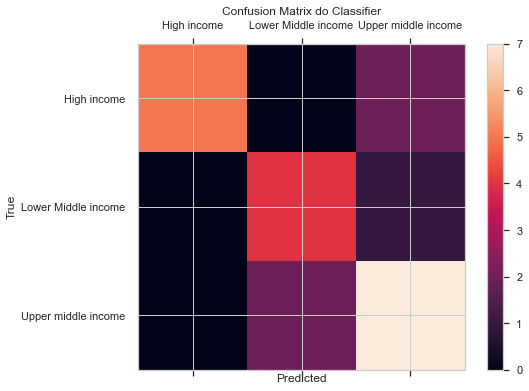

In [653]:
fig = plt.figure(figsize=(8, 6))
ax = fig.add_subplot(111)
cax = ax.matshow(cm)
plt.title('Confusion Matrix do Classifier')
fig.colorbar(cax)
ax.set_xticklabels([''] +labels)
ax.set_yticklabels([''] + labels)
plt.xlabel('Predicted')
plt.ylabel('True')
plt.show()

In [654]:
probs = svm.predict_proba(X_validation)
print(probs)
#probability associated to each observation

[[0.01306101 0.92407587 0.06286312]
 [0.56403854 0.05538806 0.3805734 ]
 [0.01302256 0.9300961  0.05688134]
 [0.05905378 0.19891991 0.7420263 ]
 [0.68430727 0.27270833 0.0429844 ]
 [0.02062128 0.72335416 0.25602456]
 [0.92749353 0.0579339  0.01457257]
 [0.02254423 0.61313445 0.36432132]
 [0.04918562 0.13639839 0.81441599]
 [0.05225262 0.28333315 0.66441423]
 [0.0286982  0.12100493 0.85029686]
 [0.25793713 0.04706032 0.69500256]
 [0.01736414 0.05981947 0.92281639]
 [0.04066972 0.03749415 0.92183613]
 [0.55297487 0.04167478 0.40535035]
 [0.01185766 0.93660964 0.0515327 ]
 [0.75938059 0.20517353 0.03544588]
 [0.85633194 0.12016053 0.02350753]
 [0.97717598 0.01041139 0.01241263]
 [0.05907559 0.39994475 0.54097966]
 [0.10265594 0.07859856 0.8187455 ]]


In [655]:
#it's possible to make one prediction 

In [656]:
Data = [[7.0, 578 , 55, 0.6, 5000]]
pred_data = svm.predict(Data)
print(pred_data)

['Lower middle income']


In [657]:
#or many at once

In [658]:
Data = [[5.5, 550, 80, 0.59, 15000], [6.4, 400, 60, 0.57, 9500]]
pred_data = svm.predict(Data)
print(pred_data)

['Upper middle income' 'Upper middle income']


In [659]:
dataset.describe() 

,total_vaccinations_per_hundred,daily_vaccinations_per_million,covid_mortality_rate (per 100000),Human Development Index 2019 (HDI),GDP per capita 2019 (US$)
count,105.000000,105.000000,105.000000,105.000000,105.000000
mean,52.220762,8824.190476,84.184220,0.758248,15787.726681
std,45.454906,12535.328707,96.353397,0.121367,19025.766242
min,0.170000,80.000000,0.081207,0.512000,1071.050761
25%,11.880000,2842.000000,10.293395,0.665000,3485.084218
50%,40.580000,6370.000000,49.027820,0.767000,6977.695784
75%,83.520000,12931.000000,143.782555,0.848000,19601.890834
max,170.010000,118759.000000,586.130646,0.955000,81993.727126


#### 12.2 Logistic Regression, Decision Tree and Random Forest

In [660]:
#making predictions in a different ways, this will also be classification, but not SVC

In [739]:
covidvisual = pd.read_excel('C:/Users/andre/Documents/Programming Languages/Python/pimespython/Project/covidwebscraping/actualcovid19project/covidvisual.xlsx')

In [740]:
covidvisual.head(3)

,Country,Country Code,Latitude,Longitude,HDI rank,Human Development Index 2019 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,GDP 2019 (US$),GDP per capita 2019 (US$),GDP growth 2019 (annual %),Inflation Rate 2019 (%),Unemployment Rate 2020 (%),Region,IncomeGroup,total_vaccinations,date,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop,covid_mortality_rate (per 100000)
0,Afghanistan,AFG,33.0,65.0,169,0.511,64.83,10.176430,3.930000,2229.362021,1.929110e+10,507.103432,3.911603,2.302373,11.73,South Asia,Low income,1277085,2021-07-27,939835,219159.0,4015.0,22461,3.28,2.41,0.56,577,Afghanistan,"146,523",+527,6677.0,+62,"96,692",+966,"43,154","1,124","701,952",39864282,Asia,13,2.0,"1,083",16.749330
1,Albania,ALB,41.0,20.0,69,0.795,78.57,14.695620,10.145730,13998.299890,1.527918e+10,5353.244856,2.240070,1.411091,11.70,Europe & Central Asia,Upper middle income,1138771,2021-07-25,640047,498724.0,23655.0,17565,39.57,22.24,17.33,6104,Albania,"132,999",+47,2457.0,NaN,"130,187",+13,355,3,"916,777",2874426,Europe,16,NaN,124,85.477935
2,Algeria,DZA,28.0,3.0,91,0.748,76.88,14.604302,7.986548,11173.956810,1.710913e+11,3973.964072,0.800000,1.951768,12.83,Middle East & North Africa,Lower middle income,75000,2021-02-19,75000,NaN,30.0,3748,0.17,0.17,NaN,85,Algeria,"168,668","+1,537",4189.0,+28,"113,707",+807,"50,772",37,"230,861",44697286,Africa,34,0.6,"1,136",9.371934


In [741]:
covidvisual.shape

(148, 43)

In [742]:
covidvisual.isna().sum()

Country                                    0
Country Code                               0
Latitude                                   0
Longitude                                  0
HDI rank                                   0
Human Development Index 2019 (HDI)         0
Life expectancy at birth                   0
Expected years of schooling                0
Mean years of schooling                    0
Gross national income (GNI) per capita     0
GDP 2019 (US$)                             0
GDP per capita 2019 (US$)                  0
GDP growth 2019 (annual %)                 0
Inflation Rate 2019 (%)                    0
Unemployment Rate 2020 (%)                 0
Region                                     0
IncomeGroup                                0
total_vaccinations                         0
date                                       0
people_vaccinated                          0
people_fully_vaccinated                    5
daily_vaccinations_raw                    26
daily_vacc

In [743]:
import missingno as msno

<AxesSubplot:>

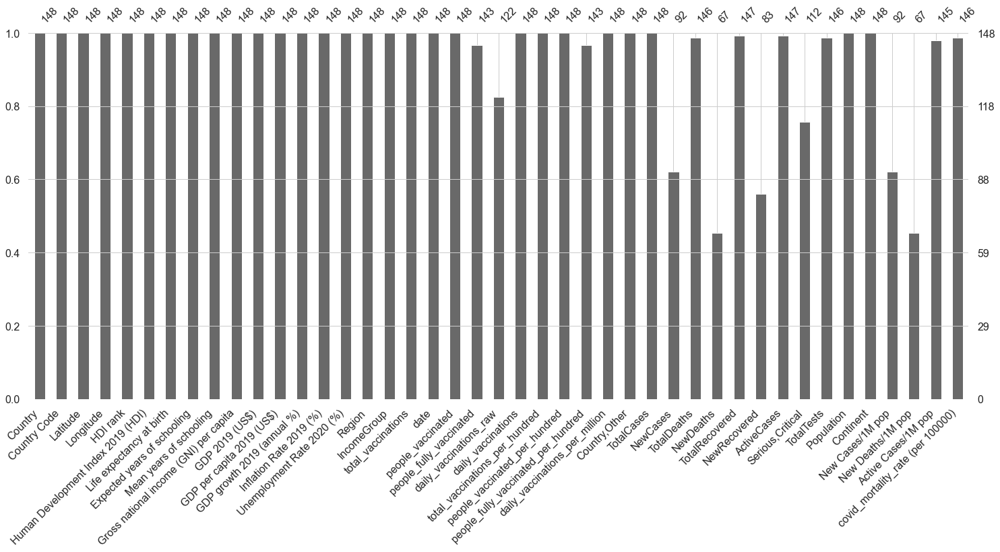

In [744]:
msno.bar(covidvisual)

In [745]:
covidvisual.nunique()

Country                                   148
Country Code                              148
Latitude                                  112
Longitude                                 116
HDI rank                                  126
Human Development Index 2019 (HDI)        126
Life expectancy at birth                  142
Expected years of schooling               148
Mean years of schooling                   147
Gross national income (GNI) per capita    148
GDP 2019 (US$)                            148
GDP per capita 2019 (US$)                 148
GDP growth 2019 (annual %)                148
Inflation Rate 2019 (%)                   148
Unemployment Rate 2020 (%)                134
Region                                      7
IncomeGroup                                 4
total_vaccinations                        148
date                                       18
people_vaccinated                         148
people_fully_vaccinated                   143
daily_vaccinations_raw            

In [746]:
covidvisual.dtypes

Country                                    object
Country Code                               object
Latitude                                  float64
Longitude                                 float64
HDI rank                                    int64
Human Development Index 2019 (HDI)        float64
Life expectancy at birth                  float64
Expected years of schooling               float64
Mean years of schooling                   float64
Gross national income (GNI) per capita    float64
GDP 2019 (US$)                            float64
GDP per capita 2019 (US$)                 float64
GDP growth 2019 (annual %)                float64
Inflation Rate 2019 (%)                   float64
Unemployment Rate 2020 (%)                float64
Region                                     object
IncomeGroup                                object
total_vaccinations                          int64
date                                       object
people_vaccinated                           int64


In [747]:
type(covidvisual)

pandas.core.frame.DataFrame

In [748]:
type(covidvisual['IncomeGroup'])

pandas.core.series.Series

In [749]:
covidvisual['IncomeGroup'].value_counts()

High income            52
Upper middle income    39
Lower middle income    39
Low income             18
Name: IncomeGroup, dtype: int64

In [750]:
covidvisual['IncomeGroup'].value_counts(normalize=True)

High income            0.351351
Upper middle income    0.263514
Lower middle income    0.263514
Low income             0.121622
Name: IncomeGroup, dtype: float64

In [751]:
import seaborn as sns

<AxesSubplot:xlabel='count', ylabel='IncomeGroup'>

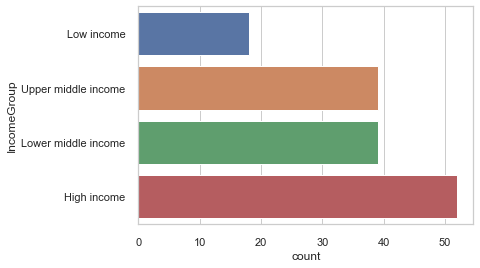

In [752]:
sns.countplot(data=covidvisual, y = 'IncomeGroup')

In [753]:
covidvisual.describe()

,Latitude,Longitude,HDI rank,Human Development Index 2019 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,GDP 2019 (US$),GDP per capita 2019 (US$),GDP growth 2019 (annual %),Inflation Rate 2019 (%),Unemployment Rate 2020 (%),total_vaccinations,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million,TotalDeaths,Population,New Deaths/1M pop,covid_mortality_rate (per 100000)
count,148.000000,148.000000,148.000000,148.000000,148.000000,148.000000,148.000000,148.000000,1.480000e+02,148.000000,148.000000,148.000000,148.000000,1.480000e+02,1.480000e+02,1.430000e+02,1.220000e+02,1.480000e+02,148.000000,148.000000,143.000000,148.000000,146.000000,1.480000e+02,67.000000,146.000000
mean,20.596086,20.486879,89.358108,0.736486,73.254122,13.654646,8.835875,22055.442507,5.689418e+11,16115.807130,2.862133,3.250608,8.127162,2.642093e+07,1.414767e+07,7.546039e+06,6.015731e+05,3.590498e+05,49.029189,29.021959,21.121538,7835.141892,27117.794521,4.806259e+07,2.270746,76.942679
std,24.893145,63.059012,55.942391,0.151265,7.603609,2.924268,3.183824,20824.755374,2.196546e+12,20888.151087,2.903664,5.315561,5.369888,1.395674e+08,6.116941e+07,2.528019e+07,2.491923e+06,1.931005e+06,45.305844,24.913804,21.605296,10972.507067,83274.903713,1.690726e+08,4.112967,91.348137
min,-41.000000,-172.333300,1.000000,0.394000,54.240000,6.471450,1.644299,1034.677638,8.247185e+08,411.552340,-6.700000,-3.233389,0.690000,4.078000e+03,4.078000e+03,1.140000e+02,3.000000e+01,2.720000e+02,0.040000,0.040000,0.000000,35.000000,1.000000,1.113180e+05,0.040000,0.081207
25%,5.750000,-5.000000,39.750000,0.610500,67.800000,11.521392,6.452716,5279.974073,1.409808e+10,2494.581828,1.212137,0.824152,4.545000,4.214112e+05,2.819138e+05,1.282435e+05,1.974300e+04,1.016100e+04,6.225000,3.887500,2.070000,1734.000000,534.500000,2.973561e+06,0.300000,6.262207
50%,20.000000,19.750000,86.000000,0.759000,75.050000,13.991780,9.201735,13936.969180,5.440082e+10,6306.250015,2.432134,2.186902,6.535000,2.062887e+06,1.418607e+06,8.326730e+05,8.641000e+04,3.590300e+04,36.730000,24.890000,13.160000,6363.500000,3394.500000,9.826157e+06,0.700000,36.217263
75%,41.208325,47.125000,138.500000,0.855500,78.735000,15.644513,11.506941,34424.788272,3.078324e+11,23167.863622,4.583666,3.636446,10.240000,1.012821e+07,5.617409e+06,4.193453e+06,2.925110e+05,1.507125e+05,85.875000,49.370000,38.050000,10735.500000,12817.250000,3.297308e+07,2.000000,124.906197
max,65.000000,175.000000,189.000000,0.957000,84.860000,21.954330,14.151680,92418.230360,2.143323e+13,114704.594171,18.723525,50.994052,28.740000,1.601249e+09,6.220000e+08,2.232990e+08,2.474100e+07,2.242429e+07,170.010000,89.710000,84.650000,118759.000000,628152.000000,1.439324e+09,26.000000,586.130646


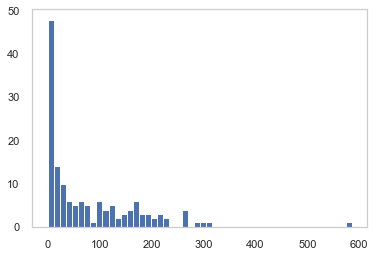

In [754]:
covidvisual['covid_mortality_rate (per 100000)'].hist(grid=False, bins=50);

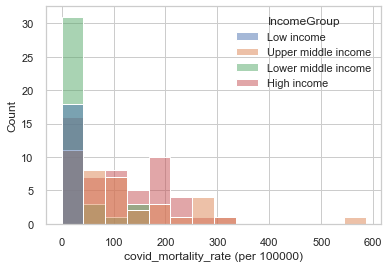

In [755]:
sns.histplot(data=covidvisual, x = 'covid_mortality_rate (per 100000)', hue='IncomeGroup');

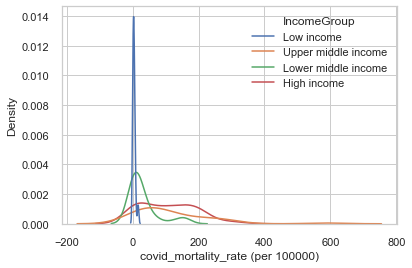

In [756]:
sns.kdeplot(data=covidvisual,x='covid_mortality_rate (per 100000)', hue='IncomeGroup');

In [757]:
pd.crosstab(covidvisual['Continent'], covidvisual['IncomeGroup'], margins=True)

IncomeGroup,High income,Low income,Lower middle income,Upper middle income,All
Continent,,,,,
Africa,1,16,17,5,39
Asia,13,1,13,11,38
Australia/Oceania,2,0,3,2,7
Europe,29,0,2,8,39
North America,5,1,3,7,16
South America,2,0,1,6,9
All,52,18,39,39,148


In [758]:
pd.crosstab(covidvisual['Continent'], covidvisual['IncomeGroup'], normalize='index')

IncomeGroup,High income,Low income,Lower middle income,Upper middle income
Continent,,,,
Africa,0.025641,0.410256,0.435897,0.128205
Asia,0.342105,0.026316,0.342105,0.289474
Australia/Oceania,0.285714,0.000000,0.428571,0.285714
Europe,0.743590,0.000000,0.051282,0.205128
North America,0.312500,0.062500,0.187500,0.437500
South America,0.222222,0.000000,0.111111,0.666667


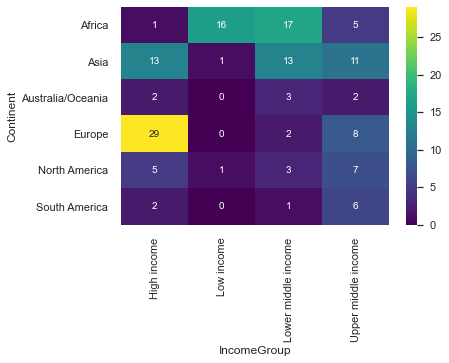

In [759]:
sns.heatmap(pd.crosstab(covidvisual['Continent'], covidvisual['IncomeGroup']), annot=True, fmt='.5g', cmap='viridis');

In [760]:
covidvisual = covidvisual.dropna(subset=['daily_vaccinations_per_million','covid_mortality_rate (per 100000)'])

In [761]:
incomegroupdummies = pd.get_dummies(covidvisual['IncomeGroup'], prefix='IncomeGroup')

In [762]:
incomegroupdummies 

,IncomeGroup_High income,IncomeGroup_Low income,IncomeGroup_Lower middle income,IncomeGroup_Upper middle income
0,0,1,0,0
1,0,0,0,1
2,0,0,1,0
3,0,0,1,0
4,0,0,0,1
5,1,0,0,0
6,1,0,0,0
7,0,0,0,1
8,1,0,0,0
9,1,0,0,0


In [763]:
#pd.get_dummies(covidvisual, columns = ['IncomeGroup'], drop_first = True)

In [764]:
covidvisual.shape

(146, 43)

In [765]:
covidvisual.isna().sum()

Country                                    0
Country Code                               0
Latitude                                   0
Longitude                                  0
HDI rank                                   0
Human Development Index 2019 (HDI)         0
Life expectancy at birth                   0
Expected years of schooling                0
Mean years of schooling                    0
Gross national income (GNI) per capita     0
GDP 2019 (US$)                             0
GDP per capita 2019 (US$)                  0
GDP growth 2019 (annual %)                 0
Inflation Rate 2019 (%)                    0
Unemployment Rate 2020 (%)                 0
Region                                     0
IncomeGroup                                0
total_vaccinations                         0
date                                       0
people_vaccinated                          0
people_fully_vaccinated                    5
daily_vaccinations_raw                    24
daily_vacc

In [766]:
covidvisual.head(3)

,Country,Country Code,Latitude,Longitude,HDI rank,Human Development Index 2019 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,GDP 2019 (US$),GDP per capita 2019 (US$),GDP growth 2019 (annual %),Inflation Rate 2019 (%),Unemployment Rate 2020 (%),Region,IncomeGroup,total_vaccinations,date,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop,covid_mortality_rate (per 100000)
0,Afghanistan,AFG,33.0,65.0,169,0.511,64.83,10.176430,3.930000,2229.362021,1.929110e+10,507.103432,3.911603,2.302373,11.73,South Asia,Low income,1277085,2021-07-27,939835,219159.0,4015.0,22461,3.28,2.41,0.56,577,Afghanistan,"146,523",+527,6677.0,+62,"96,692",+966,"43,154","1,124","701,952",39864282,Asia,13,2.0,"1,083",16.749330
1,Albania,ALB,41.0,20.0,69,0.795,78.57,14.695620,10.145730,13998.299890,1.527918e+10,5353.244856,2.240070,1.411091,11.70,Europe & Central Asia,Upper middle income,1138771,2021-07-25,640047,498724.0,23655.0,17565,39.57,22.24,17.33,6104,Albania,"132,999",+47,2457.0,NaN,"130,187",+13,355,3,"916,777",2874426,Europe,16,NaN,124,85.477935
2,Algeria,DZA,28.0,3.0,91,0.748,76.88,14.604302,7.986548,11173.956810,1.710913e+11,3973.964072,0.800000,1.951768,12.83,Middle East & North Africa,Lower middle income,75000,2021-02-19,75000,NaN,30.0,3748,0.17,0.17,NaN,85,Algeria,"168,668","+1,537",4189.0,+28,"113,707",+807,"50,772",37,"230,861",44697286,Africa,34,0.6,"1,136",9.371934


In [767]:
from sklearn.model_selection import train_test_split

In [768]:
x = covidvisual[['total_vaccinations_per_hundred',
            'daily_vaccinations_per_million',
             'covid_mortality_rate (per 100000)',
            'Human Development Index 2019 (HDI)','GDP per capita 2019 (US$)']]
y = incomegroupdummies['IncomeGroup_High income']

In [769]:
x.head(3)

,total_vaccinations_per_hundred,daily_vaccinations_per_million,covid_mortality_rate (per 100000),Human Development Index 2019 (HDI),GDP per capita 2019 (US$)
0,3.28,577,16.749330,0.511,507.103432
1,39.57,6104,85.477935,0.795,5353.244856
2,0.17,85,9.371934,0.748,3973.964072


In [770]:
x.isna().sum()

total_vaccinations_per_hundred        0
daily_vaccinations_per_million        0
covid_mortality_rate (per 100000)     0
Human Development Index 2019 (HDI)    0
GDP per capita 2019 (US$)             0
dtype: int64

In [771]:
y.head(10) #1 it's in the high income group, 0 it's not in the high income group

0    0
1    0
2    0
3    0
4    0
5    1
6    1
7    0
8    1
9    1
Name: IncomeGroup_High income, dtype: uint8

In [772]:
x_train, x_test, y_train, y_test = train_test_split(x, y, random_state=8) #by default from the library train is 75% test is 25%

In [773]:
from sklearn.linear_model import LogisticRegression

In [774]:
lr = LogisticRegression(solver='liblinear')

In [775]:
lr.fit(x_train, y_train)

LogisticRegression(solver='liblinear')

In [776]:
from sklearn.metrics import classification_report, plot_confusion_matrix

In [777]:
def classification_results(classifier, x_test, y_test, cmap='Blues'):
    print('Model Results:', classifier.__class__.__name__)
    
    y_pred = classifier.predict(x_test)
    
    print(classification_report(y_test, y_pred))
    
    plot_confusion_matrix(classifier, x_test, y_test, cmap=cmap);

Model Results: LogisticRegression
              precision    recall  f1-score   support

           0       1.00      0.84      0.91        25
           1       0.75      1.00      0.86        12

    accuracy                           0.89        37
   macro avg       0.88      0.92      0.89        37
weighted avg       0.92      0.89      0.89        37



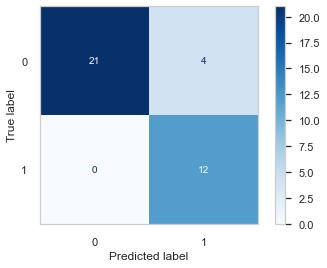

In [778]:
classification_results(lr, x_test, y_test)
plt.grid(False)

In [779]:
from sklearn.tree import DecisionTreeClassifier

In [780]:
dt = DecisionTreeClassifier()
dt.fit(x_train, y_train)

DecisionTreeClassifier()

Model Results: DecisionTreeClassifier
              precision    recall  f1-score   support

           0       1.00      1.00      1.00        25
           1       1.00      1.00      1.00        12

    accuracy                           1.00        37
   macro avg       1.00      1.00      1.00        37
weighted avg       1.00      1.00      1.00        37



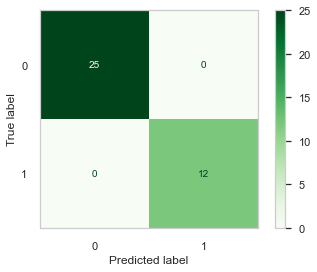

In [781]:
classification_results(dt, x_test, y_test, cmap='Greens')
plt.grid(False)

In [782]:
from sklearn.ensemble import RandomForestClassifier

Model Results: RandomForestClassifier
              precision    recall  f1-score   support

           0       1.00      1.00      1.00        25
           1       1.00      1.00      1.00        12

    accuracy                           1.00        37
   macro avg       1.00      1.00      1.00        37
weighted avg       1.00      1.00      1.00        37



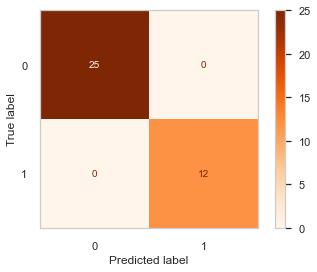

In [783]:
rf = RandomForestClassifier()
rf.fit(x_train, y_train)
classification_results(rf, x_test, y_test, cmap='Oranges')
plt.grid(False)

In [784]:
feat = pd.Series(rf.feature_importances_, index=x_train.columns)

In [785]:
feat.sort_values(inplace=True)

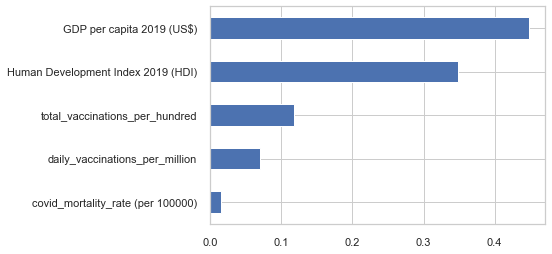

In [786]:
feat.plot(kind='barh');

##### 12.2.1 Decision Tree Classifier Accuracy

In [789]:
from sklearn.model_selection import train_test_split

In [790]:
covidvisual.shape

(146, 43)

In [791]:
x = covidvisual[['total_vaccinations_per_hundred',
            'daily_vaccinations_per_million',
             'covid_mortality_rate (per 100000)',
            'Human Development Index 2019 (HDI)','GDP per capita 2019 (US$)']]
y = incomegroupdummies['IncomeGroup_High income']

In [792]:
x_train, x_test, y_train, y_test = train_test_split(x, y)

In [793]:
x_train.shape, x_test.shape

((109, 5), (37, 5))

In [794]:
from sklearn.tree import DecisionTreeClassifier

In [795]:
dt = DecisionTreeClassifier()

In [796]:
dt.fit(x_train, y_train)

DecisionTreeClassifier()

In [797]:
y_pred = dt.predict(x_test)

In [798]:
from sklearn.metrics import plot_confusion_matrix

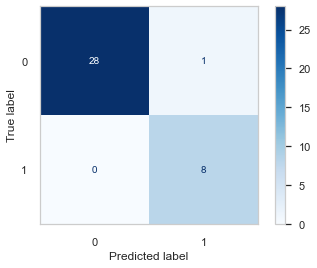

In [800]:
plot_confusion_matrix(dt, x_test, y_test, cmap='Blues')
plt.grid(False);

In [801]:
from sklearn.metrics import accuracy_score, classification_report

In [802]:
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       1.00      0.97      0.98        29
           1       0.89      1.00      0.94         8

    accuracy                           0.97        37
   macro avg       0.94      0.98      0.96        37
weighted avg       0.98      0.97      0.97        37



In [803]:
accuracy_score(y_test, y_pred) #sum(primary diagonal 28+8 = 36)/sum(total=37) = 0.97297

0.972972972972973

In [804]:
pd.Series(y_pred).value_counts()

0    28
1     9
dtype: int64

In [805]:
y_test.value_counts()

0    29
1     8
Name: IncomeGroup_High income, dtype: int64

In [806]:
pd.Series(y_pred).value_counts().sum()

37

In [807]:
y_test.value_counts().sum()

37